Version 0.2

Hydro power plant constraints forecast

# Subproblem 1 - Maximum and minimum energy production

This module implements the predictive models for the daily energy values, i.e. minimum and maximum production.
First we implement models from teh scikit learn library, using a pipeline to find best parameters.
Then we build deep learning models using Keras.

# Import libraries

In [3]:
import math
import pandas as pd
import numpy as np
import array as arr
from pandas import ExcelWriter
from pandas import ExcelFile
import re 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error, mean_absolute_error
import statistics 
from functools import reduce
import random
from sklearn import metrics

%matplotlib inline

# Read source file into data frame and display columns

In [4]:
dateparse = lambda x: pd.datetime.strptime(x, '%Y-%m-%d')

df = pd.read_csv("clean_dataframe.csv", parse_dates=['Date'], date_parser=dateparse, index_col="Date.1")
# rename date column 
df.rename(columns={ df.columns[0]: "Date"}, inplace=True)
df.index = df["Date"]

df.rename(columns={ "Variante Prio": "Max prod"}, inplace=True)

## Check content and basic statistics

In [5]:
df.head()

,Date,Min prod,Inflow lake 1 [m3],Inflow lake 2 [m3],Inflow lake 3 [m3],Inflow lake 4 [m3],Vol lake 1 [%],Max lake 1 [1000m3],Availability plant 1 [%],Availability plant 2 [%],...,Max prod,PrioH1,PrioP1,PrioH2,PrioP2,PrioH3,PrioP3,PrioH4,PrioP4,TotalAvailablePower
Date,,,,,,,,,,,,,,,,,,,,,
2014-04-01,2014-04-01,0.0,31.0,4.0,129.0,107.0,0.16467,30000.0,1.0,1.0,...,902.4,4.0,73.8,4.0,66.0,8.0,42.9,0.0,0.0,77.400
2014-04-02,2014-04-02,150.0,0.0,-14.0,148.0,116.0,0.15557,30000.0,1.0,1.0,...,902.4,4.0,73.8,4.0,66.0,8.0,42.9,0.0,0.0,77.400
2014-04-03,2014-04-03,150.0,10.0,6.0,132.0,118.0,0.14765,30000.0,1.0,1.0,...,902.4,4.0,73.8,4.0,66.0,8.0,42.9,0.0,0.0,59.125
2014-04-04,2014-04-04,150.0,19.0,6.0,150.0,118.0,0.13716,30000.0,1.0,1.0,...,902.4,4.0,73.8,4.0,66.0,8.0,42.9,0.0,0.0,58.050
2014-04-05,2014-04-05,180.0,41.0,15.0,148.0,124.0,0.13091,30000.0,1.0,1.0,...,897.6,4.0,72.6,4.0,66.0,8.0,42.9,0.0,0.0,77.400


In [6]:
df.tail()

,Date,Min prod,Inflow lake 1 [m3],Inflow lake 2 [m3],Inflow lake 3 [m3],Inflow lake 4 [m3],Vol lake 1 [%],Max lake 1 [1000m3],Availability plant 1 [%],Availability plant 2 [%],...,Max prod,PrioH1,PrioP1,PrioH2,PrioP2,PrioH3,PrioP3,PrioH4,PrioP4,TotalAvailablePower
Date,,,,,,,,,,,,,,,,,,,,,
2019-06-26,2019-06-26,479.633867,1179.8,-108.0,785.1,625.8,0.63993,30000.0,1.0,1.0,...,314.759725,10.0,31.475973,0.0,0.000000,0.0,0.0,0.0,0.0,45.6
2019-06-27,2019-06-27,569.565217,1735.9,-111.0,868.0,547.2,0.66066,30000.0,1.0,1.0,...,326.450801,9.0,36.272311,0.0,0.000000,0.0,0.0,0.0,0.0,45.6
2019-06-28,2019-06-28,509.610984,1786.9,79.0,644.6,595.3,0.68188,30000.0,1.0,1.0,...,283.883295,7.0,36.272311,1.0,29.977117,0.0,0.0,0.0,0.0,45.6
2019-06-29,2019-06-29,479.633867,1614.6,83.0,609.2,479.1,0.70126,30000.0,1.0,1.0,...,253.906178,7.0,36.272311,0.0,0.000000,0.0,0.0,0.0,0.0,45.6
2019-06-30,2019-06-30,479.633867,1516.5,-105.0,834.7,357.7,0.71942,30000.0,1.0,1.0,...,253.906178,7.0,36.272311,0.0,0.000000,0.0,0.0,0.0,0.0,45.6


In [7]:
# display info about our dataframe, i.e. features types, labels, number of values including NaN indication
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1917 entries, 2014-04-01 to 2019-06-30
Data columns (total 24 columns):
Date                        1917 non-null datetime64[ns]
Min prod                    1917 non-null float64
Inflow lake 1 [m3]          1917 non-null float64
Inflow lake 2 [m3]          1917 non-null float64
Inflow lake 3 [m3]          1917 non-null float64
Inflow lake 4 [m3]          1917 non-null float64
Vol lake 1 [%]              1917 non-null float64
Max lake 1 [1000m3]         1917 non-null float64
Availability plant 1 [%]    1917 non-null float64
Availability plant 2 [%]    1917 non-null float64
Availability plant 3 [%]    1917 non-null float64
Availability plant 4 [%]    1917 non-null float64
SDL [MWh]                   1917 non-null float64
Weekend                     1917 non-null bool
Max prod                    1917 non-null float64
PrioH1                      1917 non-null float64
PrioP1                      1917 non-null float64
PrioH2               

## Import baseline

In [8]:
# Read baseline for benchmark data as well
df_benchmark = pd.read_csv("baseline_dataframe.csv", parse_dates=['Date'], date_parser=dateparse, index_col="Date.1")
# Force index to be date (as provided in the first column)
df_benchmark.index = df_benchmark['Date']

df_benchmark.info()
df_benchmark.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1918 entries, 2014-04-01 to 2019-07-01
Data columns (total 10 columns):
Date              1918 non-null datetime64[ns]
P1 [MW]           1918 non-null float64
P2 [MW]           1918 non-null float64
P3 [MW]           1918 non-null float64
P4 [MW]           1918 non-null int64
H1 [#]            1918 non-null int64
H2 [#]            1918 non-null int64
H3 [#]            1918 non-null int64
Min Prod [MWh]    1918 non-null float64
MaxEnergy         1918 non-null float64
dtypes: datetime64[ns](1), float64(5), int64(4)
memory usage: 164.8 KB


,Date,P1 [MW],P2 [MW],P3 [MW],P4 [MW],H1 [#],H2 [#],H3 [#],Min Prod [MWh],MaxEnergy
Date,,,,,,,,,,
2014-04-01,2014-04-01,73.7,47.8,40.0,0,3,4,9,254.2,772.3
2014-04-02,2014-04-02,73.6,47.8,40.0,0,3,4,9,276.5,772.0
2014-04-03,2014-04-03,55.3,47.7,39.9,0,3,4,9,269.5,715.8
2014-04-04,2014-04-04,54.1,47.7,39.9,0,3,4,9,289.9,712.2
2014-04-05,2014-04-05,73.5,47.7,39.9,0,3,5,8,297.6,778.2


In [9]:
# copy baseline values into main dataframe, using consistent labels
df["Baseline_Min prod"] = df_benchmark["Min Prod [MWh]"]
df["Baseline_Max prod"] = df_benchmark["MaxEnergy"]

# Data preparation for ML
## Test / train split and input / output features separation

In [10]:
# define train / test split ratio (applied to availabe data points in dataset)
splitRatio = 0.9

In [11]:
# splits the input dataframe into train, test for target and input features, using the provided ratio
def GetDataSplit(df_input, regressors, target_feature, target_baseline, ratio):
    # We split using a 90/10 ratio (parameter), but keeping the data in chronological order
    CutPoint = round(len(df.index)*ratio)
    df_model = df_input.filter(regressors, axis=1)
    
    xTrain = df_model.iloc[:CutPoint, :] 
    xTest  = df_model.iloc[CutPoint:, :]
    yTrain = df[target_feature][:CutPoint]   
    yTest  = df[target_feature][CutPoint:]
    yBaseLine = df[target_baseline][CutPoint:]
    return [xTrain, xTest, yTrain, yTest, yBaseLine ]

## Compute baseline error

In [14]:
# Compute target error metrics to beat, i.e. error metrics from the baseline dataset

# define regressors, i.e. list of features to be used as input for our regression problem
regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]', 'Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]']

for target_feature in ["Min prod","Max prod"]:
    xTrain, xTest, yTrain, yTest, yBaseLine =  GetDataSplit(df, regressors,
                                                                target_feature, "Baseline_"+target_feature,0.9)
    print('Baseline values for target "'+target_feature+ '" (daily value)')       
    print('RMSE :'+ str(round(math.sqrt(metrics.mean_squared_error(yTest,yBaseLine)),2)))
    print('MAE :'+ str(round(metrics.mean_absolute_error(yTest,yBaseLine),2)))
    print('R^2 :'+ str(round(metrics.r2_score(yTest,yBaseLine)*100, 2)))

Baseline values for target "Min prod" (daily value)
RMSE :237.33
MAE :181.59
R^2 :-192.26
Baseline values for target "Max prod" (daily value)
RMSE :447.8
MAE :430.38
R^2 :6.06


In [15]:
# Compute hourly metrics for baseline
# create an hourly dataframe over same period
# compute hourly values filling up a 24 hours vector
df_hourly = pd.DataFrame(
        {'Hours': pd.date_range(df.index.min(), df.index.max(), freq='1H', closed='left')}
     )

In [16]:
df_hourly.head()

,Hours
0,2014-04-01 00:00:00
1,2014-04-01 01:00:00
2,2014-04-01 02:00:00
3,2014-04-01 03:00:00
4,2014-04-01 04:00:00


In [17]:
len(df_hourly.index)

45984

In [18]:
firstDate = df.index.min()
powerHours = np.zeros(45984)
powerHoursBaseline =  np.zeros(45984)

# loop over all date
for myDate in df.index:
    # index is date difference times 24
    index = (myDate-firstDate).days * 24
    # compute hourly vector of original values, using the 4 pairs (power/nb of hours)
    currHour = index
    for iPair in range(1,4+1):
        pwrValue = df.loc[myDate, "PrioP"+str(iPair)]
        nbHours = int(df.loc[myDate, "PrioH"+str(iPair)])
        if pwrValue > 0:
            #print("Date %s, Pair %i, Pwr %d, Hours %f" %(myDate, iPair, pwrValue, nbHours))
            powerHours[currHour:currHour+nbHours] = pwrValue
            currHour = currHour + nbHours
    # compute hourly vector of baseline values, using the 3 pairs (power/nb of hours)
    currHour = index
    for iPair in range(1,3+1):
        pwrValue = df_benchmark.loc[myDate, "P"+str(iPair)+" [MW]"]
        nbHours = int(df_benchmark.loc[myDate, "H"+str(iPair)+" [#]"])
        if pwrValue > 0:
            #print("Date %s, Pair %i, Pwr %d, Hours %f" %(myDate, iPair, pwrValue, nbHours))
            powerHoursBaseline[currHour:currHour+nbHours] = pwrValue
            currHour = currHour + nbHours

In [19]:
df_hourly["Power"] = powerHours
df_hourly["PowerBaseLine"] = powerHoursBaseline

df_hourly.head()

,Hours,Power,PowerBaseLine
0,2014-04-01 00:00:00,73.8,73.7
1,2014-04-01 01:00:00,73.8,73.7
2,2014-04-01 02:00:00,73.8,73.7
3,2014-04-01 03:00:00,73.8,47.8
4,2014-04-01 04:00:00,66.0,47.8


In [20]:
# compute error metrics over hourly values calculated above
print('Hourly comparison: prediction baseline vs. actual values')
print('RMSE :'+ str(round(math.sqrt(metrics.mean_squared_error(df_hourly["Power"],df_hourly["PowerBaseLine"])),2)))
print('MAE :'+ str(round( metrics.mean_absolute_error(df_hourly["Power"],df_hourly["PowerBaseLine"]),2)))
print('R^2 :'+ str(round(metrics.r2_score( df_hourly["Power"],df_hourly["PowerBaseLine"])*100, 2)))

Hourly comparison: prediction baseline vs. actual values
RMSE :20.31
MAE :14.41
R^2 :42.34


# Model selection

## Model selection using scikit-learn library 

In [21]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble.forest import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline
import math

### plotModelPrediction : function to produce plots out of models predictions 

In [22]:
# function to produce plots out of models predictions
# plot actual value, prediction and baseline in one plot
# plot error along time below in another plot
# Add error metrics values at the bottom and model's parameters
# Produce file in SVG format, i.e. vector format for best quality import in final report
import matplotlib.pylab as pl
import matplotlib.gridspec as gridspec

def plotModelPrediction(model, target_label, y_train, pred, y_test, target_baseline, test_index, 
                        addRegressor, export_prediction = False):

   # build dataframe to be plotted, plot graph and save it as a file
    if  isinstance(model, str):
        model_name = model
    else:
        model_name = type(model).__name__
    
    df_pred = pd.DataFrame(pred, columns=['Forecast '+model_name], index = test_index)
    df_pred["Ground truth"] = y_test
    df_pred["Mean train values"] = y_train.mean()
    df_pred["Baseline"]  = target_baseline
    
    fig_size = plt.rcParams["figure.figsize"]  
    fig_size[0] = 15
    fig_size[1] = 15
    plt.rcParams["figure.figsize"] = fig_size  
    
    # Create 1x3 sub plots
    gs = gridspec.GridSpec(3, 2)

    fig = pl.figure()
    ax = pl.subplot(gs[0, :]) # row 0, col 0
    df_pred.plot(title = target_label+' forecast '+model_name+'(additional regressor: '+addRegressor+')', grid=True, ax=ax)

    # plot error along time
    ax = pl.subplot(gs[1, :]) # row 1, col 0
    df_error = pd.DataFrame(df_pred["Ground truth"]-df_pred['Forecast '+model_name], columns=['Residuals'], index = df_pred.index)
    #df_error["numIndex"] = [i for i in range(len(test_index))]
    #maxError = df_error["Error"].max()
    #df_error["NormError"] = 10*np.absolute(df_error["Error"]/maxError) 
    #df_error["NormError"] = 10
    df_error.plot(title ="Residuals", style=".",grid=True, ax=ax)
    plt.axhline(y=0.5, color='r', linestyle='-')
    
    # plot predicted vs actual values
    ax = pl.subplot(gs[2, 0]) # row 2, col 0
    plt.scatter( df_pred['Forecast '+model_name], df_pred["Ground truth"], c='b', alpha=0.3);
    plt.plot([0,1000], [1,1000], ls="--", c="r")
    plt.title("Predicted values vs ground truth")
    plt.xlabel("Predicted value")
    plt.ylabel("Ground truth")
    
    # plot predicted value vs residuals
    ax = pl.subplot(gs[2, 1]) # row 2, col 1   
    plt.scatter( df_pred['Forecast '+model_name], df_pred["Ground truth"]-df_pred['Forecast '+model_name], c='b', alpha=0.3);
    plt.axhline(y=0.5, color='r', linestyle='-')
    plt.title("Predicted values vs residuals")
    plt.xlabel("Predicted value")
    plt.ylabel("Residuals")

    plt.tight_layout()
        
    # add textual elements: error metrics values, model name and parameters
    txt = 'Target :'+ target_label+" / "
    txt = txt + 'RMSE :'+ str(round(math.sqrt(metrics.mean_squared_error(y_test,pred)),2))+" / "
    txt = txt + 'MAE :'+ str(round(metrics.mean_absolute_error(y_test,pred),2))+" / "
    txt = txt + 'R^2 :'+ str(round(metrics.r2_score(y_test,pred)*100, 2))+" "
    
    fig.text(0.5, 0.01, txt, ha='center')  
    
    fig.savefig('Forecast'+target_label+model_name+'+'+addRegressor+'.svg', format='svg')
    
    if export_prediction:
        df_pred.to_csv('Forecast'+target_label+model_name+'+'+addRegressor+'export_dataframe.csv', index = True, header=True)

### TrainEvalModel : function to train model and find best hyperparameters

In [23]:
# function to train the model and set its best parameters, then evaluate it
# return best parameters

def TrainEvalModel(X_train, X_test, y_train, y_test, target_label, target_baseline, test_index, addRegressor, model, params={}):
    pipeline = Pipeline([('preprocessor', StandardScaler()),
                         ('model', model)])
    print('Model: ', model)
    print(params)
    grid = GridSearchCV(pipeline, params, scoring='r2', n_jobs=-1, cv=3, verbose=1)
    grid.fit(X_train, y_train)
    pred = grid.best_estimator_.predict(X_test)
    
    print('Target :', target_label)
    print('Regressors :', X_train.columns)
    print('Parameters: ', grid.best_params_ )
    print('Root Mean Square Error: %1.4f' % (math.sqrt(metrics.mean_squared_error(y_test,pred))))
    print('Mean Absolute Error: %1.4f' % (metrics.mean_absolute_error(y_test,pred)))
    print('R2 score : %1.4f' %(metrics.r2_score(y_test,pred)*100))
    print('\n\n')
    
    plotModelPrediction(model,target_label, y_train, pred, y_test, target_baseline, test_index, addRegressor)
        
    return [math.sqrt(metrics.mean_squared_error(y_test,pred)), 
                      metrics.mean_absolute_error(y_test,pred), 
                      metrics.r2_score(y_test,pred)*100,
                      grid.best_params_]
    

In [24]:
# set random seed for reproducibility
random.seed( 42 )

### Models evaluation (scikit learn)

In [25]:
# define regressors, i.e. list of features to be used as input for our regression problem
regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]', 'Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]']

Additional regressor:  
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    2.9s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 119.7455
Mean Absolute Error: 91.2605
R2 score : 25.5966



Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    2.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 112.6719
Mean Absolute Error: 87.3538
R2 score : 34.1272



Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split':

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   13.4s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.4min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {'model__max_depth': 5, 'model__min_samples_split': 0.1, 'model__n_estimators': 2000}
Root Mean Square Error: 128.3496
Mean Absolute Error: 92.9615
R2 score : 14.5202



Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  76 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 876 tasks      | elapsed:   17.5s
[Parallel(n_jobs=-1)]: Done 1511 tasks      | elapsed:   47.6s
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:  1.5min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 0.01, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 80.0633
Mean Absolute Error: 65.1685
R2 score : 66.7385



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 fold

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.8s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 223.9582
Mean Absolute Error: 179.8421
R2 score : -160.2608



Additional regressor:  Max lake 1 [1000m3]
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 127.1490
Mean Absolute Error: 103.1077
R2

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 168.3671
Mean Absolute Error: 116.5083
R2 score : -47.0920





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   14.8s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.6min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {'model__max_depth': 5, 'model__min_samples_split': 0.1, 'model__n_estimators': 1000}
Root Mean Square Error: 132.1993
Mean Absolute Error: 94.5292
R2 score : 9.3155



Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 1112 tasks      | elapsed:   24.7s
[Parallel(n_jobs=-1)]: Done 1651 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:  1.6min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {'model__C': 1000, 'model__epsilon': 10, 'model__gamma': 0.001, 'model__kernel': 'rbf'}
Root Mean Square Error: 96.9852
Mean Absolute Error: 77.0235
R2 score : 51.1926



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=Fa

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.8s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 240.9426
Mean Absolute Error: 196.5044
R2 score : -201.2327



Additional regressor:  Weekend
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 114.6957
Mean Absolute Error: 87.2005
R2 s

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 109.4235
Mean Absolute Error: 82.6632
R2 score : 37.8707





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   16.5s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.6min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {'model__max_depth': 5, 'model__min_samples_split': 0.1, 'model__n_estimators': 1000}
Root Mean Square Error: 129.0655
Mean Absolute Error: 93.2542
R2 score : 13.5638



Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 1112 tasks      | elapsed:   25.9s
[Parallel(n_jobs=-1)]: Done 1637 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:  1.7min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 75.9431
Mean Absolute Error: 61.4425
R2 score : 70.0738



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fittin

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.8s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 219.9276
Mean Absolute Error: 176.3497
R2 score : -150.9771



Additional regressor:  
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 254.1174
Mean Absolute Error: 194.8028
R2 score : 69.7472





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 378.6915
Mean Absolute Error: 330.0458
R2 score : 32.8157





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   14.8s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.6min finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {'model__max_depth': 9, 'model__min_samples_split': 1.0, 'model__n_estimators': 500}
Root Mean Square Error: 554.5282
Mean Absolute Error: 534.2018
R2 score : -44.0602



Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 1476 tasks      | elapsed:   30.8s
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:   52.6s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {'model__C': 10, 'model__epsilon': 10, 'model__gamma': 0.1, 'model__kernel': 'rbf'}
Root Mean Square Error: 409.8471
Mean Absolute Error: 386.7450
R2 score : 21.3062



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds f

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 408.9605
Mean Absolute Error: 354.8577
R2 score : 21.6463



Additional regressor:  Max lake 1 [1000m3]
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 246.3644
Mean Absolute Error: 211.8705
R2 s

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 289.9496
Mean Absolute Error: 228.8633
R2 score : 60.6140





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.5min finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {'model__max_depth': 5, 'model__min_samples_split': 1.0, 'model__n_estimators': 500}
Root Mean Square Error: 554.5680
Mean Absolute Error: 534.2378
R2 score : -44.0809





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:    4.4s
[Parallel(n_jobs=-1)]: Done 1468 tasks      | elapsed:   31.9s
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:   59.4s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {'model__C': 10, 'model__epsilon': 10, 'model__gamma': 0.1, 'model__kernel': 'rbf'}
Root Mean Square Error: 369.2139
Mean Absolute Error: 346.9861
R2 score : 36.1365



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=Fals

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Max lake 1 [1000m3]'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 382.4330
Mean Absolute Error: 323.6714
R2 score : 31.4816



Additional regressor:  Weekend
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 249.9899
Mean Absolute Error: 187.9351
R2 sc

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 430.1500
Mean Absolute Error: 365.8774
R2 score : 13.3165





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.5min finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {'model__max_depth': 7, 'model__min_samples_split': 1.0, 'model__n_estimators': 500}
Root Mean Square Error: 554.8565
Mean Absolute Error: 534.4983
R2 score : -44.2308





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 1112 tasks      | elapsed:   19.4s
[Parallel(n_jobs=-1)]: Done 1841 out of 1848 | elapsed:   54.2s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:   54.7s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 10, 'model__gamma': 1, 'model__kernel': 'rbf'}
Root Mean Square Error: 456.5161
Mean Absolute Error: 427.0208
R2 score : 2.3642



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 330.6872
Mean Absolute Error: 229.0597
R2 score : 48.7692





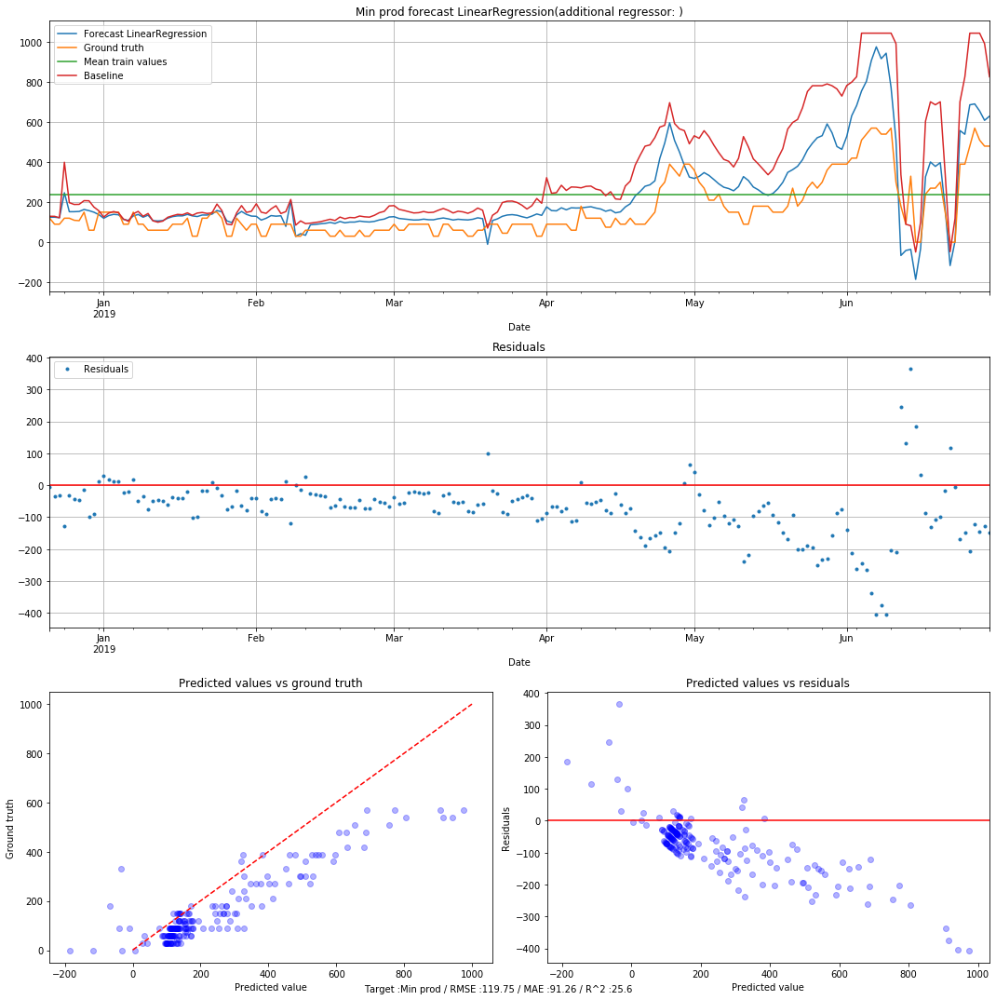

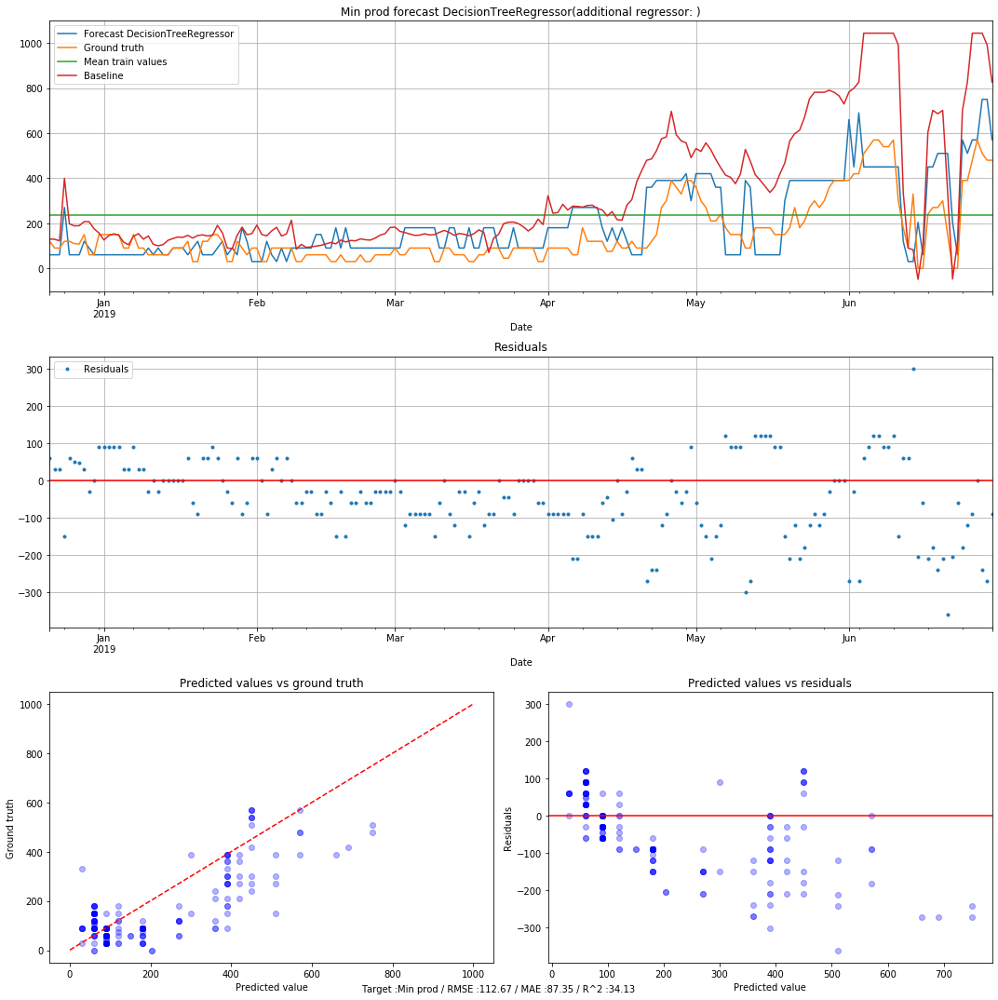

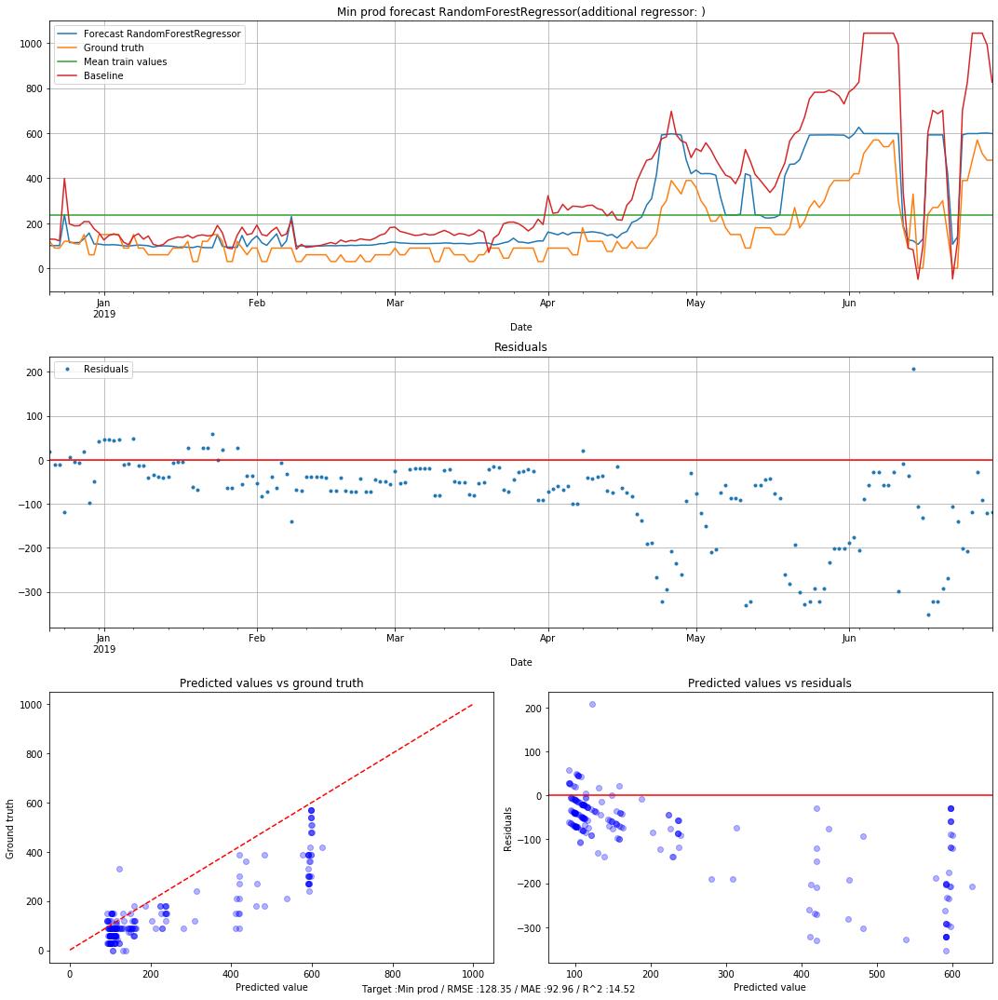

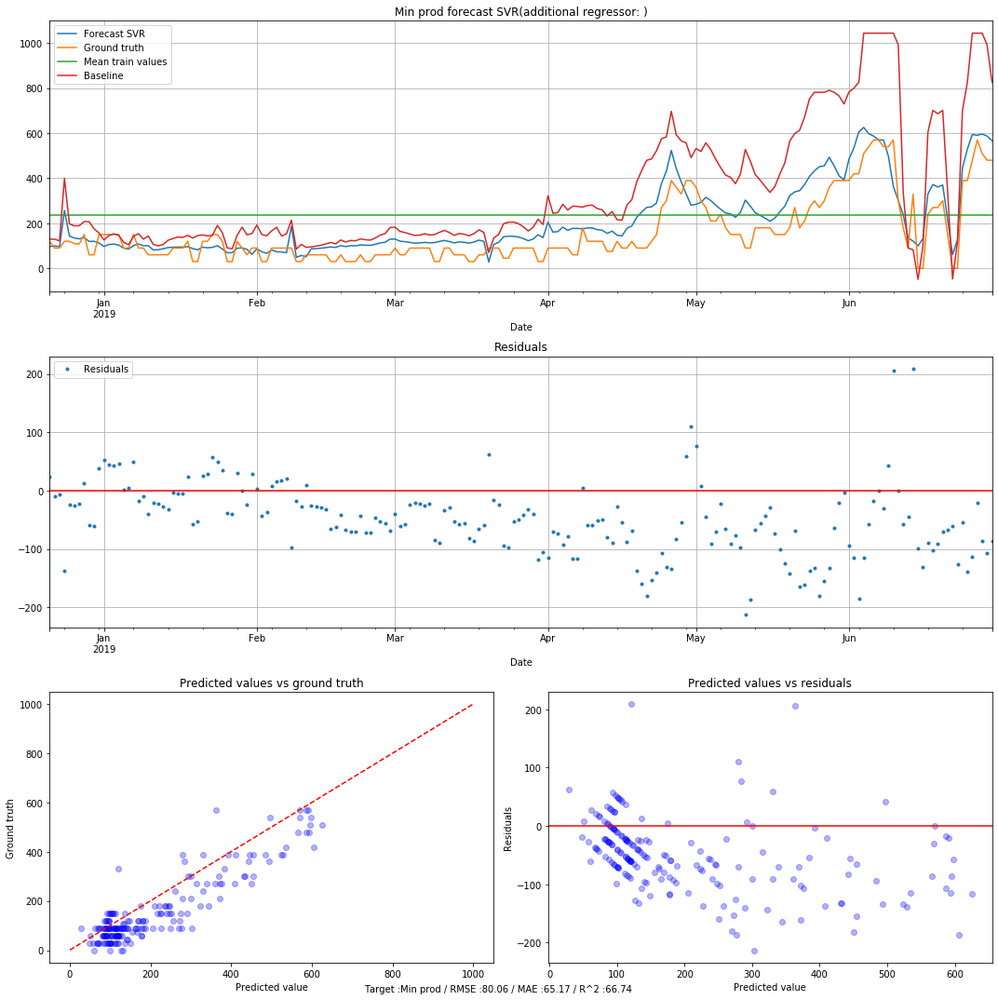

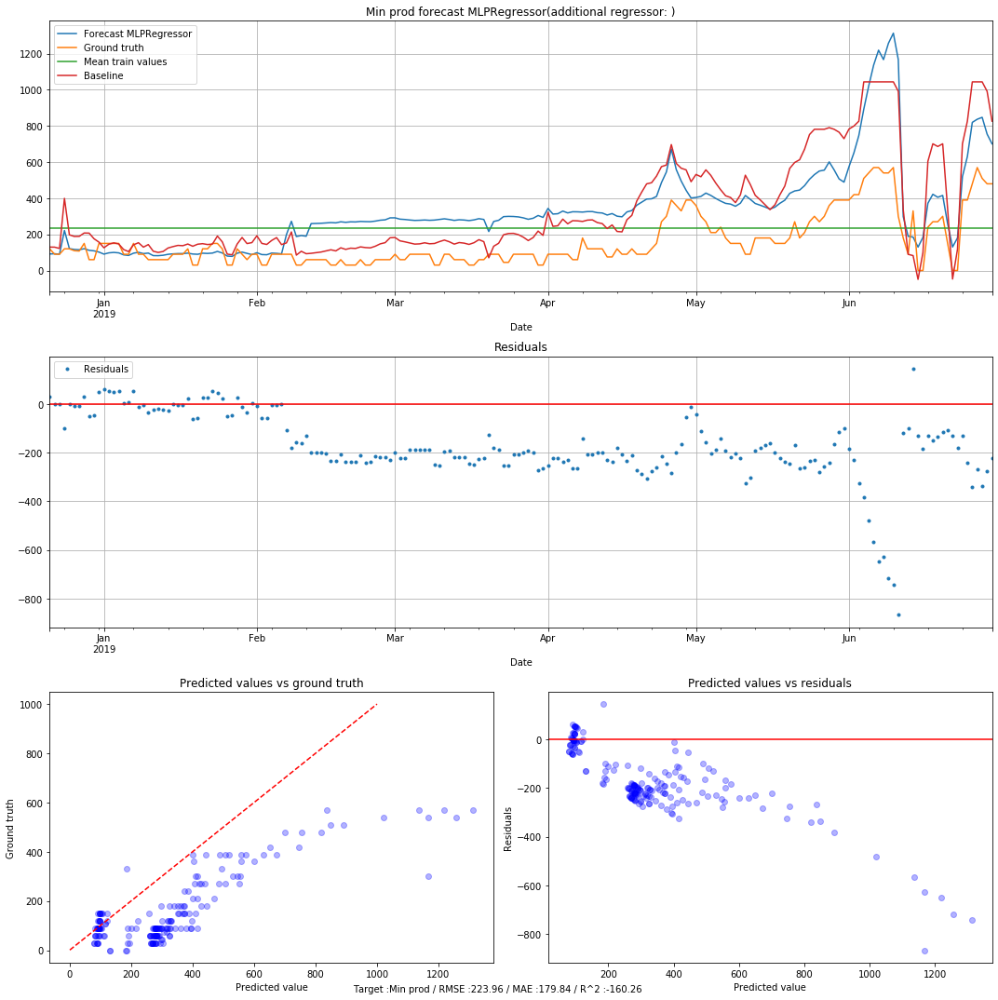

...

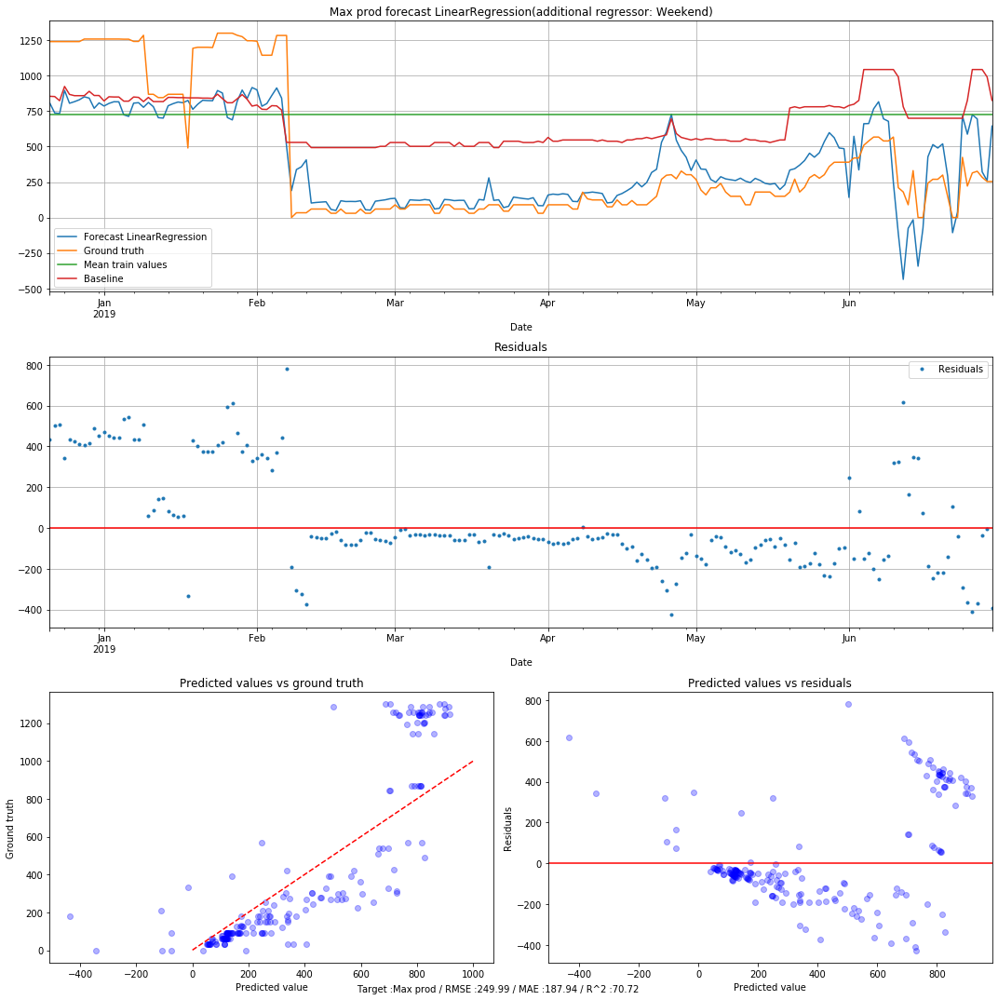

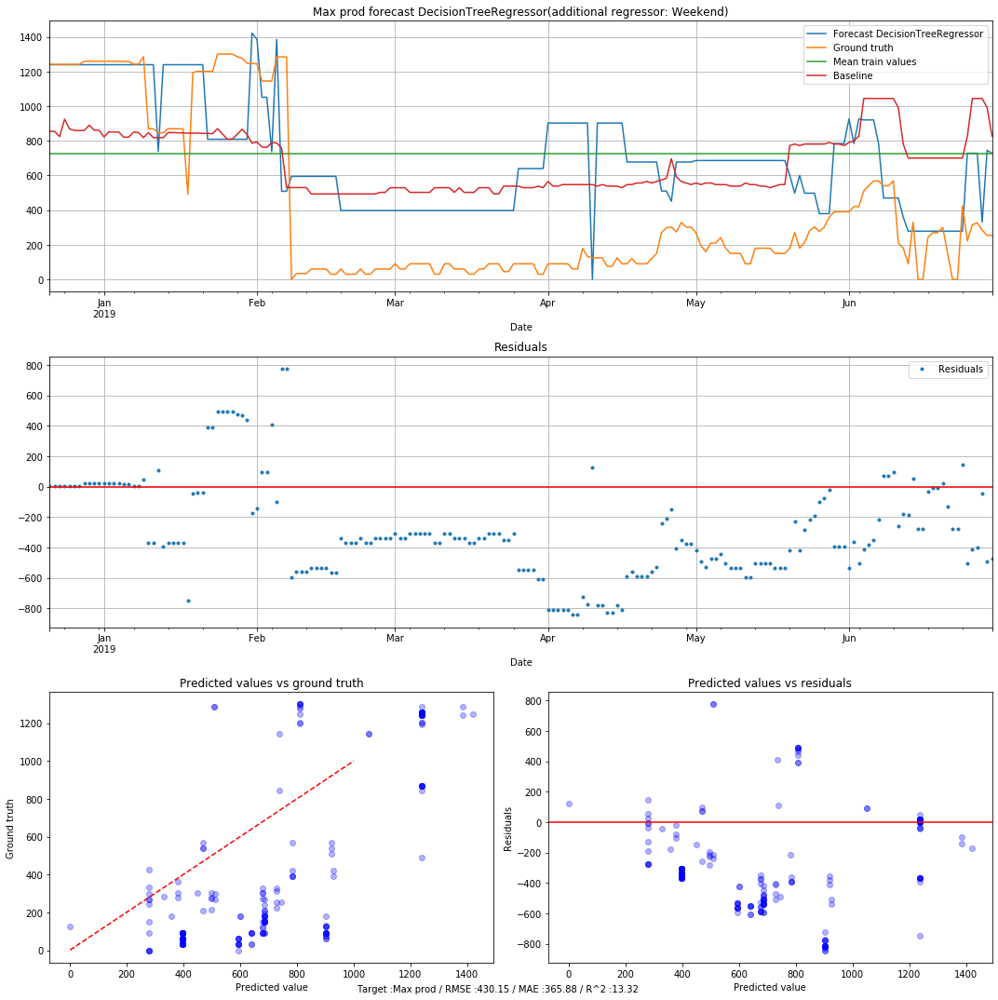

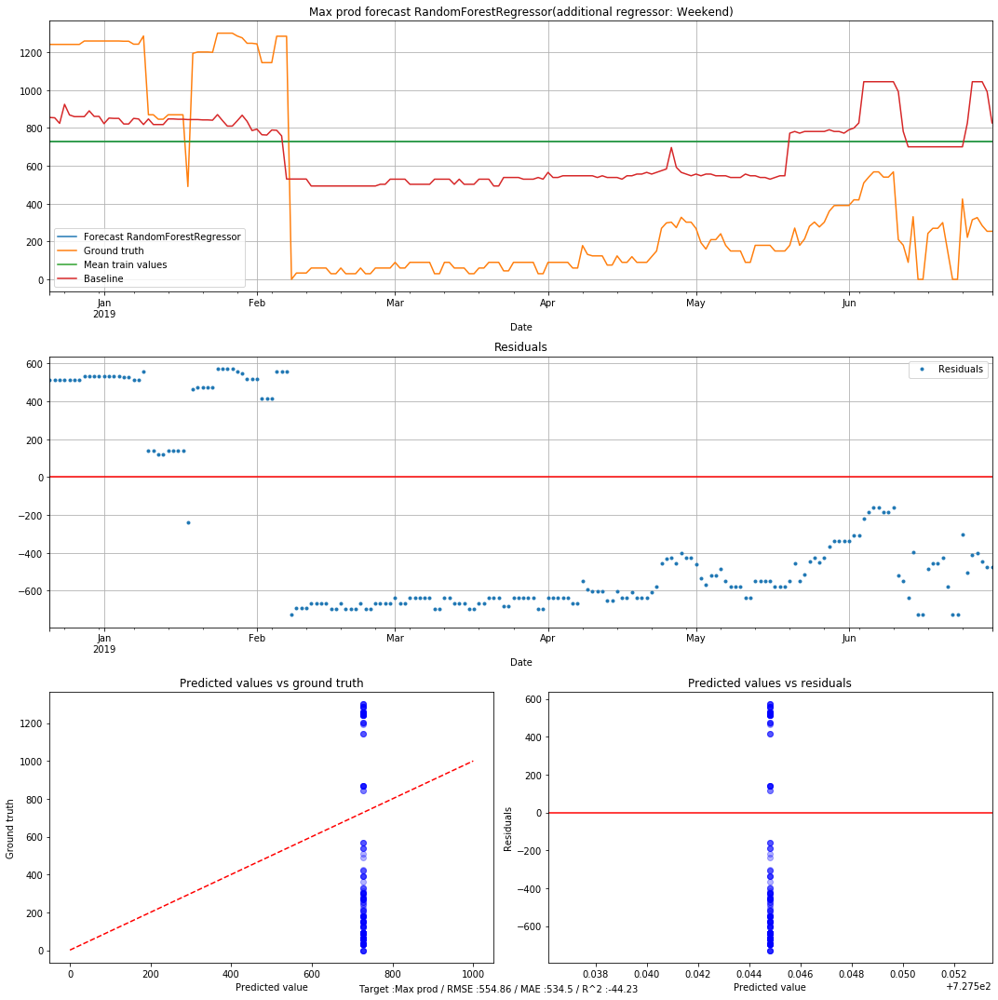

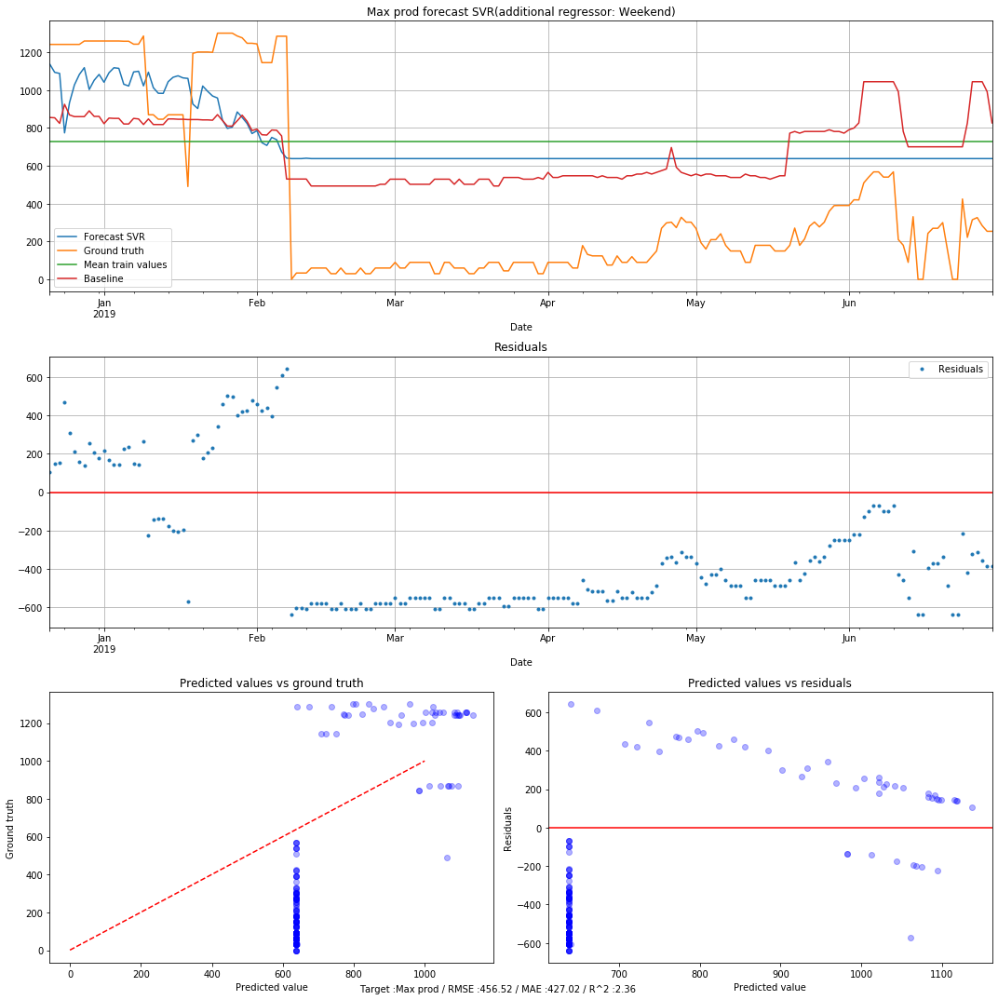

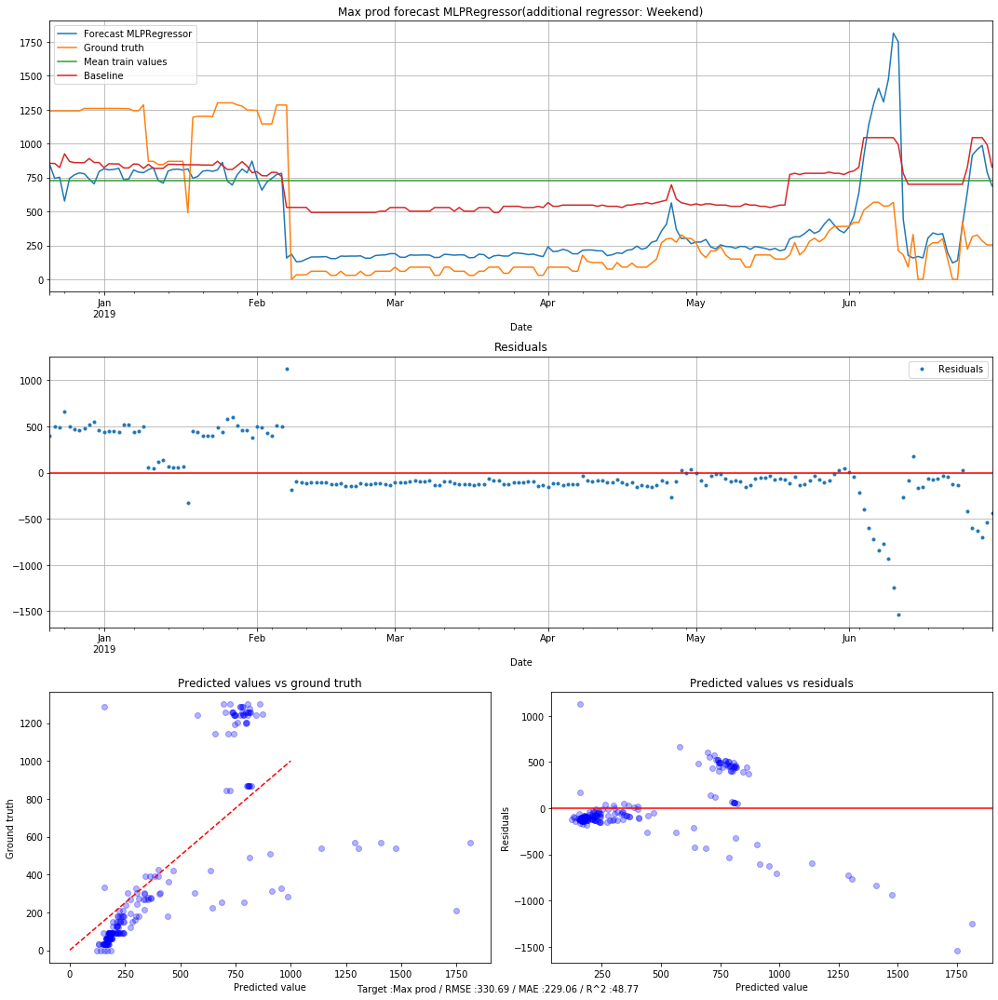

In [26]:
# Build list of algorithms and associated "usual" parameters to be tested
# call function to build train and test datasets, for the two target variables
# call function to tain and evaluate models (plotting results)
#
# Build a table of results: 
#  - first column contains algorithm name
#  - second column contains target feature
#  - third column contains list of input features
#  - next columns contain error metrics (RMSE, MAE, R2) 
#  - last column contains best parameters
#  - lines contain algorithm name (linear regression, RF, SVR, ...) 

models = [ LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor(), SVR(), MLPRegressor()] 
params = [{} , # linear regression
          {} , # Decision tree
          {'model__n_estimators' : [500,1000,1500,2000],
           'model__max_depth': [5,7,9,12, 15, 18,None],
           'model__min_samples_split':[0.1,0.5,1.0]
           }, # Random forest
          {'model__C': [1, 10, 100, 1000],
           'model__kernel': ['linear','rbf'], 
           'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10],
           'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]
          }, # Support Vector Regression
          {}] # Multi layer perceptron regressor

AddRegressors = ['', 'Max lake 1 [1000m3]','Weekend']

columns = ['Algorithm','Target','Features','RMSE','MAE','R^2', 'Parameters']
df_results = pd.DataFrame(columns = columns)
line_nb = 0

for target_feature in ["Min prod","Max prod"]:
    for addRegressor in AddRegressors:
        print("Additional regressor: ", addRegressor)
        fullRegressors = regressors + [addRegressor]
        xTrain, xTest, yTrain, yTest, yBaseLine =  GetDataSplit(df, fullRegressors,
                                                                target_feature, "Baseline_"+target_feature,0.9)
        for m,p in zip(models, params):
            res = TrainEvalModel(xTrain, xTest, yTrain, yTest, target_feature, yBaseLine, xTest.index, addRegressor, m, p)
            df_results.loc[line_nb,:] = [m,target_feature, xTest.columns, res[0], res[1], res[2], res[3]]
            line_nb = line_nb+1

### Detailed analysis of linear regression model 

We build this model and train it to extract the weights and provide clarity on results

In [450]:
regressors = ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', \
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', \
       'Availability plant 2 [%]', 'Availability plant 3 [%]', \
       'Availability plant 4 [%]', 'Weekend']

regr = linear_model.LinearRegression()

# define target
target_feature = "Max prod"
fullRegressors = regressors 

# scale input values between 0 and 1, so coefficients are comparable
scaler = MinMaxScaler()
scaled_df = scaler.fit_transform(df[fullRegressors])

scaled_df= pd.DataFrame(scaled_df, columns = fullRegressors)

xTrain, xTest, yTrain, yTest, yBaseLine =  GetDataSplit(scaled_df, fullRegressors,
                                                        target_feature, "Baseline_"+target_feature,0.9)
    
# Train the model using the training sets
regr.fit(xTrain, yTrain)

# Make predictions using the testing set
pred = regr.predict(xTest)

# The coefficients
print('Coefficients:  \n', np.round(regr.coef_,2))

Coefficients:  
 [-796.95 -852.7  1062.94   62.01  157.13 -153.31  498.45  386.09  305.88
  -59.38]


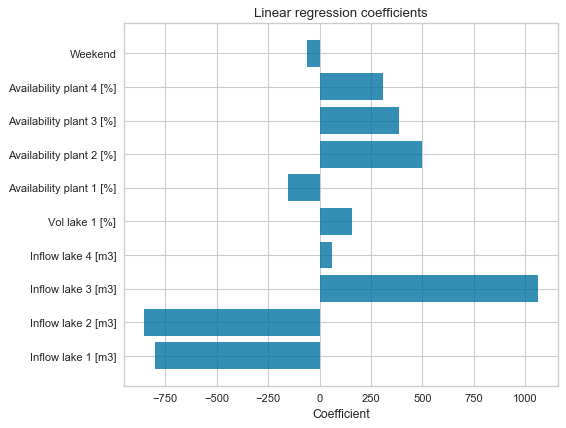

In [451]:
fig=plt.figure(figsize=(7, 6), dpi= 80, edgecolor='k')
plt.barh(range(len(regr.coef_)), regr.coef_, align='center', alpha=0.8)
plt.yticks(range(len(regr.coef_)), fullRegressors)
plt.xlabel('Coefficient')
plt.title('Linear regression coefficients')

plt.show()

### Detailed analysis of SVR model

We build the SVR with best parameters and analyse variable importance 


In [470]:
# we add max lake and weekend to the list of regressors
regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]', 'Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]' , 'Weekend' ] 

In [471]:
# best parameters: {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}

model =  SVR()

params =  [{'model__C': [100],
           'model__kernel': ['rbf'], 
           'model__epsilon': [5],
           'model__gamma': [0.005] 
          }]

# define target
target_feature = "Min prod"
xTrain, xTest, yTrain, yTest, yBaseLine =  GetDataSplit(df, regressors,
                                                        target_feature, "Baseline_"+target_feature,0.9)

# scaling
pipeline = Pipeline([('preprocessor', StandardScaler()),
                         ('model', model)])
    
grid = GridSearchCV(pipeline, params, scoring='r2', n_jobs=-1, cv=3, verbose=1)
grid.fit(xTrain, yTrain)
pred = grid.best_estimator_.predict(xTest)


Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


In [472]:
print('Target :', target_feature)
print('Regressors :', xTrain.columns)
print('Root Mean Square Error: %1.4f' % (math.sqrt(metrics.mean_squared_error(yTest,pred))))
print('Mean Absolute Error: %1.4f' % (metrics.mean_absolute_error(yTest,pred)))
print('R2 score : %1.4f' %(metrics.r2_score(yTest,pred)*100))
print('\n\n')

Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend'],
      dtype='object')
Root Mean Square Error: 75.9431
Mean Absolute Error: 61.4425
R2 score : 70.0738





In [473]:
xTest.iloc[190]

Inflow lake 1 [m3]           1614.6
Inflow lake 2 [m3]               83
Inflow lake 3 [m3]            609.2
Inflow lake 4 [m3]            479.1
Vol lake 1 [%]              0.70126
Availability plant 1 [%]          1
Availability plant 2 [%]          1
Availability plant 3 [%]          0
Availability plant 4 [%]          0
Weekend                        True
Name: 2019-06-29 00:00:00, dtype: object

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=6.37823e-28): result may not be accurate.
  overwrite_a=True).T


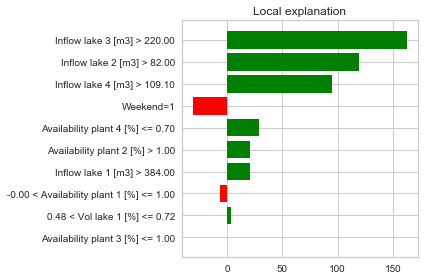

In [474]:
from lime.lime_tabular import LimeTabularExplainer

explainer = LimeTabularExplainer(xTrain.values,
    feature_names=xTrain.columns,
    class_names=['Min prod'],
    categorical_features=[9],
    mode='regression')

# Now explain a prediction
exp = explainer.explain_instance(xTest.iloc[190],  grid.best_estimator_.predict,
        num_features=10)

fig_size = plt.rcParams["figure.figsize"]  
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size  
exp.as_pyplot_figure()
plt.tight_layout()

### Algorithms ranking

In [459]:
# display results table 
df_results[df_results["Target"]=='Min prod'].sort_values(by=['Target','RMSE']).head()

,Algorithm,Target,Features,RMSE,MAE,R^2,Parameters
13,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",75.9431,61.4425,70.0738,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
3,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",80.2263,64.7046,66.6029,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
12,"RandomForestRegressor(bootstrap=True, criterio...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",99.2355,71.853,48.9014,{}
11,"DecisionTreeRegressor(criterion='mse', max_dep...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",111.684,85.7012,35.2769,{}
10,"LinearRegression(copy_X=True, fit_intercept=Tr...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",114.696,87.2005,31.7395,{}


In [341]:
df_results[df_results["Target"]=='Max prod'].sort_values(by=['Target','RMSE']).head()

,Algorithm,Target,Features,RMSE,MAE,R^2,Parameters
23,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",217.853,167.744,77.7657,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
28,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",242.063,200.899,72.5492,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
18,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",245.503,207.061,71.7635,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
20,"LinearRegression(copy_X=True, fit_intercept=Tr...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",246.364,211.871,71.565,{}
25,"LinearRegression(copy_X=True, fit_intercept=Tr...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",249.99,187.935,70.722,{}


In [342]:
# Create column with only algo name (no parameters)
df_results["Algo name"] = df_results['Algorithm'].apply(lambda s: str(s)[:str(s).find('(')])

In [343]:
# display best results per algorithm
best = pd.merge(df_results.groupby(['Algo name','Target'])['RMSE'].min(),df_results,on = ['Algo name','Target','RMSE'])
best[["Algo name","Target","RMSE","MAE","R^2"]].sort_values('RMSE')

,Algo name,Target,RMSE,MAE,R^2
9,SVR,Min prod,75.9431,61.4425,70.0738
1,DecisionTreeRegressor,Min prod,102.956,79.0651,44.9979
7,RandomForestRegressor,Min prod,107.604,88.86,39.9196
3,LinearRegression,Min prod,114.696,87.2005,31.7395
8,SVR,Max prod,217.853,167.744,77.7657
5,MLPRegressor,Min prod,224.653,177.613,-161.878
2,LinearRegression,Max prod,246.364,211.871,71.565
4,MLPRegressor,Max prod,339.803,243.241,45.9058
0,DecisionTreeRegressor,Max prod,340.33,267.413,45.7379
6,RandomForestRegressor,Max prod,359.217,323.743,39.5479


## Features engineering to improve predicting power

In [480]:
# Concerning minimum production, as ACF suggests, we try adding calculated features to improve performance
# compute lagged feature: minimum power with one year lag. For first year, use average value for all available dates

from datetime import datetime, timedelta

LaggedMinPow = pd.Series(np.zeros(len(df)), index = df.index) # initialize to 
lag = timedelta(days=365)
for index in df.index:
    LaggedMinPow[index] = df.loc[index-lag,"Min prod"] if index-lag in df.index \
                             else statistics.mean([df.loc[index+i*lag,"Min prod"] for i in range(5)]) 
    
df["LaggedMinPow"] = LaggedMinPow

In [481]:
# Same but average value over 5 days 365 days in the past (2 days before, days after)
LaggedAvgMinPow = pd.Series(np.zeros(len(df)), index = df.index) # initialize to 
lag = timedelta(days=365)

for index in df.index:
    LaggedAvgMinPow[index] = np.average(df.loc[index-lag-timedelta(days=2):index-lag+timedelta(days=2),"Min prod"]) \
                                if index-lag-timedelta(days=2) in df.index else df.loc[index,"Min prod"]
df["LaggedAvgMinPow"] = LaggedAvgMinPow

Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedMinPow'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 137.8593
Mean Absolute Error: 94.7158
R2 score : 1.3842





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedMinPow'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 135.3032
Mean Absolute Error: 85.3664
R2 score : 5.0072





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   15.2s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.5min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedMinPow'],
      dtype='object')
Parameters:  {'model__max_depth': 5, 'model__min_samples_split': 0.1, 'model__n_estimators': 1500}
Root Mean Square Error: 130.2090
Mean Absolute Error: 93.9938
R2 score : 12.0255



Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 1112 tasks      | elapsed:   24.0s
[Parallel(n_jobs=-1)]: Done 1647 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:  1.6min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedMinPow'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 89.2483
Mean Absolute Error: 67.5227
R2 score : 58.6692



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedMinPow'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 223.4784
Mean Absolute Error: 172.7574
R2 score : -159.1468



Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedAvgMinPow'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 169.8619
Mean Absolute Error: 109.4912
R2 score : 

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedAvgMinPow'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 146.0220
Mean Absolute Error: 93.8572
R2 score : -10.6398





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   15.8s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.5min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedAvgMinPow'],
      dtype='object')
Parameters:  {'model__max_depth': 9, 'model__min_samples_split': 0.1, 'model__n_estimators': 500}
Root Mean Square Error: 141.4073
Mean Absolute Error: 101.3910
R2 score : -3.7573



Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 1112 tasks      | elapsed:   23.6s
[Parallel(n_jobs=-1)]: Done 1637 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:  1.6min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedAvgMinPow'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 10, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 110.1817
Mean Absolute Error: 78.8040
R2 score : 37.0068



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_s

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedAvgMinPow'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 255.9795
Mean Absolute Error: 195.7478
R2 score : -240.0049



Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'TotalAvailablePower'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 114.6957
Mean Absolute Error: 87.2005
R2 sc

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'TotalAvailablePower'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 105.4207
Mean Absolute Error: 83.0650
R2 score : 42.3331





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{'model__n_estimators': [500, 1000, 1500, 2000], 'model__max_depth': [5, 7, 9, 12, 15, 18, None], 'model__min_samples_split': [0.1, 0.5, 1.0]}
Fitting 3 folds for each of 84 candidates, totalling 252 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 252 out of 252 | elapsed:  1.5min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'TotalAvailablePower'],
      dtype='object')
Parameters:  {'model__max_depth': 5, 'model__min_samples_split': 0.1, 'model__n_estimators': 500}
Root Mean Square Error: 128.6772
Mean Absolute Error: 94.1627
R2 score : 14.0832



Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [1, 10, 100, 1000], 'model__kernel': ['linear', 'rbf'], 'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10], 'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]}
Fitting 3 folds for each of 616 candidates, totalling 1848 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 1112 tasks      | elapsed:   24.0s
[Parallel(n_jobs=-1)]: Done 1637 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 1848 out of 1848 | elapsed:  2.0min finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'TotalAvailablePower'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 10, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 76.4734
Mean Absolute Error: 62.3080
R2 score : 69.6544



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, war

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.8s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'TotalAvailablePower'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 219.3304
Mean Absolute Error: 177.6954
R2 score : -149.6161





C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


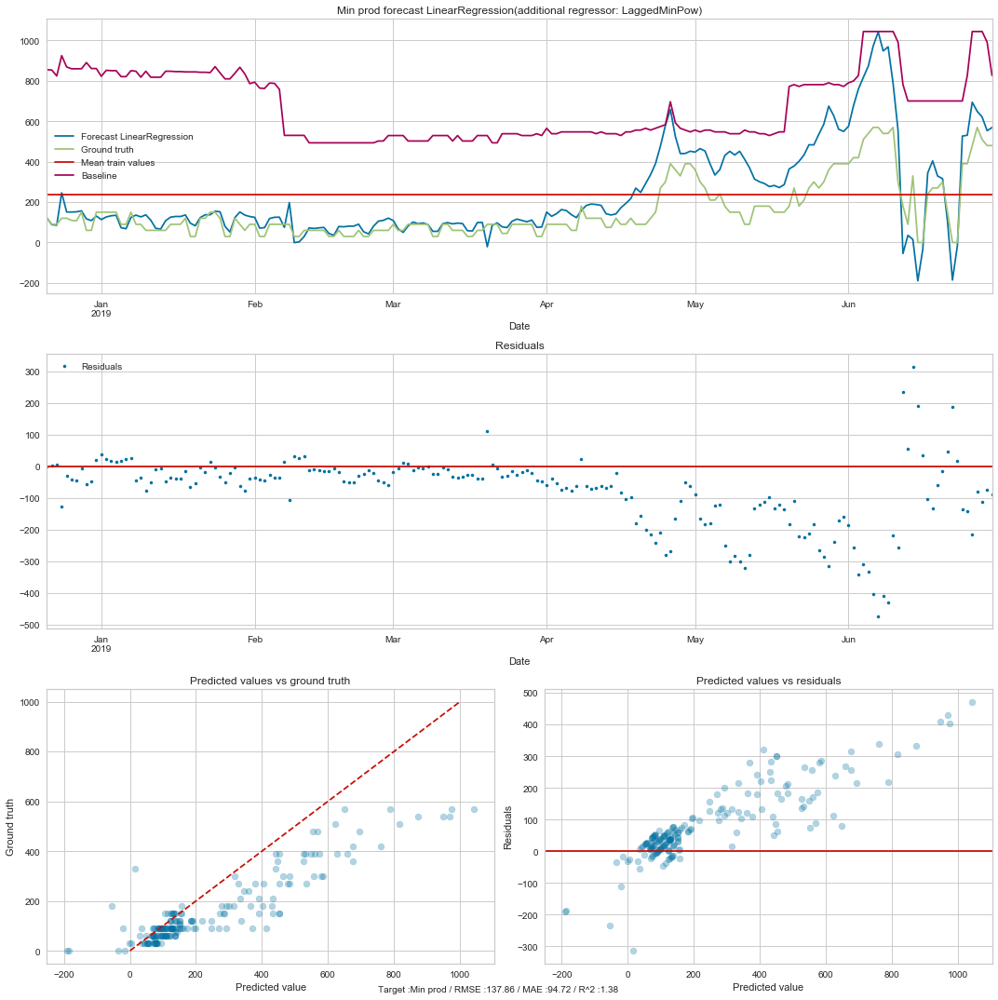

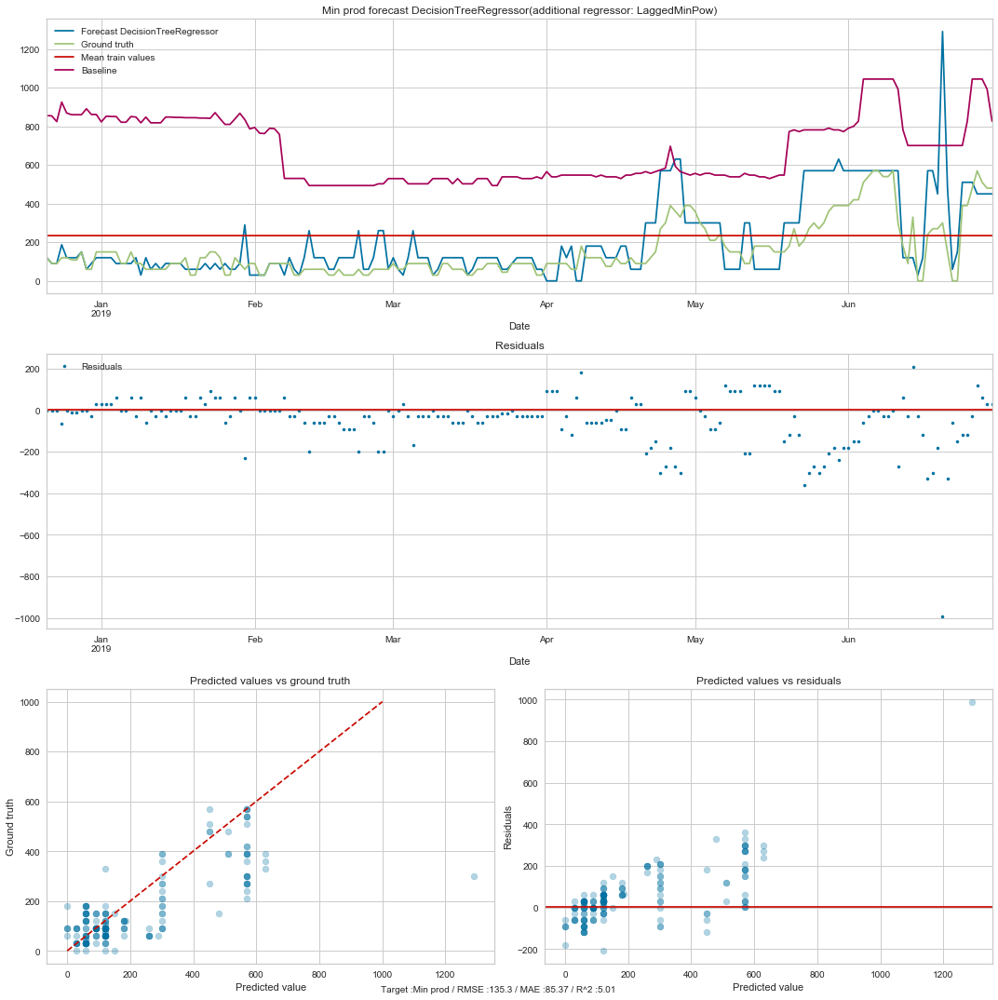

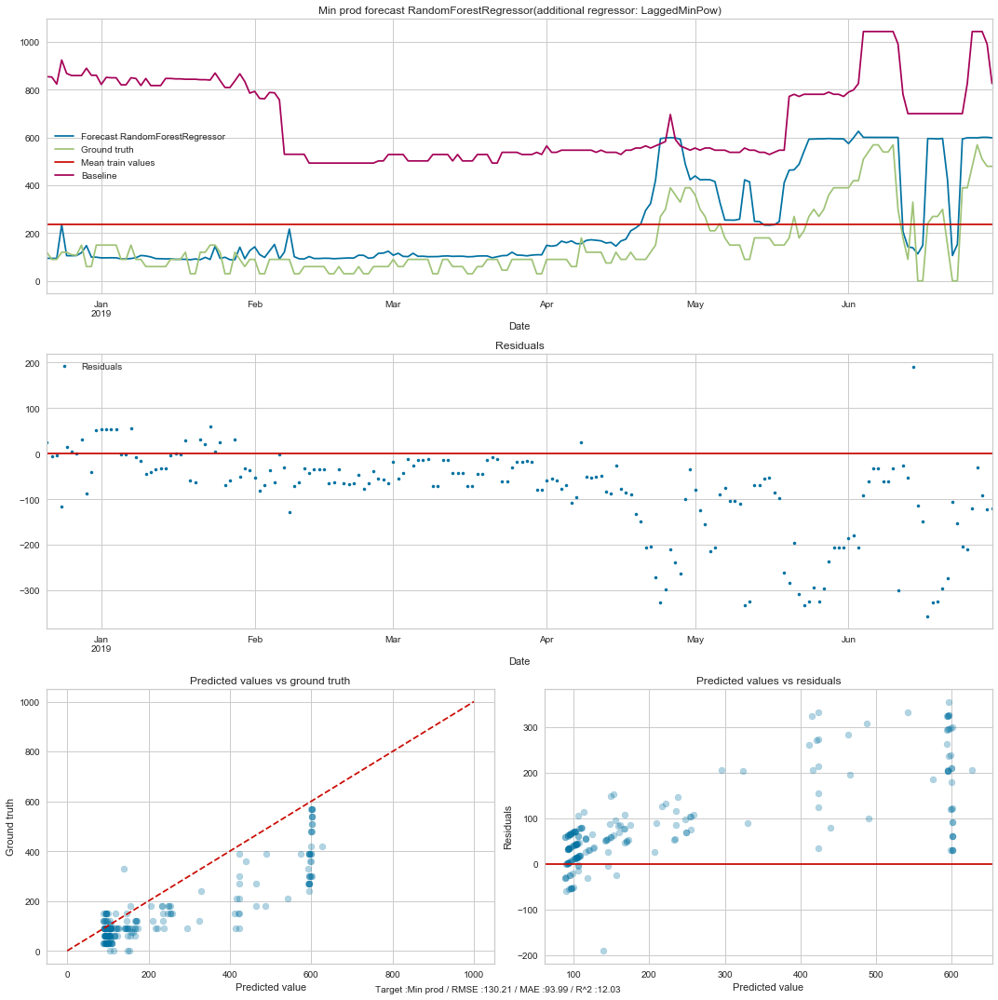

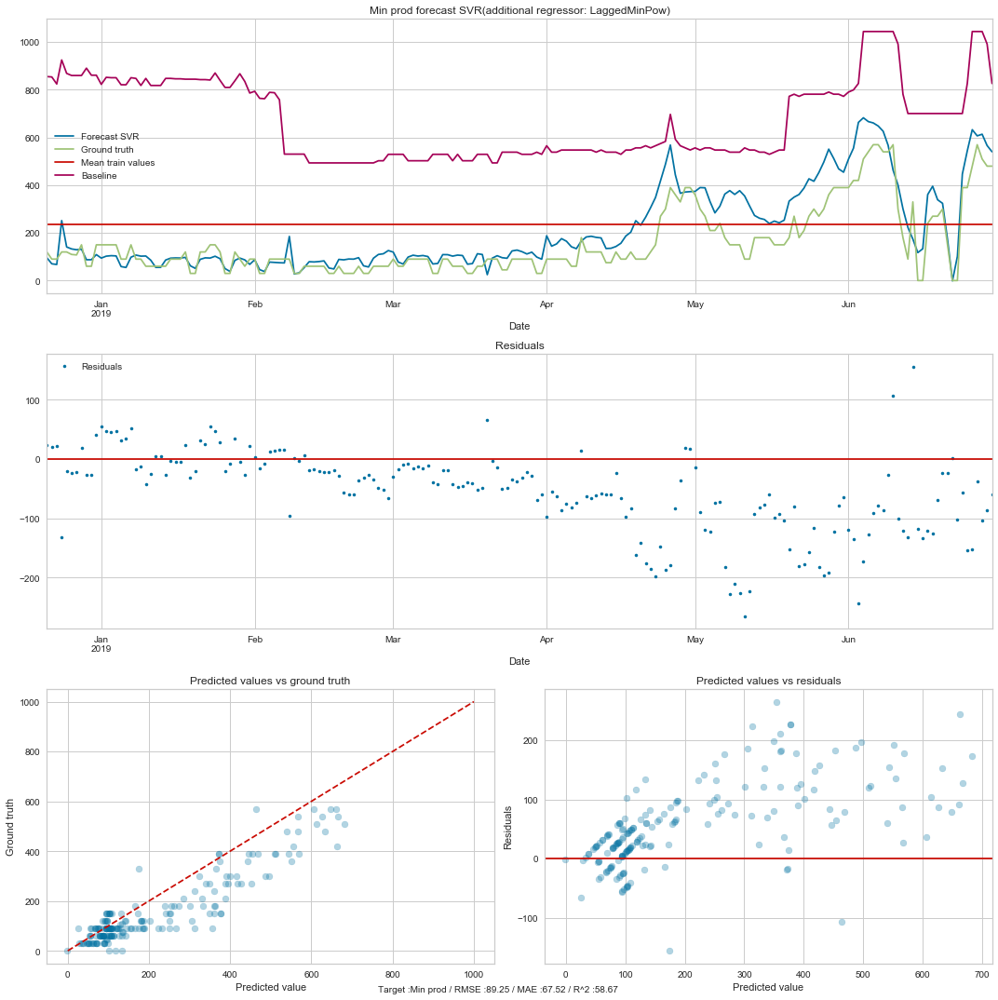

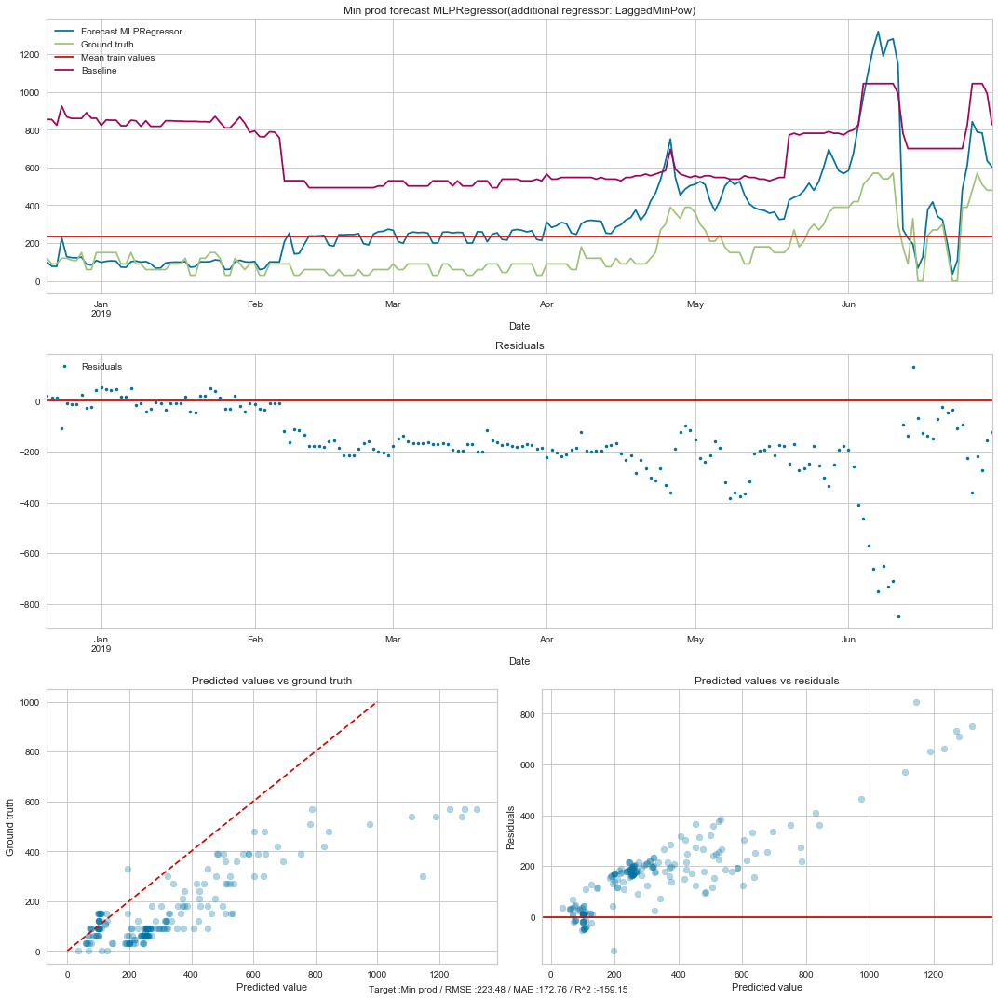

...

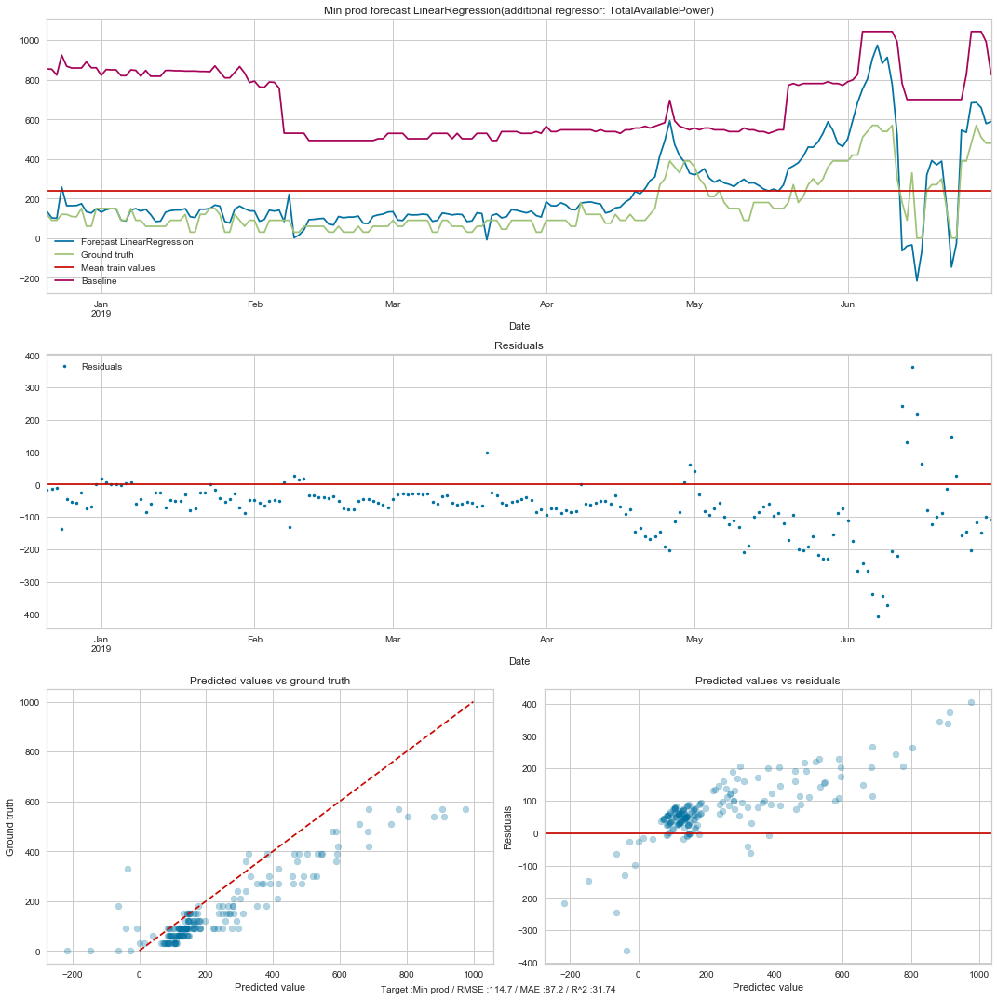

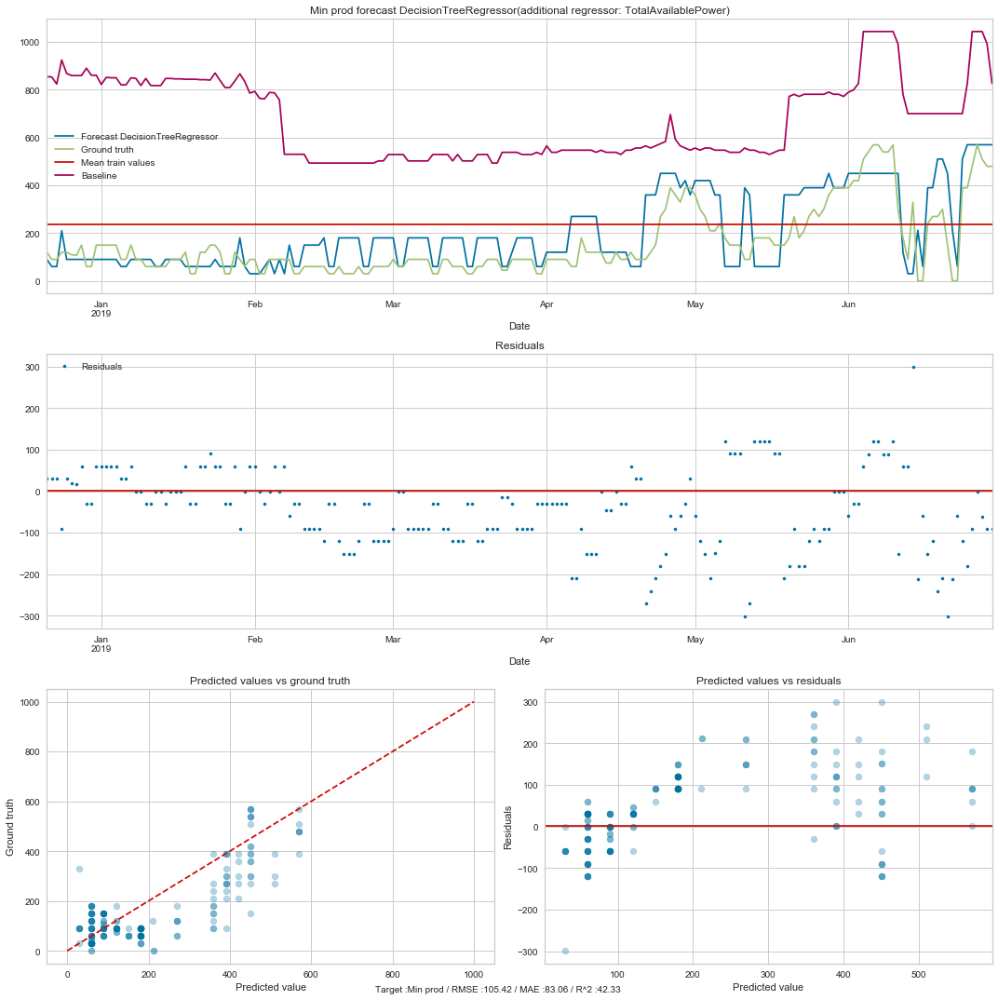

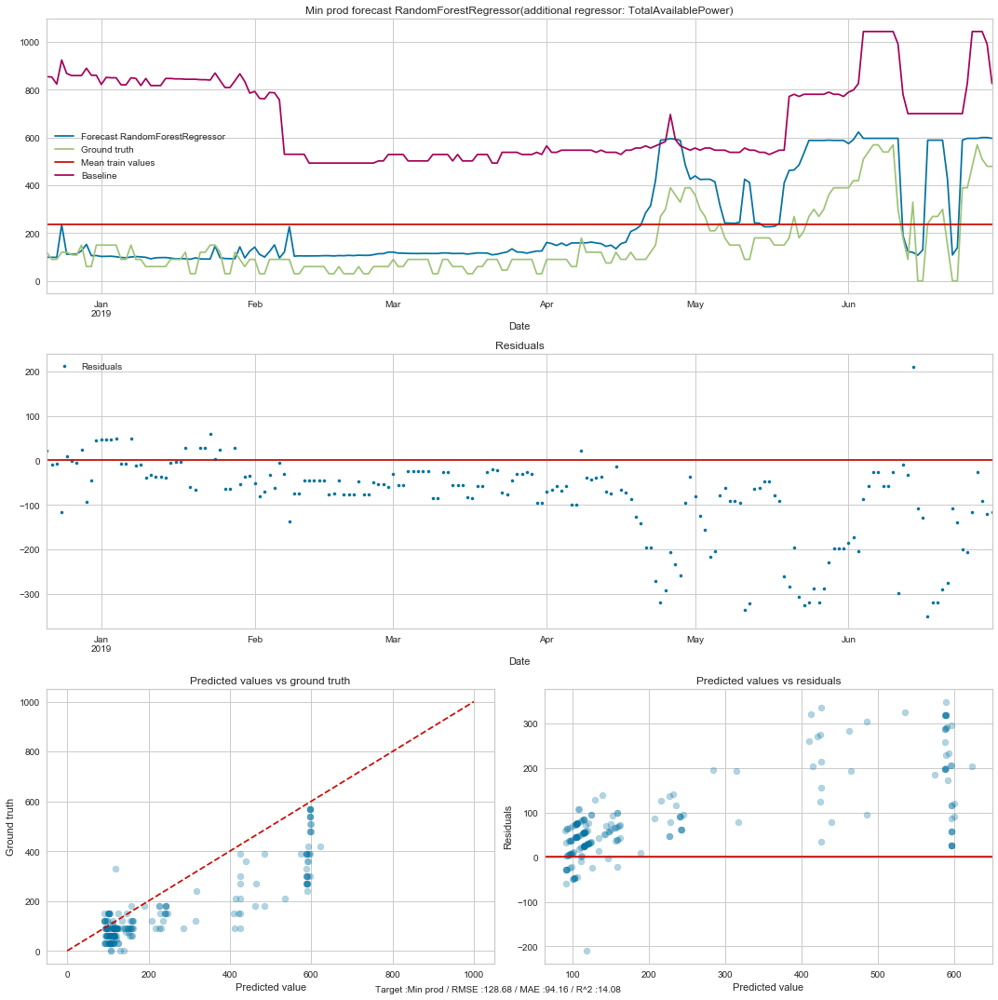

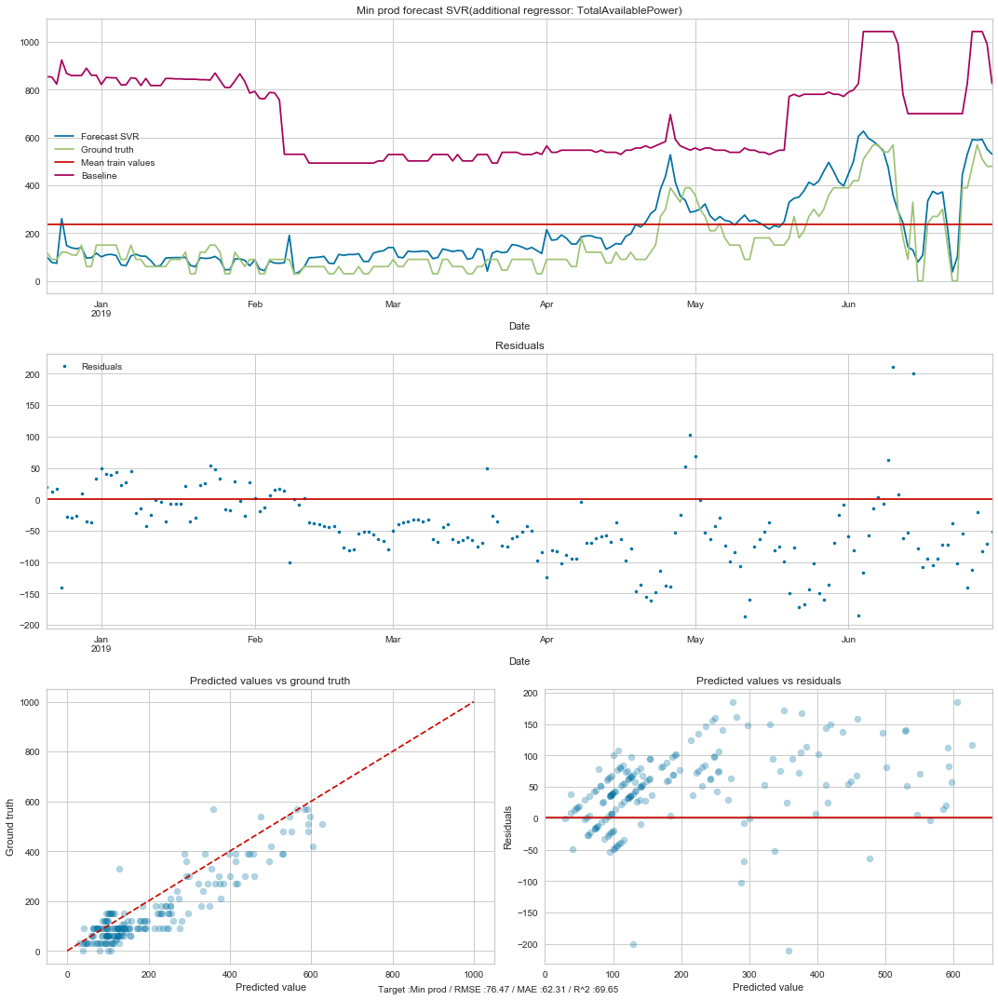

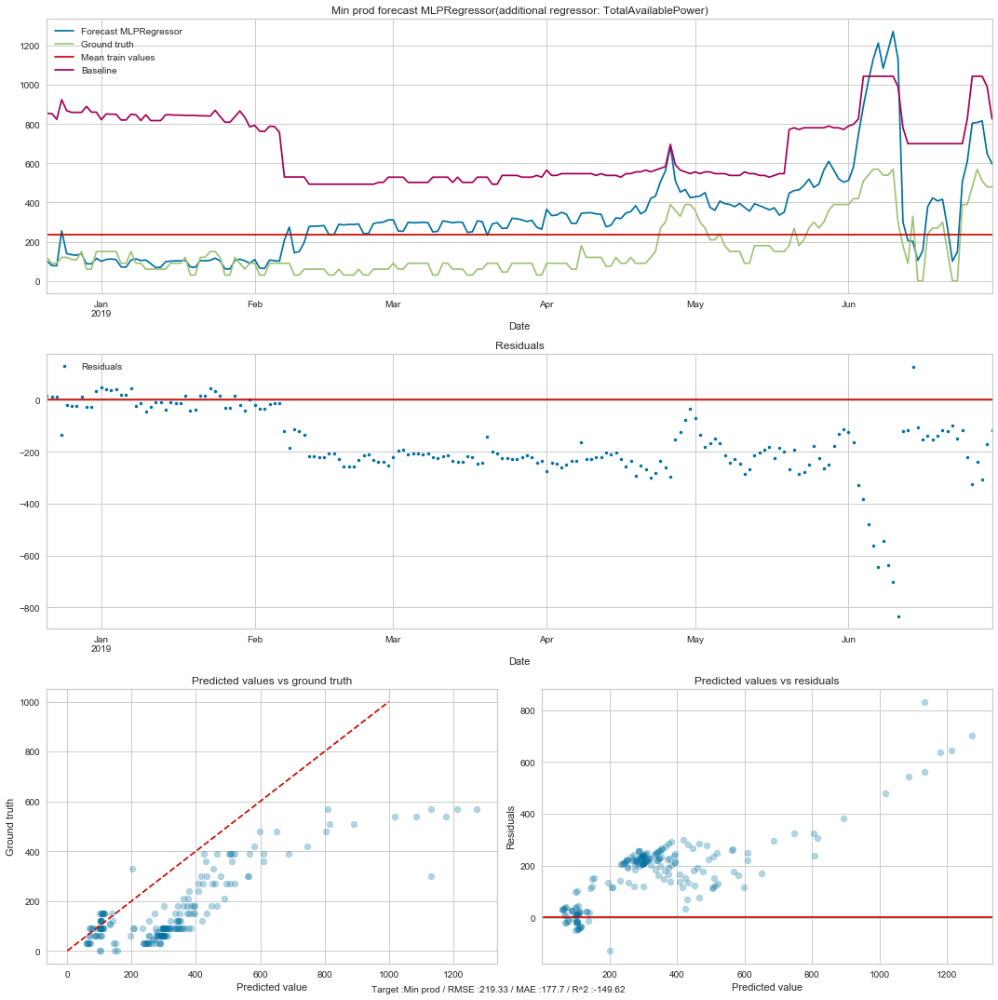

In [482]:

models = [ LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor(), SVR(), MLPRegressor()] 
params = [{}, # linear regression
          {}, # Decision tree
          {'model__n_estimators' : [500,1000,1500,2000],
           'model__max_depth': [5,7,9,12, 15, 18,None],
           'model__min_samples_split':[0.1,0.5,1.0]
          }, # Random forest
          {'model__C': [1, 10, 100, 1000],
           'model__kernel': ['linear','rbf'],
           'model__epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10],
           'model__gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]
          }, # Support Vector Regression
          {}] # Multi layer perceptron regressor

regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]','Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]', 'Weekend']
AddRegressors = ['LaggedMinPow','LaggedAvgMinPow', 'TotalAvailablePower']
target_feature = "Min prod"

columns = ['Algorithm','Target','Features','RMSE','MAE','R^2', 'Parameters']
df_resLagFT = pd.DataFrame(columns = columns)
line_nb = 0

for addRegressor in AddRegressors:
    fullRegressors = regressors + [addRegressor]
    xTrain, xTest, yTrain, yTest, yBaseline = GetDataSplit(df, fullRegressors,target_feature,"Baseline_"+target_feature, 0.9)
    for m,p in zip(models, params):
        res = TrainEvalModel(xTrain, xTest, yTrain, yTest, target_feature, yBaseLine, xTest.index, addRegressor, m, p)
        df_resLagFT.loc[line_nb,:] = [m,target_feature, xTest.columns, res[0], res[1], res[2], res[3]]
        line_nb = line_nb+1

In [483]:
# display results table
df_resLagFT.sort_values(by=['Target','RMSE']).head()

,Algorithm,Target,Features,RMSE,MAE,R^2,Parameters
13,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",76.4734,62.308,69.6544,"{'model__C': 100, 'model__epsilon': 10, 'model..."
3,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",89.2483,67.5227,58.6692,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
11,"DecisionTreeRegressor(criterion='mse', max_dep...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",105.421,83.065,42.3331,{}
8,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",110.182,78.804,37.0068,"{'model__C': 100, 'model__epsilon': 10, 'model..."
10,"LinearRegression(copy_X=True, fit_intercept=Tr...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",114.696,87.2005,31.7395,{}


In [484]:
# Concerning both minimum and maximum production, assumption is made that the lake constraint plays a role in the future,
# i.e. if there will be a empty lake constraint in the next days, it makes sense that minimum production should increase
# to force emptying the lake. For the same reason, maximum production is certainly higher too. 
# We compute an additional feature that is 1 if there is such a lake constrain in the next 30 days, 0 otherwise, i.e. max 
# level goes below a given threshold (500)
LakeThreshold = 5000
LaggedLakeConstraint = pd.Series(np.zeros(len(df)), index = df.index) # initialize to 0 
for i in range(10,60,5): 
    lag = timedelta(days=i)
    for index in df.index:
        LaggedLakeConstraint[index] = 1 if index+lag in df.index and np.min(df.loc[index:index+lag,"Max lake 1 [1000m3]"])<LakeThreshold  else 0
    df["LaggedLakeConstraint"+str(i)] = LaggedLakeConstraint

In [485]:
df.head()

,Date,Min prod,Inflow lake 1 [m3],Inflow lake 2 [m3],Inflow lake 3 [m3],Inflow lake 4 [m3],Vol lake 1 [%],Max lake 1 [1000m3],Availability plant 1 [%],Availability plant 2 [%],...,LaggedLakeConstraint20,LaggedLakeConstraint25,LaggedLakeConstraint30,LaggedLakeConstraint35,LaggedLakeConstraint40,LaggedLakeConstraint45,LaggedLakeConstraint50,LaggedLakeConstraint55,LaggedMinPow,LaggedAvgMinPow
Date,,,,,,,,,,,,,,,,,,,,,
2014-04-01,2014-04-01,0.0,31.0,4.0,129.0,107.0,0.16467,30000.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,72.0,0.0
2014-04-02,2014-04-02,150.0,0.0,-14.0,148.0,116.0,0.15557,30000.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,108.0,150.0
2014-04-03,2014-04-03,150.0,10.0,6.0,132.0,118.0,0.14765,30000.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,108.0,150.0
2014-04-04,2014-04-04,150.0,19.0,6.0,150.0,118.0,0.13716,30000.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,108.0,150.0
2014-04-05,2014-04-05,180.0,41.0,15.0,148.0,124.0,0.13091,30000.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,144.0,180.0


In [486]:
LaggedLakeConstraint[LaggedLakeConstraint>0].head()

Date
2017-02-25    1.0
2017-02-26    1.0
2017-02-27    1.0
2017-02-28    1.0
2017-03-01    1.0
dtype: float64

Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 116.4515
Mean Absolute Error: 90.6218
R2 score : 29.6336





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 114.1382
Mean Absolute Error: 90.0080
R2 score : 32.4015





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 125.6366
Mean Absolute Error: 93.4222
R2 score : 18.0956





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 79.8451
Mean Absolute Error: 65.4379
R2 score : 66.9195



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, w

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.7s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 221.3856
Mean Absolute Error: 180.4944
R2 score : -154.3158



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 104.4790
Mean Absolute Error: 77.5106
R2 score : 43.3588





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 121.5741
Mean Absolute Error: 85.5909
R2 score : 23.3068





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 79.6485
Mean Absolute Error: 65.1847
R2 score : 67.0823



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, w

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 232.1106
Mean Absolute Error: 190.1880
R2 score : -179.5534



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 111.8797
Mean Absolute Error: 85.4889
R2 score : 35.0502





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 121.5755
Mean Absolute Error: 92.6363
R2 score : 23.3051





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 78.8736
Mean Absolute Error: 64.3545
R2 score : 67.7197



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, w

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.7s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 228.2177
Mean Absolute Error: 187.9506
R2 score : -170.2548



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 108.8815
Mean Absolute Error: 81.8136
R2 score : 38.4848





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 92.1071
Mean Absolute Error: 68.3364
R2 score : 55.9789





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 78.6218
Mean Absolute Error: 64.0157
R2 score : 67.9254



Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, w

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 230.6514
Mean Absolute Error: 186.5267
R2 score : -176.0496



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 113.4669
Mean Absolute Error: 83.2895
R2 score : 33.1943





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 130.7482
Mean Absolute Error: 89.0303
R2 score : 11.2954





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 78.0896
Mean Absolute Error: 63.4326
R2 score : 68.3582





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 232.9736
Mean Absolute Error: 196.3551
R2 score : -181.6361



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 115.4346
Mean Absolute Error: 89.0660
R2 score : 30.8572





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 103.4814
Mean Absolute Error: 70.3928
R2 score : 44.4352





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 77.4098
Mean Absolute Error: 62.7852
R2 score : 68.9067





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 227.1435
Mean Absolute Error: 184.1084
R2 score : -167.7166



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 116.6195
Mean Absolute Error: 91.8882
R2 score : 29.4305





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 105.7018
Mean Absolute Error: 77.8847
R2 score : 42.0251





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 77.6181
Mean Absolute Error: 63.0132
R2 score : 68.7392





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.7s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 240.2812
Mean Absolute Error: 196.0602
R2 score : -199.5810



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 104.3621
Mean Absolute Error: 80.4767
R2 score : 43.4855





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 105.1858
Mean Absolute Error: 78.5775
R2 score : 42.5898





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 77.3207
Mean Absolute Error: 62.6102
R2 score : 68.9782





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 234.8846
Mean Absolute Error: 189.6789
R2 score : -186.2753



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 118.3458
Mean Absolute Error: 91.4195
R2 score : 27.3257





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 104.6265
Mean Absolute Error: 78.7893
R2 score : 43.1987





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 77.3267
Mean Absolute Error: 62.7151
R2 score : 68.9735





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.7s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 236.0613
Mean Absolute Error: 192.8255
R2 score : -189.1508



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 106.0790
Mean Absolute Error: 79.5349
R2 score : 41.6106





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 112.3930
Mean Absolute Error: 83.6725
R2 score : 34.4529





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 77.4481
Mean Absolute Error: 62.8869
R2 score : 68.8760





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.7s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Min prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 232.2852
Mean Absolute Error: 189.4551
R2 score : -179.9741



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 445.6632
Mean Absolute Error: 373.8014
R2 score : 6.9513





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 322.8370
Mean Absolute Error: 284.0538
R2 score : 51.1726





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 264.3439
Mean Absolute Error: 187.4634
R2 score : 67.2633

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint10'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 438.1827
Mean Absolute Error: 382.1458
R2 score : 10.0488



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 457.4708
Mean Absolute Error: 395.3661
R2 score : 1.9555





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 361.2555
Mean Absolute Error: 315.4473
R2 score : 38.8600





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 285.2730
Mean Absolute Error: 196.4517
R2 score : 61.8743





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint15'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 415.7026
Mean Absolute Error: 355.1050
R2 score : 19.0416



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 454.3443
Mean Absolute Error: 397.5923
R2 score : 3.2910





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 406.3364
Mean Absolute Error: 358.4783
R2 score : 22.6486





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 289.3664
Mean Absolute Error: 196.1541
R2 score : 60.7723





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint20'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 423.2054
Mean Absolute Error: 364.2425
R2 score : 16.0928



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 405.5445
Mean Absolute Error: 360.9009
R2 score : 22.9498





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 366.5311
Mean Absolute Error: 329.5606
R2 score : 37.0612





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 277.7041
Mean Absolute Error: 190.5029
R2 score : 63.8705





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint25'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 417.9875
Mean Absolute Error: 366.4025
R2 score : 18.1491



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 462.1681
Mean Absolute Error: 402.4338
R2 score : -0.0683





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 343.1083
Mean Absolute Error: 304.5513
R2 score : 44.8483





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 267.8573
Mean Absolute Error: 182.6127
R2 score : 66.3873





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint30'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 380.9994
Mean Absolute Error: 317.0995
R2 score : 31.9943



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 471.0202
Mean Absolute Error: 418.3738
R2 score : -3.9383





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 331.9201
Mean Absolute Error: 291.3801
R2 score : 48.3864





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 271.0194
Mean Absolute Error: 180.0937
R2 score : 65.5890





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint35'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 353.1196
Mean Absolute Error: 269.1460
R2 score : 41.5829



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 437.2928
Mean Absolute Error: 378.4960
R2 score : 10.4138





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 402.2254
Mean Absolute Error: 350.3322
R2 score : 24.2058





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 266.6770
Mean Absolute Error: 174.6820
R2 score : 66.6829





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint40'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 353.9601
Mean Absolute Error: 262.9612
R2 score : 41.3044



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 452.7199
Mean Absolute Error: 409.1727
R2 score : 3.9813





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 416.3764
Mean Absolute Error: 371.6084
R2 score : 18.7789





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 254.3074
Mean Absolute Error: 173.8106
R2 score : 69.7019





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint45'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 370.6774
Mean Absolute Error: 300.9629
R2 score : 35.6292



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 469.0525
Mean Absolute Error: 402.8069
R2 score : -3.0718





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 361.9666
Mean Absolute Error: 324.4892
R2 score : 38.6190





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 253.6151
Mean Absolute Error: 179.7971
R2 score : 69.8667





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint50'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 357.2392
Mean Absolute Error: 262.5731
R2 score : 40.2119



Full list of regressors: ['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]', 'Availability plant 2 [%]', 'Availability plant 3 [%]', 'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55']
Model:  LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]'

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 426.5408
Mean Absolute Error: 366.3327
R2 score : 14.7650





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators='warn',
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 328.4378
Mean Absolute Error: 292.8820
R2 score : 49.4638





[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
    gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
    tol=0.001, verbose=False)
{'model__C': [100], 'model__kernel': ['rbf'], 'model__epsilon': [5], 'model__gamma': [0.005]}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.0s finished


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {'model__C': 100, 'model__epsilon': 5, 'model__gamma': 0.005, 'model__kernel': 'rbf'}
Root Mean Square Error: 249.0829
Mean Absolute Error: 183.8386
R2 score : 70.9341





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Model:  MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_iter=200, momentum=0.9,
             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
             random_state=None, shuffle=True, solver='adam', tol=0.0001,
             validation_fraction=0.1, verbose=False, warm_start=False)
{}
Fitting 3 folds for each of 1 candidates, totalling 3 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.6s finished
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Target : Max prod
Regressors : Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')
Parameters:  {}
Root Mean Square Error: 341.6521
Mean Absolute Error: 275.6373
R2 score : 45.3154





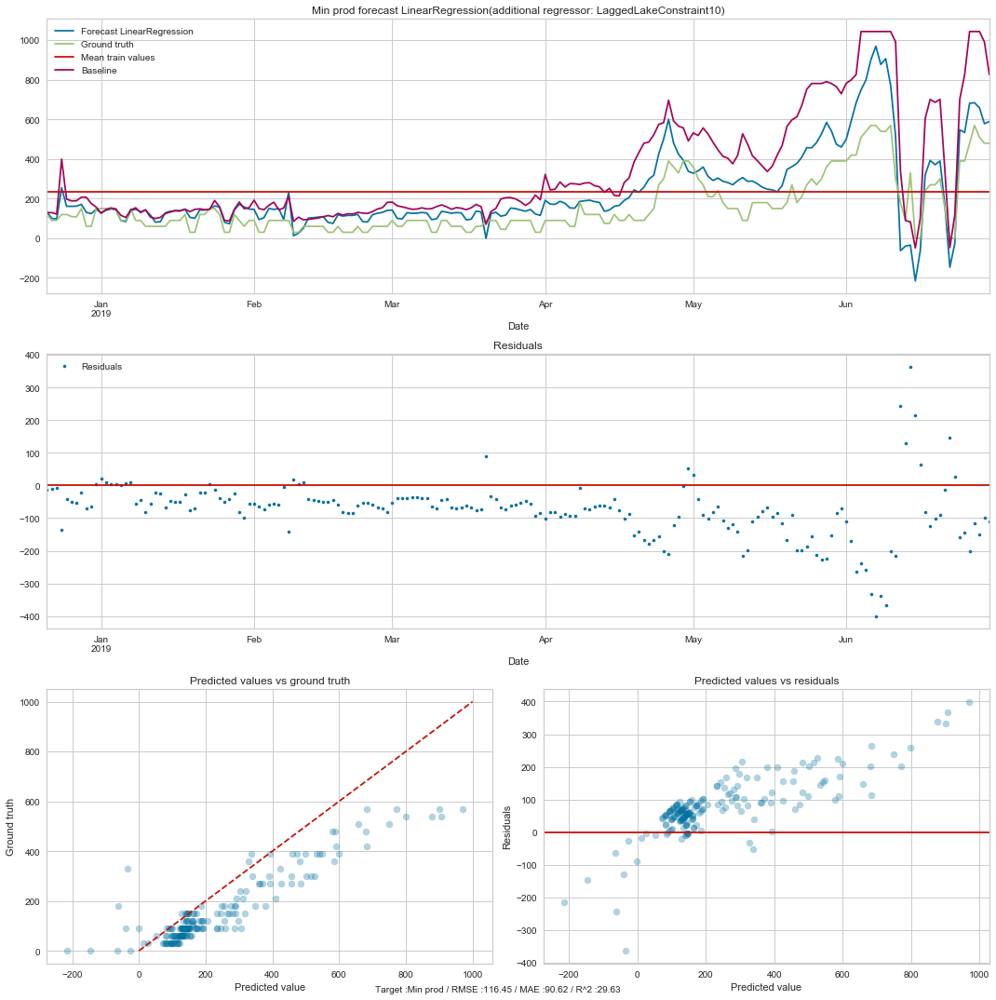

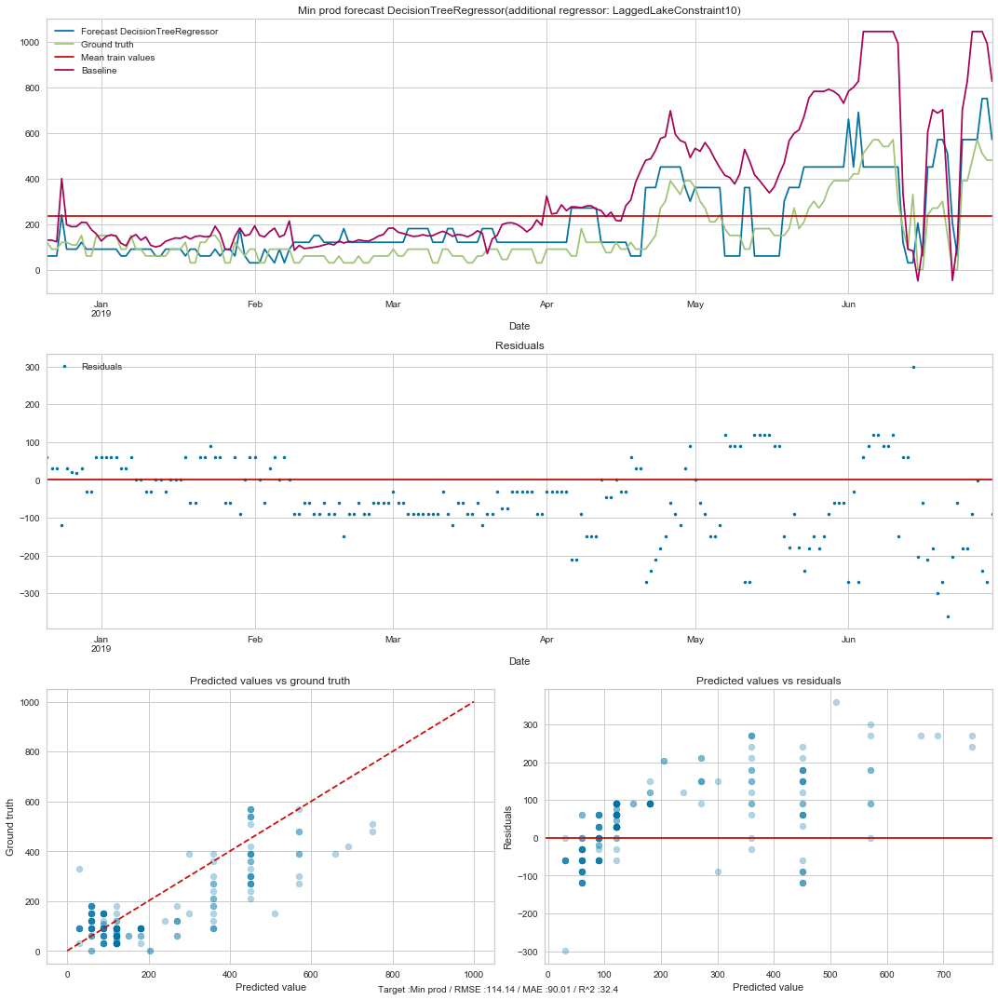

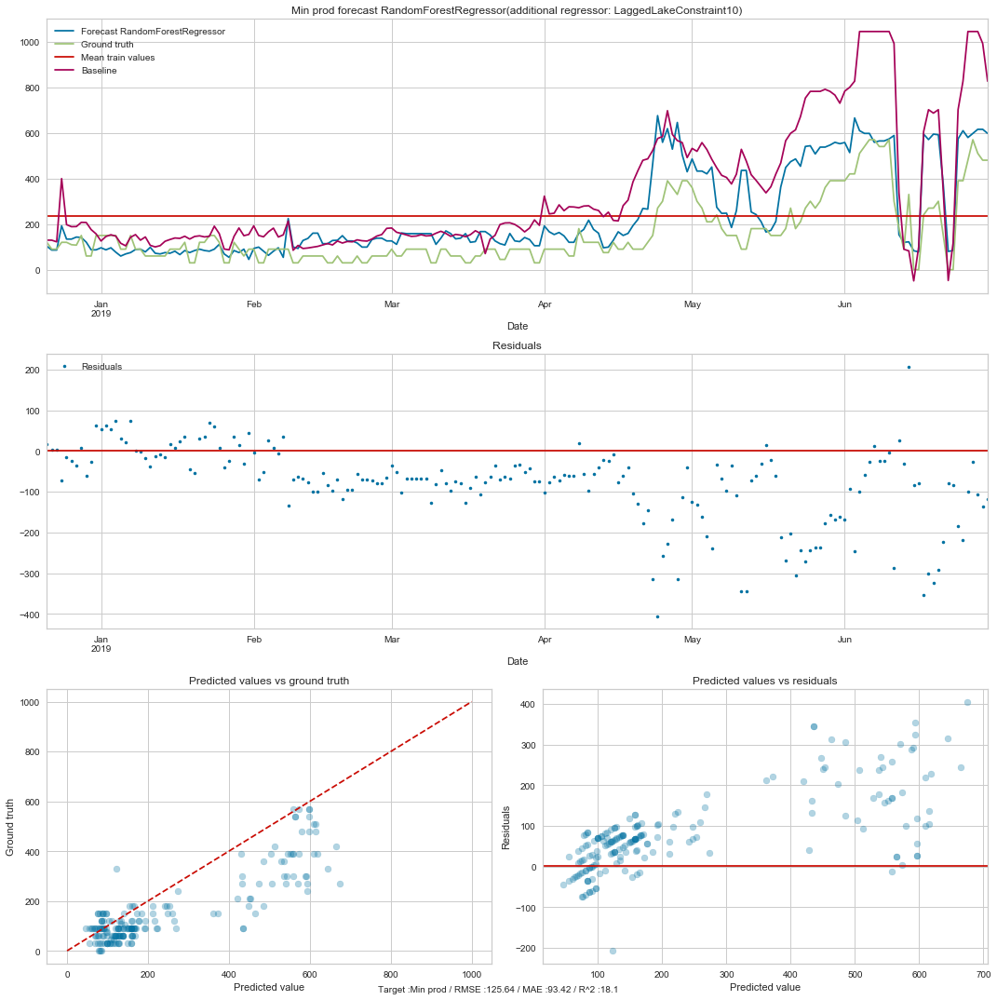

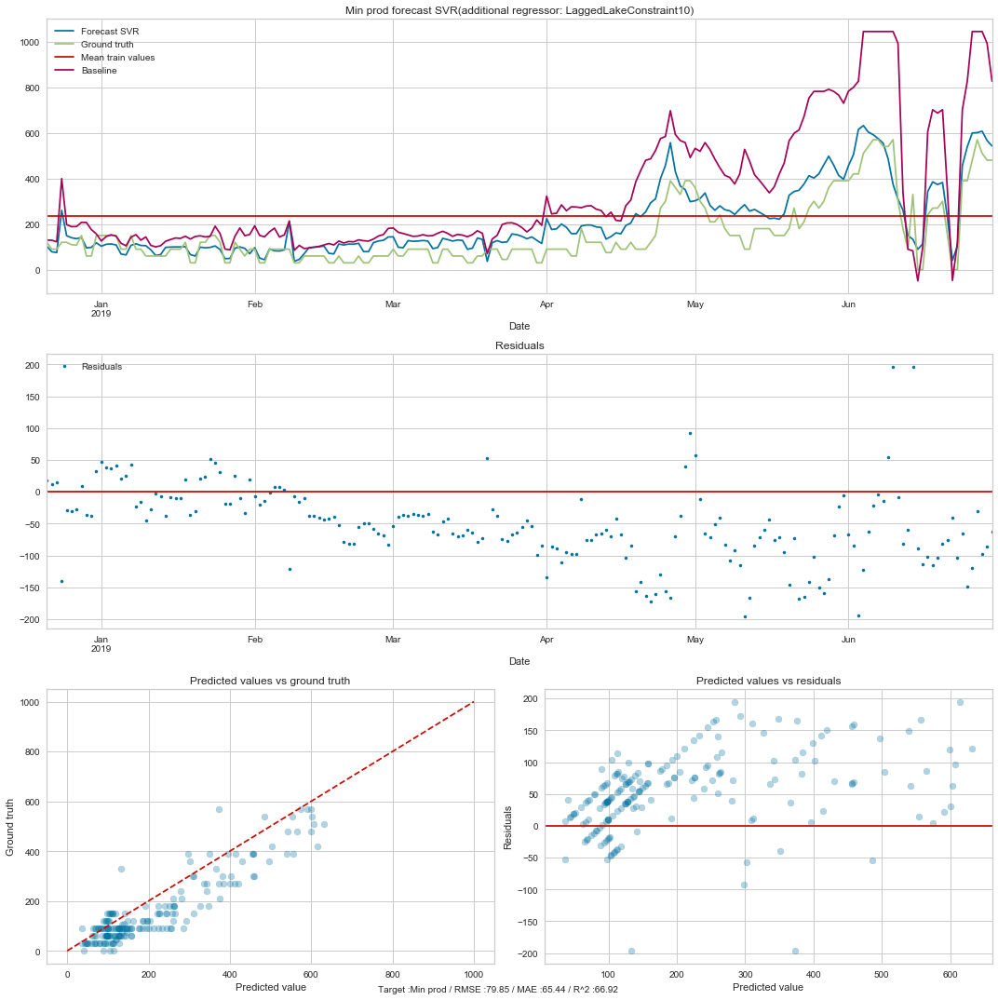

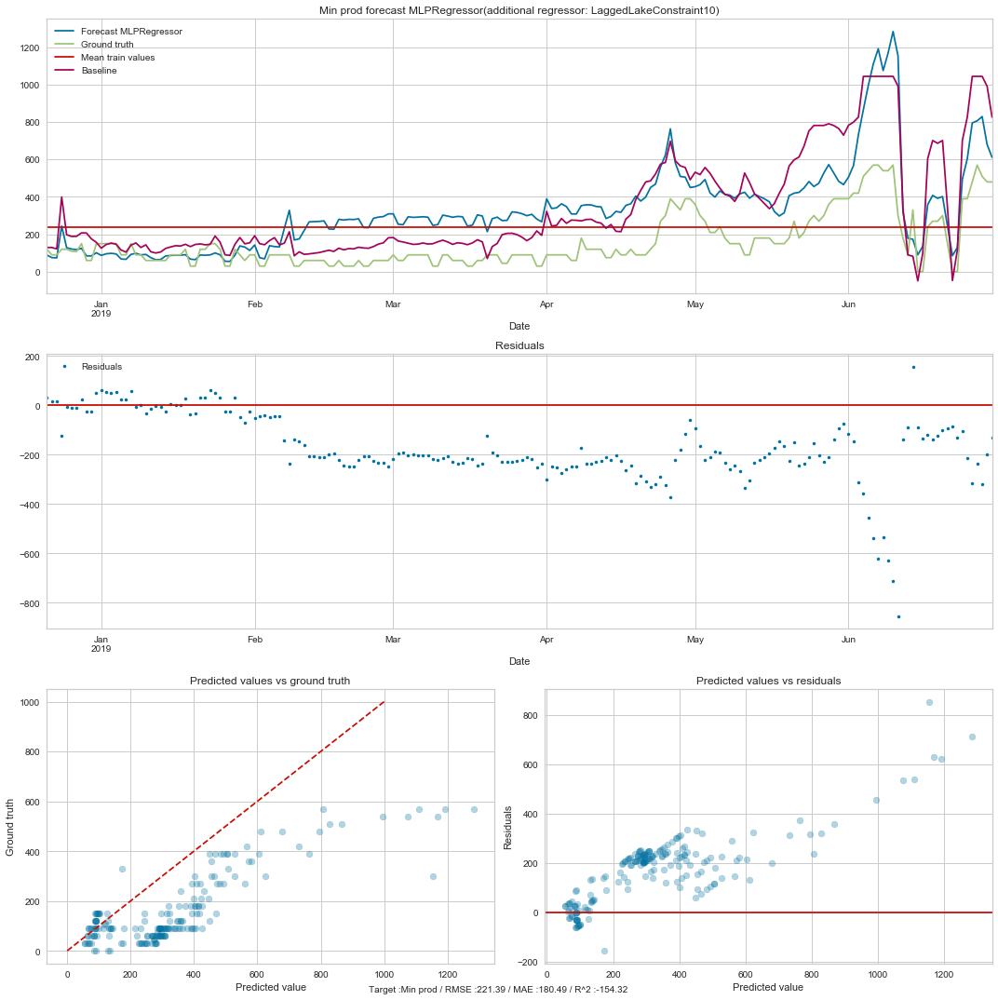

...

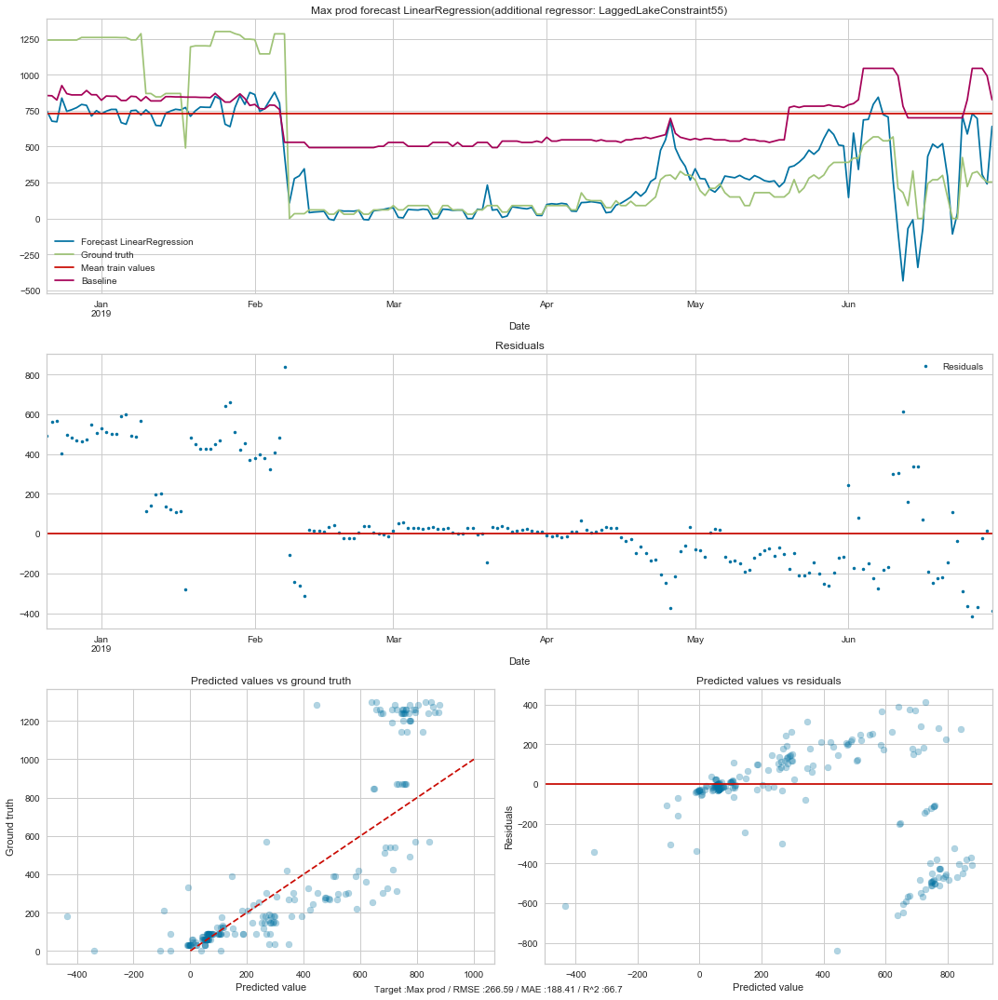

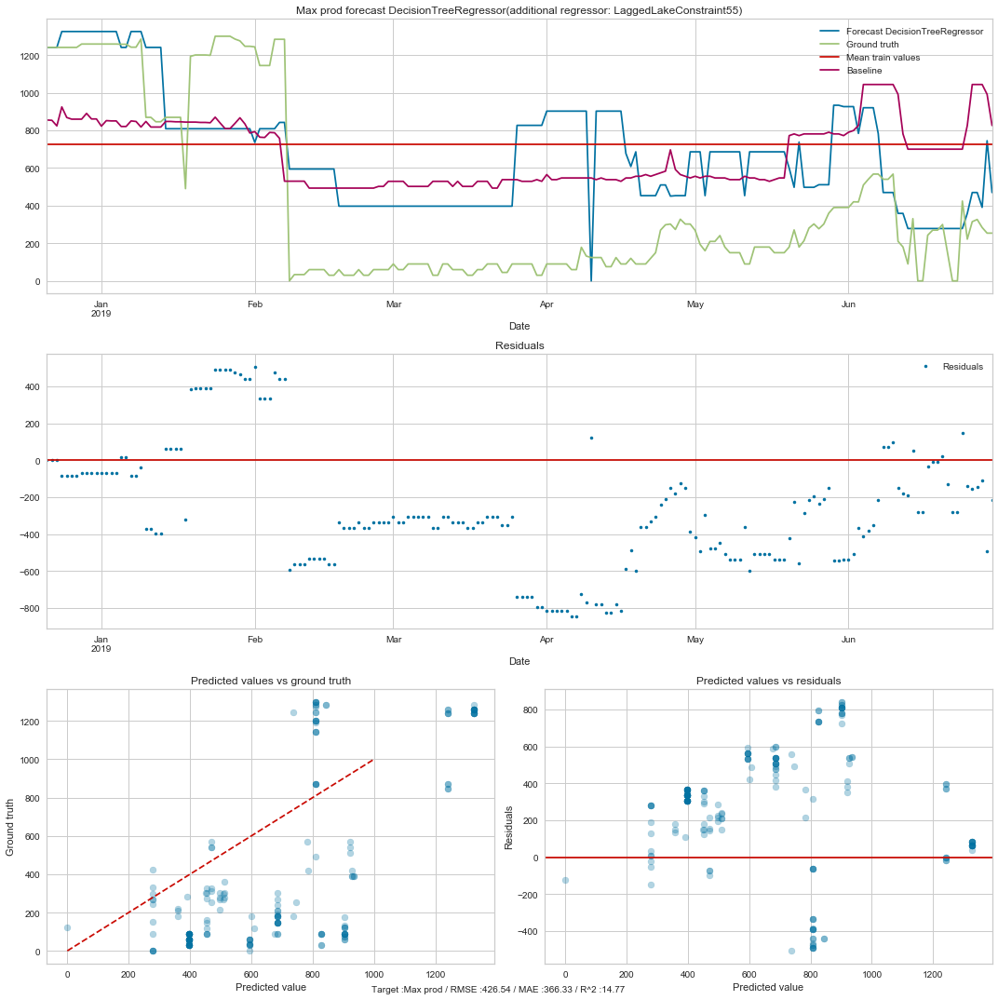

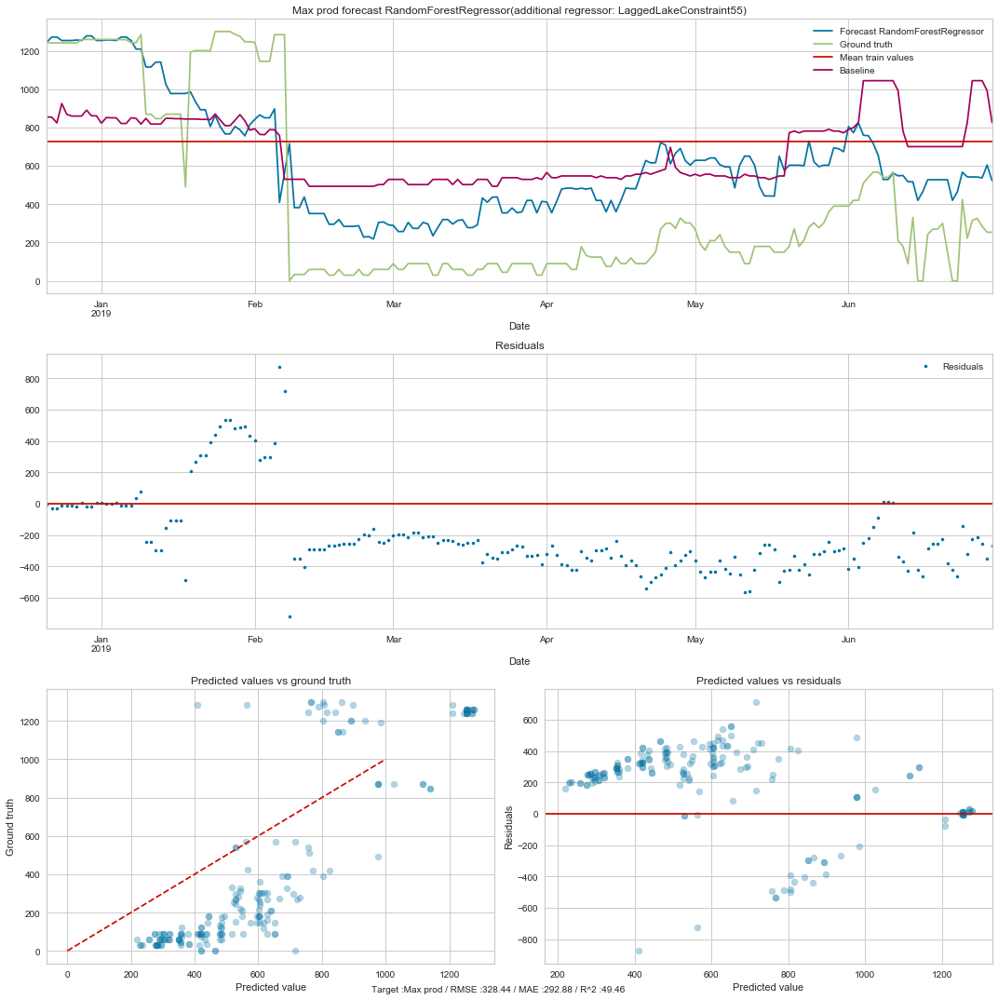

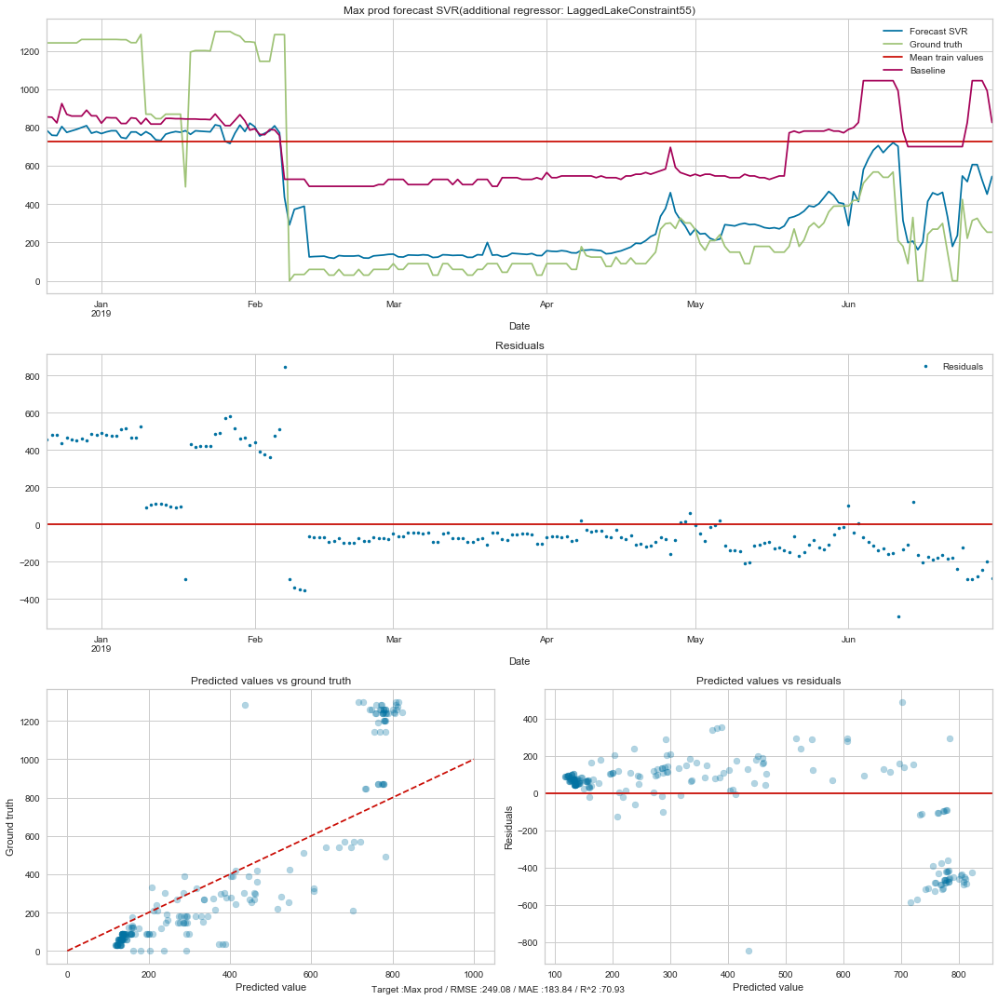

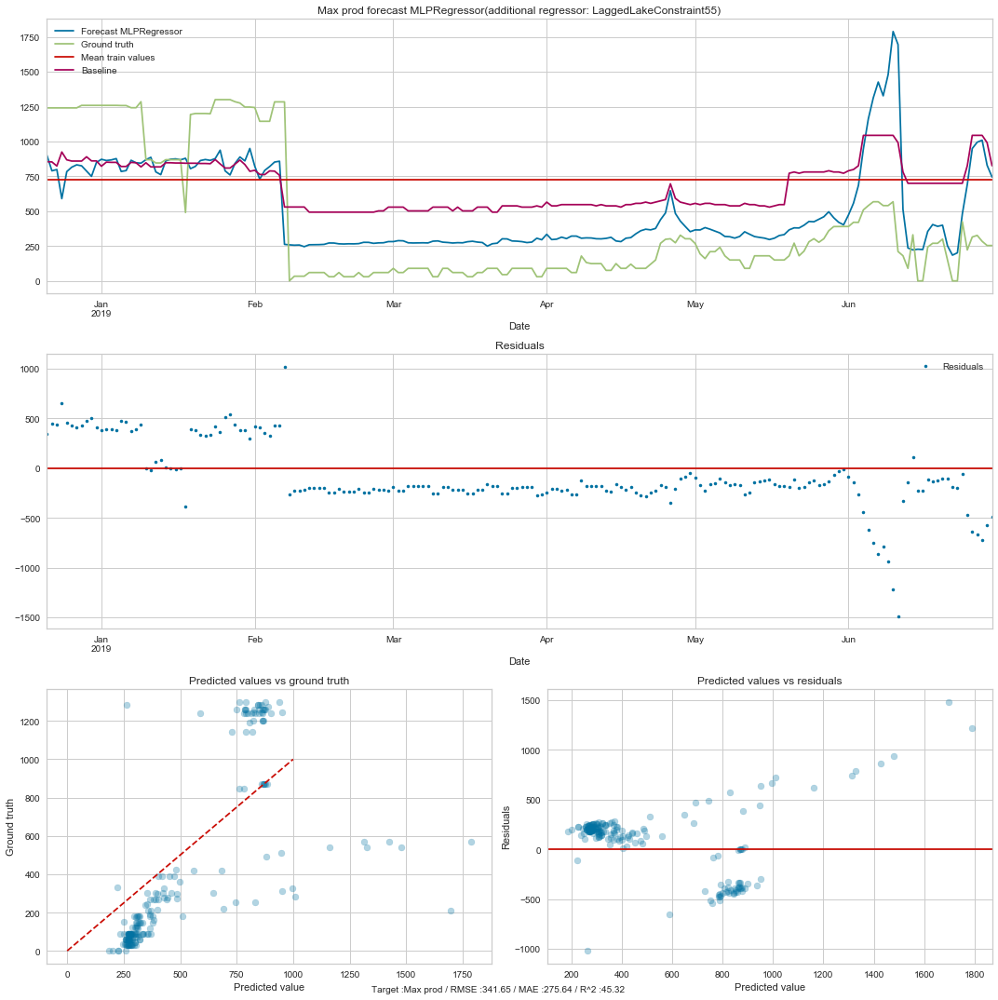

In [487]:
models = [ LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor(), SVR(), MLPRegressor()] 
params = [{}, # linear regression
          {}, # Decision tree
          {          }, # Random forest
          {'model__C': [100],
           'model__kernel': ['rbf'],
           'model__epsilon': [5],
           'model__gamma': [0.005]
          }, # Support Vector Regression
          {}] # Multi layer perceptron regressor

regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]','Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]', 'Weekend']

AddRegressors = []
for i in range(10,60,5): 
    AddRegressors = AddRegressors+ ['LaggedLakeConstraint'+str(i)]

columns = ['Algorithm','Target','Features','RMSE','MAE','R^2', 'Parameters']
df_resLagLakeMax = pd.DataFrame(columns = columns)
line_nb = 0

for target_feature in ["Min prod","Max prod"]:
    for addRegressor in AddRegressors:
        fullRegressors = regressors + [addRegressor]
        print("Full list of regressors:", fullRegressors)
        xTrain, xTest, yTrain, yTest, yBaseLine = GetDataSplit(df, fullRegressors, target_feature, "Baseline_"+target_feature,0.9)
        for m,p in zip(models, params):
            res = TrainEvalModel(xTrain, xTest, yTrain, yTest, target_feature, yBaseLine, xTest.index, addRegressor, m, p)
            df_resLagLakeMax.loc[line_nb,:] = [m,target_feature, xTest.columns, res[0], res[1], res[2], res[3]]
            line_nb = line_nb+1

In [488]:
df_resLagLakeMax[(df_resLagLakeMax["Target"]=="Max prod") & (df_resLagLakeMax["RMSE"]<280)].sort_values(by=['RMSE'])

,Algorithm,Target,Features,RMSE,MAE,R^2,Parameters
98,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",249.083,183.839,70.9341,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
93,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",253.615,179.797,69.8667,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
88,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",254.307,173.811,69.7019,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
53,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",264.344,187.463,67.2633,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
95,"LinearRegression(copy_X=True, fit_intercept=Tr...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",266.594,188.413,66.7035,{}
83,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",266.677,174.682,66.6829,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
73,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",267.857,182.613,66.3873,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
78,"SVR(C=1.0, cache_size=200, coef0=0.0, degree=3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",271.019,180.094,65.589,"{'model__C': 100, 'model__epsilon': 5, 'model_..."
90,"LinearRegression(copy_X=True, fit_intercept=Tr...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",273.85,194.572,64.8664,{}
85,"LinearRegression(copy_X=True, fit_intercept=Tr...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",277.664,200.45,63.8809,{}


In [489]:
df_resLagLakeMax.iloc[98,2]

Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]',
       'Inflow lake 4 [m3]', 'Vol lake 1 [%]', 'Availability plant 1 [%]',
       'Availability plant 2 [%]', 'Availability plant 3 [%]',
       'Availability plant 4 [%]', 'Weekend', 'LaggedLakeConstraint55'],
      dtype='object')

## Further model implementation with Multi Layer Perceptron

In [31]:
# Keras MLP implementation 
import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from tensorflow.python.keras.initializers import RandomUniform
from tensorflow import set_random_seed
from keras.callbacks import EarlyStopping

def TrainEvalMLP(X_train, X_test, y_train, y_test, target_label, target_baseline, test_index, 
                 addRegressor, mlpTopology, modelName, export_prediction = False):

    # set random seed for reproducibility
    seed = 42
    np.random.seed(seed)
    set_random_seed(seed)
    
    init = RandomUniform(minval=-0.05, maxval=0.05)
    
    # define model
    model = Sequential()
    FirstLayer = True
    for layerParams in mlpTopology:
        if FirstLayer:
            model.add(Dense(layerParams["size"], input_dim=len(X_train[0]), kernel_initializer=init,
                            activation=layerParams["activation"]))
        else:
            model.add(Dense(layerParams["size"], kernel_initializer=init, activation=layerParams["activation"]))
        if layerParams["dropOutAfter"] >0:
            model.add(Dropout(layerParams["dropOutAfter"]))
        FirstLayer = False

    model.summary()
    model.compile(loss='mse', optimizer='adam', metrics=['mse','mae'])

    es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=100)
        
    history = model.fit(X_train, y_train, validation_data=(X_test,y_test),
        epochs=200, batch_size=8, callbacks=[es])

    fig = pl.figure()
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'validation'], loc='upper left')
    plt.show()

    # plot graph and save it as a file
    pred = model.predict(X_test)
        
    print("Model name", modelName)
    print('Target :', target_label)
    print('Root Mean Square Error: %1.4f' % (math.sqrt(metrics.mean_squared_error(y_test,pred))))
    print('Mean Absolute Error: %1.4f' % (metrics.mean_absolute_error(y_test,pred)))
    print('R2 score : %1.4f' %(metrics.r2_score(y_test,pred)*100))
    print('\n\n')

    plotModelPrediction(modelName, target_label, y_train, pred, y_test, target_baseline, test_index, addRegressor, export_prediction)
        
    # plot residuals qq plot
    return [math.sqrt(metrics.mean_squared_error(y_test,pred)), 
                      metrics.mean_absolute_error(y_test,pred), 
                      metrics.r2_score(y_test,pred)*100]

W0919 11:19:51.132864  2172 deprecation_wrapper.py:119] From C:\ProgramData\Anaconda3\lib\site-packages\keras\backend\tensorflow_backend.py:986: The name tf.assign_add is deprecated. Please use tf.compat.v1.assign_add instead.



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 7)                 84        
_________________________________________________________________
dropout_3 (Dropout)          (None, 7)                 0         
_________________________________________________________________
dense_5 (Dense)              (None, 5)                 40        
_________________________________________________________________
dropout_4 (Dropout)          (None, 5)                 0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 6         
Total params: 130
Trainable params: 130
Non-trainable params: 0
_________________________________________________________________


W0919 11:19:51.202821  2172 deprecation_wrapper.py:119] From C:\ProgramData\Anaconda3\lib\site-packages\keras\backend\tensorflow_backend.py:973: The name tf.assign is deprecated. Please use tf.compat.v1.assign instead.



Train on 1725 samples, validate on 192 samples
Epoch 1/200
1725/1725 [==============================] - 1s 311us/step - loss: 94702.6332 - mean_squared_error: 94702.6332 - mean_absolute_error: 236.0475 - val_loss: 43030.5770 - val_mean_squared_error: 43030.5770 - val_mean_absolute_error: 155.3365
Epoch 2/200
1725/1725 [==============================] - 0s 85us/step - loss: 91524.2656 - mean_squared_error: 91524.2656 - mean_absolute_error: 232.2321 - val_loss: 36768.7461 - val_mean_squared_error: 36768.7461 - val_mean_absolute_error: 144.8818
Epoch 3/200
1725/1725 [==============================] - 0s 85us/step - loss: 81675.3126 - mean_squared_error: 81675.3126 - mean_absolute_error: 219.9458 - val_loss: 23680.8549 - val_mean_squared_error: 23680.8549 - val_mean_absolute_error: 118.5116
Epoch 4/200
1725/1725 [==============================] - 0s 84us/step - loss: 64857.1382 - mean_squared_error: 64857.1382 - mean_absolute_error: 196.4651 - val_loss: 10919.2672 - val_mean_squared_error:

Epoch 34/200
1725/1725 [==============================] - 0s 86us/step - loss: 32339.7564 - mean_squared_error: 32339.7564 - mean_absolute_error: 121.1311 - val_loss: 5346.4703 - val_mean_squared_error: 5346.4703 - val_mean_absolute_error: 47.0270
Epoch 35/200
1725/1725 [==============================] - 0s 85us/step - loss: 33236.3767 - mean_squared_error: 33236.3767 - mean_absolute_error: 123.0782 - val_loss: 5514.7424 - val_mean_squared_error: 5514.7424 - val_mean_absolute_error: 48.8599
Epoch 36/200
1725/1725 [==============================] - 0s 91us/step - loss: 33362.9441 - mean_squared_error: 33362.9441 - mean_absolute_error: 122.5311 - val_loss: 5871.2311 - val_mean_squared_error: 5871.2311 - val_mean_absolute_error: 49.8036
Epoch 37/200
1725/1725 [==============================] - 0s 90us/step - loss: 30908.4958 - mean_squared_error: 30908.4958 - mean_absolute_error: 121.0127 - val_loss: 5691.1403 - val_mean_squared_error: 5691.1403 - val_mean_absolute_error: 48.8249
Epoch 38

1725/1725 [==============================] - 0s 84us/step - loss: 31637.7119 - mean_squared_error: 31637.7119 - mean_absolute_error: 120.1893 - val_loss: 4640.8414 - val_mean_squared_error: 4640.8414 - val_mean_absolute_error: 45.1861
Epoch 68/200
1725/1725 [==============================] - 0s 83us/step - loss: 28885.5030 - mean_squared_error: 28885.5030 - mean_absolute_error: 115.6571 - val_loss: 5532.0710 - val_mean_squared_error: 5532.0710 - val_mean_absolute_error: 51.3067
Epoch 69/200
1725/1725 [==============================] - 0s 85us/step - loss: 32060.3580 - mean_squared_error: 32060.3580 - mean_absolute_error: 119.9379 - val_loss: 4790.3763 - val_mean_squared_error: 4790.3763 - val_mean_absolute_error: 48.1820
Epoch 70/200
1725/1725 [==============================] - 0s 82us/step - loss: 30819.1103 - mean_squared_error: 30819.1103 - mean_absolute_error: 118.0054 - val_loss: 4778.3384 - val_mean_squared_error: 4778.3384 - val_mean_absolute_error: 48.7311
Epoch 71/200
1725/172

1725/1725 [==============================] - 0s 85us/step - loss: 30265.0092 - mean_squared_error: 30265.0092 - mean_absolute_error: 117.9035 - val_loss: 3830.9851 - val_mean_squared_error: 3830.9851 - val_mean_absolute_error: 44.8437
Epoch 101/200
1725/1725 [==============================] - 0s 83us/step - loss: 28537.5058 - mean_squared_error: 28537.5058 - mean_absolute_error: 113.1964 - val_loss: 4583.2176 - val_mean_squared_error: 4583.2176 - val_mean_absolute_error: 48.4138
Epoch 102/200
1725/1725 [==============================] - 0s 85us/step - loss: 29599.9927 - mean_squared_error: 29599.9927 - mean_absolute_error: 114.0844 - val_loss: 4129.6553 - val_mean_squared_error: 4129.6553 - val_mean_absolute_error: 47.5383
Epoch 103/200
1725/1725 [==============================] - 0s 89us/step - loss: 31834.2703 - mean_squared_error: 31834.2703 - mean_absolute_error: 118.4653 - val_loss: 3621.4026 - val_mean_squared_error: 3621.4026 - val_mean_absolute_error: 43.3110
Epoch 104/200
1725

Epoch 133/200
1725/1725 [==============================] - 0s 85us/step - loss: 31236.8130 - mean_squared_error: 31236.8130 - mean_absolute_error: 115.2617 - val_loss: 3527.3663 - val_mean_squared_error: 3527.3663 - val_mean_absolute_error: 45.3356
Epoch 134/200
1725/1725 [==============================] - 0s 84us/step - loss: 27768.2016 - mean_squared_error: 27768.2016 - mean_absolute_error: 110.9642 - val_loss: 3959.7003 - val_mean_squared_error: 3959.7003 - val_mean_absolute_error: 48.1379
Epoch 135/200
1725/1725 [==============================] - 0s 83us/step - loss: 28703.2306 - mean_squared_error: 28703.2306 - mean_absolute_error: 112.2050 - val_loss: 4031.6790 - val_mean_squared_error: 4031.6790 - val_mean_absolute_error: 48.0976
Epoch 136/200
1725/1725 [==============================] - 0s 86us/step - loss: 26891.5834 - mean_squared_error: 26891.5834 - mean_absolute_error: 110.5942 - val_loss: 3946.5409 - val_mean_squared_error: 3946.5409 - val_mean_absolute_error: 46.7167
Epoc

Epoch 166/200
1725/1725 [==============================] - 0s 85us/step - loss: 27470.1235 - mean_squared_error: 27470.1235 - mean_absolute_error: 108.4761 - val_loss: 4131.0280 - val_mean_squared_error: 4131.0280 - val_mean_absolute_error: 49.5936
Epoch 167/200
1725/1725 [==============================] - 0s 84us/step - loss: 27223.1337 - mean_squared_error: 27223.1337 - mean_absolute_error: 110.3778 - val_loss: 4159.8611 - val_mean_squared_error: 4159.8611 - val_mean_absolute_error: 49.8455
Epoch 168/200
1725/1725 [==============================] - 0s 85us/step - loss: 28232.6538 - mean_squared_error: 28232.6538 - mean_absolute_error: 111.2131 - val_loss: 3909.1340 - val_mean_squared_error: 3909.1340 - val_mean_absolute_error: 48.4654
Epoch 169/200
1725/1725 [==============================] - 0s 83us/step - loss: 27827.4962 - mean_squared_error: 27827.4962 - mean_absolute_error: 112.2369 - val_loss: 3779.4379 - val_mean_squared_error: 3779.4379 - val_mean_absolute_error: 47.7299
Epoc

Epoch 199/200
1725/1725 [==============================] - 0s 85us/step - loss: 27730.9530 - mean_squared_error: 27730.9530 - mean_absolute_error: 111.0421 - val_loss: 3806.5539 - val_mean_squared_error: 3806.5539 - val_mean_absolute_error: 46.7274
Epoch 200/200
1725/1725 [==============================] - 0s 83us/step - loss: 28186.0309 - mean_squared_error: 28186.0309 - mean_absolute_error: 112.2781 - val_loss: 3504.4798 - val_mean_squared_error: 3504.4798 - val_mean_absolute_error: 45.0423


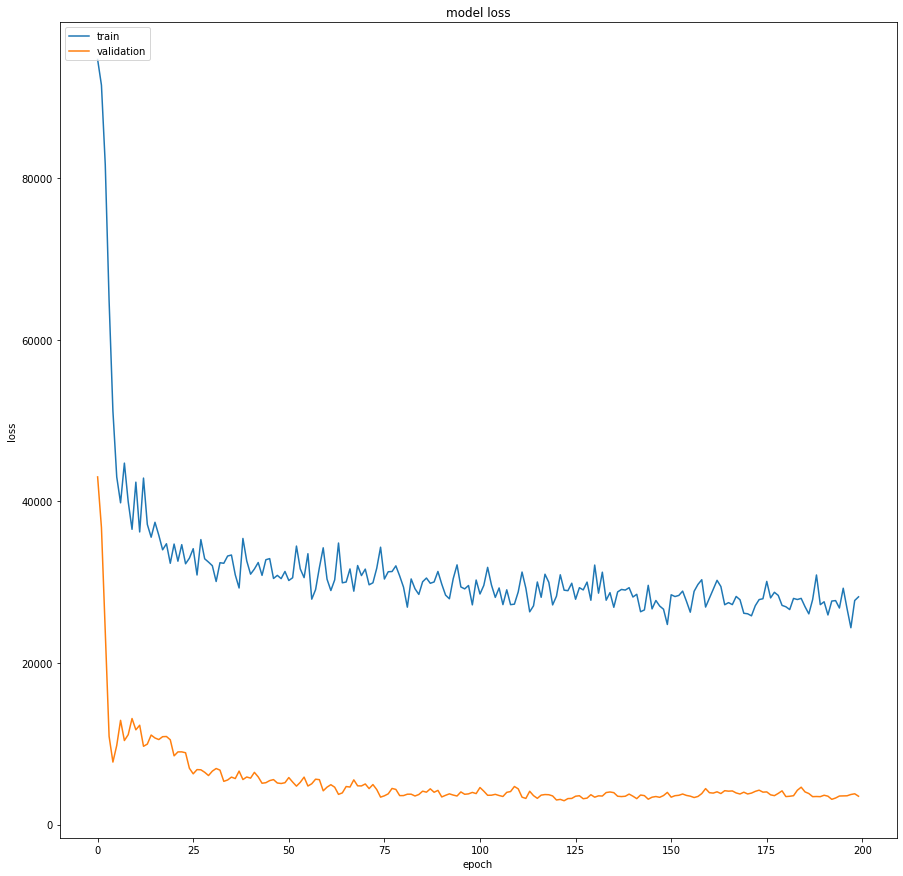

Model name MLP (7,5,1) Act(lin, lin, relu) Dropout (0.5,0.5)
Target : Min prod
Root Mean Square Error: 59.1986
Mean Absolute Error: 45.0423
R2 score : 81.8156



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 7)                 84        
_________________________________________________________________
dropout_5 (Dropout)          (None, 7)                 0         
_________________________________________________________________
dense_8 (Dense)              (None, 5)                 40        
_________________________________________________________________
dropout_6 (Dropout)          (None, 5)                 0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 6         
Total params: 130
Trainable params: 130
Non-trainable params: 0
________________________________________________

1725/1725 [==============================] - 0s 96us/step - loss: 25919.6186 - mean_squared_error: 25919.6186 - mean_absolute_error: 110.5312 - val_loss: 9450.1027 - val_mean_squared_error: 9450.1027 - val_mean_absolute_error: 63.3246
Epoch 30/200
1725/1725 [==============================] - 0s 86us/step - loss: 26288.8137 - mean_squared_error: 26288.8137 - mean_absolute_error: 110.5398 - val_loss: 9573.3765 - val_mean_squared_error: 9573.3765 - val_mean_absolute_error: 65.4670
Epoch 31/200
1725/1725 [==============================] - 0s 85us/step - loss: 27914.1626 - mean_squared_error: 27914.1626 - mean_absolute_error: 112.0053 - val_loss: 9061.2083 - val_mean_squared_error: 9061.2083 - val_mean_absolute_error: 64.1939
Epoch 32/200
1725/1725 [==============================] - 0s 85us/step - loss: 24729.7205 - mean_squared_error: 24729.7205 - mean_absolute_error: 107.8671 - val_loss: 9411.2760 - val_mean_squared_error: 9411.2760 - val_mean_absolute_error: 63.6726
Epoch 33/200
1725/172

1725/1725 [==============================] - 0s 86us/step - loss: 24371.8128 - mean_squared_error: 24371.8128 - mean_absolute_error: 105.6747 - val_loss: 6807.3077 - val_mean_squared_error: 6807.3077 - val_mean_absolute_error: 54.8485
Epoch 63/200
1725/1725 [==============================] - 0s 85us/step - loss: 24198.3051 - mean_squared_error: 24198.3051 - mean_absolute_error: 104.7212 - val_loss: 5719.5908 - val_mean_squared_error: 5719.5908 - val_mean_absolute_error: 49.2905
Epoch 64/200
1725/1725 [==============================] - 0s 85us/step - loss: 28440.0277 - mean_squared_error: 28440.0277 - mean_absolute_error: 111.3757 - val_loss: 4823.8894 - val_mean_squared_error: 4823.8894 - val_mean_absolute_error: 46.3845
Epoch 65/200
1725/1725 [==============================] - 0s 86us/step - loss: 25017.0748 - mean_squared_error: 25017.0748 - mean_absolute_error: 108.6541 - val_loss: 5691.8451 - val_mean_squared_error: 5691.8451 - val_mean_absolute_error: 52.1814
Epoch 66/200
1725/172

1725/1725 [==============================] - 0s 86us/step - loss: 26887.9090 - mean_squared_error: 26887.9090 - mean_absolute_error: 111.8599 - val_loss: 4762.3265 - val_mean_squared_error: 4762.3265 - val_mean_absolute_error: 50.7268
Epoch 96/200
1725/1725 [==============================] - 0s 89us/step - loss: 25143.5006 - mean_squared_error: 25143.5006 - mean_absolute_error: 105.5563 - val_loss: 5091.3639 - val_mean_squared_error: 5091.3639 - val_mean_absolute_error: 52.4250
Epoch 97/200
1725/1725 [==============================] - 0s 86us/step - loss: 24120.5874 - mean_squared_error: 24120.5874 - mean_absolute_error: 103.8849 - val_loss: 5313.5582 - val_mean_squared_error: 5313.5582 - val_mean_absolute_error: 54.6466
Epoch 98/200
1725/1725 [==============================] - 0s 86us/step - loss: 24895.2867 - mean_squared_error: 24895.2867 - mean_absolute_error: 106.9816 - val_loss: 5072.8339 - val_mean_squared_error: 5072.8339 - val_mean_absolute_error: 52.9381
Epoch 99/200
1725/172

Epoch 128/200
1725/1725 [==============================] - 0s 85us/step - loss: 24261.6300 - mean_squared_error: 24261.6300 - mean_absolute_error: 105.3978 - val_loss: 3930.1986 - val_mean_squared_error: 3930.1986 - val_mean_absolute_error: 44.7211
Epoch 129/200
1725/1725 [==============================] - 0s 86us/step - loss: 26044.7508 - mean_squared_error: 26044.7508 - mean_absolute_error: 106.7995 - val_loss: 3668.2696 - val_mean_squared_error: 3668.2696 - val_mean_absolute_error: 43.0105
Epoch 130/200
1725/1725 [==============================] - 0s 90us/step - loss: 24112.3599 - mean_squared_error: 24112.3599 - mean_absolute_error: 103.7082 - val_loss: 4404.1571 - val_mean_squared_error: 4404.1571 - val_mean_absolute_error: 48.5527
Epoch 131/200
1725/1725 [==============================] - 0s 93us/step - loss: 26776.9493 - mean_squared_error: 26776.9493 - mean_absolute_error: 107.4631 - val_loss: 4433.5490 - val_mean_squared_error: 4433.5490 - val_mean_absolute_error: 49.1882
Epoc

Epoch 161/200
1725/1725 [==============================] - 0s 87us/step - loss: 24718.7954 - mean_squared_error: 24718.7954 - mean_absolute_error: 104.5071 - val_loss: 5011.3196 - val_mean_squared_error: 5011.3196 - val_mean_absolute_error: 55.2103
Epoch 162/200
1725/1725 [==============================] - 0s 85us/step - loss: 25004.9316 - mean_squared_error: 25004.9316 - mean_absolute_error: 105.1057 - val_loss: 5321.8725 - val_mean_squared_error: 5321.8725 - val_mean_absolute_error: 56.2720
Epoch 163/200
1725/1725 [==============================] - 0s 86us/step - loss: 24877.3505 - mean_squared_error: 24877.3505 - mean_absolute_error: 106.5939 - val_loss: 5016.6463 - val_mean_squared_error: 5016.6463 - val_mean_absolute_error: 54.0376
Epoch 164/200
1725/1725 [==============================] - 0s 85us/step - loss: 25263.8924 - mean_squared_error: 25263.8924 - mean_absolute_error: 104.8353 - val_loss: 4673.2670 - val_mean_squared_error: 4673.2670 - val_mean_absolute_error: 52.7925
Epoc

Epoch 194/200
1725/1725 [==============================] - 0s 86us/step - loss: 23622.1965 - mean_squared_error: 23622.1965 - mean_absolute_error: 102.3522 - val_loss: 4596.2878 - val_mean_squared_error: 4596.2878 - val_mean_absolute_error: 52.3107
Epoch 195/200
1725/1725 [==============================] - 0s 86us/step - loss: 23026.8357 - mean_squared_error: 23026.8357 - mean_absolute_error: 101.7641 - val_loss: 4632.2204 - val_mean_squared_error: 4632.2204 - val_mean_absolute_error: 53.2702
Epoch 196/200
1725/1725 [==============================] - 0s 85us/step - loss: 23859.7468 - mean_squared_error: 23859.7468 - mean_absolute_error: 102.4257 - val_loss: 5149.8520 - val_mean_squared_error: 5149.8520 - val_mean_absolute_error: 56.5826
Epoch 197/200
1725/1725 [==============================] - 0s 87us/step - loss: 23244.9033 - mean_squared_error: 23244.9033 - mean_absolute_error: 102.8254 - val_loss: 5110.2597 - val_mean_squared_error: 5110.2597 - val_mean_absolute_error: 55.5768
Epoc

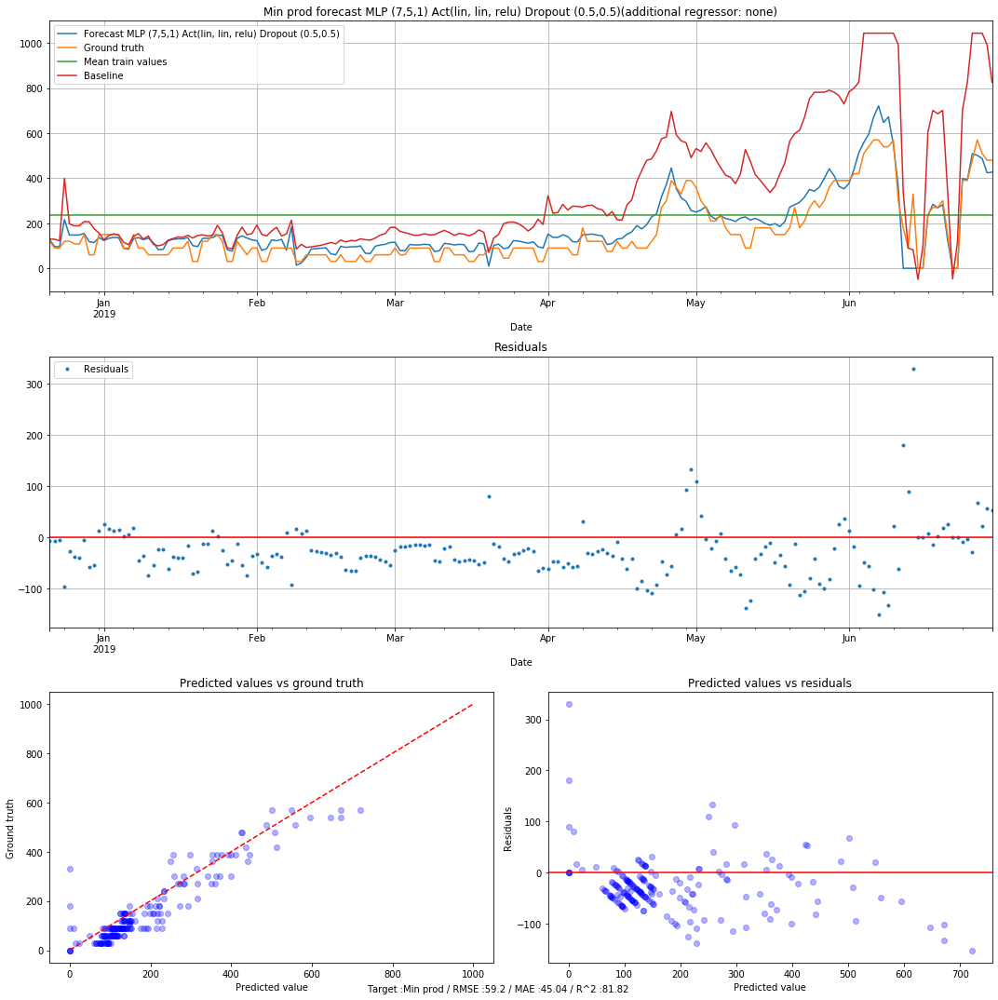

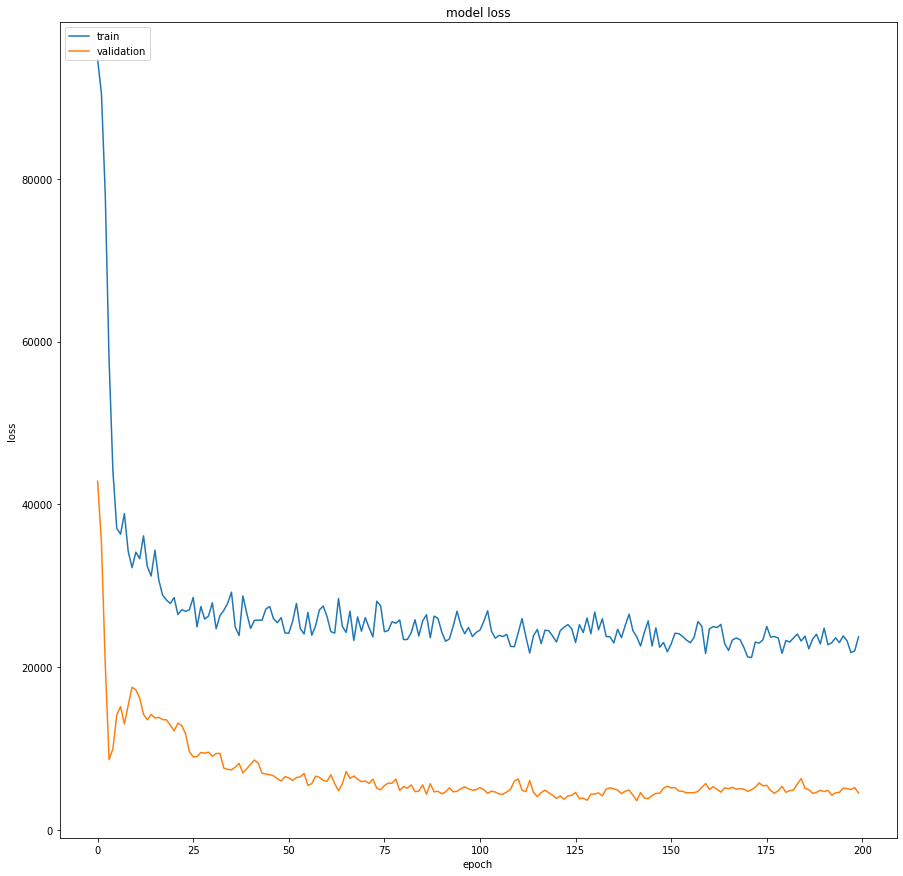

Model name MLP (7,5,1) Act(lin, lin, relu) Dropout (0.4,0.4)
Target : Min prod
Root Mean Square Error: 67.4866
Mean Absolute Error: 51.5356
R2 score : 76.3675



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_7 (Dropout)          (None, 7)                 0         
_________________________________________________________________
dense_11 (Dense)             (None, 5)                 40        
_________________________________________________________________
dropout_8 (Dropout)          (None, 5)                 0         
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 6         
Total params: 130
Trainable params: 130
Non-trainable params: 0
________________________________________________

1725/1725 [==============================] - 0s 92us/step - loss: 21493.9889 - mean_squared_error: 21493.9889 - mean_absolute_error: 100.9277 - val_loss: 12677.5454 - val_mean_squared_error: 12677.5454 - val_mean_absolute_error: 72.4612
Epoch 30/200
1725/1725 [==============================] - 0s 89us/step - loss: 22401.2247 - mean_squared_error: 22401.2247 - mean_absolute_error: 101.0324 - val_loss: 10885.8623 - val_mean_squared_error: 10885.8623 - val_mean_absolute_error: 68.3319
Epoch 31/200
1725/1725 [==============================] - 0s 87us/step - loss: 23410.2131 - mean_squared_error: 23410.2131 - mean_absolute_error: 103.3066 - val_loss: 10180.7965 - val_mean_squared_error: 10180.7965 - val_mean_absolute_error: 65.8553
Epoch 32/200
1725/1725 [==============================] - 0s 87us/step - loss: 20583.3160 - mean_squared_error: 20583.3160 - mean_absolute_error: 99.6992 - val_loss: 10324.0649 - val_mean_squared_error: 10324.0649 - val_mean_absolute_error: 65.2275
Epoch 33/200
1

1725/1725 [==============================] - 0s 87us/step - loss: 20564.3114 - mean_squared_error: 20564.3114 - mean_absolute_error: 97.5904 - val_loss: 8271.3164 - val_mean_squared_error: 8271.3164 - val_mean_absolute_error: 62.8468
Epoch 63/200
1725/1725 [==============================] - 0s 86us/step - loss: 21081.0453 - mean_squared_error: 21081.0453 - mean_absolute_error: 97.4375 - val_loss: 6843.8530 - val_mean_squared_error: 6843.8530 - val_mean_absolute_error: 56.2434
Epoch 64/200
1725/1725 [==============================] - 0s 86us/step - loss: 22355.0724 - mean_squared_error: 22355.0724 - mean_absolute_error: 100.4212 - val_loss: 6732.0434 - val_mean_squared_error: 6732.0434 - val_mean_absolute_error: 56.7514
Epoch 65/200
1725/1725 [==============================] - 0s 86us/step - loss: 20583.4816 - mean_squared_error: 20583.4816 - mean_absolute_error: 100.2124 - val_loss: 7437.5118 - val_mean_squared_error: 7437.5118 - val_mean_absolute_error: 61.8310
Epoch 66/200
1725/1725 

1725/1725 [==============================] - 0s 85us/step - loss: 21443.0997 - mean_squared_error: 21443.0997 - mean_absolute_error: 100.4947 - val_loss: 6690.2167 - val_mean_squared_error: 6690.2167 - val_mean_absolute_error: 61.2604
Epoch 96/200
1725/1725 [==============================] - 0s 87us/step - loss: 21143.9049 - mean_squared_error: 21143.9049 - mean_absolute_error: 99.3741 - val_loss: 6832.3494 - val_mean_squared_error: 6832.3494 - val_mean_absolute_error: 61.7789
Epoch 97/200
1725/1725 [==============================] - 0s 86us/step - loss: 20313.2570 - mean_squared_error: 20313.2570 - mean_absolute_error: 96.2515 - val_loss: 6450.2474 - val_mean_squared_error: 6450.2474 - val_mean_absolute_error: 61.3538
Epoch 98/200
1725/1725 [==============================] - 0s 86us/step - loss: 21089.6878 - mean_squared_error: 21089.6878 - mean_absolute_error: 99.0873 - val_loss: 6275.4592 - val_mean_squared_error: 6275.4592 - val_mean_absolute_error: 60.1102
Epoch 99/200
1725/1725 [

1725/1725 [==============================] - 0s 111us/step - loss: 20406.9428 - mean_squared_error: 20406.9428 - mean_absolute_error: 95.9577 - val_loss: 5495.1685 - val_mean_squared_error: 5495.1685 - val_mean_absolute_error: 55.0878
Epoch 129/200
1725/1725 [==============================] - 0s 101us/step - loss: 20934.6666 - mean_squared_error: 20934.6666 - mean_absolute_error: 98.0861 - val_loss: 5480.3737 - val_mean_squared_error: 5480.3737 - val_mean_absolute_error: 55.6855
Epoch 130/200
1725/1725 [==============================] - 0s 108us/step - loss: 20036.4477 - mean_squared_error: 20036.4477 - mean_absolute_error: 95.7656 - val_loss: 6665.8654 - val_mean_squared_error: 6665.8654 - val_mean_absolute_error: 62.8423
Epoch 131/200
1725/1725 [==============================] - 0s 94us/step - loss: 22611.1689 - mean_squared_error: 22611.1689 - mean_absolute_error: 101.7375 - val_loss: 5937.5439 - val_mean_squared_error: 5937.5439 - val_mean_absolute_error: 59.5416
Epoch 132/200
1725

1725/1725 [==============================] - 0s 89us/step - loss: 20572.5883 - mean_squared_error: 20572.5883 - mean_absolute_error: 97.4926 - val_loss: 6564.9113 - val_mean_squared_error: 6564.9113 - val_mean_absolute_error: 63.4947
Epoch 162/200
1725/1725 [==============================] - 0s 86us/step - loss: 20792.1311 - mean_squared_error: 20792.1311 - mean_absolute_error: 96.0654 - val_loss: 6999.3970 - val_mean_squared_error: 6999.3970 - val_mean_absolute_error: 65.1822
Epoch 163/200
1725/1725 [==============================] - 0s 86us/step - loss: 20592.9262 - mean_squared_error: 20592.9262 - mean_absolute_error: 97.9639 - val_loss: 6892.0853 - val_mean_squared_error: 6892.0853 - val_mean_absolute_error: 63.9561
Epoch 164/200
1725/1725 [==============================] - 0s 86us/step - loss: 22941.3725 - mean_squared_error: 22941.3725 - mean_absolute_error: 100.7274 - val_loss: 5640.6652 - val_mean_squared_error: 5640.6652 - val_mean_absolute_error: 57.7510
Epoch 165/200
1725/17

1725/1725 [==============================] - 0s 86us/step - loss: 20652.5772 - mean_squared_error: 20652.5772 - mean_absolute_error: 97.2767 - val_loss: 6263.9300 - val_mean_squared_error: 6263.9300 - val_mean_absolute_error: 61.1684
Epoch 195/200
1725/1725 [==============================] - 0s 87us/step - loss: 19193.6063 - mean_squared_error: 19193.6063 - mean_absolute_error: 93.8128 - val_loss: 6045.3186 - val_mean_squared_error: 6045.3186 - val_mean_absolute_error: 60.5132
Epoch 196/200
1725/1725 [==============================] - 0s 85us/step - loss: 20743.4170 - mean_squared_error: 20743.4170 - mean_absolute_error: 97.8421 - val_loss: 6685.2792 - val_mean_squared_error: 6685.2792 - val_mean_absolute_error: 64.3171
Epoch 197/200
1725/1725 [==============================] - 0s 87us/step - loss: 19844.1593 - mean_squared_error: 19844.1593 - mean_absolute_error: 96.3186 - val_loss: 7001.6549 - val_mean_squared_error: 7001.6549 - val_mean_absolute_error: 65.6220
Epoch 198/200
1725/172

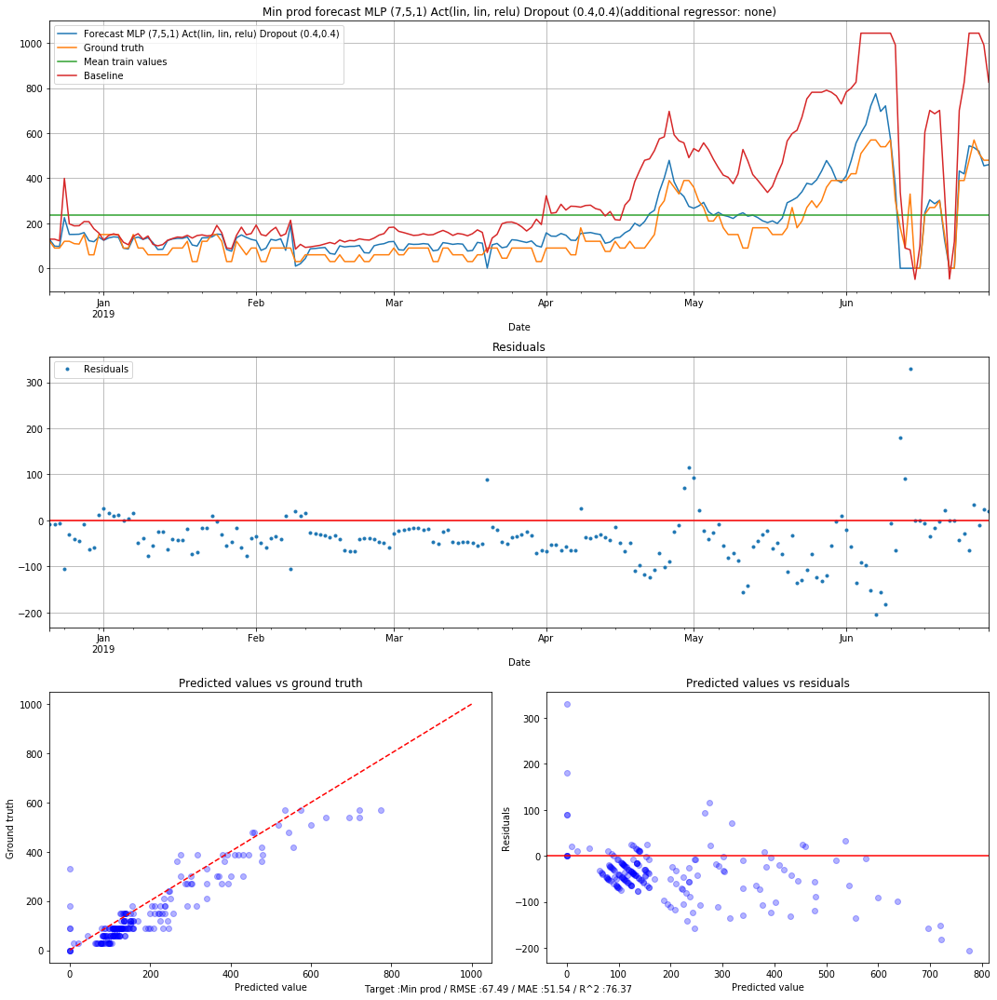

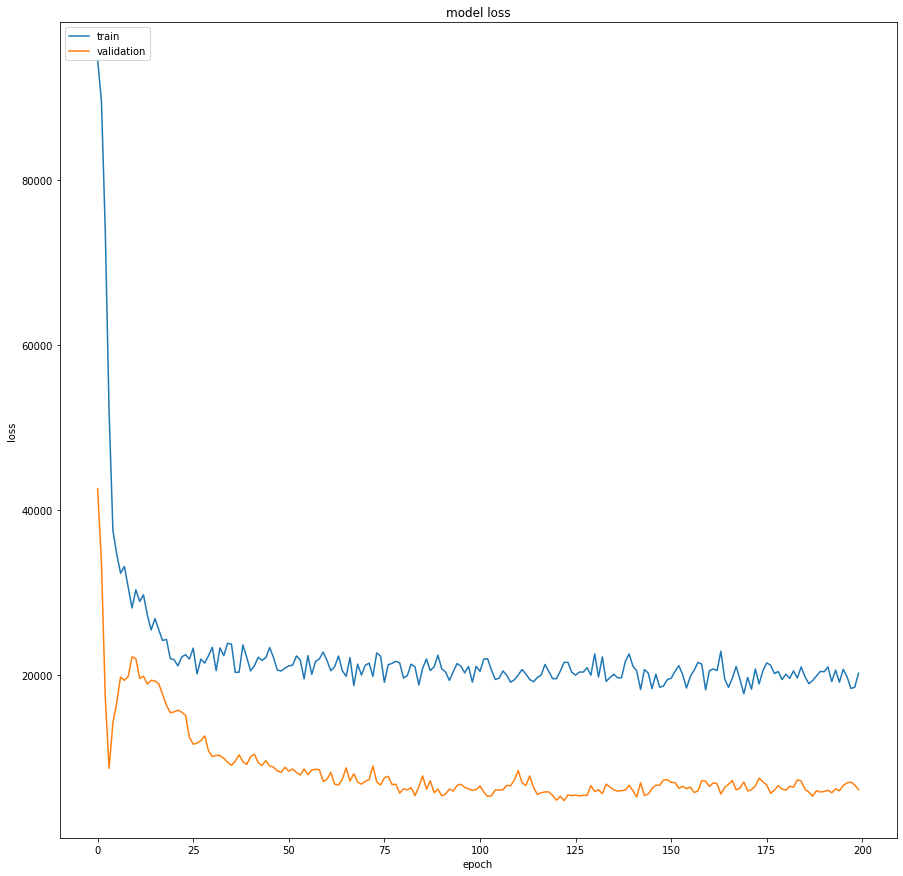

Model name MLP (7,5,1) Act(lin, lin, relu) Dropout (0.3,0.3)
Target : Min prod
Root Mean Square Error: 78.5578
Mean Absolute Error: 60.3855
R2 score : 67.9776



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 9)                 108       
_________________________________________________________________
dropout_9 (Dropout)          (None, 9)                 0         
_________________________________________________________________
dense_14 (Dense)             (None, 7)                 70        
_________________________________________________________________
dropout_10 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 8         
Total params: 186
Trainable params: 186
Non-trainable params: 0
________________________________________________

1725/1725 [==============================] - 0s 89us/step - loss: 26382.7918 - mean_squared_error: 26382.7918 - mean_absolute_error: 112.4740 - val_loss: 10188.0124 - val_mean_squared_error: 10188.0124 - val_mean_absolute_error: 62.7417
Epoch 30/200
1725/1725 [==============================] - 0s 88us/step - loss: 28572.1036 - mean_squared_error: 28572.1036 - mean_absolute_error: 112.9611 - val_loss: 7629.5842 - val_mean_squared_error: 7629.5842 - val_mean_absolute_error: 54.6644
Epoch 31/200
1725/1725 [==============================] - 0s 88us/step - loss: 28403.8270 - mean_squared_error: 28403.8270 - mean_absolute_error: 113.5507 - val_loss: 8522.1680 - val_mean_squared_error: 8522.1680 - val_mean_absolute_error: 57.1421
Epoch 32/200
1725/1725 [==============================] - 0s 87us/step - loss: 27163.9656 - mean_squared_error: 27163.9656 - mean_absolute_error: 114.6683 - val_loss: 8071.5701 - val_mean_squared_error: 8071.5701 - val_mean_absolute_error: 53.7946
Epoch 33/200
1725/1

1725/1725 [==============================] - 0s 88us/step - loss: 27282.5921 - mean_squared_error: 27282.5921 - mean_absolute_error: 112.9586 - val_loss: 5086.6956 - val_mean_squared_error: 5086.6956 - val_mean_absolute_error: 47.1264
Epoch 63/200
1725/1725 [==============================] - 0s 88us/step - loss: 24798.4760 - mean_squared_error: 24798.4760 - mean_absolute_error: 107.0273 - val_loss: 5162.5149 - val_mean_squared_error: 5162.5149 - val_mean_absolute_error: 47.3073
Epoch 64/200
1725/1725 [==============================] - 0s 87us/step - loss: 27605.8948 - mean_squared_error: 27605.8948 - mean_absolute_error: 111.3218 - val_loss: 5035.9241 - val_mean_squared_error: 5035.9241 - val_mean_absolute_error: 47.3209
Epoch 65/200
1725/1725 [==============================] - 0s 87us/step - loss: 28850.2001 - mean_squared_error: 28850.2001 - mean_absolute_error: 112.2310 - val_loss: 4870.5436 - val_mean_squared_error: 4870.5436 - val_mean_absolute_error: 47.7695
Epoch 66/200
1725/172

1725/1725 [==============================] - 0s 87us/step - loss: 27375.1167 - mean_squared_error: 27375.1167 - mean_absolute_error: 110.1926 - val_loss: 4079.4037 - val_mean_squared_error: 4079.4037 - val_mean_absolute_error: 46.6133
Epoch 96/200
1725/1725 [==============================] - 0s 89us/step - loss: 24350.9417 - mean_squared_error: 24350.9417 - mean_absolute_error: 106.0907 - val_loss: 4968.5060 - val_mean_squared_error: 4968.5060 - val_mean_absolute_error: 52.3423
Epoch 97/200
1725/1725 [==============================] - 0s 88us/step - loss: 27075.8426 - mean_squared_error: 27075.8426 - mean_absolute_error: 109.5480 - val_loss: 6186.2468 - val_mean_squared_error: 6186.2468 - val_mean_absolute_error: 59.4006
Epoch 98/200
1725/1725 [==============================] - 0s 89us/step - loss: 24802.2996 - mean_squared_error: 24802.2996 - mean_absolute_error: 108.0026 - val_loss: 4854.1587 - val_mean_squared_error: 4854.1587 - val_mean_absolute_error: 51.9253
Epoch 99/200
1725/172

Epoch 128/200
1725/1725 [==============================] - 0s 91us/step - loss: 23830.4524 - mean_squared_error: 23830.4524 - mean_absolute_error: 105.1229 - val_loss: 5395.9214 - val_mean_squared_error: 5395.9214 - val_mean_absolute_error: 51.4543
Epoch 129/200
1725/1725 [==============================] - 0s 90us/step - loss: 26921.0726 - mean_squared_error: 26921.0726 - mean_absolute_error: 107.4532 - val_loss: 4385.7599 - val_mean_squared_error: 4385.7599 - val_mean_absolute_error: 46.2525
Epoch 130/200
1725/1725 [==============================] - 0s 91us/step - loss: 26006.2316 - mean_squared_error: 26006.2316 - mean_absolute_error: 107.5583 - val_loss: 4188.6565 - val_mean_squared_error: 4188.6565 - val_mean_absolute_error: 45.9005
Epoch 131/200
1725/1725 [==============================] - 0s 90us/step - loss: 25054.9063 - mean_squared_error: 25054.9063 - mean_absolute_error: 107.9371 - val_loss: 4661.2277 - val_mean_squared_error: 4661.2277 - val_mean_absolute_error: 49.4034
Epoc

Epoch 161/200
1725/1725 [==============================] - 0s 90us/step - loss: 25302.0353 - mean_squared_error: 25302.0353 - mean_absolute_error: 105.3572 - val_loss: 4441.6199 - val_mean_squared_error: 4441.6199 - val_mean_absolute_error: 51.0741
Epoch 162/200
1725/1725 [==============================] - 0s 93us/step - loss: 23025.5073 - mean_squared_error: 23025.5073 - mean_absolute_error: 102.3737 - val_loss: 4092.3826 - val_mean_squared_error: 4092.3826 - val_mean_absolute_error: 48.9170
Epoch 163/200
1725/1725 [==============================] - 0s 90us/step - loss: 21764.8566 - mean_squared_error: 21764.8566 - mean_absolute_error: 101.5857 - val_loss: 4382.6236 - val_mean_squared_error: 4382.6236 - val_mean_absolute_error: 51.3307
Epoch 164/200
1725/1725 [==============================] - 0s 98us/step - loss: 24645.6846 - mean_squared_error: 24645.6846 - mean_absolute_error: 105.6531 - val_loss: 4818.9414 - val_mean_squared_error: 4818.9414 - val_mean_absolute_error: 53.2360
Epoc

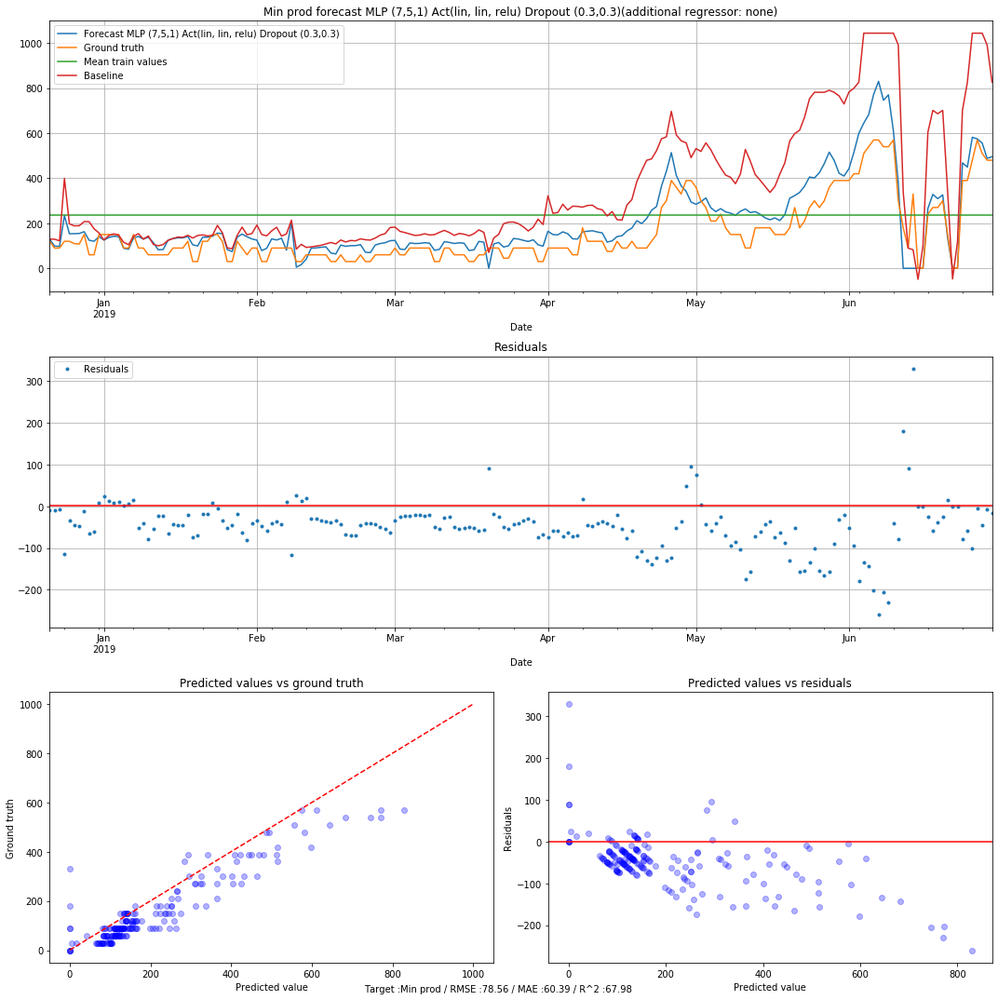

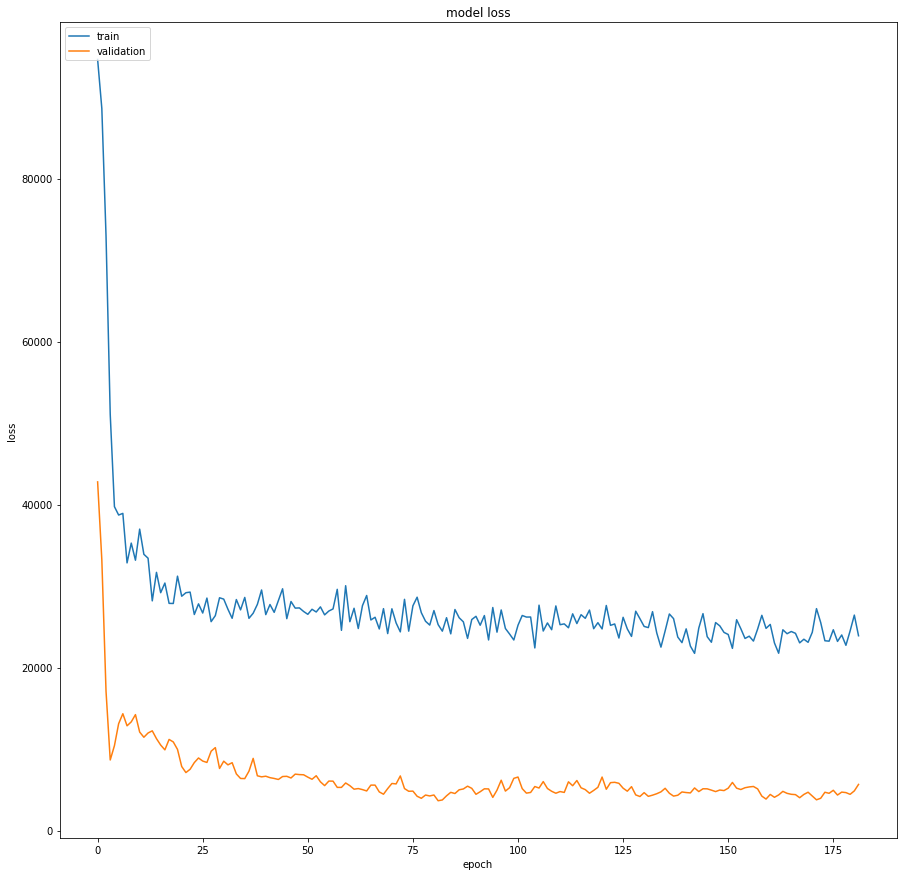

Model name MLP (9,7,1) Act(lin, lin, relu) Dropout (0.5,0.5)
Target : Min prod
Root Mean Square Error: 75.3122
Mean Absolute Error: 58.4959
R2 score : 70.5690



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_11 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_17 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_12 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 8         
Total params: 224
Trainable params: 224
Non-trainable params: 0
________________________________________________

1725/1725 [==============================] - 0s 90us/step - loss: 27416.3552 - mean_squared_error: 27416.3552 - mean_absolute_error: 112.8275 - val_loss: 9908.6626 - val_mean_squared_error: 9908.6626 - val_mean_absolute_error: 64.1834
Epoch 30/200
1725/1725 [==============================] - 0s 92us/step - loss: 27040.5671 - mean_squared_error: 27040.5671 - mean_absolute_error: 110.2247 - val_loss: 6821.2881 - val_mean_squared_error: 6821.2881 - val_mean_absolute_error: 51.7990
Epoch 31/200
1725/1725 [==============================] - 0s 89us/step - loss: 25849.0838 - mean_squared_error: 25849.0838 - mean_absolute_error: 109.9545 - val_loss: 8717.1587 - val_mean_squared_error: 8717.1587 - val_mean_absolute_error: 59.3285
Epoch 32/200
1725/1725 [==============================] - 0s 89us/step - loss: 25625.0887 - mean_squared_error: 25625.0887 - mean_absolute_error: 111.1163 - val_loss: 7447.8888 - val_mean_squared_error: 7447.8888 - val_mean_absolute_error: 54.5545
Epoch 33/200
1725/172

1725/1725 [==============================] - 0s 98us/step - loss: 27156.6370 - mean_squared_error: 27156.6370 - mean_absolute_error: 111.8048 - val_loss: 5210.7118 - val_mean_squared_error: 5210.7118 - val_mean_absolute_error: 48.9993
Epoch 63/200
1725/1725 [==============================] - 0s 90us/step - loss: 26353.5608 - mean_squared_error: 26353.5608 - mean_absolute_error: 108.5308 - val_loss: 4382.0272 - val_mean_squared_error: 4382.0272 - val_mean_absolute_error: 44.4009
Epoch 64/200
1725/1725 [==============================] - 0s 89us/step - loss: 27169.3632 - mean_squared_error: 27169.3632 - mean_absolute_error: 109.1575 - val_loss: 4164.0053 - val_mean_squared_error: 4164.0053 - val_mean_absolute_error: 43.1999
Epoch 65/200
1725/1725 [==============================] - 0s 89us/step - loss: 28974.6074 - mean_squared_error: 28974.6074 - mean_absolute_error: 111.7582 - val_loss: 3551.7669 - val_mean_squared_error: 3551.7669 - val_mean_absolute_error: 40.6209
Epoch 66/200
1725/172

1725/1725 [==============================] - 0s 96us/step - loss: 23907.6241 - mean_squared_error: 23907.6241 - mean_absolute_error: 106.2481 - val_loss: 4490.5288 - val_mean_squared_error: 4490.5288 - val_mean_absolute_error: 49.3169
Epoch 96/200
1725/1725 [==============================] - 0s 90us/step - loss: 24508.0182 - mean_squared_error: 24508.0182 - mean_absolute_error: 105.9777 - val_loss: 4767.4071 - val_mean_squared_error: 4767.4071 - val_mean_absolute_error: 51.1417
Epoch 97/200
1725/1725 [==============================] - 0s 89us/step - loss: 26657.8431 - mean_squared_error: 26657.8431 - mean_absolute_error: 110.0415 - val_loss: 5454.0376 - val_mean_squared_error: 5454.0376 - val_mean_absolute_error: 54.9223
Epoch 98/200
1725/1725 [==============================] - 0s 90us/step - loss: 23534.9585 - mean_squared_error: 23534.9585 - mean_absolute_error: 104.4864 - val_loss: 5559.8950 - val_mean_squared_error: 5559.8950 - val_mean_absolute_error: 55.3628
Epoch 99/200
1725/172

Epoch 128/200
1725/1725 [==============================] - 0s 90us/step - loss: 23055.5202 - mean_squared_error: 23055.5202 - mean_absolute_error: 103.1302 - val_loss: 4549.4304 - val_mean_squared_error: 4549.4304 - val_mean_absolute_error: 46.7927
Epoch 129/200
1725/1725 [==============================] - 0s 89us/step - loss: 25216.5230 - mean_squared_error: 25216.5230 - mean_absolute_error: 104.3645 - val_loss: 4151.0423 - val_mean_squared_error: 4151.0423 - val_mean_absolute_error: 45.9444
Epoch 130/200
1725/1725 [==============================] - 0s 90us/step - loss: 25253.2128 - mean_squared_error: 25253.2128 - mean_absolute_error: 107.2394 - val_loss: 4044.9917 - val_mean_squared_error: 4044.9917 - val_mean_absolute_error: 46.5087
Epoch 131/200
1725/1725 [==============================] - 0s 89us/step - loss: 25454.3093 - mean_squared_error: 25454.3093 - mean_absolute_error: 108.0109 - val_loss: 4260.4985 - val_mean_squared_error: 4260.4985 - val_mean_absolute_error: 49.9248
Epoc

Epoch 161/200
1725/1725 [==============================] - 0s 90us/step - loss: 23880.8281 - mean_squared_error: 23880.8281 - mean_absolute_error: 103.4440 - val_loss: 4748.8799 - val_mean_squared_error: 4748.8799 - val_mean_absolute_error: 52.2614
Epoch 162/200
1725/1725 [==============================] - 0s 90us/step - loss: 22768.5890 - mean_squared_error: 22768.5890 - mean_absolute_error: 101.5348 - val_loss: 4401.0720 - val_mean_squared_error: 4401.0720 - val_mean_absolute_error: 49.5156
Epoch 163/200
1725/1725 [==============================] - 0s 90us/step - loss: 21938.8348 - mean_squared_error: 21938.8348 - mean_absolute_error: 101.4787 - val_loss: 4361.1708 - val_mean_squared_error: 4361.1708 - val_mean_absolute_error: 49.8224
Epoch 164/200
1725/1725 [==============================] - 0s 90us/step - loss: 23814.2326 - mean_squared_error: 23814.2326 - mean_absolute_error: 104.0236 - val_loss: 5020.8234 - val_mean_squared_error: 5020.8234 - val_mean_absolute_error: 53.6129
Epoc

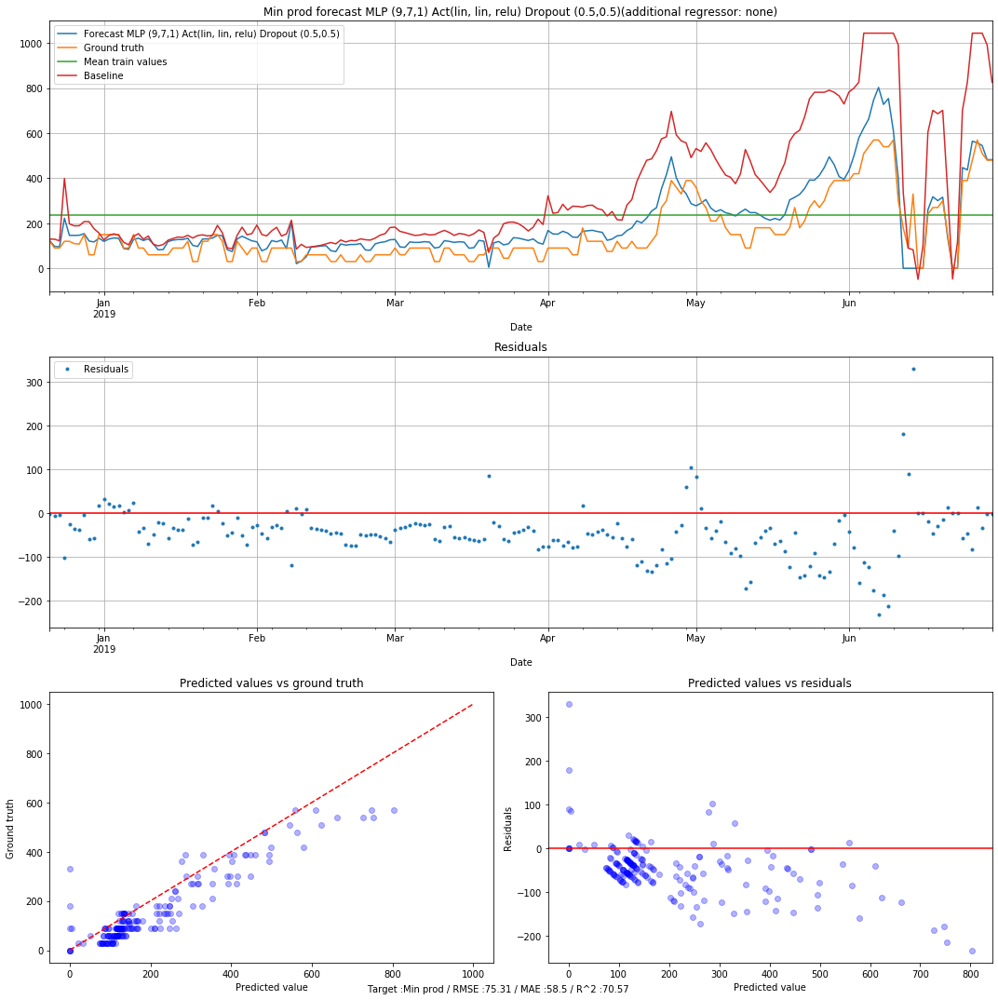

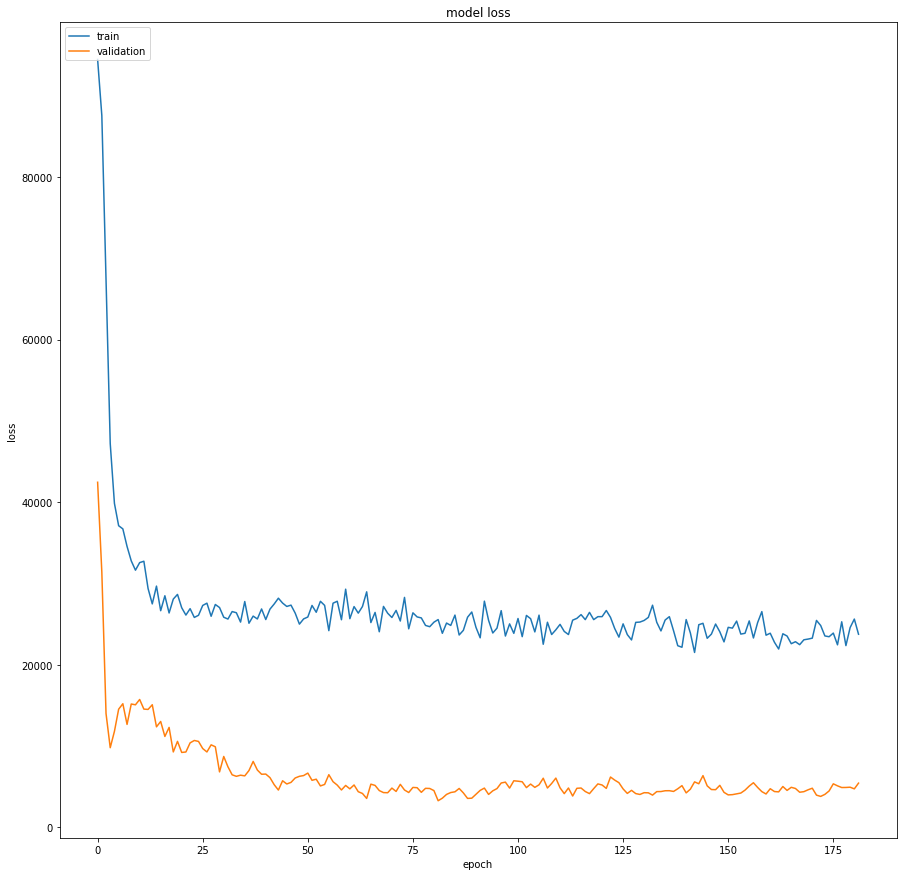

Model name MLP (11,7,1) Act(lin, lin, relu) Dropout (0.5,0.5)
Target : Min prod
Root Mean Square Error: 73.7303
Mean Absolute Error: 56.8930
R2 score : 71.7924



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_19 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_13 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_20 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_14 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 8         
Total params: 224
Trainable params: 224
Non-trainable params: 0
_______________________________________________

1725/1725 [==============================] - 0s 91us/step - loss: 13684.2916 - mean_squared_error: 13684.2916 - mean_absolute_error: 81.6003 - val_loss: 14017.2407 - val_mean_squared_error: 14017.2407 - val_mean_absolute_error: 82.3763
Epoch 30/200
1725/1725 [==============================] - 0s 91us/step - loss: 14037.7955 - mean_squared_error: 14037.7955 - mean_absolute_error: 82.1309 - val_loss: 13039.4509 - val_mean_squared_error: 13039.4509 - val_mean_absolute_error: 79.6033
Epoch 31/200
1725/1725 [==============================] - 0s 90us/step - loss: 13345.0821 - mean_squared_error: 13345.0821 - mean_absolute_error: 81.2782 - val_loss: 12865.6288 - val_mean_squared_error: 12865.6288 - val_mean_absolute_error: 79.7128
Epoch 32/200
1725/1725 [==============================] - 0s 91us/step - loss: 12697.4184 - mean_squared_error: 12697.4184 - mean_absolute_error: 81.1426 - val_loss: 13073.4372 - val_mean_squared_error: 13073.4372 - val_mean_absolute_error: 80.2744
Epoch 33/200
1725

Epoch 62/200
1725/1725 [==============================] - 0s 91us/step - loss: 13138.4965 - mean_squared_error: 13138.4965 - mean_absolute_error: 81.6043 - val_loss: 12477.7951 - val_mean_squared_error: 12477.7951 - val_mean_absolute_error: 81.3342
Epoch 63/200
1725/1725 [==============================] - 0s 91us/step - loss: 13902.5351 - mean_squared_error: 13902.5351 - mean_absolute_error: 82.7580 - val_loss: 10438.6762 - val_mean_squared_error: 10438.6762 - val_mean_absolute_error: 75.7264
Epoch 64/200
1725/1725 [==============================] - 0s 91us/step - loss: 13149.2681 - mean_squared_error: 13149.2681 - mean_absolute_error: 80.5813 - val_loss: 9869.2997 - val_mean_squared_error: 9869.2997 - val_mean_absolute_error: 75.1161
Epoch 65/200
1725/1725 [==============================] - 0s 92us/step - loss: 13108.5608 - mean_squared_error: 13108.5608 - mean_absolute_error: 81.9289 - val_loss: 9883.0287 - val_mean_squared_error: 9883.0287 - val_mean_absolute_error: 74.2324
Epoch 66

1725/1725 [==============================] - 0s 92us/step - loss: 13367.7924 - mean_squared_error: 13367.7924 - mean_absolute_error: 82.2247 - val_loss: 10021.7756 - val_mean_squared_error: 10021.7756 - val_mean_absolute_error: 75.4444
Epoch 96/200
1725/1725 [==============================] - 0s 90us/step - loss: 13316.3124 - mean_squared_error: 13316.3124 - mean_absolute_error: 82.3162 - val_loss: 10834.6762 - val_mean_squared_error: 10834.6762 - val_mean_absolute_error: 79.9014
Epoch 97/200
1725/1725 [==============================] - 0s 91us/step - loss: 13668.2409 - mean_squared_error: 13668.2409 - mean_absolute_error: 83.4129 - val_loss: 11914.5277 - val_mean_squared_error: 11914.5277 - val_mean_absolute_error: 84.5360
Epoch 98/200
1725/1725 [==============================] - 0s 91us/step - loss: 12465.0205 - mean_squared_error: 12465.0205 - mean_absolute_error: 79.4377 - val_loss: 11807.6440 - val_mean_squared_error: 11807.6440 - val_mean_absolute_error: 83.6784
Epoch 99/200
1725

Epoch 128/200
1725/1725 [==============================] - 0s 92us/step - loss: 12959.8208 - mean_squared_error: 12959.8208 - mean_absolute_error: 81.0187 - val_loss: 11322.9349 - val_mean_squared_error: 11322.9349 - val_mean_absolute_error: 79.7547
Epoch 129/200
1725/1725 [==============================] - 0s 90us/step - loss: 13536.8735 - mean_squared_error: 13536.8735 - mean_absolute_error: 81.6001 - val_loss: 9280.0944 - val_mean_squared_error: 9280.0944 - val_mean_absolute_error: 73.0479
Epoch 130/200
1725/1725 [==============================] - 0s 89us/step - loss: 12832.8956 - mean_squared_error: 12832.8956 - mean_absolute_error: 79.8111 - val_loss: 9446.6900 - val_mean_squared_error: 9446.6900 - val_mean_absolute_error: 72.6264
Epoch 131/200
1725/1725 [==============================] - 0s 91us/step - loss: 13279.7466 - mean_squared_error: 13279.7466 - mean_absolute_error: 82.2565 - val_loss: 9493.1728 - val_mean_squared_error: 9493.1728 - val_mean_absolute_error: 73.7137
Epoch 

Epoch 161/200
1725/1725 [==============================] - 0s 89us/step - loss: 12968.1901 - mean_squared_error: 12968.1901 - mean_absolute_error: 81.2618 - val_loss: 10304.9339 - val_mean_squared_error: 10304.9339 - val_mean_absolute_error: 77.5158
Epoch 162/200
1725/1725 [==============================] - 0s 90us/step - loss: 12665.4957 - mean_squared_error: 12665.4957 - mean_absolute_error: 78.9666 - val_loss: 10473.7612 - val_mean_squared_error: 10473.7612 - val_mean_absolute_error: 78.3573
Epoch 163/200
1725/1725 [==============================] - 0s 91us/step - loss: 13787.1732 - mean_squared_error: 13787.1732 - mean_absolute_error: 82.5862 - val_loss: 9167.6046 - val_mean_squared_error: 9167.6046 - val_mean_absolute_error: 73.4840
Epoch 164/200
1725/1725 [==============================] - 0s 90us/step - loss: 13429.8581 - mean_squared_error: 13429.8581 - mean_absolute_error: 81.9946 - val_loss: 10900.5718 - val_mean_squared_error: 10900.5718 - val_mean_absolute_error: 80.8241
Ep

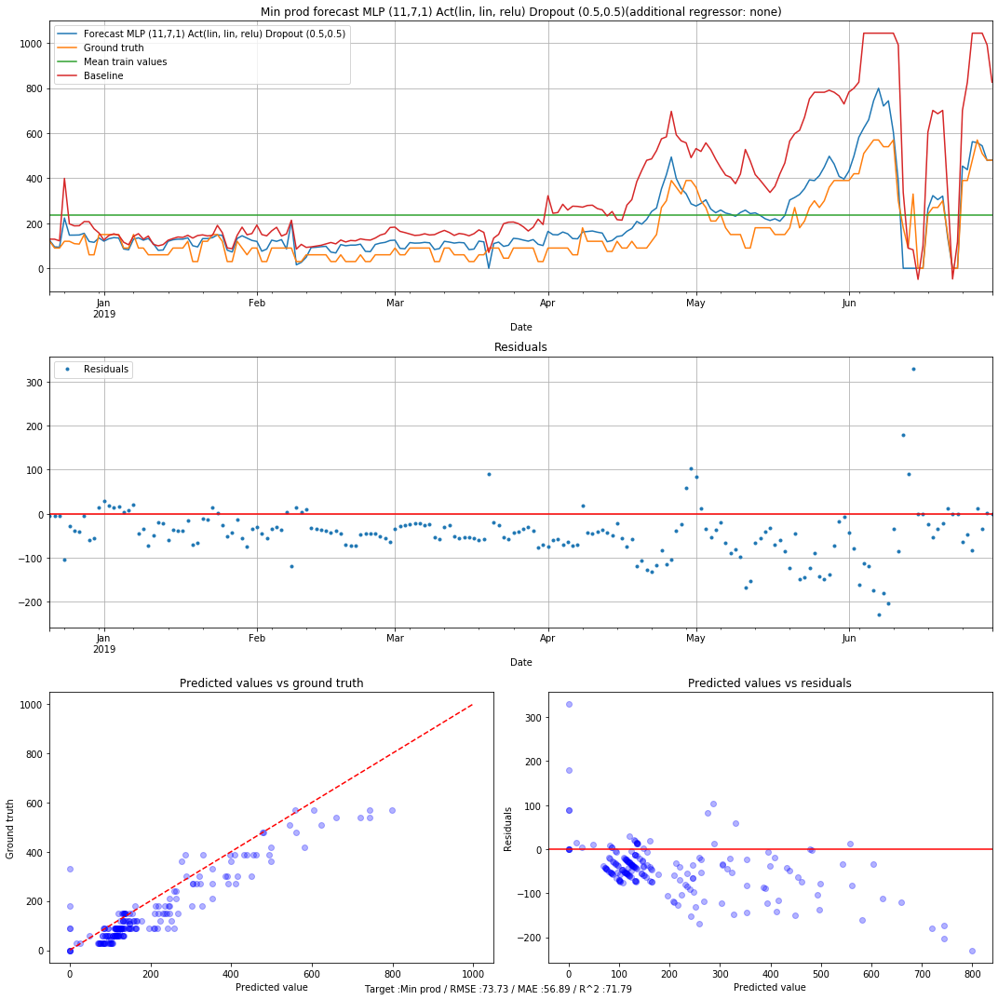

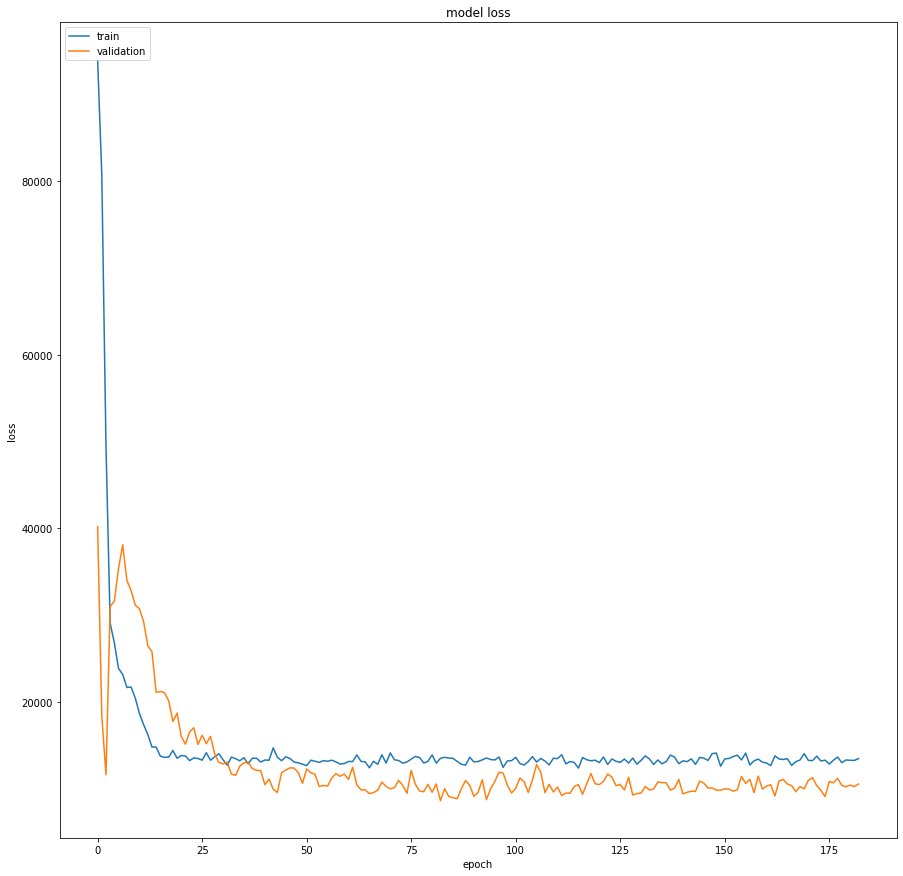

Model name MLP (11,7,1) Act(lin, lin, relu) Dropout (0.1,0.1)
Target : Min prod
Root Mean Square Error: 102.7216
Mean Absolute Error: 77.6024
R2 score : 45.2482



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_22 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_15 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_23 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_16 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_24 (Dense)             (None, 3)                 24        
_________________________________________________________________
dropout_17 (Dropout)         (None, 3)      

Epoch 28/200
1725/1725 [==============================] - 0s 106us/step - loss: 15825.5183 - mean_squared_error: 15825.5183 - mean_absolute_error: 89.1763 - val_loss: 11616.2098 - val_mean_squared_error: 11616.2098 - val_mean_absolute_error: 72.8252
Epoch 29/200
1725/1725 [==============================] - 0s 104us/step - loss: 17038.1967 - mean_squared_error: 17038.1967 - mean_absolute_error: 90.3008 - val_loss: 11743.1680 - val_mean_squared_error: 11743.1680 - val_mean_absolute_error: 76.1110
Epoch 30/200
1725/1725 [==============================] - 0s 103us/step - loss: 17035.2279 - mean_squared_error: 17035.2279 - mean_absolute_error: 88.7982 - val_loss: 11361.3765 - val_mean_squared_error: 11361.3765 - val_mean_absolute_error: 76.1255
Epoch 31/200
1725/1725 [==============================] - 0s 104us/step - loss: 15724.4936 - mean_squared_error: 15724.4936 - mean_absolute_error: 88.0423 - val_loss: 13580.8419 - val_mean_squared_error: 13580.8419 - val_mean_absolute_error: 83.8090


Epoch 61/200
1725/1725 [==============================] - 0s 106us/step - loss: 16355.5080 - mean_squared_error: 16355.5080 - mean_absolute_error: 88.4700 - val_loss: 7442.8312 - val_mean_squared_error: 7442.8312 - val_mean_absolute_error: 65.2747
Epoch 62/200
1725/1725 [==============================] - 0s 104us/step - loss: 16418.2084 - mean_squared_error: 16418.2084 - mean_absolute_error: 89.2311 - val_loss: 8037.2242 - val_mean_squared_error: 8037.2242 - val_mean_absolute_error: 69.6677
Epoch 63/200
1725/1725 [==============================] - 0s 104us/step - loss: 16471.1488 - mean_squared_error: 16471.1488 - mean_absolute_error: 89.6863 - val_loss: 10728.5223 - val_mean_squared_error: 10728.5223 - val_mean_absolute_error: 80.6776
Epoch 64/200
1725/1725 [==============================] - 0s 103us/step - loss: 16410.8864 - mean_squared_error: 16410.8864 - mean_absolute_error: 90.4704 - val_loss: 8224.1443 - val_mean_squared_error: 8224.1443 - val_mean_absolute_error: 70.2429
Epoch 

1725/1725 [==============================] - 0s 112us/step - loss: 15650.3116 - mean_squared_error: 15650.3116 - mean_absolute_error: 88.0254 - val_loss: 9770.2794 - val_mean_squared_error: 9770.2794 - val_mean_absolute_error: 75.7096
Epoch 95/200
1725/1725 [==============================] - 0s 104us/step - loss: 16263.6742 - mean_squared_error: 16263.6742 - mean_absolute_error: 90.0136 - val_loss: 8715.7472 - val_mean_squared_error: 8715.7472 - val_mean_absolute_error: 71.7904
Epoch 96/200
1725/1725 [==============================] - 0s 103us/step - loss: 15256.0732 - mean_squared_error: 15256.0732 - mean_absolute_error: 86.8920 - val_loss: 7597.5050 - val_mean_squared_error: 7597.5050 - val_mean_absolute_error: 67.3702
Epoch 97/200
1725/1725 [==============================] - 0s 105us/step - loss: 15910.2518 - mean_squared_error: 15910.2518 - mean_absolute_error: 89.7167 - val_loss: 7247.3817 - val_mean_squared_error: 7247.3817 - val_mean_absolute_error: 65.6442
Epoch 98/200
1725/172

Epoch 127/200
1725/1725 [==============================] - 0s 107us/step - loss: 15717.0804 - mean_squared_error: 15717.0804 - mean_absolute_error: 88.3883 - val_loss: 7959.7982 - val_mean_squared_error: 7959.7982 - val_mean_absolute_error: 67.4275
Epoch 128/200
1725/1725 [==============================] - 0s 104us/step - loss: 16315.7670 - mean_squared_error: 16315.7670 - mean_absolute_error: 87.9881 - val_loss: 8015.9865 - val_mean_squared_error: 8015.9865 - val_mean_absolute_error: 68.3439
Epoch 129/200
1725/1725 [==============================] - 0s 103us/step - loss: 16166.2453 - mean_squared_error: 16166.2453 - mean_absolute_error: 88.4274 - val_loss: 7574.0211 - val_mean_squared_error: 7574.0211 - val_mean_absolute_error: 67.1701
Epoch 130/200
1725/1725 [==============================] - 0s 107us/step - loss: 16133.8343 - mean_squared_error: 16133.8343 - mean_absolute_error: 87.2291 - val_loss: 8313.4594 - val_mean_squared_error: 8313.4594 - val_mean_absolute_error: 69.3724
Epoc

Epoch 160/200
1725/1725 [==============================] - 0s 104us/step - loss: 16560.5272 - mean_squared_error: 16560.5272 - mean_absolute_error: 88.7029 - val_loss: 8525.2295 - val_mean_squared_error: 8525.2295 - val_mean_absolute_error: 71.9698
Epoch 161/200
1725/1725 [==============================] - 0s 105us/step - loss: 15923.0242 - mean_squared_error: 15923.0242 - mean_absolute_error: 88.9720 - val_loss: 9385.4028 - val_mean_squared_error: 9385.4028 - val_mean_absolute_error: 73.6006
Epoch 162/200
1725/1725 [==============================] - 0s 104us/step - loss: 15372.7303 - mean_squared_error: 15372.7303 - mean_absolute_error: 86.9035 - val_loss: 8122.0642 - val_mean_squared_error: 8122.0642 - val_mean_absolute_error: 68.7798
Epoch 163/200
1725/1725 [==============================] - 0s 105us/step - loss: 17030.3108 - mean_squared_error: 17030.3108 - mean_absolute_error: 89.0913 - val_loss: 6315.4005 - val_mean_squared_error: 6315.4005 - val_mean_absolute_error: 60.4280
Epoc

Epoch 193/200
1725/1725 [==============================] - 0s 134us/step - loss: 15817.8123 - mean_squared_error: 15817.8123 - mean_absolute_error: 87.0896 - val_loss: 8210.4169 - val_mean_squared_error: 8210.4169 - val_mean_absolute_error: 69.5855
Epoch 194/200
1725/1725 [==============================] - 0s 135us/step - loss: 16905.4020 - mean_squared_error: 16905.4020 - mean_absolute_error: 89.9337 - val_loss: 10200.1981 - val_mean_squared_error: 10200.1981 - val_mean_absolute_error: 77.9424
Epoch 195/200
1725/1725 [==============================] - 0s 140us/step - loss: 15212.8010 - mean_squared_error: 15212.8010 - mean_absolute_error: 87.6353 - val_loss: 7541.2589 - val_mean_squared_error: 7541.2589 - val_mean_absolute_error: 65.2390
Epoch 196/200
1725/1725 [==============================] - 0s 120us/step - loss: 16043.2872 - mean_squared_error: 16043.2872 - mean_absolute_error: 86.6134 - val_loss: 9560.3744 - val_mean_squared_error: 9560.3744 - val_mean_absolute_error: 70.9779
Ep

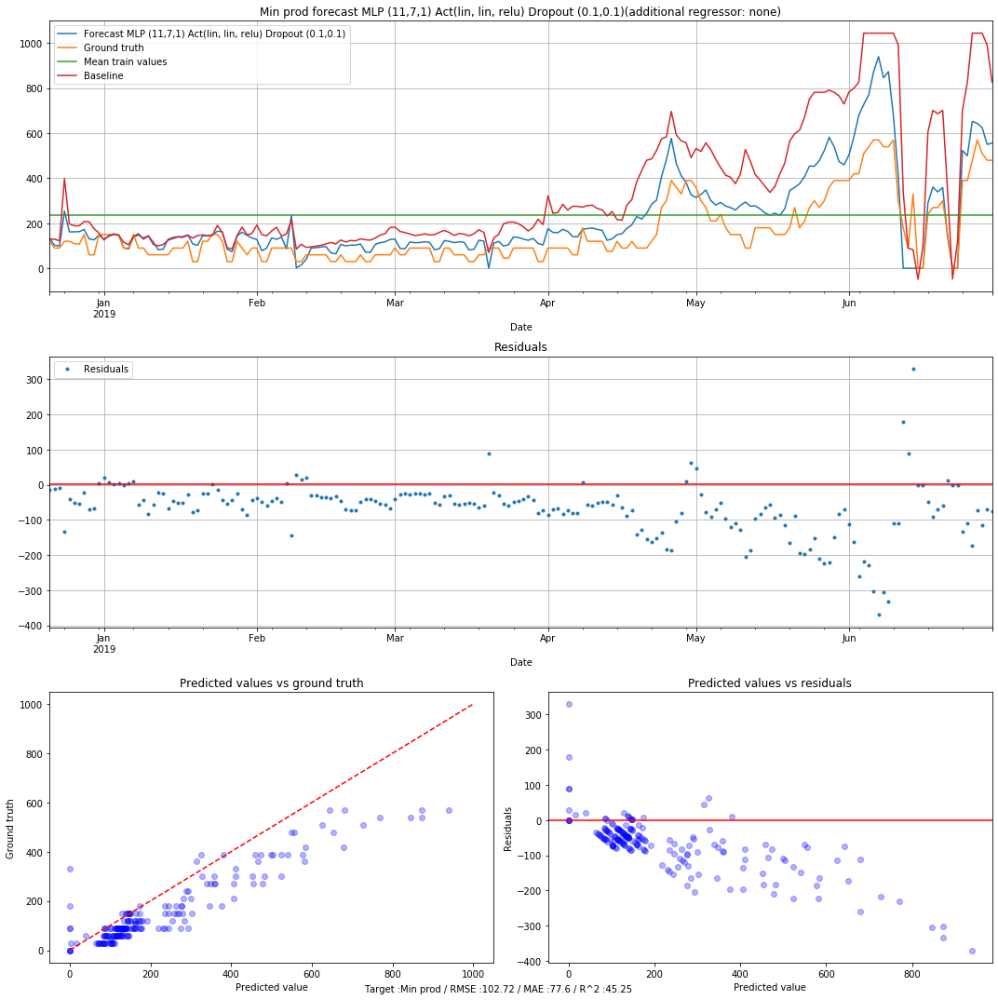

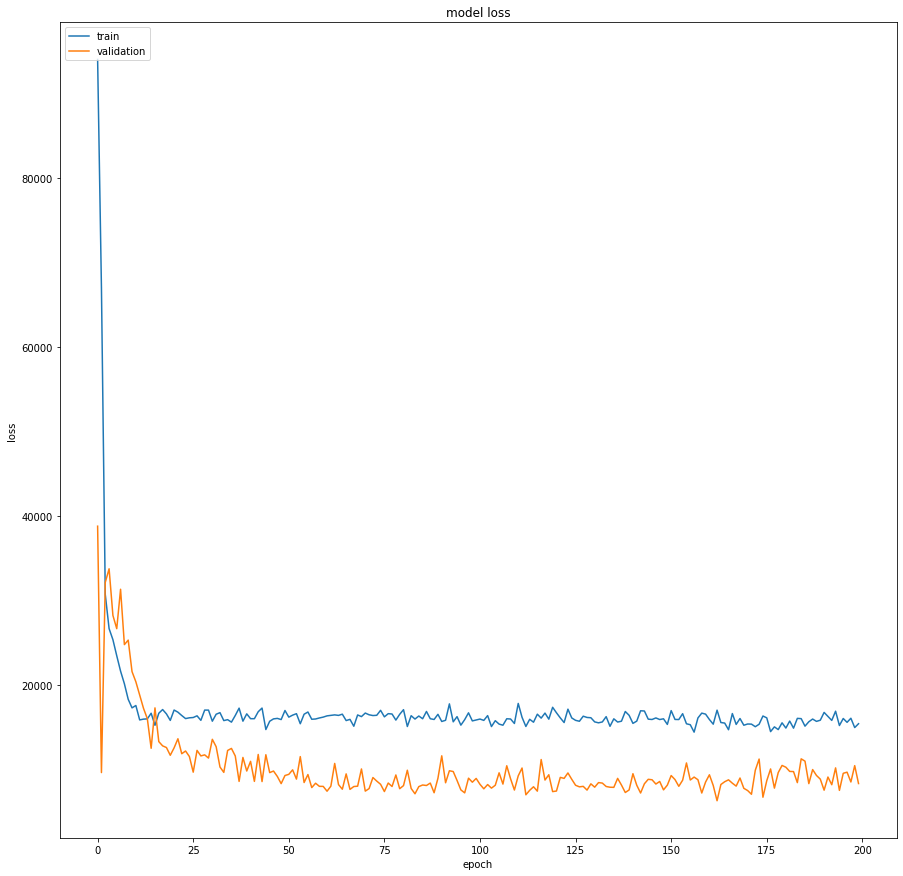

Model name MLP (11,7,3,1) Act(lin, lin, lin, relu) Dropout (0.1,0.1,0.1)
Target : Min prod
Root Mean Square Error: 91.3767
Mean Absolute Error: 70.3331
R2 score : 56.6743



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_26 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_18 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_27 (Dense)             (None, 5)                 40        
_________________________________________________________________
dropout_19 (Dropout)         (None, 5)                 0         
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 6         
Total params: 130
Trainable params: 130
Non-trainable params: 0
____________________________________

1725/1725 [==============================] - 0s 98us/step - loss: 280555.5724 - mean_squared_error: 280555.5724 - mean_absolute_error: 441.1219 - val_loss: 115870.1230 - val_mean_squared_error: 115870.1230 - val_mean_absolute_error: 258.2466
Epoch 29/200
1725/1725 [==============================] - 0s 93us/step - loss: 284833.4494 - mean_squared_error: 284833.4494 - mean_absolute_error: 445.0764 - val_loss: 113430.3652 - val_mean_squared_error: 113430.3652 - val_mean_absolute_error: 255.9497
Epoch 30/200
1725/1725 [==============================] - 0s 94us/step - loss: 285538.1221 - mean_squared_error: 285538.1221 - mean_absolute_error: 442.4879 - val_loss: 117244.0318 - val_mean_squared_error: 117244.0318 - val_mean_absolute_error: 259.7039
Epoch 31/200
1725/1725 [==============================] - 0s 93us/step - loss: 281898.7754 - mean_squared_error: 281898.7754 - mean_absolute_error: 444.0385 - val_loss: 117448.1191 - val_mean_squared_error: 117448.1191 - val_mean_absolute_error: 26

1725/1725 [==============================] - 0s 108us/step - loss: 230259.2345 - mean_squared_error: 230259.2345 - mean_absolute_error: 384.3716 - val_loss: 97292.7145 - val_mean_squared_error: 97292.7145 - val_mean_absolute_error: 205.5349
Epoch 61/200
1725/1725 [==============================] - 0s 115us/step - loss: 230488.9012 - mean_squared_error: 230488.9012 - mean_absolute_error: 386.5889 - val_loss: 94280.3531 - val_mean_squared_error: 94280.3531 - val_mean_absolute_error: 202.8068
Epoch 62/200
1725/1725 [==============================] - 0s 111us/step - loss: 224163.1834 - mean_squared_error: 224163.1834 - mean_absolute_error: 379.1069 - val_loss: 92859.4466 - val_mean_squared_error: 92859.4466 - val_mean_absolute_error: 199.9450
Epoch 63/200
1725/1725 [==============================] - 0s 114us/step - loss: 224053.1064 - mean_squared_error: 224053.1064 - mean_absolute_error: 377.5565 - val_loss: 93754.9080 - val_mean_squared_error: 93754.9080 - val_mean_absolute_error: 202.99

1725/1725 [==============================] - 0s 97us/step - loss: 219416.1779 - mean_squared_error: 219416.1779 - mean_absolute_error: 375.1356 - val_loss: 87417.3308 - val_mean_squared_error: 87417.3308 - val_mean_absolute_error: 195.3455
Epoch 93/200
1725/1725 [==============================] - 0s 95us/step - loss: 209534.5634 - mean_squared_error: 209534.5634 - mean_absolute_error: 370.6938 - val_loss: 87853.6196 - val_mean_squared_error: 87853.6196 - val_mean_absolute_error: 196.7234
Epoch 94/200
1725/1725 [==============================] - 0s 96us/step - loss: 219321.4274 - mean_squared_error: 219321.4274 - mean_absolute_error: 374.6135 - val_loss: 89379.2794 - val_mean_squared_error: 89379.2794 - val_mean_absolute_error: 197.8868
Epoch 95/200
1725/1725 [==============================] - 0s 95us/step - loss: 231640.6641 - mean_squared_error: 231640.6641 - mean_absolute_error: 385.0012 - val_loss: 89260.3968 - val_mean_squared_error: 89260.3968 - val_mean_absolute_error: 198.3686
E

Epoch 124/200
1725/1725 [==============================] - 0s 97us/step - loss: 218675.0802 - mean_squared_error: 218675.0802 - mean_absolute_error: 375.4851 - val_loss: 88792.4720 - val_mean_squared_error: 88792.4720 - val_mean_absolute_error: 197.2986
Epoch 125/200
1725/1725 [==============================] - 0s 93us/step - loss: 210978.9943 - mean_squared_error: 210978.9943 - mean_absolute_error: 366.6340 - val_loss: 87763.4432 - val_mean_squared_error: 87763.4432 - val_mean_absolute_error: 196.6493
Epoch 126/200
1725/1725 [==============================] - 0s 98us/step - loss: 211069.4658 - mean_squared_error: 211069.4658 - mean_absolute_error: 370.4079 - val_loss: 86612.4229 - val_mean_squared_error: 86612.4229 - val_mean_absolute_error: 194.1196
Epoch 127/200
1725/1725 [==============================] - 0s 97us/step - loss: 218115.8964 - mean_squared_error: 218115.8964 - mean_absolute_error: 373.0076 - val_loss: 88683.9195 - val_mean_squared_error: 88683.9195 - val_mean_absolute_

1725/1725 [==============================] - 0s 119us/step - loss: 197679.9250 - mean_squared_error: 197679.9250 - mean_absolute_error: 357.9437 - val_loss: 86050.8824 - val_mean_squared_error: 86050.8824 - val_mean_absolute_error: 188.0128
Epoch 157/200
1725/1725 [==============================] - 0s 110us/step - loss: 203726.0284 - mean_squared_error: 203726.0284 - mean_absolute_error: 360.5568 - val_loss: 85283.4236 - val_mean_squared_error: 85283.4236 - val_mean_absolute_error: 186.5212
Epoch 158/200
1725/1725 [==============================] - 0s 105us/step - loss: 210738.8981 - mean_squared_error: 210738.8981 - mean_absolute_error: 368.3826 - val_loss: 86145.0369 - val_mean_squared_error: 86145.0369 - val_mean_absolute_error: 188.6969
Epoch 159/200
1725/1725 [==============================] - 0s 96us/step - loss: 208148.2018 - mean_squared_error: 208148.2018 - mean_absolute_error: 363.5182 - val_loss: 87216.2267 - val_mean_squared_error: 87216.2267 - val_mean_absolute_error: 186.

1725/1725 [==============================] - 0s 96us/step - loss: 206373.7865 - mean_squared_error: 206373.7865 - mean_absolute_error: 365.7477 - val_loss: 86048.6665 - val_mean_squared_error: 86048.6665 - val_mean_absolute_error: 189.5277
Epoch 189/200
1725/1725 [==============================] - 0s 94us/step - loss: 195363.4510 - mean_squared_error: 195363.4510 - mean_absolute_error: 353.2433 - val_loss: 85775.8994 - val_mean_squared_error: 85775.8994 - val_mean_absolute_error: 190.7992
Epoch 190/200
1725/1725 [==============================] - 0s 93us/step - loss: 198134.2268 - mean_squared_error: 198134.2268 - mean_absolute_error: 359.1364 - val_loss: 84485.6306 - val_mean_squared_error: 84485.6306 - val_mean_absolute_error: 190.4719
Epoch 191/200
1725/1725 [==============================] - 0s 93us/step - loss: 193022.2565 - mean_squared_error: 193022.2565 - mean_absolute_error: 352.8524 - val_loss: 84232.5847 - val_mean_squared_error: 84232.5847 - val_mean_absolute_error: 191.819

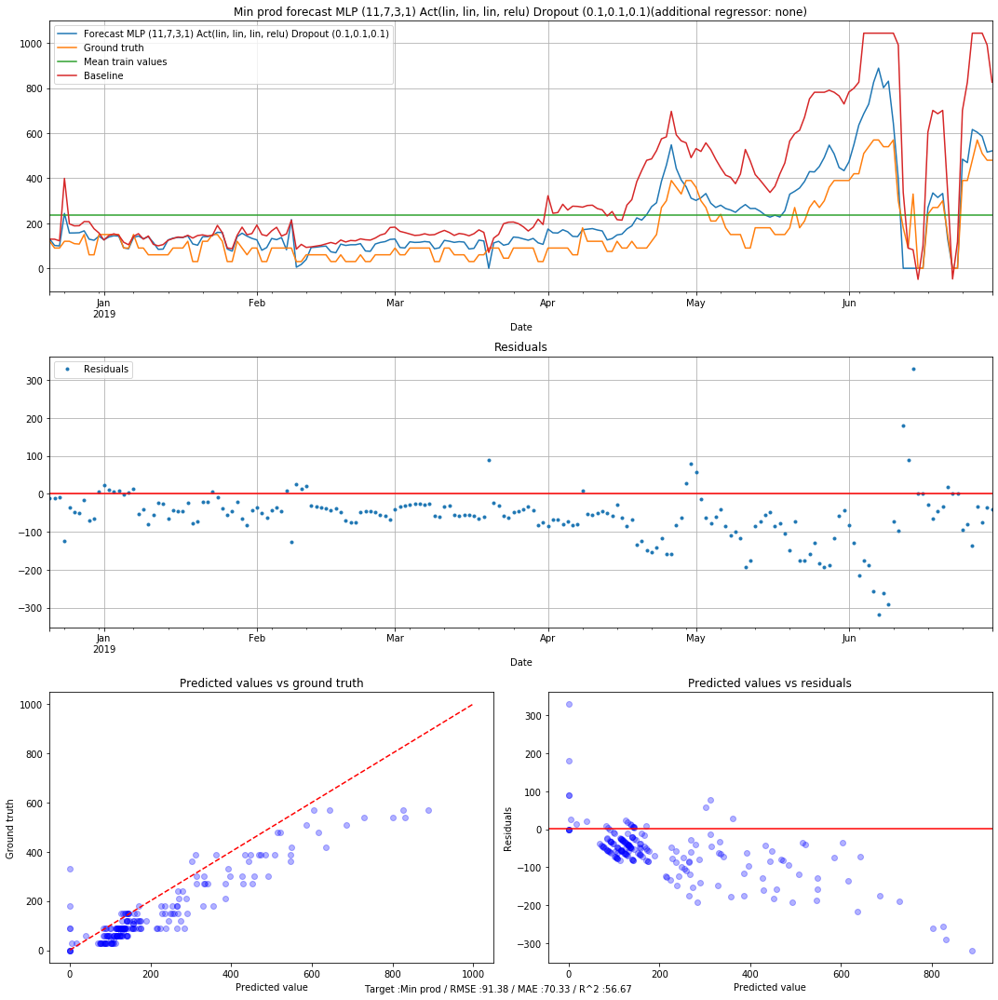

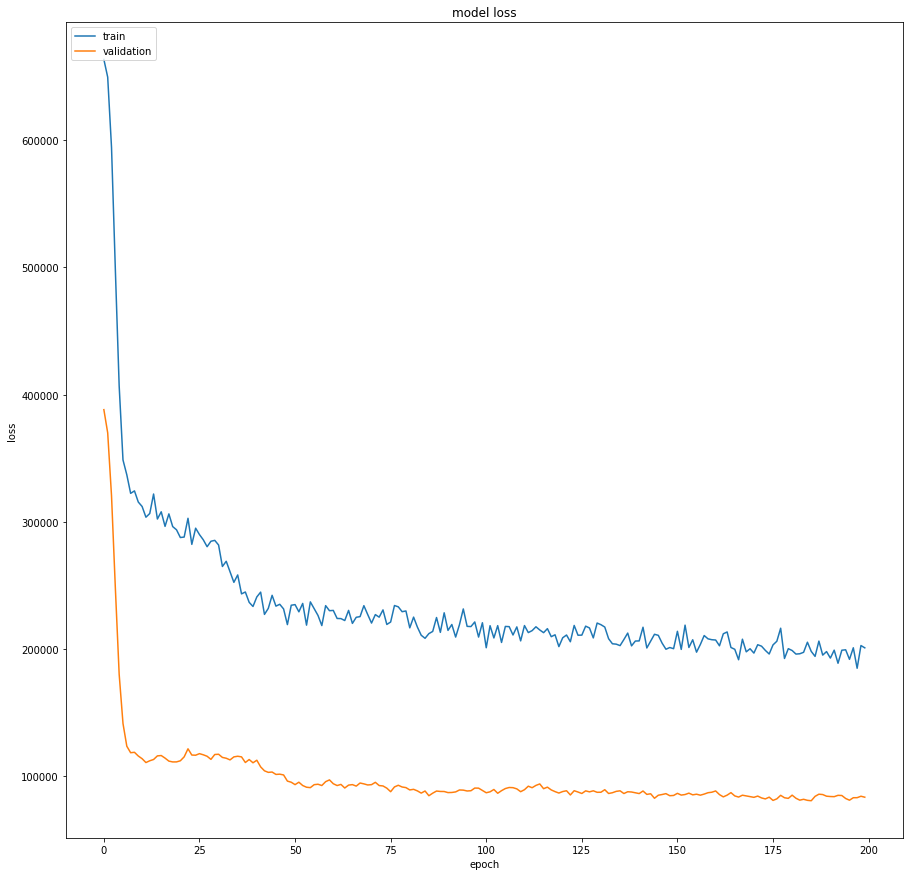

Model name MLP (7,5,1) Act(lin, lin, relu) Dropout (0.5,0.5)
Target : Max prod
Root Mean Square Error: 289.2941
Mean Absolute Error: 186.7101
R2 score : 60.7919



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_29 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_20 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_30 (Dense)             (None, 5)                 40        
_________________________________________________________________
dropout_21 (Dropout)         (None, 5)                 0         
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 6         
Total params: 130
Trainable params: 130
Non-trainable params: 0
______________________________________________

1725/1725 [==============================] - 0s 99us/step - loss: 236447.8987 - mean_squared_error: 236447.8987 - mean_absolute_error: 401.0955 - val_loss: 99719.4417 - val_mean_squared_error: 99719.4417 - val_mean_absolute_error: 242.0992
Epoch 29/200
1725/1725 [==============================] - ETA: 0s - loss: 234335.5197 - mean_squared_error: 234335.5197 - mean_absolute_error: 397.11 - 0s 98us/step - loss: 235088.6035 - mean_squared_error: 235088.6035 - mean_absolute_error: 398.0735 - val_loss: 97624.2050 - val_mean_squared_error: 97624.2050 - val_mean_absolute_error: 240.1406
Epoch 30/200
1725/1725 [==============================] - 0s 104us/step - loss: 226018.1066 - mean_squared_error: 226018.1066 - mean_absolute_error: 392.7350 - val_loss: 98076.9537 - val_mean_squared_error: 98076.9537 - val_mean_absolute_error: 241.0546
Epoch 31/200
1725/1725 [==============================] - 0s 114us/step - loss: 229891.0240 - mean_squared_error: 229891.0240 - mean_absolute_error: 393.7682 -

1725/1725 [==============================] - 0s 102us/step - loss: 196610.5298 - mean_squared_error: 196610.5298 - mean_absolute_error: 352.8182 - val_loss: 82944.5575 - val_mean_squared_error: 82944.5575 - val_mean_absolute_error: 194.0389
Epoch 61/200
1725/1725 [==============================] - 0s 96us/step - loss: 194495.1237 - mean_squared_error: 194495.1237 - mean_absolute_error: 356.5583 - val_loss: 79488.8900 - val_mean_squared_error: 79488.8900 - val_mean_absolute_error: 190.0645
Epoch 62/200
1725/1725 [==============================] - 0s 96us/step - loss: 185572.2171 - mean_squared_error: 185572.2171 - mean_absolute_error: 346.0459 - val_loss: 78748.2463 - val_mean_squared_error: 78748.2463 - val_mean_absolute_error: 187.5204
Epoch 63/200
1725/1725 [==============================] - 0s 97us/step - loss: 185589.8796 - mean_squared_error: 185589.8796 - mean_absolute_error: 342.1272 - val_loss: 78514.1469 - val_mean_squared_error: 78514.1469 - val_mean_absolute_error: 187.7446


1725/1725 [==============================] - 0s 96us/step - loss: 178682.8892 - mean_squared_error: 178682.8892 - mean_absolute_error: 336.1490 - val_loss: 74473.9314 - val_mean_squared_error: 74473.9314 - val_mean_absolute_error: 186.6187
Epoch 93/200
1725/1725 [==============================] - 0s 97us/step - loss: 176155.9303 - mean_squared_error: 176155.9303 - mean_absolute_error: 339.5628 - val_loss: 76002.3119 - val_mean_squared_error: 76002.3119 - val_mean_absolute_error: 187.5815
Epoch 94/200
1725/1725 [==============================] - 0s 97us/step - loss: 183273.0967 - mean_squared_error: 183273.0967 - mean_absolute_error: 344.7902 - val_loss: 77815.6714 - val_mean_squared_error: 77815.6714 - val_mean_absolute_error: 188.3796
Epoch 95/200
1725/1725 [==============================] - 0s 97us/step - loss: 191552.4653 - mean_squared_error: 191552.4653 - mean_absolute_error: 350.7124 - val_loss: 76760.8755 - val_mean_squared_error: 76760.8755 - val_mean_absolute_error: 187.3120
E

1725/1725 [==============================] - 0s 101us/step - loss: 176190.5224 - mean_squared_error: 176190.5224 - mean_absolute_error: 336.6768 - val_loss: 75051.2927 - val_mean_squared_error: 75051.2927 - val_mean_absolute_error: 185.1424
Epoch 125/200
1725/1725 [==============================] - 0s 112us/step - loss: 173097.8803 - mean_squared_error: 173097.8803 - mean_absolute_error: 333.4278 - val_loss: 74139.7860 - val_mean_squared_error: 74139.7860 - val_mean_absolute_error: 183.2718
Epoch 126/200
1725/1725 [==============================] - 0s 112us/step - loss: 174848.5016 - mean_squared_error: 174848.5016 - mean_absolute_error: 333.8708 - val_loss: 73700.8796 - val_mean_squared_error: 73700.8796 - val_mean_absolute_error: 181.0747
Epoch 127/200
1725/1725 [==============================] - 0s 109us/step - loss: 184741.1362 - mean_squared_error: 184741.1362 - mean_absolute_error: 340.6481 - val_loss: 75972.2059 - val_mean_squared_error: 75972.2059 - val_mean_absolute_error: 183

1725/1725 [==============================] - 0s 98us/step - loss: 172835.4009 - mean_squared_error: 172835.4009 - mean_absolute_error: 334.7245 - val_loss: 74388.6511 - val_mean_squared_error: 74388.6511 - val_mean_absolute_error: 180.9668
Epoch 157/200
1725/1725 [==============================] - 0s 97us/step - loss: 171939.9256 - mean_squared_error: 171939.9256 - mean_absolute_error: 333.3512 - val_loss: 73712.7474 - val_mean_squared_error: 73712.7474 - val_mean_absolute_error: 180.2255
Epoch 158/200
1725/1725 [==============================] - 0s 98us/step - loss: 180213.5785 - mean_squared_error: 180213.5785 - mean_absolute_error: 339.2769 - val_loss: 74516.2080 - val_mean_squared_error: 74516.2080 - val_mean_absolute_error: 183.6109
Epoch 159/200
1725/1725 [==============================] - 0s 96us/step - loss: 181878.9397 - mean_squared_error: 181878.9397 - mean_absolute_error: 340.4254 - val_loss: 75462.6088 - val_mean_squared_error: 75462.6088 - val_mean_absolute_error: 181.996

Epoch 188/200
1725/1725 [==============================] - 0s 97us/step - loss: 174780.1470 - mean_squared_error: 174780.1470 - mean_absolute_error: 338.5200 - val_loss: 76052.5272 - val_mean_squared_error: 76052.5272 - val_mean_absolute_error: 184.4197
Epoch 189/200
1725/1725 [==============================] - 0s 97us/step - loss: 167036.2701 - mean_squared_error: 167036.2701 - mean_absolute_error: 325.5436 - val_loss: 75443.6394 - val_mean_squared_error: 75443.6394 - val_mean_absolute_error: 184.1209
Epoch 190/200
1725/1725 [==============================] - 0s 96us/step - loss: 172009.7401 - mean_squared_error: 172009.7401 - mean_absolute_error: 331.8849 - val_loss: 74889.6907 - val_mean_squared_error: 74889.6907 - val_mean_absolute_error: 183.8718
Epoch 191/200
1725/1725 [==============================] - 0s 97us/step - loss: 167739.8221 - mean_squared_error: 167739.8221 - mean_absolute_error: 326.2177 - val_loss: 73930.8731 - val_mean_squared_error: 73930.8731 - val_mean_absolute_

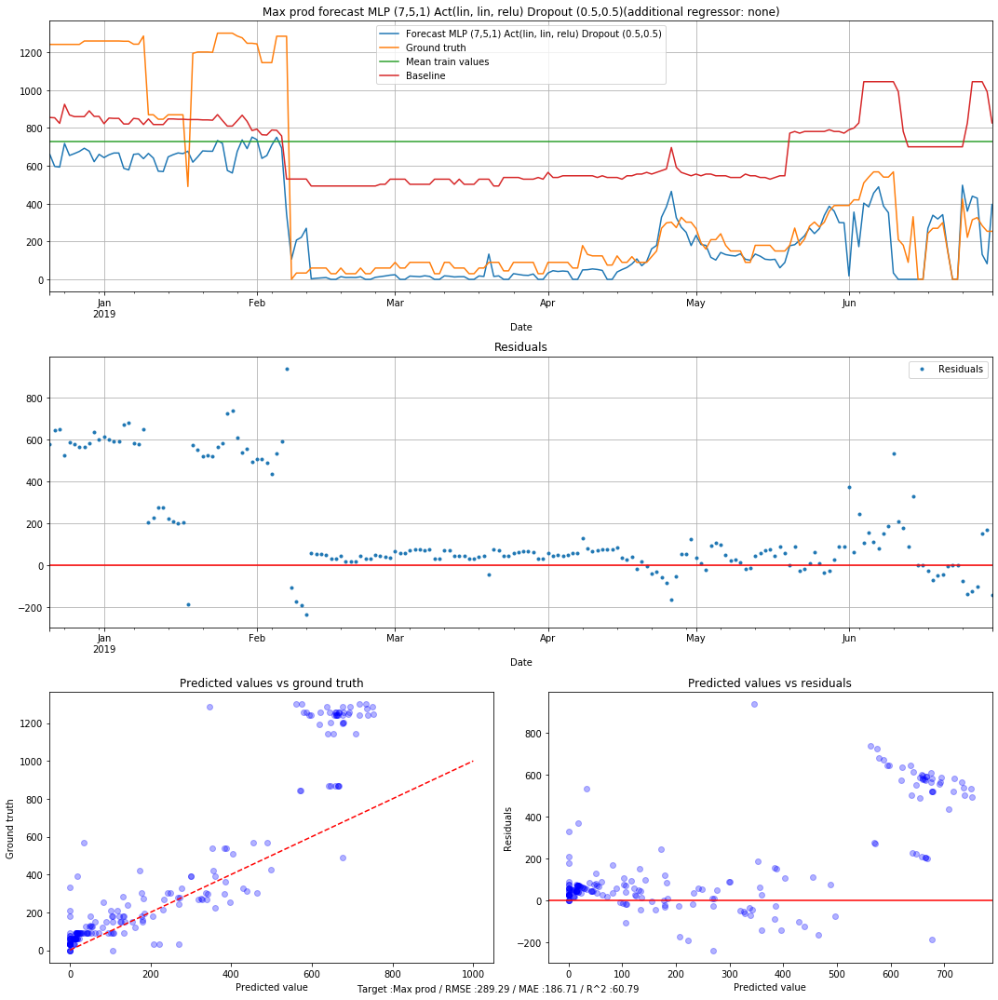

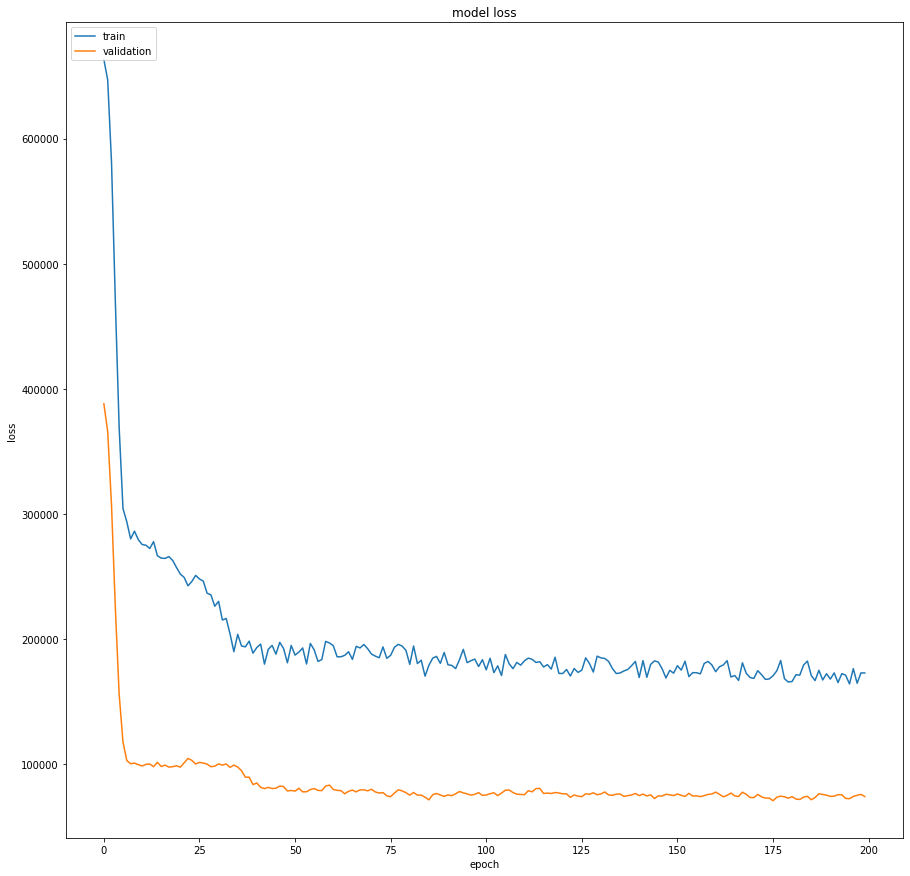

Model name MLP (7,5,1) Act(lin, lin, relu) Dropout (0.4,0.4)
Target : Max prod
Root Mean Square Error: 271.7015
Mean Absolute Error: 182.0986
R2 score : 65.4156



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_32 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_22 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_33 (Dense)             (None, 5)                 40        
_________________________________________________________________
dropout_23 (Dropout)         (None, 5)                 0         
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 6         
Total params: 130
Trainable params: 130
Non-trainable params: 0
______________________________________________

1725/1725 [==============================] - 0s 97us/step - loss: 200528.7406 - mean_squared_error: 200528.7406 - mean_absolute_error: 366.3895 - val_loss: 86769.1819 - val_mean_squared_error: 86769.1819 - val_mean_absolute_error: 227.8814
Epoch 29/200
1725/1725 [==============================] - 0s 96us/step - loss: 199912.0670 - mean_squared_error: 199912.0670 - mean_absolute_error: 364.2690 - val_loss: 83949.0260 - val_mean_squared_error: 83949.0260 - val_mean_absolute_error: 224.8049
Epoch 30/200
1725/1725 [==============================] - 0s 96us/step - loss: 190656.1077 - mean_squared_error: 190656.1077 - mean_absolute_error: 357.3855 - val_loss: 83875.6438 - val_mean_squared_error: 83875.6438 - val_mean_absolute_error: 225.4110
Epoch 31/200
1725/1725 [==============================] - 0s 96us/step - loss: 191111.3650 - mean_squared_error: 191111.3650 - mean_absolute_error: 358.0253 - val_loss: 87784.2978 - val_mean_squared_error: 87784.2978 - val_mean_absolute_error: 230.4595
E

1725/1725 [==============================] - 0s 98us/step - loss: 161718.2919 - mean_squared_error: 161718.2919 - mean_absolute_error: 322.1596 - val_loss: 69241.6511 - val_mean_squared_error: 69241.6511 - val_mean_absolute_error: 180.9910
Epoch 61/200
1725/1725 [==============================] - 0s 97us/step - loss: 159800.4879 - mean_squared_error: 159800.4879 - mean_absolute_error: 320.6381 - val_loss: 66903.6888 - val_mean_squared_error: 66903.6888 - val_mean_absolute_error: 178.4073
Epoch 62/200
1725/1725 [==============================] - 0s 96us/step - loss: 151197.9774 - mean_squared_error: 151197.9774 - mean_absolute_error: 312.2621 - val_loss: 67020.9475 - val_mean_squared_error: 67020.9475 - val_mean_absolute_error: 178.0998
Epoch 63/200
1725/1725 [==============================] - 0s 96us/step - loss: 158531.5888 - mean_squared_error: 158531.5888 - mean_absolute_error: 317.6078 - val_loss: 67998.3455 - val_mean_squared_error: 67998.3455 - val_mean_absolute_error: 179.0329
E

1725/1725 [==============================] - 0s 99us/step - loss: 152369.0579 - mean_squared_error: 152369.0579 - mean_absolute_error: 312.0020 - val_loss: 65516.7951 - val_mean_squared_error: 65516.7951 - val_mean_absolute_error: 176.6338
Epoch 93/200
1725/1725 [==============================] - 0s 97us/step - loss: 147761.3432 - mean_squared_error: 147761.3432 - mean_absolute_error: 309.9428 - val_loss: 67078.9411 - val_mean_squared_error: 67078.9411 - val_mean_absolute_error: 178.4187
Epoch 94/200
1725/1725 [==============================] - 0s 96us/step - loss: 154794.5633 - mean_squared_error: 154794.5633 - mean_absolute_error: 315.5823 - val_loss: 68490.7225 - val_mean_squared_error: 68490.7225 - val_mean_absolute_error: 179.0008
Epoch 95/200
1725/1725 [==============================] - 0s 108us/step - loss: 156332.3902 - mean_squared_error: 156332.3902 - mean_absolute_error: 315.9654 - val_loss: 65711.5762 - val_mean_squared_error: 65711.5762 - val_mean_absolute_error: 176.6776


1725/1725 [==============================] - 0s 98us/step - loss: 151496.2674 - mean_squared_error: 151496.2674 - mean_absolute_error: 311.8242 - val_loss: 67798.3120 - val_mean_squared_error: 67798.3120 - val_mean_absolute_error: 179.4170
Epoch 125/200
1725/1725 [==============================] - 0s 98us/step - loss: 149795.8801 - mean_squared_error: 149795.8801 - mean_absolute_error: 310.9320 - val_loss: 66545.0819 - val_mean_squared_error: 66545.0819 - val_mean_absolute_error: 177.2797
Epoch 126/200
1725/1725 [==============================] - 0s 97us/step - loss: 144998.5565 - mean_squared_error: 144998.5565 - mean_absolute_error: 306.8481 - val_loss: 66148.6993 - val_mean_squared_error: 66148.6993 - val_mean_absolute_error: 175.2790
Epoch 127/200
1725/1725 [==============================] - 0s 98us/step - loss: 151575.9107 - mean_squared_error: 151575.9107 - mean_absolute_error: 309.0543 - val_loss: 65655.7199 - val_mean_squared_error: 65655.7199 - val_mean_absolute_error: 175.284

1725/1725 [==============================] - 0s 100us/step - loss: 148005.3470 - mean_squared_error: 148005.3470 - mean_absolute_error: 309.9924 - val_loss: 65630.7471 - val_mean_squared_error: 65630.7471 - val_mean_absolute_error: 172.9220
Epoch 157/200
1725/1725 [==============================] - 0s 101us/step - loss: 147182.9022 - mean_squared_error: 147182.9022 - mean_absolute_error: 308.2959 - val_loss: 64431.0453 - val_mean_squared_error: 64431.0453 - val_mean_absolute_error: 172.3271
Epoch 158/200
1725/1725 [==============================] - 0s 96us/step - loss: 153898.3791 - mean_squared_error: 153898.3791 - mean_absolute_error: 313.8419 - val_loss: 65309.8887 - val_mean_squared_error: 65309.8887 - val_mean_absolute_error: 175.4902
Epoch 159/200
1725/1725 [==============================] - 0s 98us/step - loss: 156794.5357 - mean_squared_error: 156794.5357 - mean_absolute_error: 314.4185 - val_loss: 64764.6443 - val_mean_squared_error: 64764.6443 - val_mean_absolute_error: 174.0

1725/1725 [==============================] - 0s 122us/step - loss: 152413.6015 - mean_squared_error: 152413.6015 - mean_absolute_error: 313.5581 - val_loss: 67511.3389 - val_mean_squared_error: 67511.3389 - val_mean_absolute_error: 178.1274
Epoch 189/200
1725/1725 [==============================] - 0s 112us/step - loss: 146430.5710 - mean_squared_error: 146430.5710 - mean_absolute_error: 306.1269 - val_loss: 67121.0701 - val_mean_squared_error: 67121.0701 - val_mean_absolute_error: 177.8853
Epoch 190/200
1725/1725 [==============================] - 0s 115us/step - loss: 148464.0135 - mean_squared_error: 148464.0135 - mean_absolute_error: 309.0278 - val_loss: 66895.7152 - val_mean_squared_error: 66895.7152 - val_mean_absolute_error: 177.8023
Epoch 191/200
1725/1725 [==============================] - 0s 114us/step - loss: 146498.7792 - mean_squared_error: 146498.7792 - mean_absolute_error: 305.5988 - val_loss: 65370.3061 - val_mean_squared_error: 65370.3061 - val_mean_absolute_error: 177

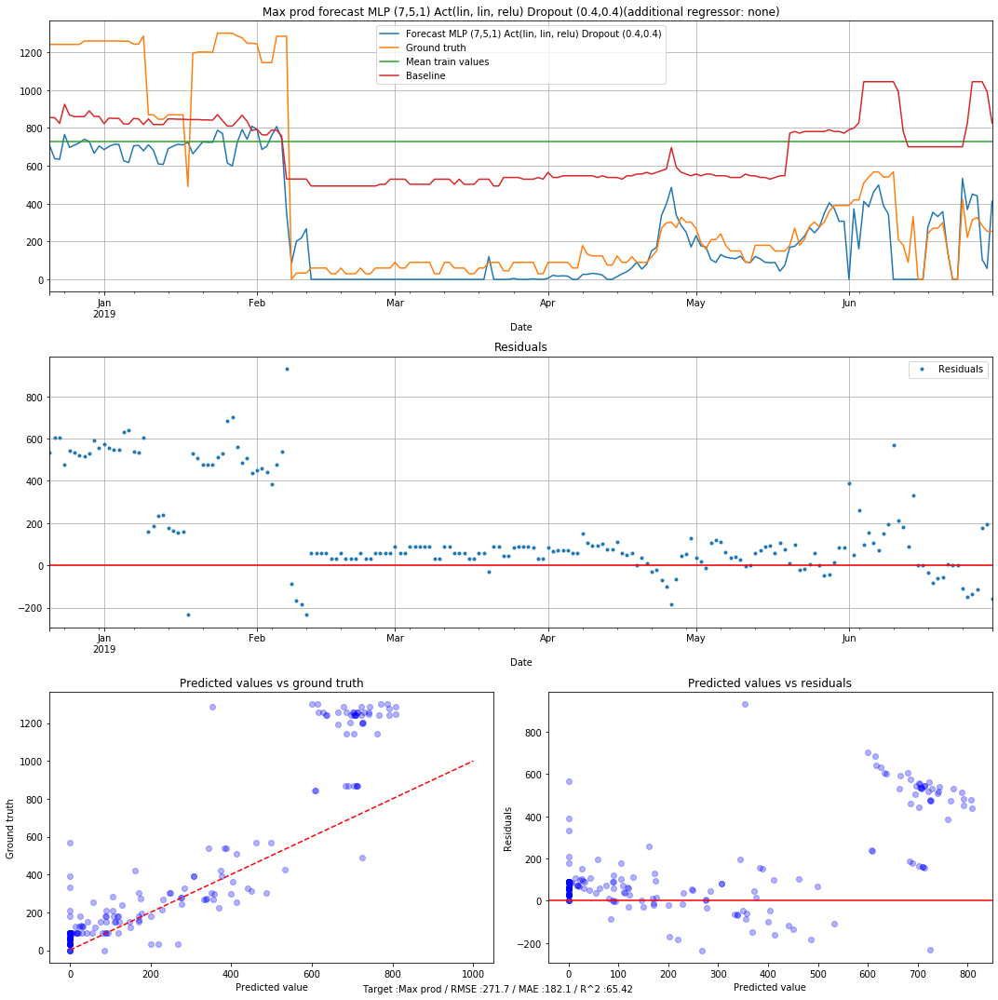

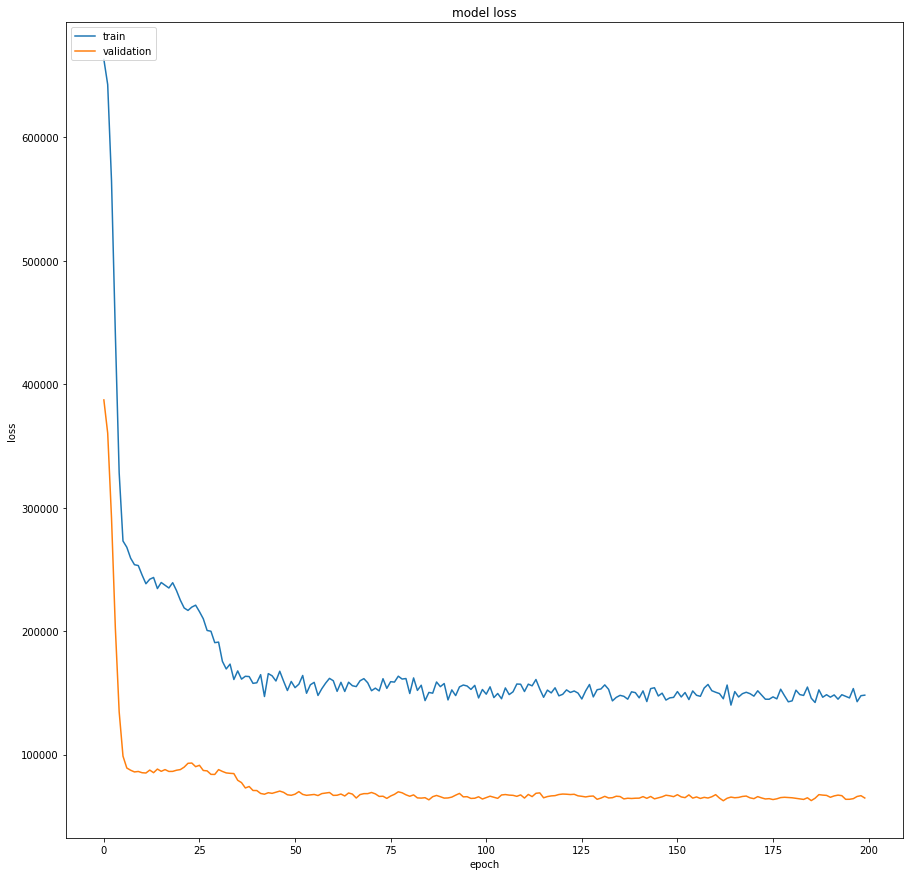

Model name MLP (7,5,1) Act(lin, lin, relu) Dropout (0.3,0.3)
Target : Max prod
Root Mean Square Error: 254.5047
Mean Absolute Error: 174.6571
R2 score : 69.6549



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_35 (Dense)             (None, 9)                 108       
_________________________________________________________________
dropout_24 (Dropout)         (None, 9)                 0         
_________________________________________________________________
dense_36 (Dense)             (None, 7)                 70        
_________________________________________________________________
dropout_25 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_37 (Dense)             (None, 1)                 8         
Total params: 186
Trainable params: 186
Non-trainable params: 0
______________________________________________

1725/1725 [==============================] - 0s 103us/step - loss: 222277.3899 - mean_squared_error: 222277.3899 - mean_absolute_error: 385.0614 - val_loss: 98410.2809 - val_mean_squared_error: 98410.2809 - val_mean_absolute_error: 242.2530
Epoch 29/200
1725/1725 [==============================] - 0s 101us/step - loss: 226302.8771 - mean_squared_error: 226302.8771 - mean_absolute_error: 391.6242 - val_loss: 102590.7802 - val_mean_squared_error: 102590.7802 - val_mean_absolute_error: 246.8449
Epoch 30/200
1725/1725 [==============================] - 0s 101us/step - loss: 234592.3669 - mean_squared_error: 234592.3669 - mean_absolute_error: 397.0356 - val_loss: 105196.6262 - val_mean_squared_error: 105196.6262 - val_mean_absolute_error: 249.9441
Epoch 31/200
1725/1725 [==============================] - 0s 100us/step - loss: 213544.1951 - mean_squared_error: 213544.1951 - mean_absolute_error: 373.5874 - val_loss: 103644.0162 - val_mean_squared_error: 103644.0162 - val_mean_absolute_error: 

1725/1725 [==============================] - 0s 101us/step - loss: 202486.9518 - mean_squared_error: 202486.9518 - mean_absolute_error: 363.8782 - val_loss: 79319.7551 - val_mean_squared_error: 79319.7551 - val_mean_absolute_error: 189.2845
Epoch 61/200
1725/1725 [==============================] - 0s 104us/step - loss: 192837.6066 - mean_squared_error: 192837.6066 - mean_absolute_error: 353.0512 - val_loss: 78883.0920 - val_mean_squared_error: 78883.0920 - val_mean_absolute_error: 188.9214
Epoch 62/200
1725/1725 [==============================] - 0s 115us/step - loss: 192915.2341 - mean_squared_error: 192915.2341 - mean_absolute_error: 356.1106 - val_loss: 81183.4780 - val_mean_squared_error: 81183.4780 - val_mean_absolute_error: 193.3291
Epoch 63/200
1725/1725 [==============================] - 0s 114us/step - loss: 196039.8926 - mean_squared_error: 196039.8926 - mean_absolute_error: 355.2796 - val_loss: 77408.7496 - val_mean_squared_error: 77408.7496 - val_mean_absolute_error: 190.04

1725/1725 [==============================] - 0s 100us/step - loss: 190777.6538 - mean_squared_error: 190777.6538 - mean_absolute_error: 349.8312 - val_loss: 79322.4692 - val_mean_squared_error: 79322.4692 - val_mean_absolute_error: 188.9815
Epoch 93/200
1725/1725 [==============================] - 0s 99us/step - loss: 182896.2915 - mean_squared_error: 182896.2915 - mean_absolute_error: 340.8573 - val_loss: 81543.6478 - val_mean_squared_error: 81543.6478 - val_mean_absolute_error: 188.3876
Epoch 94/200
1725/1725 [==============================] - 0s 103us/step - loss: 187214.3277 - mean_squared_error: 187214.3277 - mean_absolute_error: 347.0533 - val_loss: 77458.6396 - val_mean_squared_error: 77458.6396 - val_mean_absolute_error: 185.4980
Epoch 95/200
1725/1725 [==============================] - 0s 101us/step - loss: 194983.9050 - mean_squared_error: 194983.9050 - mean_absolute_error: 353.4990 - val_loss: 78833.5203 - val_mean_squared_error: 78833.5203 - val_mean_absolute_error: 186.626

1725/1725 [==============================] - 0s 99us/step - loss: 183912.3693 - mean_squared_error: 183912.3693 - mean_absolute_error: 342.0005 - val_loss: 75343.2233 - val_mean_squared_error: 75343.2233 - val_mean_absolute_error: 181.6188
Epoch 125/200
1725/1725 [==============================] - 0s 102us/step - loss: 181580.0504 - mean_squared_error: 181580.0504 - mean_absolute_error: 341.6170 - val_loss: 75908.3598 - val_mean_squared_error: 75908.3598 - val_mean_absolute_error: 182.5925
Epoch 126/200
1725/1725 [==============================] - 0s 97us/step - loss: 179514.0545 - mean_squared_error: 179514.0545 - mean_absolute_error: 342.2641 - val_loss: 74803.6116 - val_mean_squared_error: 74803.6116 - val_mean_absolute_error: 184.0592
Epoch 127/200
1725/1725 [==============================] - 0s 100us/step - loss: 188117.2305 - mean_squared_error: 188117.2305 - mean_absolute_error: 348.6020 - val_loss: 79303.5393 - val_mean_squared_error: 79303.5393 - val_mean_absolute_error: 188.1

1725/1725 [==============================] - 0s 118us/step - loss: 169042.5388 - mean_squared_error: 169042.5388 - mean_absolute_error: 328.8459 - val_loss: 76043.1754 - val_mean_squared_error: 76043.1754 - val_mean_absolute_error: 182.7352
Epoch 157/200
1725/1725 [==============================] - 0s 121us/step - loss: 178904.6239 - mean_squared_error: 178904.6239 - mean_absolute_error: 338.9568 - val_loss: 79084.5317 - val_mean_squared_error: 79084.5317 - val_mean_absolute_error: 185.8012
Epoch 158/200
1725/1725 [==============================] - 0s 105us/step - loss: 178063.2371 - mean_squared_error: 178063.2371 - mean_absolute_error: 335.2478 - val_loss: 78137.4643 - val_mean_squared_error: 78137.4643 - val_mean_absolute_error: 185.2358
Epoch 159/200
1725/1725 [==============================] - 0s 98us/step - loss: 189383.5560 - mean_squared_error: 189383.5560 - mean_absolute_error: 351.1492 - val_loss: 79190.5082 - val_mean_squared_error: 79190.5082 - val_mean_absolute_error: 187.

1725/1725 [==============================] - 0s 99us/step - loss: 182678.5827 - mean_squared_error: 182678.5827 - mean_absolute_error: 342.2274 - val_loss: 77274.1608 - val_mean_squared_error: 77274.1608 - val_mean_absolute_error: 181.5664
Epoch 189/200
1725/1725 [==============================] - 0s 100us/step - loss: 162868.2987 - mean_squared_error: 162868.2987 - mean_absolute_error: 325.1214 - val_loss: 74138.0218 - val_mean_squared_error: 74138.0218 - val_mean_absolute_error: 180.2430
Epoch 190/200
1725/1725 [==============================] - 0s 101us/step - loss: 172781.9205 - mean_squared_error: 172781.9205 - mean_absolute_error: 336.5778 - val_loss: 75054.8475 - val_mean_squared_error: 75054.8475 - val_mean_absolute_error: 180.4293
Epoch 191/200
1725/1725 [==============================] - 0s 99us/step - loss: 180902.2855 - mean_squared_error: 180902.2855 - mean_absolute_error: 341.6272 - val_loss: 77581.8431 - val_mean_squared_error: 77581.8431 - val_mean_absolute_error: 179.7

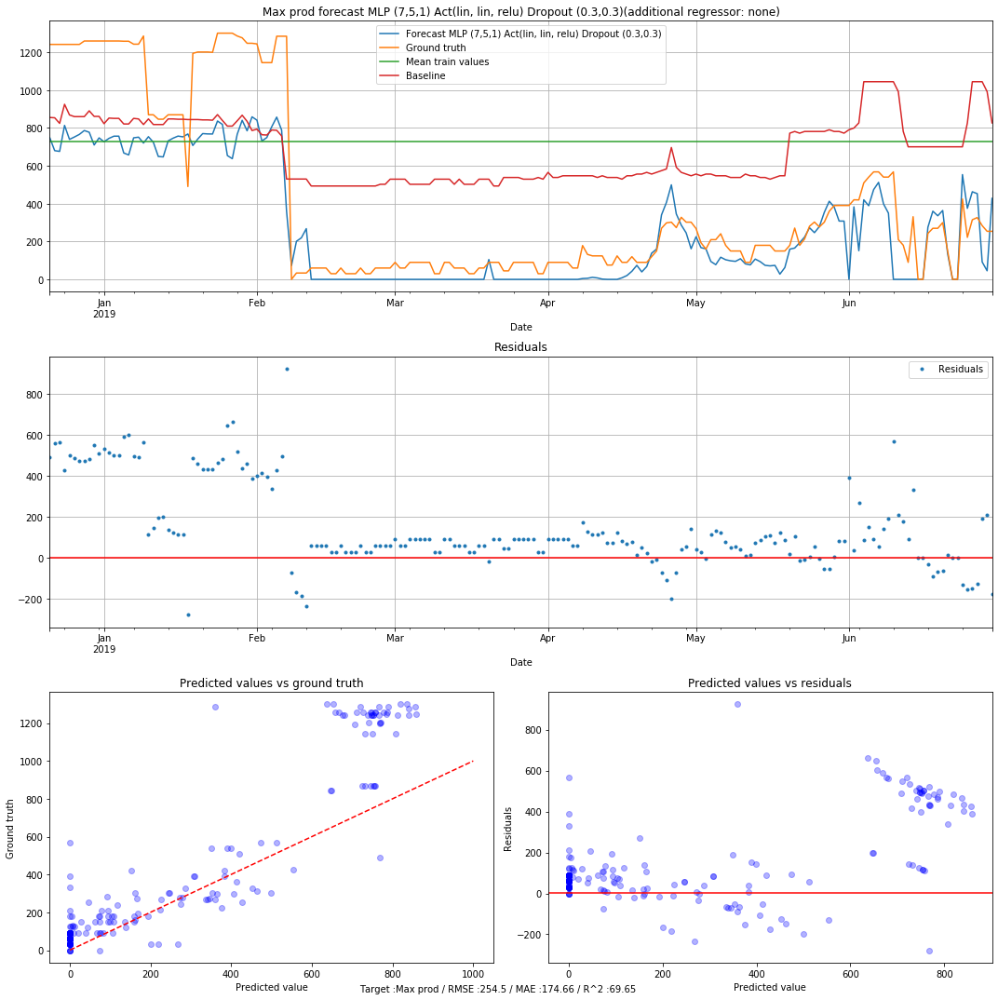

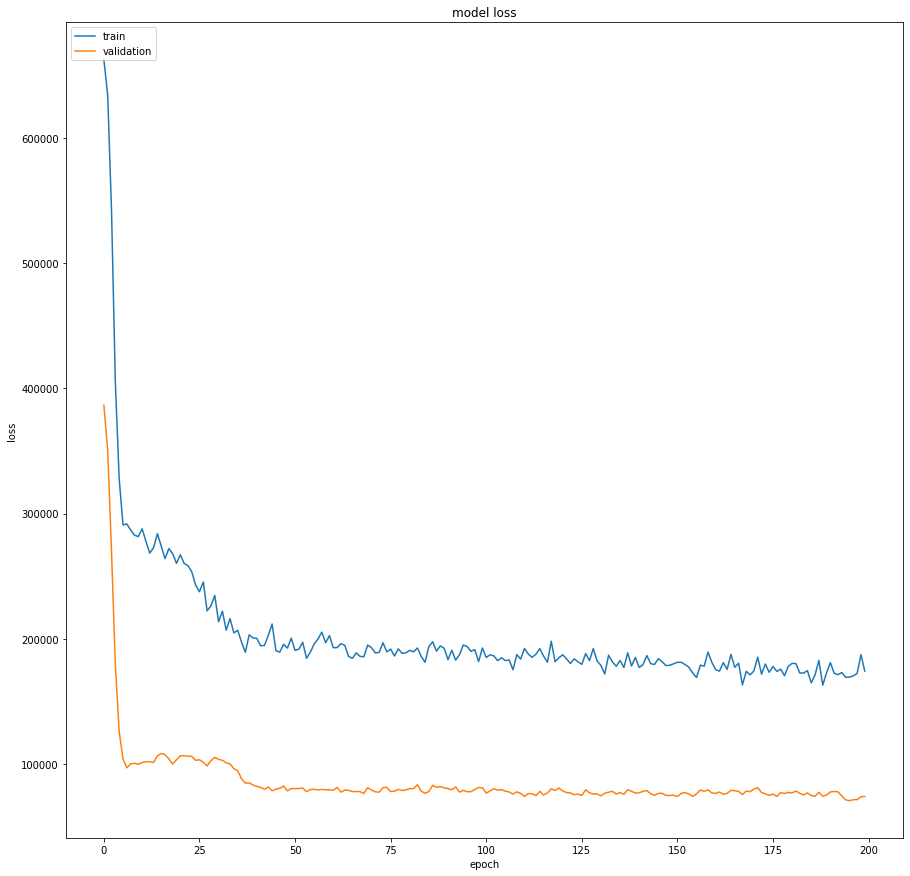

Model name MLP (9,7,1) Act(lin, lin, relu) Dropout (0.5,0.5)
Target : Max prod
Root Mean Square Error: 271.9920
Mean Absolute Error: 174.9608
R2 score : 65.3416



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_38 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_26 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_39 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_27 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_40 (Dense)             (None, 1)                 8         
Total params: 224
Trainable params: 224
Non-trainable params: 0
______________________________________________

1725/1725 [==============================] - 0s 113us/step - loss: 228340.6019 - mean_squared_error: 228340.6019 - mean_absolute_error: 393.2437 - val_loss: 101916.5149 - val_mean_squared_error: 101916.5149 - val_mean_absolute_error: 245.9684
Epoch 29/200
1725/1725 [==============================] - 0s 114us/step - loss: 207247.3226 - mean_squared_error: 207247.3226 - mean_absolute_error: 375.4958 - val_loss: 100782.7971 - val_mean_squared_error: 100782.7971 - val_mean_absolute_error: 245.0117
Epoch 30/200
1725/1725 [==============================] - 0s 119us/step - loss: 226529.8696 - mean_squared_error: 226529.8696 - mean_absolute_error: 385.0970 - val_loss: 102555.5530 - val_mean_squared_error: 102555.5530 - val_mean_absolute_error: 247.4740
Epoch 31/200
1725/1725 [==============================] - 0s 116us/step - loss: 201730.8927 - mean_squared_error: 201730.8927 - mean_absolute_error: 364.5928 - val_loss: 100600.1627 - val_mean_squared_error: 100600.1627 - val_mean_absolute_error

1725/1725 [==============================] - 0s 103us/step - loss: 196763.8004 - mean_squared_error: 196763.8004 - mean_absolute_error: 355.7182 - val_loss: 79705.2747 - val_mean_squared_error: 79705.2747 - val_mean_absolute_error: 190.3066
Epoch 61/200
1725/1725 [==============================] - 0s 102us/step - loss: 187055.7900 - mean_squared_error: 187055.7900 - mean_absolute_error: 347.8413 - val_loss: 77621.9541 - val_mean_squared_error: 77621.9541 - val_mean_absolute_error: 188.1920
Epoch 62/200
1725/1725 [==============================] - 0s 104us/step - loss: 187532.1988 - mean_squared_error: 187532.1988 - mean_absolute_error: 350.0514 - val_loss: 78621.9445 - val_mean_squared_error: 78621.9445 - val_mean_absolute_error: 189.0841
Epoch 63/200
1725/1725 [==============================] - 0s 105us/step - loss: 187909.6743 - mean_squared_error: 187909.6743 - mean_absolute_error: 348.8529 - val_loss: 75255.7799 - val_mean_squared_error: 75255.7799 - val_mean_absolute_error: 186.21

1725/1725 [==============================] - 0s 104us/step - loss: 182503.4514 - mean_squared_error: 182503.4514 - mean_absolute_error: 343.1284 - val_loss: 77018.3603 - val_mean_squared_error: 77018.3603 - val_mean_absolute_error: 186.7400
Epoch 93/200
1725/1725 [==============================] - 0s 101us/step - loss: 181467.7198 - mean_squared_error: 181467.7198 - mean_absolute_error: 338.4771 - val_loss: 78557.0489 - val_mean_squared_error: 78557.0489 - val_mean_absolute_error: 185.9083
Epoch 94/200
1725/1725 [==============================] - 0s 100us/step - loss: 183903.4351 - mean_squared_error: 183903.4351 - mean_absolute_error: 345.5788 - val_loss: 76423.2990 - val_mean_squared_error: 76423.2990 - val_mean_absolute_error: 184.7349
Epoch 95/200
1725/1725 [==============================] - 0s 101us/step - loss: 189323.1776 - mean_squared_error: 189323.1776 - mean_absolute_error: 347.3140 - val_loss: 78354.4281 - val_mean_squared_error: 78354.4281 - val_mean_absolute_error: 185.63

1725/1725 [==============================] - 0s 103us/step - loss: 184015.1856 - mean_squared_error: 184015.1856 - mean_absolute_error: 343.6103 - val_loss: 76637.9730 - val_mean_squared_error: 76637.9730 - val_mean_absolute_error: 182.4165
Epoch 125/200
1725/1725 [==============================] - 0s 102us/step - loss: 188934.2800 - mean_squared_error: 188934.2800 - mean_absolute_error: 348.8172 - val_loss: 76682.8526 - val_mean_squared_error: 76682.8526 - val_mean_absolute_error: 183.6045
Epoch 126/200
1725/1725 [==============================] - 0s 101us/step - loss: 173699.9006 - mean_squared_error: 173699.9006 - mean_absolute_error: 337.2348 - val_loss: 74474.6877 - val_mean_squared_error: 74474.6877 - val_mean_absolute_error: 183.8149
Epoch 127/200
1725/1725 [==============================] - 0s 102us/step - loss: 181430.8372 - mean_squared_error: 181430.8372 - mean_absolute_error: 339.5790 - val_loss: 77434.2627 - val_mean_squared_error: 77434.2627 - val_mean_absolute_error: 186

1725/1725 [==============================] - 0s 104us/step - loss: 175750.2255 - mean_squared_error: 175750.2255 - mean_absolute_error: 336.7508 - val_loss: 75415.9106 - val_mean_squared_error: 75415.9106 - val_mean_absolute_error: 183.7365
Epoch 157/200
1725/1725 [==============================] - 0s 105us/step - loss: 173825.5629 - mean_squared_error: 173825.5629 - mean_absolute_error: 336.3087 - val_loss: 76246.4754 - val_mean_squared_error: 76246.4754 - val_mean_absolute_error: 184.2404
Epoch 158/200
1725/1725 [==============================] - 0s 102us/step - loss: 176842.5391 - mean_squared_error: 176842.5391 - mean_absolute_error: 333.2020 - val_loss: 75127.7292 - val_mean_squared_error: 75127.7292 - val_mean_absolute_error: 183.6790
Epoch 159/200
1725/1725 [==============================] - 0s 103us/step - loss: 185736.9367 - mean_squared_error: 185736.9367 - mean_absolute_error: 347.8228 - val_loss: 75539.3320 - val_mean_squared_error: 75539.3320 - val_mean_absolute_error: 185

1725/1725 [==============================] - 0s 121us/step - loss: 175493.1001 - mean_squared_error: 175493.1001 - mean_absolute_error: 336.0544 - val_loss: 74031.3373 - val_mean_squared_error: 74031.3373 - val_mean_absolute_error: 182.0888
Epoch 189/200
1725/1725 [==============================] - 0s 110us/step - loss: 164852.4968 - mean_squared_error: 164852.4968 - mean_absolute_error: 327.1644 - val_loss: 72301.8356 - val_mean_squared_error: 72301.8356 - val_mean_absolute_error: 180.8608
Epoch 190/200
1725/1725 [==============================] - 0s 110us/step - loss: 171473.5970 - mean_squared_error: 171473.5970 - mean_absolute_error: 333.0314 - val_loss: 72772.1980 - val_mean_squared_error: 72772.1980 - val_mean_absolute_error: 180.7360
Epoch 191/200
1725/1725 [==============================] - 0s 110us/step - loss: 176776.8119 - mean_squared_error: 176776.8119 - mean_absolute_error: 337.7867 - val_loss: 73906.0805 - val_mean_squared_error: 73906.0805 - val_mean_absolute_error: 180

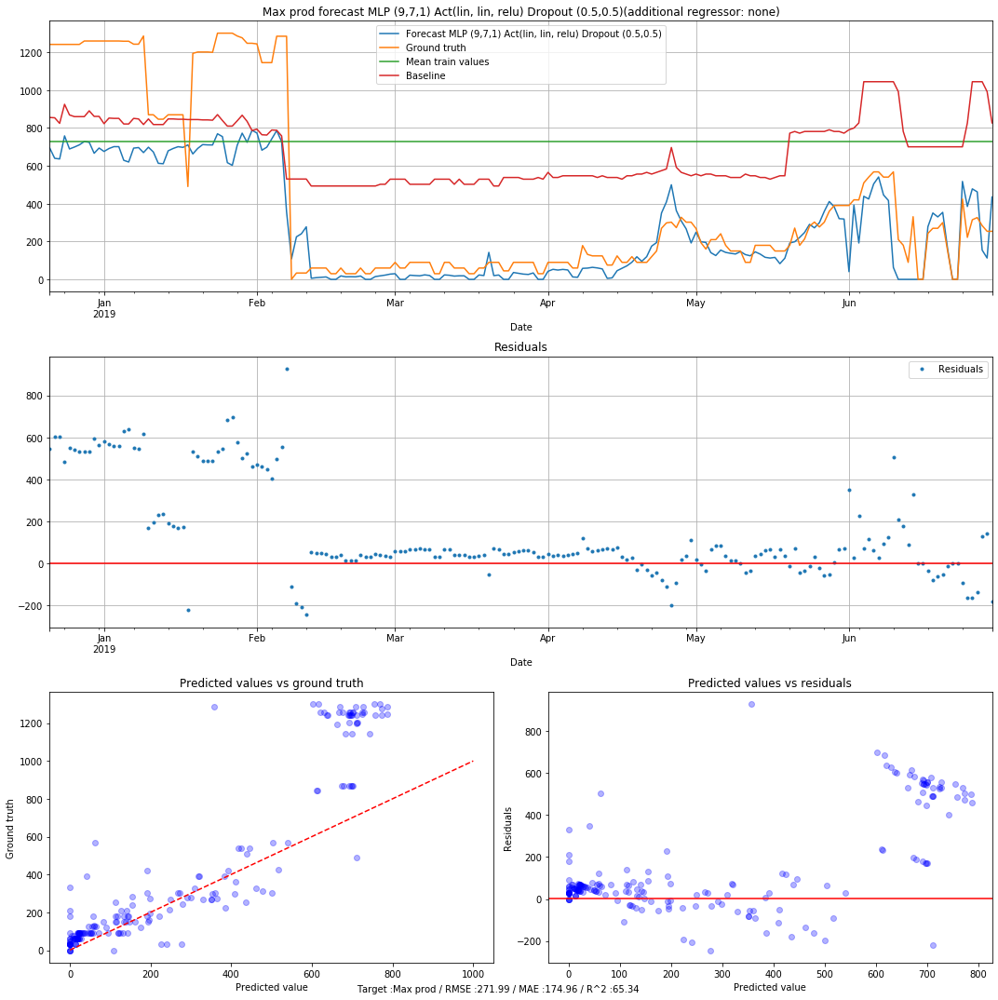

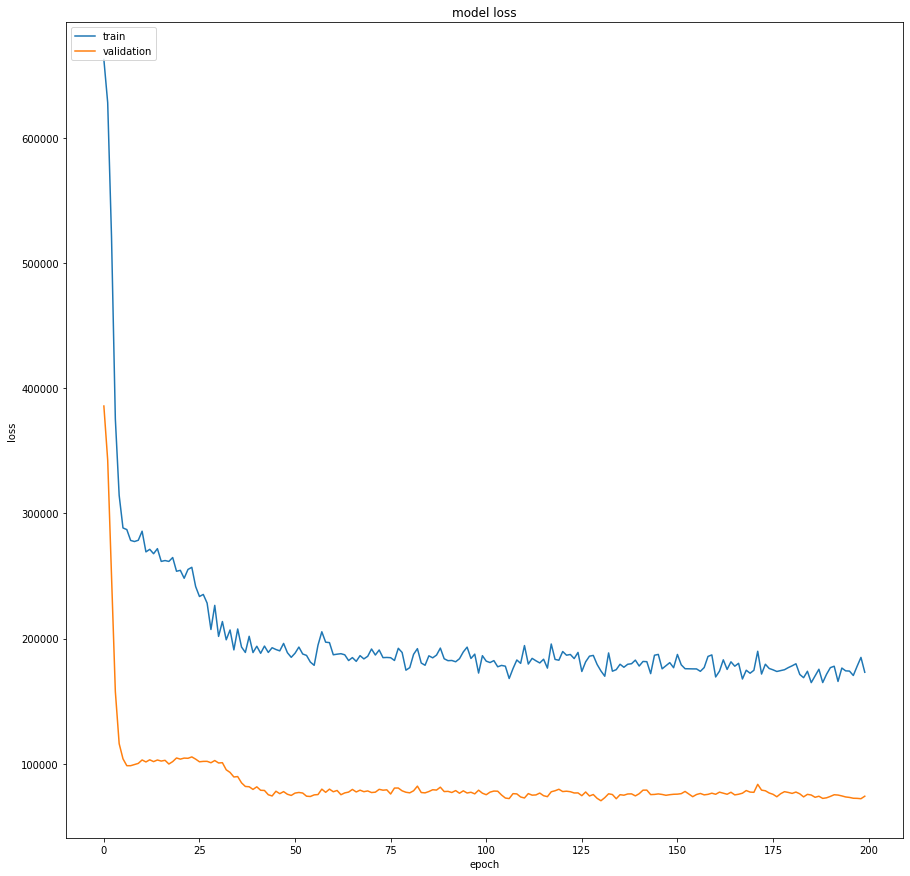

Model name MLP (11,7,1) Act(lin, lin, relu) Dropout (0.5,0.5)
Target : Max prod
Root Mean Square Error: 272.1174
Mean Absolute Error: 180.7394
R2 score : 65.3096



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_41 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_28 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_42 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_29 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_43 (Dense)             (None, 1)                 8         
Total params: 224
Trainable params: 224
Non-trainable params: 0
_____________________________________________

1725/1725 [==============================] - 0s 103us/step - loss: 98592.5655 - mean_squared_error: 98592.5655 - mean_absolute_error: 248.1724 - val_loss: 53408.9993 - val_mean_squared_error: 53408.9993 - val_mean_absolute_error: 170.6282
Epoch 29/200
1725/1725 [==============================] - 0s 100us/step - loss: 100485.1801 - mean_squared_error: 100485.1801 - mean_absolute_error: 251.4678 - val_loss: 53140.8572 - val_mean_squared_error: 53140.8572 - val_mean_absolute_error: 167.9110
Epoch 30/200
1725/1725 [==============================] - 0s 104us/step - loss: 102592.7035 - mean_squared_error: 102592.7035 - mean_absolute_error: 252.1771 - val_loss: 52647.4582 - val_mean_squared_error: 52647.4582 - val_mean_absolute_error: 165.0597
Epoch 31/200
1725/1725 [==============================] - 0s 106us/step - loss: 100781.5738 - mean_squared_error: 100781.5738 - mean_absolute_error: 251.5933 - val_loss: 52530.2295 - val_mean_squared_error: 52530.2295 - val_mean_absolute_error: 164.7320

1725/1725 [==============================] - 0s 104us/step - loss: 99224.8267 - mean_squared_error: 99224.8267 - mean_absolute_error: 250.0607 - val_loss: 52341.1383 - val_mean_squared_error: 52341.1383 - val_mean_absolute_error: 160.2309
Epoch 61/200
1725/1725 [==============================] - 0s 100us/step - loss: 99048.6640 - mean_squared_error: 99048.6640 - mean_absolute_error: 247.7377 - val_loss: 52095.5786 - val_mean_squared_error: 52095.5786 - val_mean_absolute_error: 160.0939
Epoch 62/200
1725/1725 [==============================] - 0s 99us/step - loss: 96847.6078 - mean_squared_error: 96847.6078 - mean_absolute_error: 245.9995 - val_loss: 52685.1847 - val_mean_squared_error: 52685.1847 - val_mean_absolute_error: 160.7557
Epoch 63/200
1725/1725 [==============================] - 0s 100us/step - loss: 102388.1957 - mean_squared_error: 102388.1957 - mean_absolute_error: 251.9212 - val_loss: 50737.5723 - val_mean_squared_error: 50737.5723 - val_mean_absolute_error: 158.0126
Epoc

1725/1725 [==============================] - 0s 103us/step - loss: 100809.0588 - mean_squared_error: 100809.0588 - mean_absolute_error: 248.9293 - val_loss: 52694.0625 - val_mean_squared_error: 52694.0625 - val_mean_absolute_error: 160.4593
Epoch 93/200
1725/1725 [==============================] - 0s 100us/step - loss: 99003.7437 - mean_squared_error: 99003.7437 - mean_absolute_error: 247.0874 - val_loss: 51582.1484 - val_mean_squared_error: 51582.1484 - val_mean_absolute_error: 159.1680
Epoch 94/200
1725/1725 [==============================] - 0s 101us/step - loss: 102298.2383 - mean_squared_error: 102298.2383 - mean_absolute_error: 254.4181 - val_loss: 51628.1150 - val_mean_squared_error: 51628.1150 - val_mean_absolute_error: 159.5305
Epoch 95/200
1725/1725 [==============================] - 0s 101us/step - loss: 101646.9420 - mean_squared_error: 101646.9420 - mean_absolute_error: 253.5805 - val_loss: 51987.2953 - val_mean_squared_error: 51987.2953 - val_mean_absolute_error: 159.8441

1725/1725 [==============================] - 0s 102us/step - loss: 97967.3499 - mean_squared_error: 97967.3499 - mean_absolute_error: 251.5887 - val_loss: 50876.1853 - val_mean_squared_error: 50876.1853 - val_mean_absolute_error: 157.6818
Epoch 125/200
1725/1725 [==============================] - 0s 103us/step - loss: 100021.5951 - mean_squared_error: 100021.5951 - mean_absolute_error: 249.8160 - val_loss: 50011.1612 - val_mean_squared_error: 50011.1612 - val_mean_absolute_error: 156.7791
Epoch 126/200
1725/1725 [==============================] - 0s 101us/step - loss: 93716.3012 - mean_squared_error: 93716.3012 - mean_absolute_error: 243.0982 - val_loss: 51613.1187 - val_mean_squared_error: 51613.1187 - val_mean_absolute_error: 158.8727
Epoch 127/200
1725/1725 [==============================] - 0s 100us/step - loss: 96440.9244 - mean_squared_error: 96440.9244 - mean_absolute_error: 244.5657 - val_loss: 51996.6188 - val_mean_squared_error: 51996.6188 - val_mean_absolute_error: 159.2403


1725/1725 [==============================] - 0s 102us/step - loss: 100381.2600 - mean_squared_error: 100381.2600 - mean_absolute_error: 248.8358 - val_loss: 51042.8276 - val_mean_squared_error: 51042.8276 - val_mean_absolute_error: 158.8525
Epoch 157/200
1725/1725 [==============================] - 0s 101us/step - loss: 98381.0915 - mean_squared_error: 98381.0915 - mean_absolute_error: 249.2186 - val_loss: 50702.1974 - val_mean_squared_error: 50702.1974 - val_mean_absolute_error: 157.9339
Epoch 158/200
1725/1725 [==============================] - 0s 100us/step - loss: 98231.6353 - mean_squared_error: 98231.6353 - mean_absolute_error: 245.3756 - val_loss: 49180.4886 - val_mean_squared_error: 49180.4886 - val_mean_absolute_error: 156.3208
Epoch 159/200
1725/1725 [==============================] - 0s 102us/step - loss: 101481.4542 - mean_squared_error: 101481.4542 - mean_absolute_error: 249.5722 - val_loss: 50806.2768 - val_mean_squared_error: 50806.2768 - val_mean_absolute_error: 159.300

1725/1725 [==============================] - 0s 100us/step - loss: 98022.6935 - mean_squared_error: 98022.6935 - mean_absolute_error: 247.3735 - val_loss: 51809.4417 - val_mean_squared_error: 51809.4417 - val_mean_absolute_error: 158.7901
Epoch 189/200
1725/1725 [==============================] - 0s 101us/step - loss: 98932.3786 - mean_squared_error: 98932.3786 - mean_absolute_error: 249.9654 - val_loss: 52094.6386 - val_mean_squared_error: 52094.6386 - val_mean_absolute_error: 160.0141
Epoch 190/200
1725/1725 [==============================] - 0s 100us/step - loss: 98380.1242 - mean_squared_error: 98380.1242 - mean_absolute_error: 246.3349 - val_loss: 52507.0011 - val_mean_squared_error: 52507.0011 - val_mean_absolute_error: 159.5946
Epoch 191/200
1725/1725 [==============================] - 0s 101us/step - loss: 100446.5036 - mean_squared_error: 100446.5036 - mean_absolute_error: 251.9457 - val_loss: 52844.2490 - val_mean_squared_error: 52844.2490 - val_mean_absolute_error: 160.0554


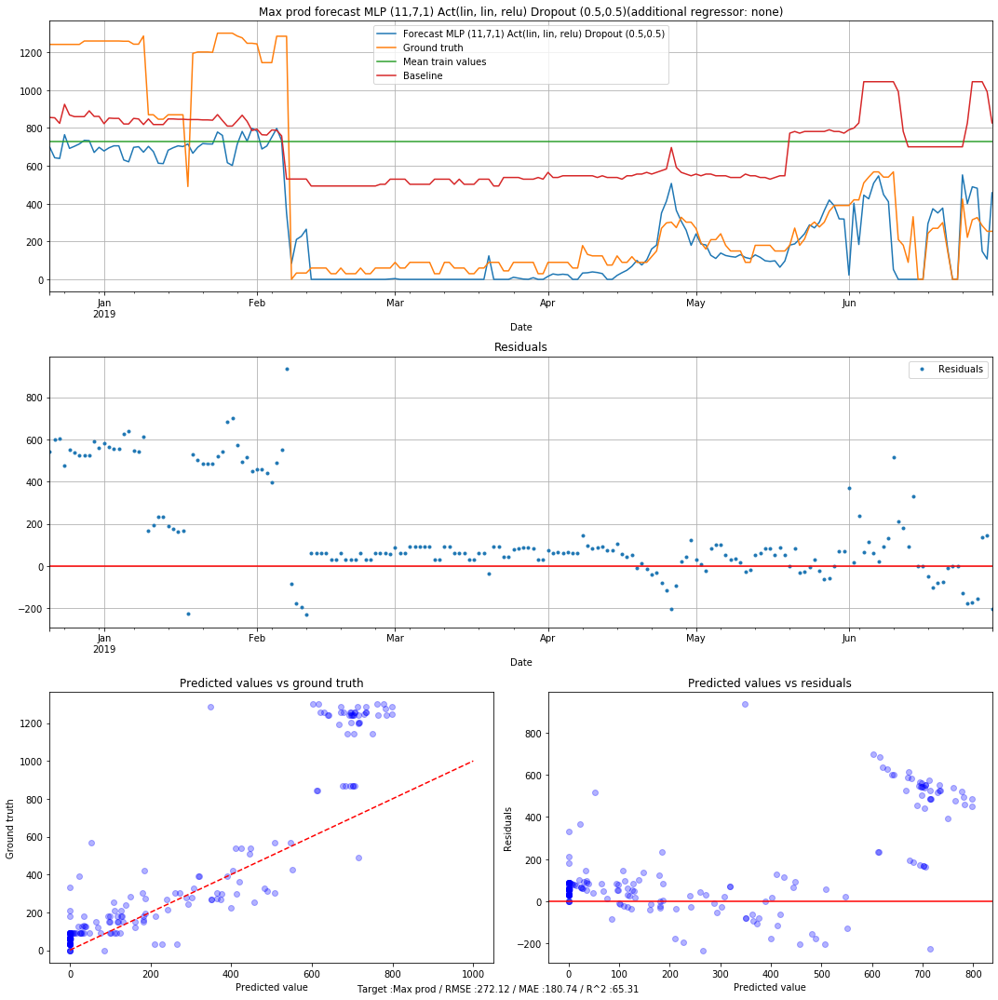

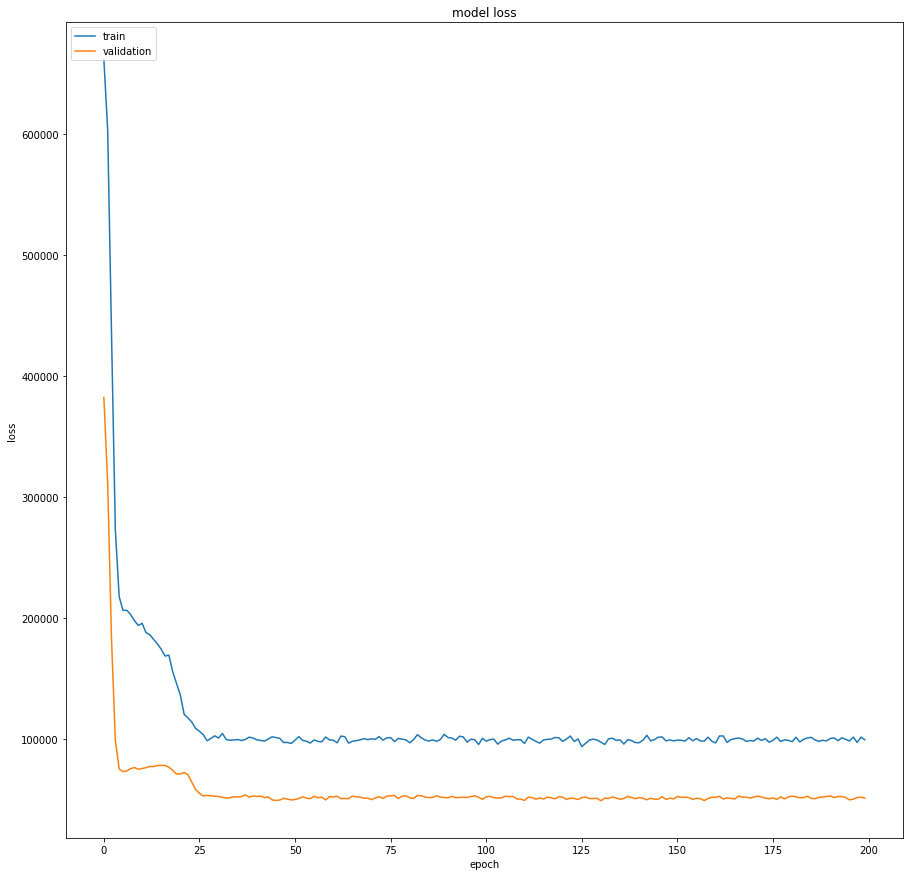

Model name MLP (11,7,1) Act(lin, lin, relu) Dropout (0.1,0.1)
Target : Max prod
Root Mean Square Error: 226.3206
Mean Absolute Error: 158.7887
R2 score : 76.0037



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_44 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_30 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_45 (Dense)             (None, 7)                 84        
_________________________________________________________________
dropout_31 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_46 (Dense)             (None, 3)                 24        
_________________________________________________________________
dropout_32 (Dropout)         (None, 3)     

1725/1725 [==============================] - 0s 116us/step - loss: 119007.5340 - mean_squared_error: 119007.5340 - mean_absolute_error: 276.3401 - val_loss: 55961.7999 - val_mean_squared_error: 55961.7999 - val_mean_absolute_error: 165.3483
Epoch 28/200
1725/1725 [==============================] - 0s 114us/step - loss: 115893.8205 - mean_squared_error: 115893.8205 - mean_absolute_error: 271.7881 - val_loss: 57866.7886 - val_mean_squared_error: 57866.7886 - val_mean_absolute_error: 167.5608
Epoch 29/200
1725/1725 [==============================] - 0s 112us/step - loss: 125630.1161 - mean_squared_error: 125630.1161 - mean_absolute_error: 284.2484 - val_loss: 59417.0007 - val_mean_squared_error: 59417.0007 - val_mean_absolute_error: 169.3719
Epoch 30/200
1725/1725 [==============================] - 0s 113us/step - loss: 119946.3082 - mean_squared_error: 119946.3082 - mean_absolute_error: 274.5374 - val_loss: 55224.0569 - val_mean_squared_error: 55224.0569 - val_mean_absolute_error: 164.16

1725/1725 [==============================] - 0s 119us/step - loss: 121115.4934 - mean_squared_error: 121115.4934 - mean_absolute_error: 280.1973 - val_loss: 56974.8058 - val_mean_squared_error: 56974.8058 - val_mean_absolute_error: 166.7154
Epoch 60/200
1725/1725 [==============================] - 0s 112us/step - loss: 122862.4260 - mean_squared_error: 122862.4260 - mean_absolute_error: 276.6401 - val_loss: 57302.2592 - val_mean_squared_error: 57302.2592 - val_mean_absolute_error: 167.2137
Epoch 61/200
1725/1725 [==============================] - 0s 113us/step - loss: 118226.6143 - mean_squared_error: 118226.6143 - mean_absolute_error: 272.8532 - val_loss: 55852.0866 - val_mean_squared_error: 55852.0866 - val_mean_absolute_error: 166.5169
Epoch 62/200
1725/1725 [==============================] - 0s 113us/step - loss: 117549.6708 - mean_squared_error: 117549.6708 - mean_absolute_error: 274.3531 - val_loss: 54043.6522 - val_mean_squared_error: 54043.6522 - val_mean_absolute_error: 162.78

1725/1725 [==============================] - 0s 116us/step - loss: 121583.4726 - mean_squared_error: 121583.4726 - mean_absolute_error: 276.2893 - val_loss: 55021.3888 - val_mean_squared_error: 55021.3888 - val_mean_absolute_error: 163.5144
Epoch 92/200
1725/1725 [==============================] - 0s 114us/step - loss: 115505.0044 - mean_squared_error: 115505.0044 - mean_absolute_error: 270.8826 - val_loss: 55051.9573 - val_mean_squared_error: 55051.9573 - val_mean_absolute_error: 163.8806
Epoch 93/200
1725/1725 [==============================] - 0s 116us/step - loss: 121985.6328 - mean_squared_error: 121985.6328 - mean_absolute_error: 276.6582 - val_loss: 55672.3586 - val_mean_squared_error: 55672.3586 - val_mean_absolute_error: 164.9354
Epoch 94/200
1725/1725 [==============================] - 0s 112us/step - loss: 117161.0040 - mean_squared_error: 117161.0040 - mean_absolute_error: 273.5156 - val_loss: 58203.4028 - val_mean_squared_error: 58203.4028 - val_mean_absolute_error: 167.25

1725/1725 [==============================] - 0s 118us/step - loss: 119147.2870 - mean_squared_error: 119147.2870 - mean_absolute_error: 275.6213 - val_loss: 56881.8751 - val_mean_squared_error: 56881.8751 - val_mean_absolute_error: 165.0744
Epoch 124/200
1725/1725 [==============================] - 0s 113us/step - loss: 115638.4894 - mean_squared_error: 115638.4894 - mean_absolute_error: 270.8537 - val_loss: 54765.5642 - val_mean_squared_error: 54765.5642 - val_mean_absolute_error: 162.4208
Epoch 125/200
1725/1725 [==============================] - 0s 114us/step - loss: 116546.5753 - mean_squared_error: 116546.5753 - mean_absolute_error: 269.8883 - val_loss: 56303.5304 - val_mean_squared_error: 56303.5304 - val_mean_absolute_error: 165.3271
Epoch 126/200
1725/1725 [==============================] - 0s 111us/step - loss: 117143.5506 - mean_squared_error: 117143.5506 - mean_absolute_error: 269.9079 - val_loss: 56241.3930 - val_mean_squared_error: 56241.3930 - val_mean_absolute_error: 165

1725/1725 [==============================] - 0s 114us/step - loss: 123146.1508 - mean_squared_error: 123146.1508 - mean_absolute_error: 279.2769 - val_loss: 51093.9634 - val_mean_squared_error: 51093.9634 - val_mean_absolute_error: 157.6685
Epoch 156/200
1725/1725 [==============================] - 0s 116us/step - loss: 114924.2757 - mean_squared_error: 114924.2757 - mean_absolute_error: 268.7946 - val_loss: 52898.3405 - val_mean_squared_error: 52898.3405 - val_mean_absolute_error: 160.9357
Epoch 157/200
1725/1725 [==============================] - 0s 114us/step - loss: 117237.9509 - mean_squared_error: 117237.9509 - mean_absolute_error: 271.8609 - val_loss: 56148.5713 - val_mean_squared_error: 56148.5713 - val_mean_absolute_error: 165.0183
Epoch 158/200
1725/1725 [==============================] - 0s 114us/step - loss: 115530.1030 - mean_squared_error: 115530.1030 - mean_absolute_error: 272.0349 - val_loss: 53480.0884 - val_mean_squared_error: 53480.0884 - val_mean_absolute_error: 160

1725/1725 [==============================] - 0s 113us/step - loss: 116791.2390 - mean_squared_error: 116791.2390 - mean_absolute_error: 271.0156 - val_loss: 57565.0039 - val_mean_squared_error: 57565.0039 - val_mean_absolute_error: 166.6346
Epoch 188/200
1725/1725 [==============================] - 0s 112us/step - loss: 119484.8019 - mean_squared_error: 119484.8019 - mean_absolute_error: 276.6120 - val_loss: 58587.9396 - val_mean_squared_error: 58587.9396 - val_mean_absolute_error: 167.5222
Epoch 189/200
1725/1725 [==============================] - 0s 115us/step - loss: 110568.2371 - mean_squared_error: 110568.2371 - mean_absolute_error: 264.7513 - val_loss: 57853.2979 - val_mean_squared_error: 57853.2979 - val_mean_absolute_error: 166.8937
Epoch 190/200
1725/1725 [==============================] - 0s 115us/step - loss: 118774.4952 - mean_squared_error: 118774.4952 - mean_absolute_error: 272.9923 - val_loss: 56913.2068 - val_mean_squared_error: 56913.2068 - val_mean_absolute_error: 166

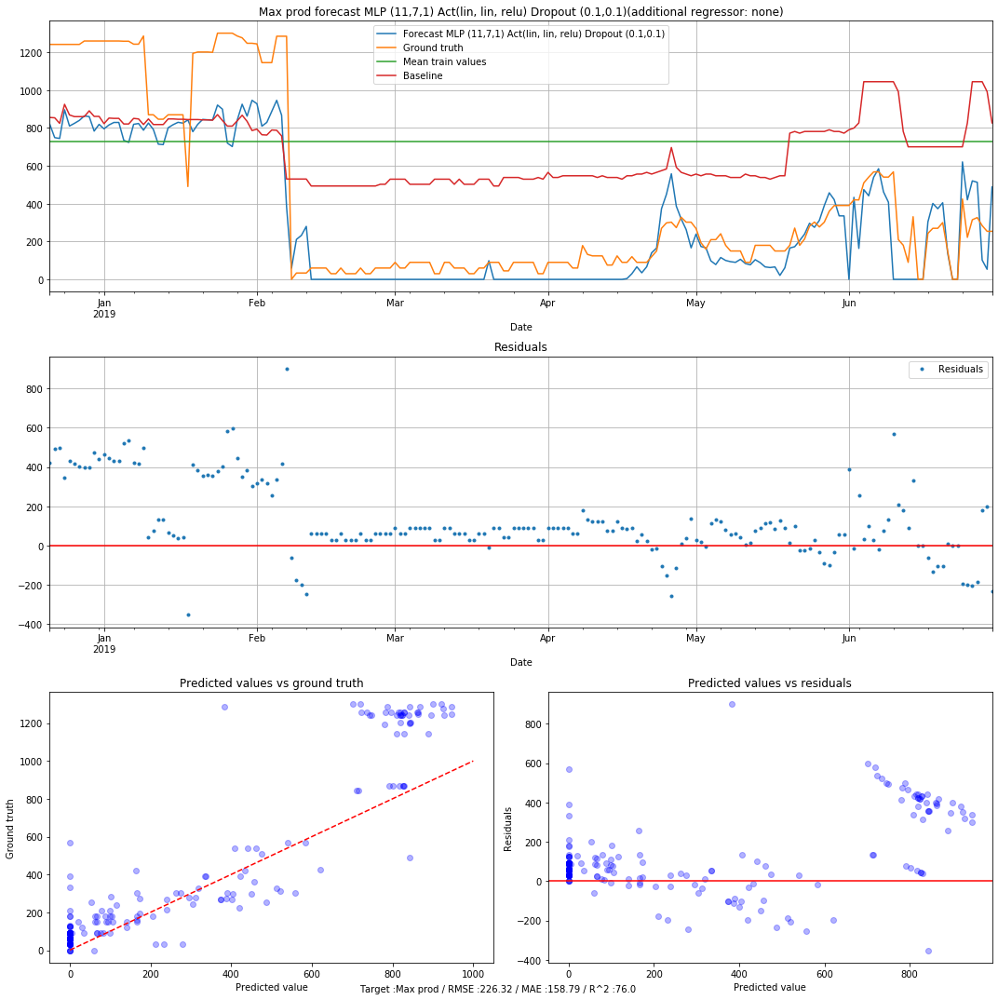

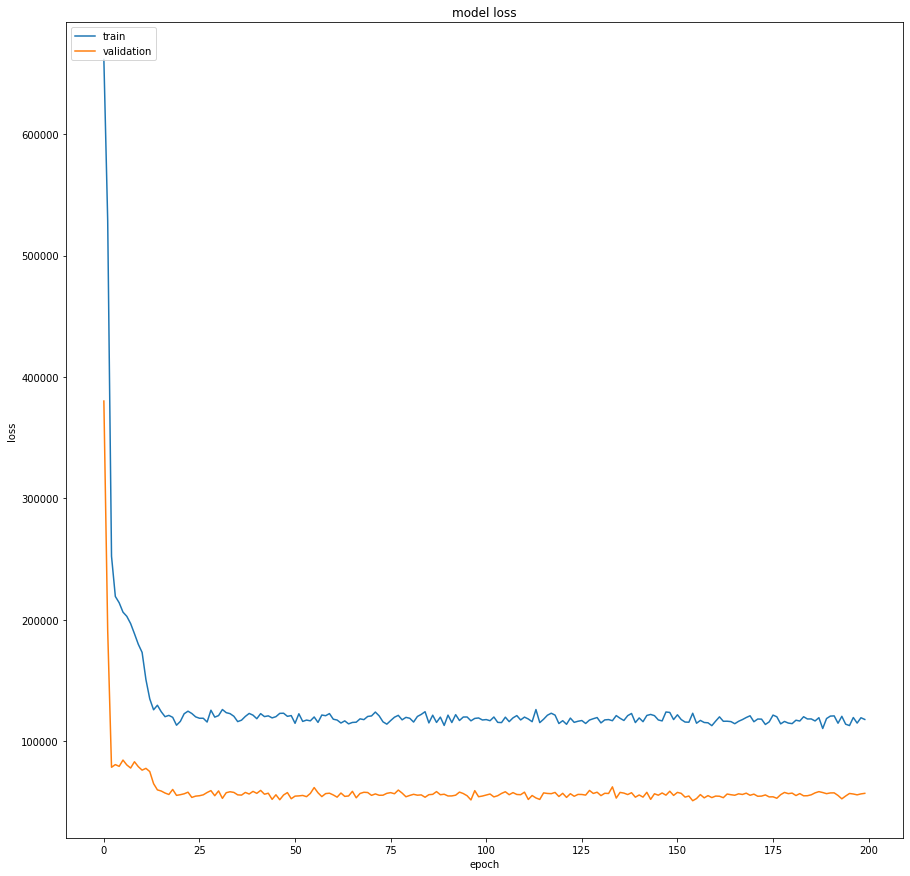

Model name MLP (11,7,3,1) Act(lin, lin, lin, relu) Dropout (0.1,0.1,0.1)
Target : Max prod
Root Mean Square Error: 239.1231
Mean Absolute Error: 165.8471
R2 score : 73.2120





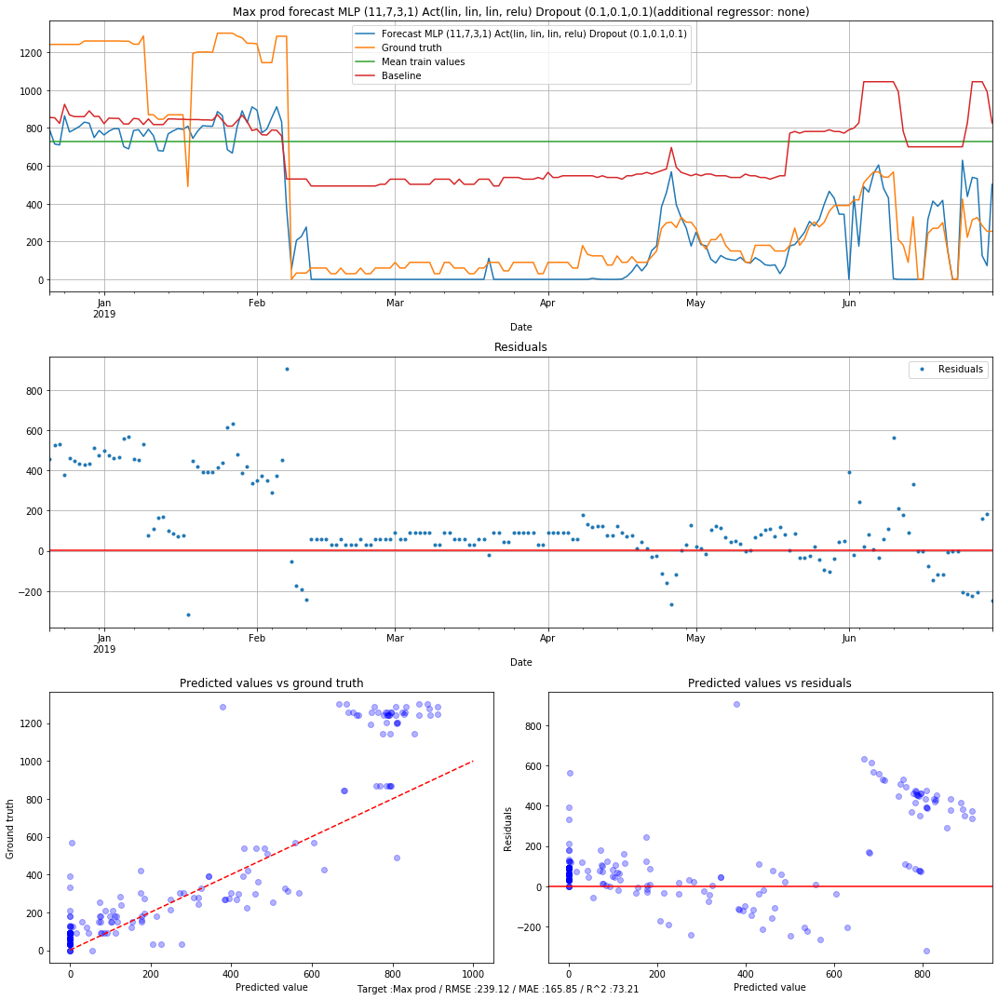

In [32]:
regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]','Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]', 'Weekend','LaggedLakeConstraint55', 'TotalAvailablePower']

AddRegressors = ['none']

columns = ['Algorithm','Target','Features','RMSE','MAE','R^2', 'Parameters']
df_resultsMLP = pd.DataFrame(columns = columns)
line_nb = 0

models = ["MLP (7,5,1) Act(lin, lin, relu) Dropout (0.5,0.5)",
          "MLP (7,5,1) Act(lin, lin, relu) Dropout (0.4,0.4)",
          "MLP (7,5,1) Act(lin, lin, relu) Dropout (0.3,0.3)",
          "MLP (9,7,1) Act(lin, lin, relu) Dropout (0.5,0.5)",
          "MLP (11,7,1) Act(lin, lin, relu) Dropout (0.5,0.5)",
          "MLP (11,7,1) Act(lin, lin, relu) Dropout (0.1,0.1)",
          "MLP (11,7,3,1) Act(lin, lin, lin, relu) Dropout (0.1,0.1,0.1)"] 

mlpTopologies = [[{"size":7, "activation":"linear", "dropOutAfter" : 0.5},
                       {"size":5, "activation":"linear", "dropOutAfter" : 0.5},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":7, "activation":"linear", "dropOutAfter" : 0.4},
                       {"size":5, "activation":"linear", "dropOutAfter" : 0.4},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":7, "activation":"linear", "dropOutAfter" : 0.3},
                       {"size":5, "activation":"linear", "dropOutAfter" : 0.3},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":9, "activation":"linear", "dropOutAfter" : 0.5},
                       {"size":7, "activation":"linear", "dropOutAfter" : 0.5},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":11, "activation":"linear", "dropOutAfter" : 0.5},
                       {"size":7, "activation":"linear", "dropOutAfter" : 0.5},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":11, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":7, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                [{"size":11, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":7, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":3, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}]]

for target_feature in ["Min prod","Max prod"]:
    for addRegressor in AddRegressors:
        fullRegressors = regressors + [addRegressor]
        xTrain, xTest, yTrain, yTest, yBaseLine = GetDataSplit(df, fullRegressors,target_feature, "Baseline_"+target_feature, 0.9)
        #Scale the data
        stScaler = StandardScaler()  
        stScaler.fit(xTrain)  
        xTrainScaled = stScaler.transform(xTrain)  
        xTestScaled = stScaler.transform(xTest)

        for m,mlpTopology in zip(models, mlpTopologies):
            res = TrainEvalMLP(xTrainScaled, xTestScaled, yTrain, yTest, target_feature, yBaseLine, xTest.index, 
                                addRegressor, mlpTopology, m)
            df_resultsMLP.loc[line_nb,:] = [m,target_feature, xTest.columns, res[0], res[1], res[2], mlpTopology]
            line_nb = line_nb+1

In [33]:
df_resultsMLP.sort_values(by=['Target','RMSE'])

,Algorithm,Target,Features,RMSE,MAE,R^2,Parameters
12,"MLP (11,7,1) Act(lin, lin, relu) Dropout (0.1,...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",226.321,158.789,76.0037,"[{'size': 11, 'activation': 'linear', 'dropOut..."
13,"MLP (11,7,3,1) Act(lin, lin, lin, relu) Dropou...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",239.123,165.847,73.212,"[{'size': 11, 'activation': 'linear', 'dropOut..."
9,"MLP (7,5,1) Act(lin, lin, relu) Dropout (0.3,0.3)",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",254.505,174.657,69.6549,"[{'size': 7, 'activation': 'linear', 'dropOutA..."
8,"MLP (7,5,1) Act(lin, lin, relu) Dropout (0.4,0.4)",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",271.702,182.099,65.4156,"[{'size': 7, 'activation': 'linear', 'dropOutA..."
10,"MLP (9,7,1) Act(lin, lin, relu) Dropout (0.5,0.5)",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",271.992,174.961,65.3416,"[{'size': 9, 'activation': 'linear', 'dropOutA..."
11,"MLP (11,7,1) Act(lin, lin, relu) Dropout (0.5,...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",272.117,180.739,65.3096,"[{'size': 11, 'activation': 'linear', 'dropOut..."
7,"MLP (7,5,1) Act(lin, lin, relu) Dropout (0.5,0.5)",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",289.294,186.71,60.7919,"[{'size': 7, 'activation': 'linear', 'dropOutA..."
0,"MLP (7,5,1) Act(lin, lin, relu) Dropout (0.5,0.5)",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",59.1986,45.0423,81.8156,"[{'size': 7, 'activation': 'linear', 'dropOutA..."
1,"MLP (7,5,1) Act(lin, lin, relu) Dropout (0.4,0.4)",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",67.4866,51.5356,76.3675,"[{'size': 7, 'activation': 'linear', 'dropOutA..."
4,"MLP (11,7,1) Act(lin, lin, relu) Dropout (0.5,...",Min prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",73.7303,56.893,71.7924,"[{'size': 11, 'activation': 'linear', 'dropOut..."


In [34]:
# Best results for min prod on line 0: RMSE = 56.3822, R^2 = 83.50
df_resultsMLP.iloc[0,6]

[{'size': 7, 'activation': 'linear', 'dropOutAfter': 0.5},
 {'size': 5, 'activation': 'linear', 'dropOutAfter': 0.5},
 {'size': 1, 'activation': 'relu', 'dropOutAfter': 0}]

In [35]:
# look for better results focusing on max energy only
# at this stage, best configuration seems to be the one on line 8 above (RMSE = 246.252):
df_resultsMLP.iloc[8,6]

[{'size': 7, 'activation': 'linear', 'dropOutAfter': 0.4},
 {'size': 5, 'activation': 'linear', 'dropOutAfter': 0.4},
 {'size': 1, 'activation': 'relu', 'dropOutAfter': 0}]

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_48 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_33 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_49 (Dense)             (None, 5)                 60        
_________________________________________________________________
dropout_34 (Dropout)         (None, 5)                 0         
_________________________________________________________________
dense_50 (Dense)             (None, 1)                 6         
Total params: 198
Trainable params: 198
Non-trainable params: 0
_________________________________________________________________
Train on 1725 samples, validate on 192 samples
Epoch 1/200
1725/1725 [==============================] - 1s 660us/step - loss: 662214.6417 - mean

1725/1725 [==============================] - 0s 110us/step - loss: 110448.5837 - mean_squared_error: 110448.5837 - mean_absolute_error: 261.8780 - val_loss: 57231.8097 - val_mean_squared_error: 57231.8097 - val_mean_absolute_error: 182.7136
Epoch 30/200
1725/1725 [==============================] - 0s 108us/step - loss: 105841.4528 - mean_squared_error: 105841.4528 - mean_absolute_error: 258.1979 - val_loss: 55185.9010 - val_mean_squared_error: 55185.9010 - val_mean_absolute_error: 176.8666
Epoch 31/200
1725/1725 [==============================] - 0s 106us/step - loss: 105028.5540 - mean_squared_error: 105028.5540 - mean_absolute_error: 256.0846 - val_loss: 55336.9813 - val_mean_squared_error: 55336.9813 - val_mean_absolute_error: 174.0792
Epoch 32/200
1725/1725 [==============================] - 0s 110us/step - loss: 103980.8467 - mean_squared_error: 103980.8467 - mean_absolute_error: 257.2521 - val_loss: 53547.9557 - val_mean_squared_error: 53547.9557 - val_mean_absolute_error: 170.58

1725/1725 [==============================] - 0s 101us/step - loss: 103794.4770 - mean_squared_error: 103794.4770 - mean_absolute_error: 254.9498 - val_loss: 53344.9086 - val_mean_squared_error: 53344.9086 - val_mean_absolute_error: 162.1225
Epoch 62/200
1725/1725 [==============================] - 0s 105us/step - loss: 101391.6719 - mean_squared_error: 101391.6719 - mean_absolute_error: 250.5871 - val_loss: 55022.1967 - val_mean_squared_error: 55022.1967 - val_mean_absolute_error: 164.0744
Epoch 63/200
1725/1725 [==============================] - 0s 106us/step - loss: 103785.8740 - mean_squared_error: 103785.8740 - mean_absolute_error: 254.8702 - val_loss: 52833.7246 - val_mean_squared_error: 52833.7246 - val_mean_absolute_error: 161.2288
Epoch 64/200
1725/1725 [==============================] - 0s 101us/step - loss: 107212.6484 - mean_squared_error: 107212.6484 - mean_absolute_error: 258.5840 - val_loss: 52219.9150 - val_mean_squared_error: 52219.9150 - val_mean_absolute_error: 160.56

Epoch 93/200
1725/1725 [==============================] - 0s 134us/step - loss: 101033.6376 - mean_squared_error: 101033.6376 - mean_absolute_error: 250.2069 - val_loss: 52995.3964 - val_mean_squared_error: 52995.3964 - val_mean_absolute_error: 160.3423
Epoch 94/200
1725/1725 [==============================] - 0s 132us/step - loss: 106685.4611 - mean_squared_error: 106685.4611 - mean_absolute_error: 258.3864 - val_loss: 53144.6306 - val_mean_squared_error: 53144.6306 - val_mean_absolute_error: 161.2615
Epoch 95/200
1725/1725 [==============================] - 0s 146us/step - loss: 102812.1685 - mean_squared_error: 102812.1685 - mean_absolute_error: 252.7637 - val_loss: 53078.6488 - val_mean_squared_error: 53078.6488 - val_mean_absolute_error: 161.1212
Epoch 96/200
1725/1725 [==============================] - 0s 140us/step - loss: 100669.3476 - mean_squared_error: 100669.3476 - mean_absolute_error: 251.6938 - val_loss: 52053.9979 - val_mean_squared_error: 52053.9979 - val_mean_absolute_

1725/1725 [==============================] - 0s 100us/step - loss: 104671.3768 - mean_squared_error: 104671.3768 - mean_absolute_error: 255.3757 - val_loss: 52096.3290 - val_mean_squared_error: 52096.3290 - val_mean_absolute_error: 160.0055
Epoch 126/200
1725/1725 [==============================] - 0s 101us/step - loss: 97143.3486 - mean_squared_error: 97143.3486 - mean_absolute_error: 248.0736 - val_loss: 51727.6347 - val_mean_squared_error: 51727.6347 - val_mean_absolute_error: 159.2810
Epoch 127/200
1725/1725 [==============================] - 0s 104us/step - loss: 103852.6309 - mean_squared_error: 103852.6309 - mean_absolute_error: 256.5002 - val_loss: 51583.5202 - val_mean_squared_error: 51583.5202 - val_mean_absolute_error: 158.6557
Epoch 128/200
1725/1725 [==============================] - 0s 106us/step - loss: 103966.2478 - mean_squared_error: 103966.2478 - mean_absolute_error: 254.4011 - val_loss: 51580.5449 - val_mean_squared_error: 51580.5449 - val_mean_absolute_error: 158.6

1725/1725 [==============================] - 0s 101us/step - loss: 103876.6233 - mean_squared_error: 103876.6233 - mean_absolute_error: 254.3665 - val_loss: 52339.0637 - val_mean_squared_error: 52339.0637 - val_mean_absolute_error: 160.6985
Epoch 158/200
1725/1725 [==============================] - 0s 103us/step - loss: 105381.1414 - mean_squared_error: 105381.1414 - mean_absolute_error: 256.8712 - val_loss: 51063.0666 - val_mean_squared_error: 51063.0666 - val_mean_absolute_error: 159.5541
Epoch 159/200
1725/1725 [==============================] - 0s 104us/step - loss: 101273.3267 - mean_squared_error: 101273.3267 - mean_absolute_error: 250.5549 - val_loss: 52165.1966 - val_mean_squared_error: 52165.1966 - val_mean_absolute_error: 161.1316
Epoch 160/200
1725/1725 [==============================] - 0s 103us/step - loss: 101425.8919 - mean_squared_error: 101425.8919 - mean_absolute_error: 250.7415 - val_loss: 53678.3897 - val_mean_squared_error: 53678.3897 - val_mean_absolute_error: 162

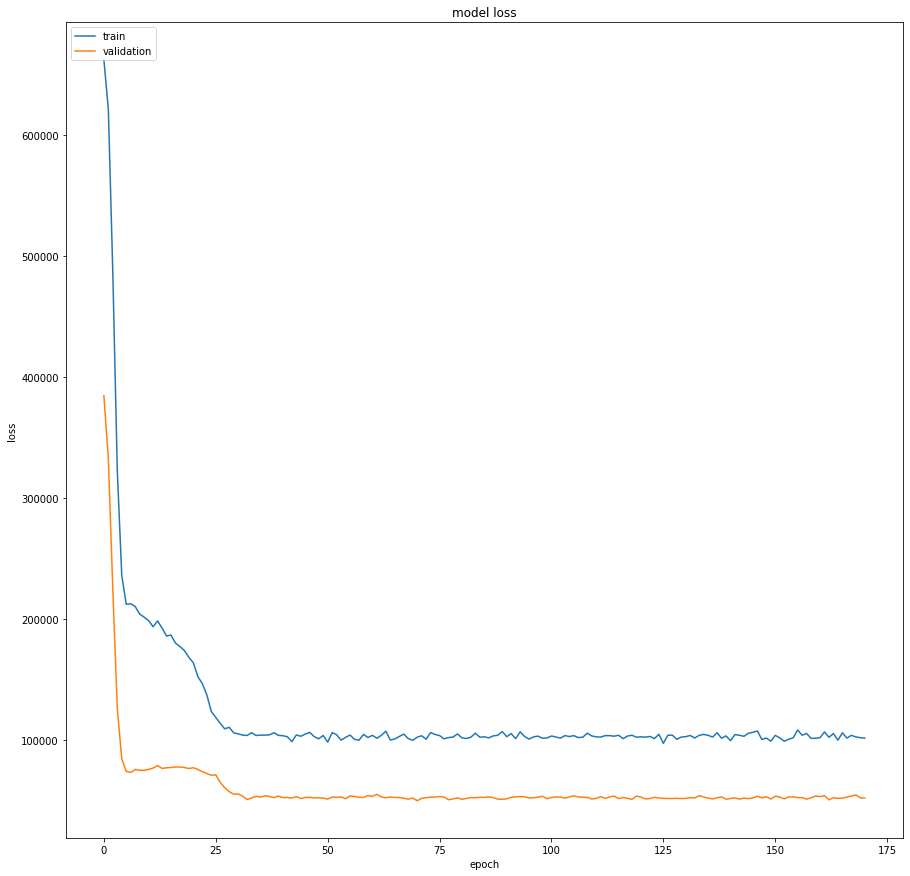

Model name MLP (11,5,1) Act(lin, lin, relu) Dropout (0.1,0.1)
Target : Max prod
Root Mean Square Error: 227.8606
Mean Absolute Error: 160.4207
R2 score : 75.6760



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_51 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_35 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_52 (Dense)             (None, 6)                 72        
_________________________________________________________________
dropout_36 (Dropout)         (None, 6)                 0         
_________________________________________________________________
dense_53 (Dense)             (None, 1)                 7         
Total params: 211
Trainable params: 211
Non-trainable params: 0
_____________________________________________

1725/1725 [==============================] - 0s 105us/step - loss: 108210.3102 - mean_squared_error: 108210.3102 - mean_absolute_error: 259.5433 - val_loss: 57522.0168 - val_mean_squared_error: 57522.0168 - val_mean_absolute_error: 180.9560
Epoch 29/200
1725/1725 [==============================] - 0s 102us/step - loss: 103539.9423 - mean_squared_error: 103539.9423 - mean_absolute_error: 254.6177 - val_loss: 54166.3347 - val_mean_squared_error: 54166.3347 - val_mean_absolute_error: 172.6633
Epoch 30/200
1725/1725 [==============================] - 0s 104us/step - loss: 105134.5229 - mean_squared_error: 105134.5229 - mean_absolute_error: 257.5821 - val_loss: 53346.2955 - val_mean_squared_error: 53346.2955 - val_mean_absolute_error: 169.5453
Epoch 31/200
1725/1725 [==============================] - 0s 132us/step - loss: 101643.3967 - mean_squared_error: 101643.3967 - mean_absolute_error: 253.1233 - val_loss: 52902.1951 - val_mean_squared_error: 52902.1951 - val_mean_absolute_error: 166.86

1725/1725 [==============================] - 0s 104us/step - loss: 100429.0810 - mean_squared_error: 100429.0810 - mean_absolute_error: 252.1500 - val_loss: 52917.8820 - val_mean_squared_error: 52917.8820 - val_mean_absolute_error: 161.4162
Epoch 61/200
1725/1725 [==============================] - 0s 105us/step - loss: 99743.1405 - mean_squared_error: 99743.1405 - mean_absolute_error: 248.2034 - val_loss: 51576.2798 - val_mean_squared_error: 51576.2798 - val_mean_absolute_error: 159.7646
Epoch 62/200
1725/1725 [==============================] - 0s 104us/step - loss: 97888.1815 - mean_squared_error: 97888.1815 - mean_absolute_error: 246.7714 - val_loss: 53755.0365 - val_mean_squared_error: 53755.0365 - val_mean_absolute_error: 161.9461
Epoch 63/200
1725/1725 [==============================] - 0s 104us/step - loss: 102171.8793 - mean_squared_error: 102171.8793 - mean_absolute_error: 253.9194 - val_loss: 52479.8796 - val_mean_squared_error: 52479.8796 - val_mean_absolute_error: 160.2723
E

1725/1725 [==============================] - 0s 104us/step - loss: 99040.8835 - mean_squared_error: 99040.8835 - mean_absolute_error: 248.8928 - val_loss: 51740.0888 - val_mean_squared_error: 51740.0888 - val_mean_absolute_error: 159.0393
Epoch 93/200
1725/1725 [==============================] - 0s 104us/step - loss: 101404.6439 - mean_squared_error: 101404.6439 - mean_absolute_error: 250.7182 - val_loss: 52084.3287 - val_mean_squared_error: 52084.3287 - val_mean_absolute_error: 159.6587
Epoch 94/200
1725/1725 [==============================] - 0s 104us/step - loss: 101468.7247 - mean_squared_error: 101468.7247 - mean_absolute_error: 253.9845 - val_loss: 51108.2212 - val_mean_squared_error: 51108.2212 - val_mean_absolute_error: 158.1048
Epoch 95/200
1725/1725 [==============================] - 0s 104us/step - loss: 102385.6300 - mean_squared_error: 102385.6300 - mean_absolute_error: 253.8170 - val_loss: 53144.5631 - val_mean_squared_error: 53144.5631 - val_mean_absolute_error: 160.9619

1725/1725 [==============================] - 0s 106us/step - loss: 97289.2000 - mean_squared_error: 97289.2000 - mean_absolute_error: 247.0260 - val_loss: 52030.1690 - val_mean_squared_error: 52030.1690 - val_mean_absolute_error: 159.4594
Epoch 125/200
1725/1725 [==============================] - 0s 104us/step - loss: 101994.2442 - mean_squared_error: 101994.2442 - mean_absolute_error: 252.0969 - val_loss: 51973.0033 - val_mean_squared_error: 51973.0033 - val_mean_absolute_error: 159.6894
Epoch 126/200
1725/1725 [==============================] - 0s 104us/step - loss: 98582.5930 - mean_squared_error: 98582.5930 - mean_absolute_error: 251.0245 - val_loss: 51788.3127 - val_mean_squared_error: 51788.3127 - val_mean_absolute_error: 159.9687
Epoch 127/200
1725/1725 [==============================] - 0s 103us/step - loss: 97916.7103 - mean_squared_error: 97916.7103 - mean_absolute_error: 248.3945 - val_loss: 51475.0008 - val_mean_squared_error: 51475.0008 - val_mean_absolute_error: 159.3065


1725/1725 [==============================] - 0s 103us/step - loss: 102929.8530 - mean_squared_error: 102929.8530 - mean_absolute_error: 250.9068 - val_loss: 51380.3180 - val_mean_squared_error: 51380.3180 - val_mean_absolute_error: 158.6639
Epoch 157/200
1725/1725 [==============================] - 0s 106us/step - loss: 97216.2919 - mean_squared_error: 97216.2919 - mean_absolute_error: 248.3656 - val_loss: 50129.8333 - val_mean_squared_error: 50129.8333 - val_mean_absolute_error: 156.8948
Epoch 158/200
1725/1725 [==============================] - 0s 110us/step - loss: 101504.9797 - mean_squared_error: 101504.9797 - mean_absolute_error: 251.8133 - val_loss: 49072.6389 - val_mean_squared_error: 49072.6389 - val_mean_absolute_error: 156.1377
Epoch 159/200
1725/1725 [==============================] - 0s 104us/step - loss: 102666.5728 - mean_squared_error: 102666.5728 - mean_absolute_error: 253.8651 - val_loss: 51594.5657 - val_mean_squared_error: 51594.5657 - val_mean_absolute_error: 159.6

1725/1725 [==============================] - 0s 103us/step - loss: 104133.2525 - mean_squared_error: 104133.2525 - mean_absolute_error: 255.0011 - val_loss: 53661.1735 - val_mean_squared_error: 53661.1735 - val_mean_absolute_error: 161.9446
Epoch 189/200
1725/1725 [==============================] - 0s 106us/step - loss: 99635.0924 - mean_squared_error: 99635.0924 - mean_absolute_error: 249.9876 - val_loss: 51850.3124 - val_mean_squared_error: 51850.3124 - val_mean_absolute_error: 159.7617
Epoch 190/200
1725/1725 [==============================] - 0s 103us/step - loss: 99447.9710 - mean_squared_error: 99447.9710 - mean_absolute_error: 249.8189 - val_loss: 53547.4123 - val_mean_squared_error: 53547.4123 - val_mean_absolute_error: 161.4640
Epoch 191/200
1725/1725 [==============================] - 0s 108us/step - loss: 103928.8311 - mean_squared_error: 103928.8311 - mean_absolute_error: 256.2233 - val_loss: 53377.6864 - val_mean_squared_error: 53377.6864 - val_mean_absolute_error: 161.285

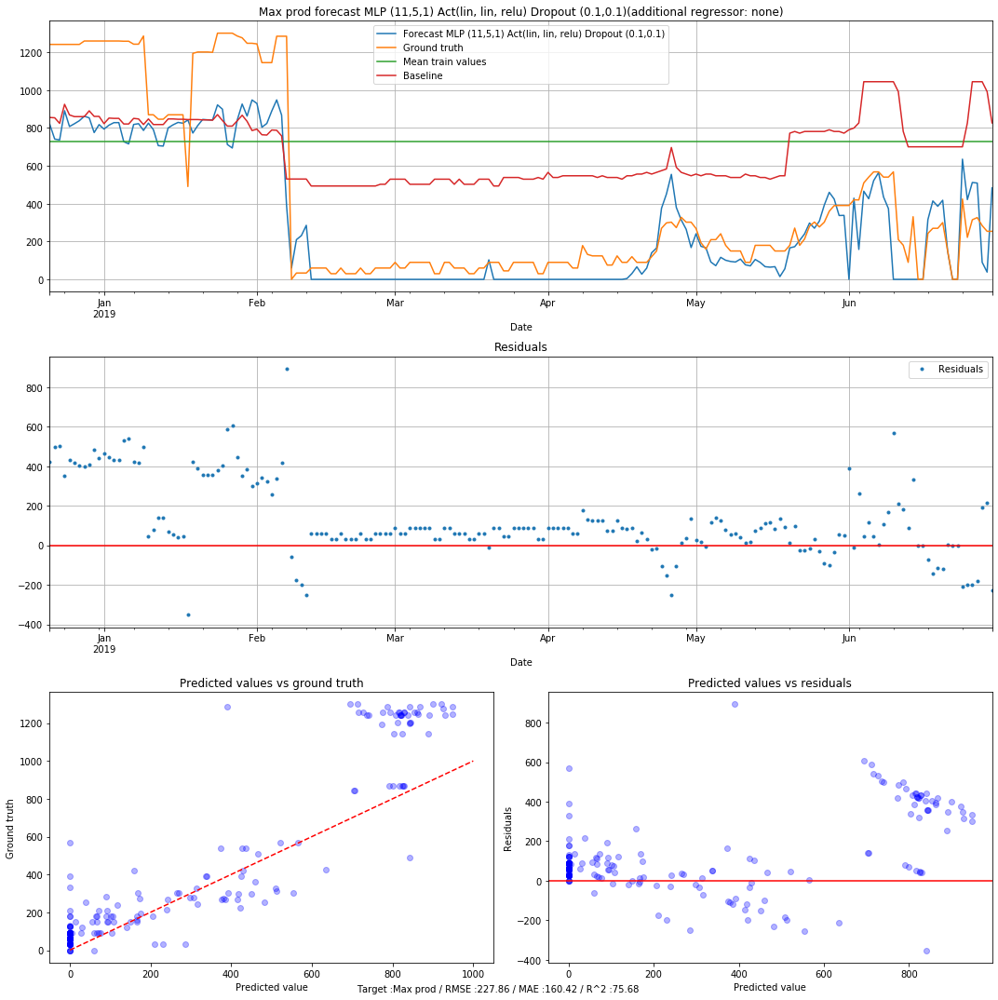

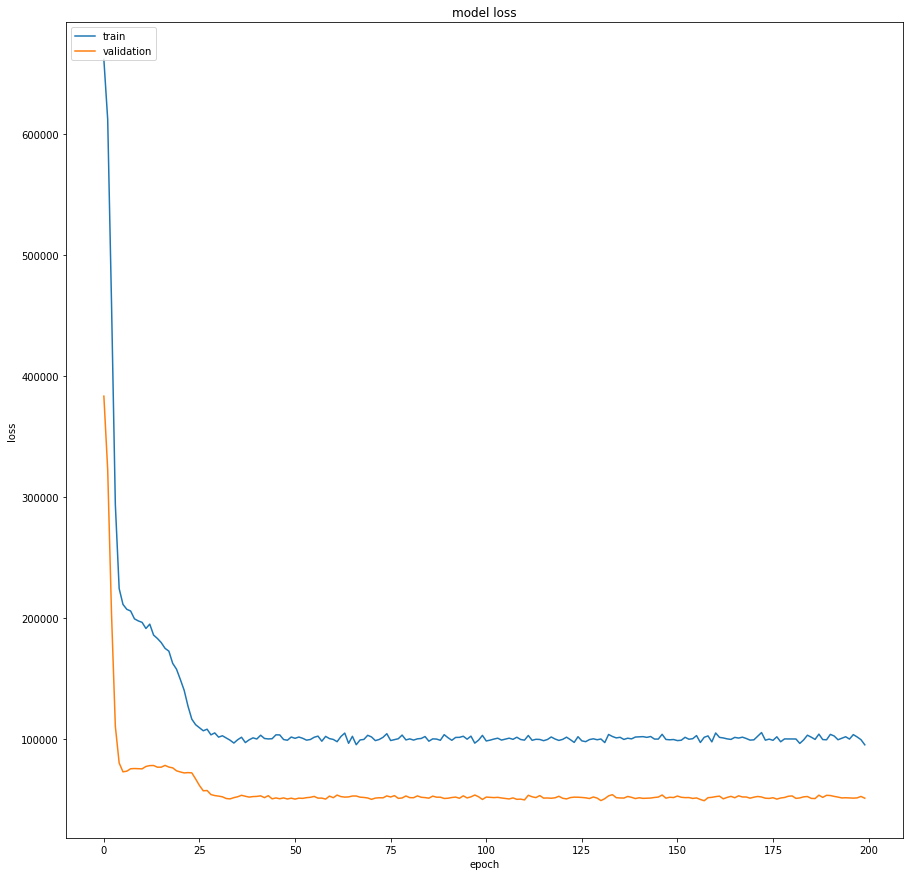

Model name MLP (11,6,1) Act(lin, lin, relu) Dropout (0.1,0.1)
Target : Max prod
Root Mean Square Error: 226.1862
Mean Absolute Error: 158.8664
R2 score : 76.0322



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_54 (Dense)             (None, 11)                132       
_________________________________________________________________
dropout_37 (Dropout)         (None, 11)                0         
_________________________________________________________________
dense_55 (Dense)             (None, 8)                 96        
_________________________________________________________________
dropout_38 (Dropout)         (None, 8)                 0         
_________________________________________________________________
dense_56 (Dense)             (None, 1)                 9         
Total params: 237
Trainable params: 237
Non-trainable params: 0
_____________________________________________

1725/1725 [==============================] - 0s 110us/step - loss: 99739.0993 - mean_squared_error: 99739.0993 - mean_absolute_error: 251.0464 - val_loss: 53575.5007 - val_mean_squared_error: 53575.5007 - val_mean_absolute_error: 167.0901
Epoch 29/200
1725/1725 [==============================] - 0s 107us/step - loss: 97331.1166 - mean_squared_error: 97331.1166 - mean_absolute_error: 245.7406 - val_loss: 52185.2920 - val_mean_squared_error: 52185.2920 - val_mean_absolute_error: 163.3952
Epoch 30/200
1725/1725 [==============================] - 0s 105us/step - loss: 99270.0340 - mean_squared_error: 99270.0340 - mean_absolute_error: 249.6462 - val_loss: 52429.6531 - val_mean_squared_error: 52429.6531 - val_mean_absolute_error: 162.9400
Epoch 31/200
1725/1725 [==============================] - 0s 107us/step - loss: 98359.6678 - mean_squared_error: 98359.6678 - mean_absolute_error: 247.9085 - val_loss: 53564.8378 - val_mean_squared_error: 53564.8378 - val_mean_absolute_error: 164.4019
Epoch

1725/1725 [==============================] - 0s 108us/step - loss: 98951.7809 - mean_squared_error: 98951.7809 - mean_absolute_error: 250.1696 - val_loss: 52605.5408 - val_mean_squared_error: 52605.5408 - val_mean_absolute_error: 160.9385
Epoch 61/200
1725/1725 [==============================] - 0s 104us/step - loss: 97238.7374 - mean_squared_error: 97238.7374 - mean_absolute_error: 244.8732 - val_loss: 51678.5808 - val_mean_squared_error: 51678.5808 - val_mean_absolute_error: 159.7873
Epoch 62/200
1725/1725 [==============================] - 0s 116us/step - loss: 98474.8597 - mean_squared_error: 98474.8597 - mean_absolute_error: 248.8100 - val_loss: 52637.6021 - val_mean_squared_error: 52637.6021 - val_mean_absolute_error: 161.0182
Epoch 63/200
1725/1725 [==============================] - 0s 104us/step - loss: 100242.5473 - mean_squared_error: 100242.5473 - mean_absolute_error: 248.6050 - val_loss: 50382.6886 - val_mean_squared_error: 50382.6886 - val_mean_absolute_error: 157.9309
Epo

1725/1725 [==============================] - 0s 113us/step - loss: 100440.8670 - mean_squared_error: 100440.8670 - mean_absolute_error: 248.8404 - val_loss: 51243.3622 - val_mean_squared_error: 51243.3622 - val_mean_absolute_error: 158.5180
Epoch 93/200
1725/1725 [==============================] - 0s 104us/step - loss: 97065.4923 - mean_squared_error: 97065.4923 - mean_absolute_error: 246.4136 - val_loss: 50815.1773 - val_mean_squared_error: 50815.1773 - val_mean_absolute_error: 158.9645
Epoch 94/200
1725/1725 [==============================] - 0s 104us/step - loss: 97572.7732 - mean_squared_error: 97572.7732 - mean_absolute_error: 249.9713 - val_loss: 50486.9598 - val_mean_squared_error: 50486.9598 - val_mean_absolute_error: 157.9134
Epoch 95/200
1725/1725 [==============================] - 0s 114us/step - loss: 96285.0923 - mean_squared_error: 96285.0923 - mean_absolute_error: 246.3058 - val_loss: 51917.7833 - val_mean_squared_error: 51917.7833 - val_mean_absolute_error: 159.8074
Epo

1725/1725 [==============================] - 0s 121us/step - loss: 95135.8967 - mean_squared_error: 95135.8967 - mean_absolute_error: 243.3200 - val_loss: 50455.2889 - val_mean_squared_error: 50455.2889 - val_mean_absolute_error: 158.0528
Epoch 125/200
1725/1725 [==============================] - 0s 108us/step - loss: 97912.7076 - mean_squared_error: 97912.7076 - mean_absolute_error: 246.8528 - val_loss: 51037.1203 - val_mean_squared_error: 51037.1203 - val_mean_absolute_error: 159.0204
Epoch 126/200
1725/1725 [==============================] - 0s 104us/step - loss: 97946.1998 - mean_squared_error: 97946.1998 - mean_absolute_error: 247.2739 - val_loss: 51319.1383 - val_mean_squared_error: 51319.1383 - val_mean_absolute_error: 159.0093
Epoch 127/200
1725/1725 [==============================] - 0s 131us/step - loss: 97254.6642 - mean_squared_error: 97254.6642 - mean_absolute_error: 245.1297 - val_loss: 50367.5213 - val_mean_squared_error: 50367.5213 - val_mean_absolute_error: 157.9995
Ep

1725/1725 [==============================] - 0s 114us/step - loss: 99205.0647 - mean_squared_error: 99205.0647 - mean_absolute_error: 247.2100 - val_loss: 50866.3201 - val_mean_squared_error: 50866.3201 - val_mean_absolute_error: 157.9530
Epoch 157/200
1725/1725 [==============================] - 0s 118us/step - loss: 97677.1840 - mean_squared_error: 97677.1840 - mean_absolute_error: 247.3540 - val_loss: 49935.3870 - val_mean_squared_error: 49935.3870 - val_mean_absolute_error: 157.2207
Epoch 158/200
1725/1725 [==============================] - 0s 119us/step - loss: 100036.4101 - mean_squared_error: 100036.4101 - mean_absolute_error: 250.2390 - val_loss: 49702.8181 - val_mean_squared_error: 49702.8181 - val_mean_absolute_error: 157.3832
Epoch 159/200
1725/1725 [==============================] - 0s 110us/step - loss: 98725.5466 - mean_squared_error: 98725.5466 - mean_absolute_error: 248.0761 - val_loss: 52274.4070 - val_mean_squared_error: 52274.4070 - val_mean_absolute_error: 161.2411


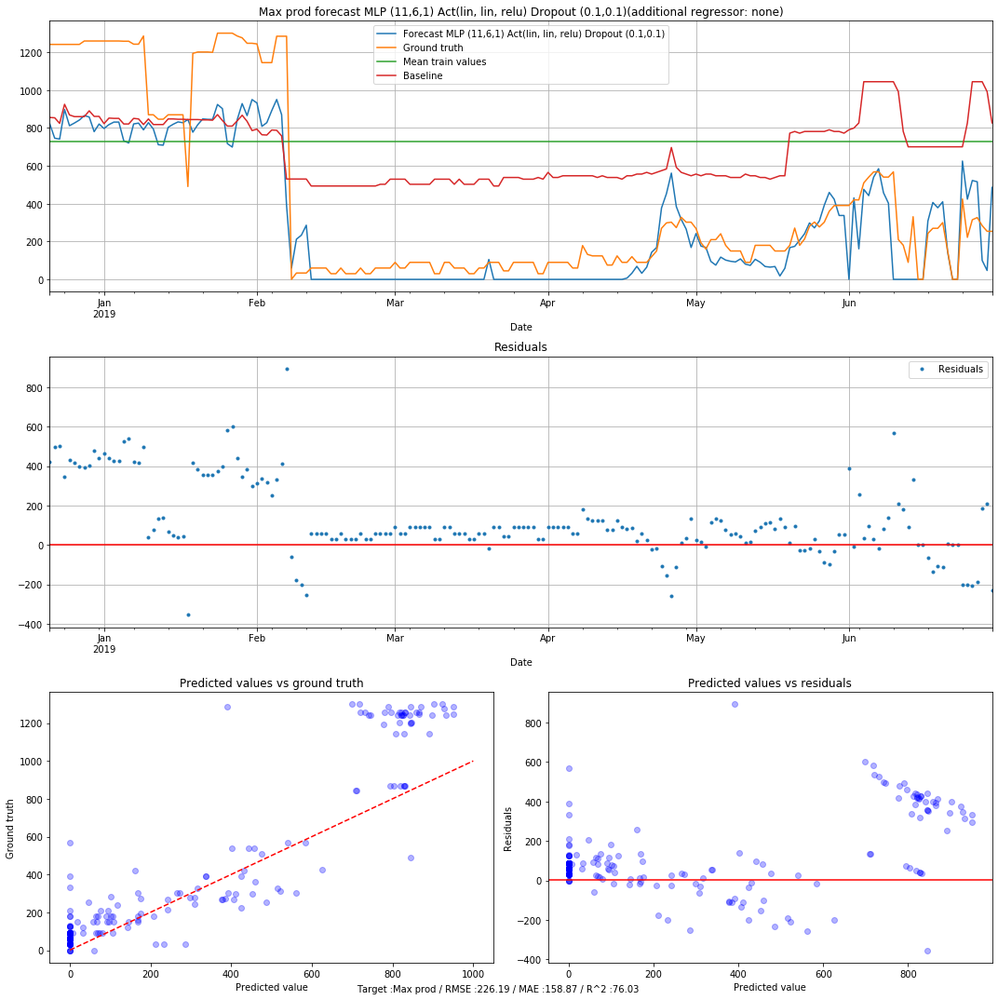

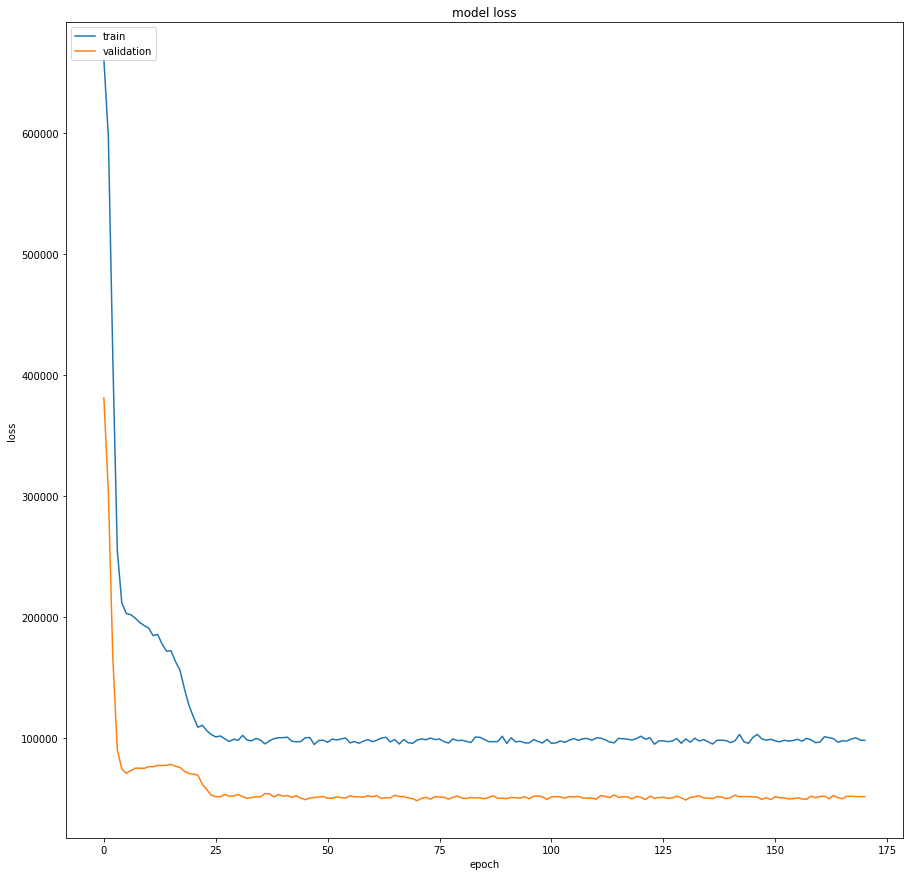

Model name MLP (11,8,1) Act(lin, lin, relu) Dropout (0.5,0.5)
Target : Max prod
Root Mean Square Error: 227.5478
Mean Absolute Error: 159.1187
R2 score : 75.7427



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_57 (Dense)             (None, 10)                120       
_________________________________________________________________
dropout_39 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_58 (Dense)             (None, 7)                 77        
_________________________________________________________________
dropout_40 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_59 (Dense)             (None, 1)                 8         
Total params: 205
Trainable params: 205
Non-trainable params: 0
_____________________________________________

1725/1725 [==============================] - 0s 107us/step - loss: 103394.1190 - mean_squared_error: 103394.1190 - mean_absolute_error: 254.7804 - val_loss: 54682.7005 - val_mean_squared_error: 54682.7005 - val_mean_absolute_error: 176.5753
Epoch 29/200
1725/1725 [==============================] - 0s 107us/step - loss: 101484.2096 - mean_squared_error: 101484.2096 - mean_absolute_error: 252.8705 - val_loss: 52976.8484 - val_mean_squared_error: 52976.8484 - val_mean_absolute_error: 170.8267
Epoch 30/200
1725/1725 [==============================] - 0s 110us/step - loss: 102540.6812 - mean_squared_error: 102540.6812 - mean_absolute_error: 252.2402 - val_loss: 52786.1686 - val_mean_squared_error: 52786.1686 - val_mean_absolute_error: 167.6081
Epoch 31/200
1725/1725 [==============================] - 0s 110us/step - loss: 100866.0504 - mean_squared_error: 100866.0504 - mean_absolute_error: 251.8836 - val_loss: 52277.9246 - val_mean_squared_error: 52277.9246 - val_mean_absolute_error: 166.00

1725/1725 [==============================] - 0s 117us/step - loss: 101999.8641 - mean_squared_error: 101999.8641 - mean_absolute_error: 251.8943 - val_loss: 52612.9868 - val_mean_squared_error: 52612.9868 - val_mean_absolute_error: 160.9820
Epoch 61/200
1725/1725 [==============================] - 0s 112us/step - loss: 101984.8205 - mean_squared_error: 101984.8205 - mean_absolute_error: 252.3212 - val_loss: 51784.2627 - val_mean_squared_error: 51784.2627 - val_mean_absolute_error: 160.6988
Epoch 62/200
1725/1725 [==============================] - 0s 115us/step - loss: 97797.7531 - mean_squared_error: 97797.7531 - mean_absolute_error: 248.0001 - val_loss: 52276.7386 - val_mean_squared_error: 52276.7386 - val_mean_absolute_error: 160.5873
Epoch 63/200
1725/1725 [==============================] - 0s 116us/step - loss: 100270.2766 - mean_squared_error: 100270.2766 - mean_absolute_error: 249.6059 - val_loss: 50166.7087 - val_mean_squared_error: 50166.7087 - val_mean_absolute_error: 158.0044

1725/1725 [==============================] - 0s 121us/step - loss: 101978.1450 - mean_squared_error: 101978.1450 - mean_absolute_error: 252.6009 - val_loss: 51767.5872 - val_mean_squared_error: 51767.5872 - val_mean_absolute_error: 159.8202
Epoch 93/200
1725/1725 [==============================] - 0s 118us/step - loss: 100231.8942 - mean_squared_error: 100231.8942 - mean_absolute_error: 250.6078 - val_loss: 51338.2359 - val_mean_squared_error: 51338.2359 - val_mean_absolute_error: 159.6661
Epoch 94/200
1725/1725 [==============================] - 0s 123us/step - loss: 101344.7688 - mean_squared_error: 101344.7688 - mean_absolute_error: 251.5704 - val_loss: 50978.8533 - val_mean_squared_error: 50978.8533 - val_mean_absolute_error: 158.6352
Epoch 95/200
1725/1725 [==============================] - 0s 115us/step - loss: 100864.4769 - mean_squared_error: 100864.4769 - mean_absolute_error: 254.4794 - val_loss: 50382.8434 - val_mean_squared_error: 50382.8434 - val_mean_absolute_error: 157.82

1725/1725 [==============================] - 0s 125us/step - loss: 100332.7300 - mean_squared_error: 100332.7300 - mean_absolute_error: 252.2951 - val_loss: 51360.9979 - val_mean_squared_error: 51360.9979 - val_mean_absolute_error: 158.8796
Epoch 125/200
1725/1725 [==============================] - 0s 129us/step - loss: 99185.2890 - mean_squared_error: 99185.2890 - mean_absolute_error: 247.2000 - val_loss: 50239.7619 - val_mean_squared_error: 50239.7619 - val_mean_absolute_error: 157.3735
Epoch 126/200
1725/1725 [==============================] - 0s 136us/step - loss: 98126.6759 - mean_squared_error: 98126.6759 - mean_absolute_error: 248.7704 - val_loss: 52137.3553 - val_mean_squared_error: 52137.3553 - val_mean_absolute_error: 159.7667
Epoch 127/200
1725/1725 [==============================] - 0s 134us/step - loss: 99358.2213 - mean_squared_error: 99358.2213 - mean_absolute_error: 248.2850 - val_loss: 52205.4001 - val_mean_squared_error: 52205.4001 - val_mean_absolute_error: 159.8312


1725/1725 [==============================] - 0s 119us/step - loss: 98594.4312 - mean_squared_error: 98594.4312 - mean_absolute_error: 246.9597 - val_loss: 51698.8761 - val_mean_squared_error: 51698.8761 - val_mean_absolute_error: 159.9209
Epoch 157/200
1725/1725 [==============================] - 0s 116us/step - loss: 96986.5984 - mean_squared_error: 96986.5984 - mean_absolute_error: 247.4682 - val_loss: 50715.8021 - val_mean_squared_error: 50715.8021 - val_mean_absolute_error: 157.7509
Epoch 158/200
1725/1725 [==============================] - 0s 116us/step - loss: 100306.6268 - mean_squared_error: 100306.6268 - mean_absolute_error: 249.0706 - val_loss: 49865.9312 - val_mean_squared_error: 49865.9312 - val_mean_absolute_error: 157.1036
Epoch 159/200
1725/1725 [==============================] - 0s 125us/step - loss: 105472.6343 - mean_squared_error: 105472.6343 - mean_absolute_error: 255.3779 - val_loss: 51740.1018 - val_mean_squared_error: 51740.1018 - val_mean_absolute_error: 160.064

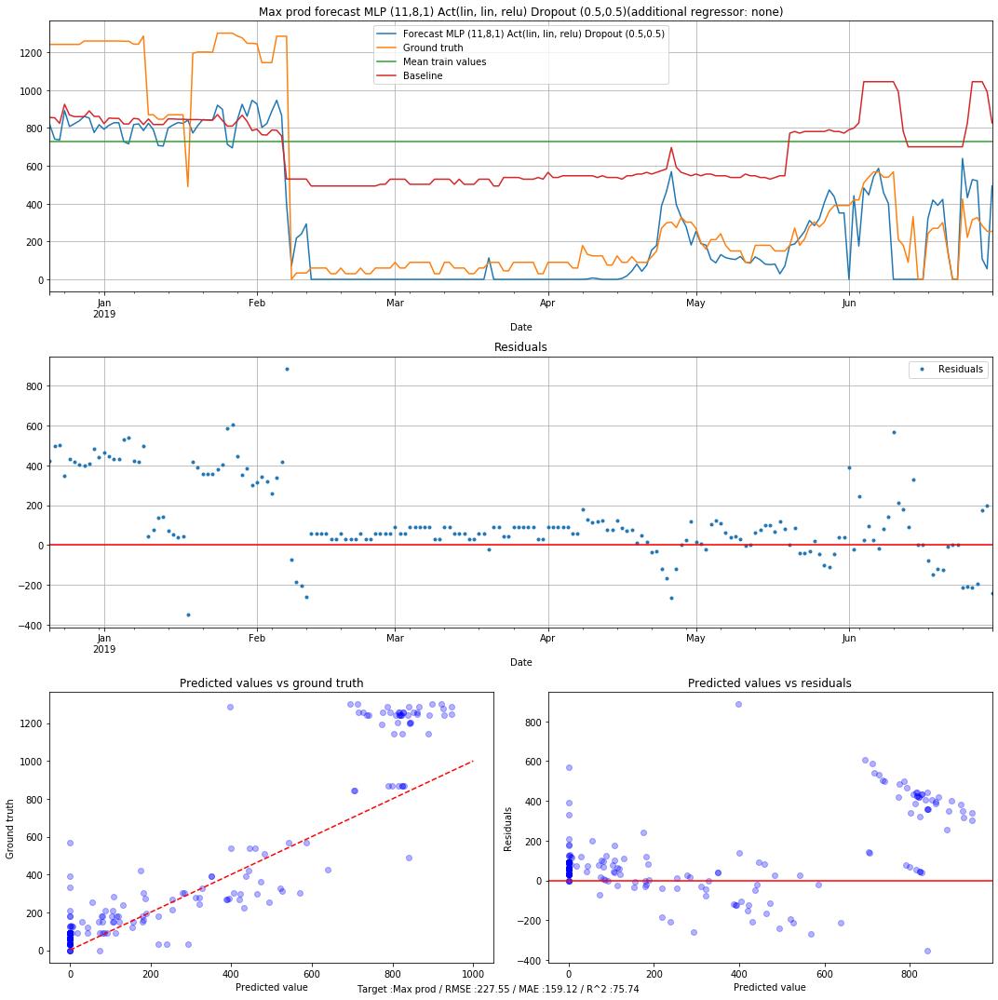

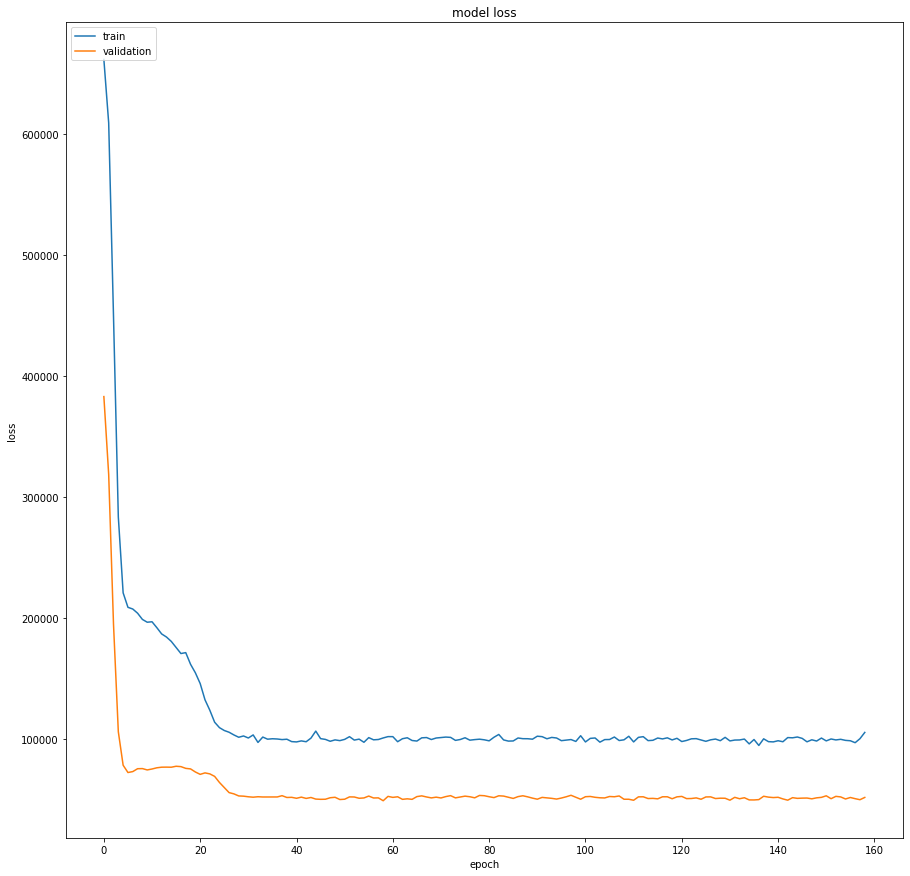

Model name MLP (10,7,1) Act(lin, lin, relu) Dropout (0.1,0.1)
Target : Max prod
Root Mean Square Error: 227.4645
Mean Absolute Error: 160.0643
R2 score : 75.7605



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_60 (Dense)             (None, 9)                 108       
_________________________________________________________________
dropout_41 (Dropout)         (None, 9)                 0         
_________________________________________________________________
dense_61 (Dense)             (None, 7)                 70        
_________________________________________________________________
dropout_42 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_62 (Dense)             (None, 1)                 8         
Total params: 186
Trainable params: 186
Non-trainable params: 0
_____________________________________________

1725/1725 [==============================] - 0s 164us/step - loss: 102499.5837 - mean_squared_error: 102499.5837 - mean_absolute_error: 253.5527 - val_loss: 56394.8581 - val_mean_squared_error: 56394.8581 - val_mean_absolute_error: 181.0035
Epoch 29/200
1725/1725 [==============================] - 0s 172us/step - loss: 102754.9572 - mean_squared_error: 102754.9572 - mean_absolute_error: 254.2577 - val_loss: 54821.6056 - val_mean_squared_error: 54821.6056 - val_mean_absolute_error: 175.0962
Epoch 30/200
1725/1725 [==============================] - 0s 173us/step - loss: 104451.4794 - mean_squared_error: 104451.4794 - mean_absolute_error: 256.1679 - val_loss: 53815.5222 - val_mean_squared_error: 53815.5222 - val_mean_absolute_error: 171.3567
Epoch 31/200
1725/1725 [==============================] - 0s 173us/step - loss: 103433.6029 - mean_squared_error: 103433.6029 - mean_absolute_error: 253.9033 - val_loss: 52355.9146 - val_mean_squared_error: 52355.9146 - val_mean_absolute_error: 168.04

1725/1725 [==============================] - 0s 109us/step - loss: 100674.5644 - mean_squared_error: 100674.5644 - mean_absolute_error: 252.4897 - val_loss: 52500.5506 - val_mean_squared_error: 52500.5506 - val_mean_absolute_error: 160.7197
Epoch 61/200
1725/1725 [==============================] - 0s 114us/step - loss: 100945.7979 - mean_squared_error: 100945.7979 - mean_absolute_error: 251.6667 - val_loss: 51605.1829 - val_mean_squared_error: 51605.1829 - val_mean_absolute_error: 159.8271
Epoch 62/200
1725/1725 [==============================] - 0s 114us/step - loss: 100627.3878 - mean_squared_error: 100627.3878 - mean_absolute_error: 250.4296 - val_loss: 53202.5048 - val_mean_squared_error: 53202.5048 - val_mean_absolute_error: 161.8084
Epoch 63/200
1725/1725 [==============================] - 0s 121us/step - loss: 104819.0139 - mean_squared_error: 104819.0139 - mean_absolute_error: 254.9589 - val_loss: 50611.5418 - val_mean_squared_error: 50611.5418 - val_mean_absolute_error: 158.50

1725/1725 [==============================] - 0s 147us/step - loss: 100885.4604 - mean_squared_error: 100885.4604 - mean_absolute_error: 251.2554 - val_loss: 52155.6441 - val_mean_squared_error: 52155.6441 - val_mean_absolute_error: 160.2127
Epoch 93/200
1725/1725 [==============================] - 0s 130us/step - loss: 97296.5021 - mean_squared_error: 97296.5021 - mean_absolute_error: 244.9818 - val_loss: 51527.0247 - val_mean_squared_error: 51527.0247 - val_mean_absolute_error: 159.2449
Epoch 94/200
1725/1725 [==============================] - 0s 117us/step - loss: 102855.0019 - mean_squared_error: 102855.0019 - mean_absolute_error: 254.5078 - val_loss: 50949.5083 - val_mean_squared_error: 50949.5083 - val_mean_absolute_error: 158.9541
Epoch 95/200
1725/1725 [==============================] - 0s 108us/step - loss: 100229.9962 - mean_squared_error: 100229.9962 - mean_absolute_error: 250.4842 - val_loss: 50610.7557 - val_mean_squared_error: 50610.7557 - val_mean_absolute_error: 158.1123

1725/1725 [==============================] - 0s 113us/step - loss: 99805.4576 - mean_squared_error: 99805.4576 - mean_absolute_error: 251.4158 - val_loss: 52164.3985 - val_mean_squared_error: 52164.3985 - val_mean_absolute_error: 159.5836
Epoch 125/200
1725/1725 [==============================] - 0s 112us/step - loss: 97887.0725 - mean_squared_error: 97887.0725 - mean_absolute_error: 247.0523 - val_loss: 51322.7646 - val_mean_squared_error: 51322.7646 - val_mean_absolute_error: 158.3766
Epoch 126/200
1725/1725 [==============================] - 0s 111us/step - loss: 96631.2881 - mean_squared_error: 96631.2881 - mean_absolute_error: 245.2443 - val_loss: 52626.3326 - val_mean_squared_error: 52626.3326 - val_mean_absolute_error: 160.0654
Epoch 127/200
1725/1725 [==============================] - 0s 112us/step - loss: 99386.3322 - mean_squared_error: 99386.3322 - mean_absolute_error: 247.8872 - val_loss: 53106.1110 - val_mean_squared_error: 53106.1110 - val_mean_absolute_error: 160.8648
Ep

1725/1725 [==============================] - 0s 131us/step - loss: 100994.6433 - mean_squared_error: 100994.6433 - mean_absolute_error: 252.2925 - val_loss: 51804.0065 - val_mean_squared_error: 51804.0065 - val_mean_absolute_error: 159.5797
Epoch 157/200
1725/1725 [==============================] - 0s 117us/step - loss: 100644.5488 - mean_squared_error: 100644.5488 - mean_absolute_error: 251.5414 - val_loss: 51057.6911 - val_mean_squared_error: 51057.6911 - val_mean_absolute_error: 158.3582
Epoch 158/200
1725/1725 [==============================] - 0s 121us/step - loss: 100826.1346 - mean_squared_error: 100826.1346 - mean_absolute_error: 248.1146 - val_loss: 50008.0720 - val_mean_squared_error: 50008.0720 - val_mean_absolute_error: 157.2334
Epoch 159/200
1725/1725 [==============================] - 0s 130us/step - loss: 102340.0293 - mean_squared_error: 102340.0293 - mean_absolute_error: 253.0031 - val_loss: 51469.1205 - val_mean_squared_error: 51469.1205 - val_mean_absolute_error: 160

1725/1725 [==============================] - 0s 114us/step - loss: 98671.0842 - mean_squared_error: 98671.0842 - mean_absolute_error: 248.1840 - val_loss: 52288.9785 - val_mean_squared_error: 52288.9785 - val_mean_absolute_error: 159.2723
Epoch 189/200
1725/1725 [==============================] - 0s 112us/step - loss: 99456.7251 - mean_squared_error: 99456.7251 - mean_absolute_error: 248.8919 - val_loss: 52436.3479 - val_mean_squared_error: 52436.3479 - val_mean_absolute_error: 160.0916
Epoch 190/200
1725/1725 [==============================] - 0s 114us/step - loss: 98934.7098 - mean_squared_error: 98934.7098 - mean_absolute_error: 247.9170 - val_loss: 53423.2393 - val_mean_squared_error: 53423.2393 - val_mean_absolute_error: 160.7876
Epoch 191/200
1725/1725 [==============================] - 0s 114us/step - loss: 100531.4245 - mean_squared_error: 100531.4245 - mean_absolute_error: 250.1474 - val_loss: 52313.6078 - val_mean_squared_error: 52313.6078 - val_mean_absolute_error: 159.6720


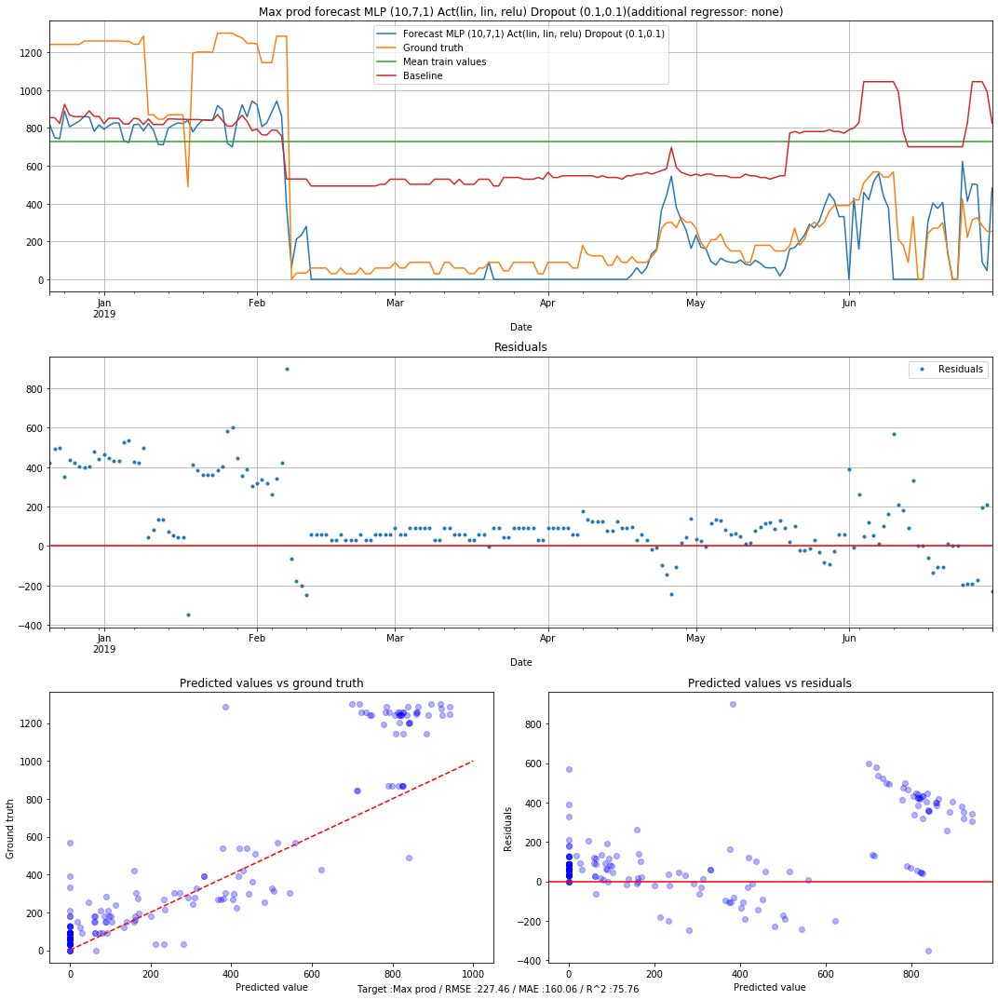

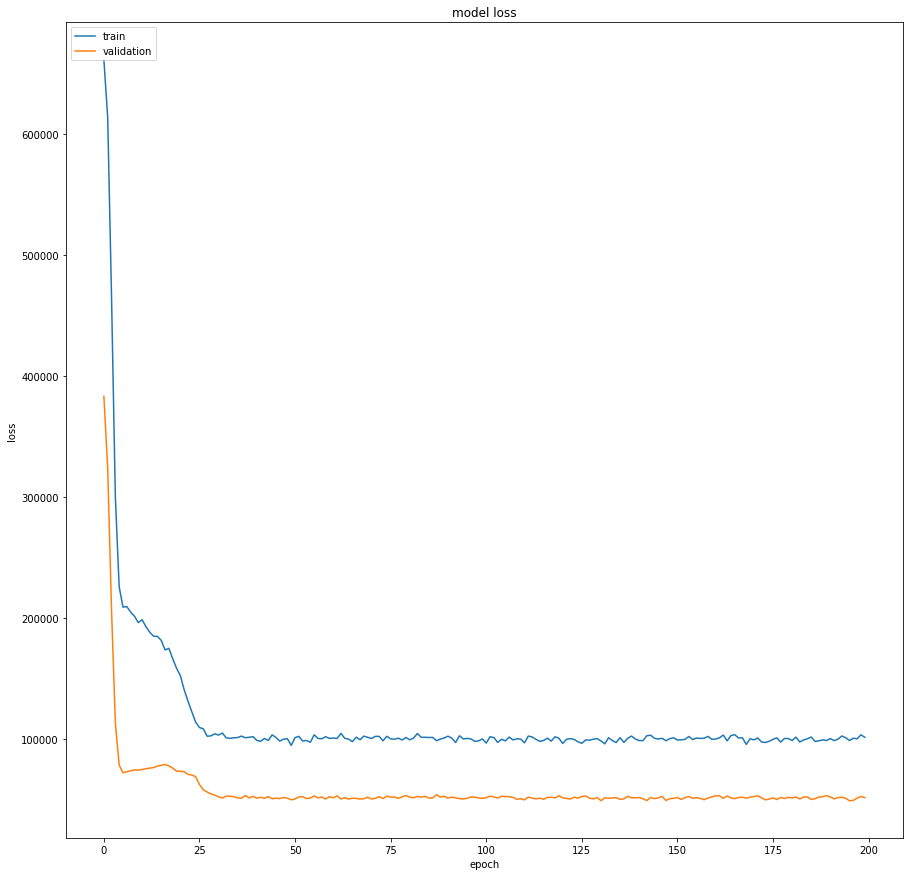

Model name MLP (9,7,1)  Act(lin, lin, relu) Dropout (0.1,0.1)
Target : Max prod
Root Mean Square Error: 227.5002
Mean Absolute Error: 159.7331
R2 score : 75.7529



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_63 (Dense)             (None, 10)                120       
_________________________________________________________________
dropout_43 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_64 (Dense)             (None, 7)                 77        
_________________________________________________________________
dropout_44 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_65 (Dense)             (None, 1)                 8         
Total params: 205
Trainable params: 205
Non-trainable params: 0
_____________________________________________

1725/1725 [==============================] - 0s 120us/step - loss: 140187.1380 - mean_squared_error: 140187.1380 - mean_absolute_error: 296.3978 - val_loss: 176224.8887 - val_mean_squared_error: 176224.8887 - val_mean_absolute_error: 372.2522
Epoch 29/200
1725/1725 [==============================] - 0s 114us/step - loss: 134841.4733 - mean_squared_error: 134841.4733 - mean_absolute_error: 292.5927 - val_loss: 171586.4115 - val_mean_squared_error: 171586.4115 - val_mean_absolute_error: 367.0129
Epoch 30/200
1725/1725 [==============================] - 0s 112us/step - loss: 138201.3815 - mean_squared_error: 138201.3815 - mean_absolute_error: 293.8841 - val_loss: 167559.4248 - val_mean_squared_error: 167559.4248 - val_mean_absolute_error: 363.3323
Epoch 31/200
1725/1725 [==============================] - 0s 112us/step - loss: 134410.9196 - mean_squared_error: 134410.9196 - mean_absolute_error: 291.8165 - val_loss: 163993.9756 - val_mean_squared_error: 163993.9756 - val_mean_absolute_error

1725/1725 [==============================] - 0s 137us/step - loss: 127541.3315 - mean_squared_error: 127541.3315 - mean_absolute_error: 281.4792 - val_loss: 88911.3188 - val_mean_squared_error: 88911.3188 - val_mean_absolute_error: 250.0346
Epoch 61/200
1725/1725 [==============================] - 0s 126us/step - loss: 125589.3709 - mean_squared_error: 125589.3709 - mean_absolute_error: 281.1341 - val_loss: 87435.0165 - val_mean_squared_error: 87435.0165 - val_mean_absolute_error: 248.1626
Epoch 62/200
1725/1725 [==============================] - 0s 120us/step - loss: 123054.0787 - mean_squared_error: 123054.0787 - mean_absolute_error: 277.5513 - val_loss: 86872.2086 - val_mean_squared_error: 86872.2086 - val_mean_absolute_error: 246.7105
Epoch 63/200
1725/1725 [==============================] - 0s 119us/step - loss: 124064.8207 - mean_squared_error: 124064.8207 - mean_absolute_error: 278.5407 - val_loss: 85707.3210 - val_mean_squared_error: 85707.3210 - val_mean_absolute_error: 245.73

1725/1725 [==============================] - 0s 118us/step - loss: 95464.5894 - mean_squared_error: 95464.5894 - mean_absolute_error: 243.6814 - val_loss: 65131.5507 - val_mean_squared_error: 65131.5507 - val_mean_absolute_error: 207.6983
Epoch 93/200
1725/1725 [==============================] - 0s 116us/step - loss: 93791.6556 - mean_squared_error: 93791.6556 - mean_absolute_error: 242.0829 - val_loss: 65081.8376 - val_mean_squared_error: 65081.8376 - val_mean_absolute_error: 208.5611
Epoch 94/200
1725/1725 [==============================] - 0s 118us/step - loss: 96543.3315 - mean_squared_error: 96543.3315 - mean_absolute_error: 244.6316 - val_loss: 64207.3443 - val_mean_squared_error: 64207.3443 - val_mean_absolute_error: 206.8850
Epoch 95/200
1725/1725 [==============================] - 0s 114us/step - loss: 93330.7206 - mean_squared_error: 93330.7206 - mean_absolute_error: 240.4429 - val_loss: 63386.6001 - val_mean_squared_error: 63386.6001 - val_mean_absolute_error: 206.8225
Epoch

1725/1725 [==============================] - 0s 141us/step - loss: 90700.3807 - mean_squared_error: 90700.3807 - mean_absolute_error: 240.6410 - val_loss: 58068.1930 - val_mean_squared_error: 58068.1930 - val_mean_absolute_error: 197.7341
Epoch 125/200
1725/1725 [==============================] - 0s 137us/step - loss: 89477.0750 - mean_squared_error: 89477.0750 - mean_absolute_error: 233.6953 - val_loss: 57724.3229 - val_mean_squared_error: 57724.3229 - val_mean_absolute_error: 197.8350
Epoch 126/200
1725/1725 [==============================] - 0s 174us/step - loss: 86232.9832 - mean_squared_error: 86232.9832 - mean_absolute_error: 233.2433 - val_loss: 58854.9340 - val_mean_squared_error: 58854.9340 - val_mean_absolute_error: 200.1595
Epoch 127/200
1725/1725 [==============================] - 0s 147us/step - loss: 90078.8008 - mean_squared_error: 90078.8008 - mean_absolute_error: 235.5012 - val_loss: 59505.7309 - val_mean_squared_error: 59505.7309 - val_mean_absolute_error: 201.4446
Ep

1725/1725 [==============================] - 0s 129us/step - loss: 88563.3288 - mean_squared_error: 88563.3288 - mean_absolute_error: 233.2630 - val_loss: 48093.8880 - val_mean_squared_error: 48093.8880 - val_mean_absolute_error: 171.1129
Epoch 157/200
1725/1725 [==============================] - 0s 129us/step - loss: 86425.2538 - mean_squared_error: 86425.2538 - mean_absolute_error: 231.5160 - val_loss: 47254.3124 - val_mean_squared_error: 47254.3124 - val_mean_absolute_error: 169.7770
Epoch 158/200
1725/1725 [==============================] - 0s 121us/step - loss: 89322.9609 - mean_squared_error: 89322.9609 - mean_absolute_error: 233.9164 - val_loss: 45899.9632 - val_mean_squared_error: 45899.9632 - val_mean_absolute_error: 166.2070
Epoch 159/200
1725/1725 [==============================] - 0s 112us/step - loss: 94565.7822 - mean_squared_error: 94565.7822 - mean_absolute_error: 240.5891 - val_loss: 47448.8602 - val_mean_squared_error: 47448.8602 - val_mean_absolute_error: 169.3270
Ep

1725/1725 [==============================] - 0s 113us/step - loss: 86171.1570 - mean_squared_error: 86171.1570 - mean_absolute_error: 232.7398 - val_loss: 42106.8098 - val_mean_squared_error: 42106.8098 - val_mean_absolute_error: 148.8021
Epoch 189/200
1725/1725 [==============================] - 0s 119us/step - loss: 86463.1136 - mean_squared_error: 86463.1136 - mean_absolute_error: 232.0448 - val_loss: 42957.5885 - val_mean_squared_error: 42957.5885 - val_mean_absolute_error: 149.8639
Epoch 190/200
1725/1725 [==============================] - 0s 115us/step - loss: 85318.6907 - mean_squared_error: 85318.6907 - mean_absolute_error: 230.3076 - val_loss: 42645.8913 - val_mean_squared_error: 42645.8913 - val_mean_absolute_error: 149.5305
Epoch 191/200
1725/1725 [==============================] - 0s 116us/step - loss: 88175.6520 - mean_squared_error: 88175.6520 - mean_absolute_error: 234.6619 - val_loss: 42629.6702 - val_mean_squared_error: 42629.6702 - val_mean_absolute_error: 150.3351
Ep

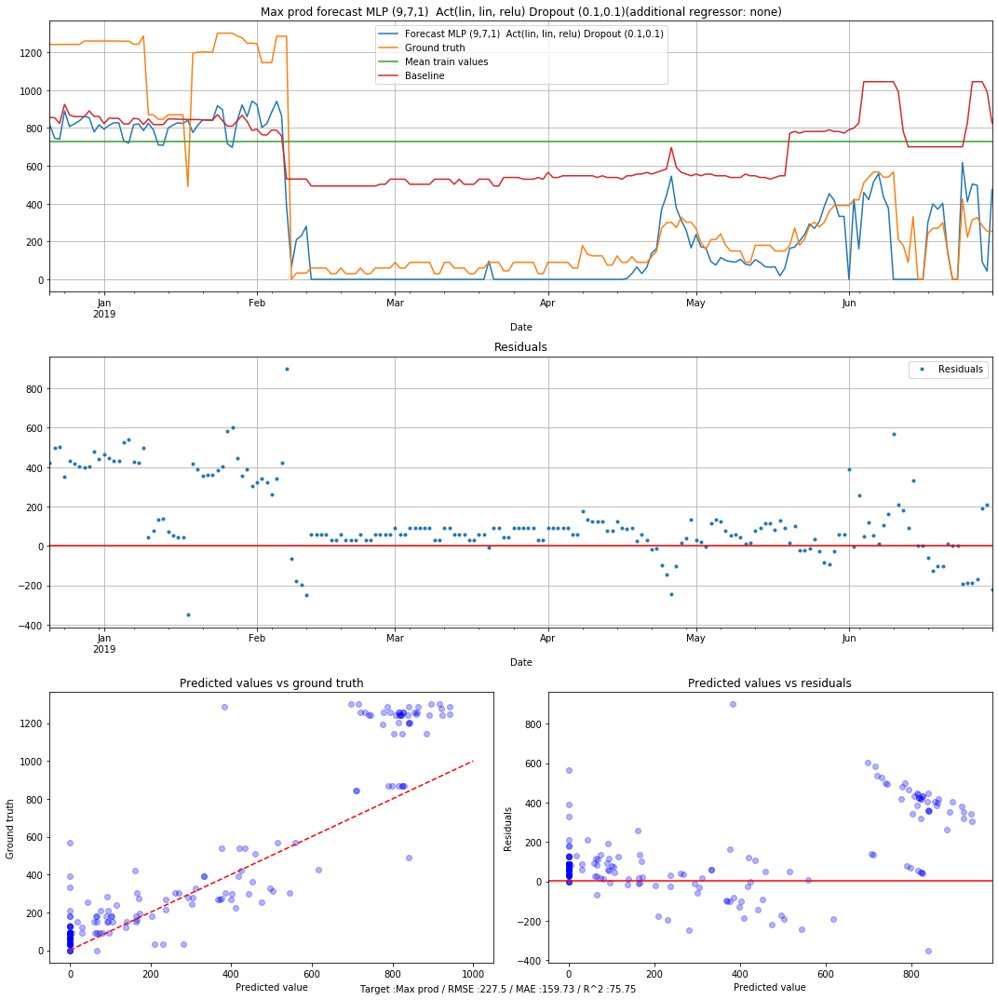

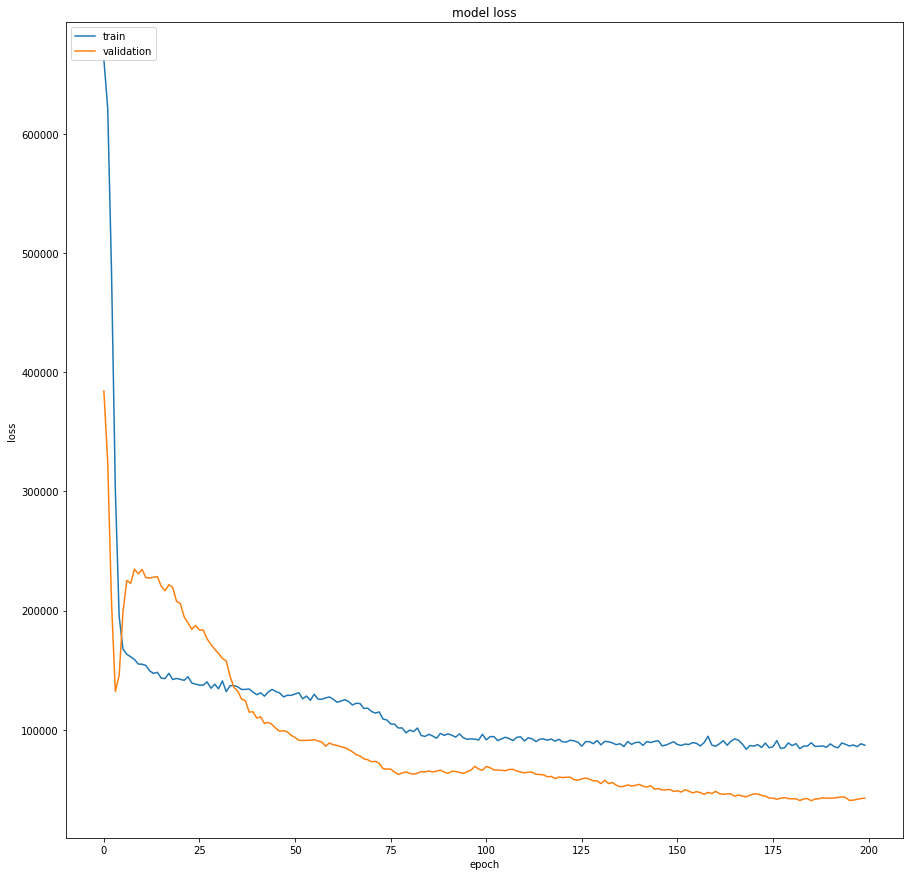

Model name MLP (10,7,1)  Act(lin, relu, relu) Dropout (0.1,0.1)
Target : Max prod
Root Mean Square Error: 206.5223
Mean Absolute Error: 148.9012
R2 score : 80.0184





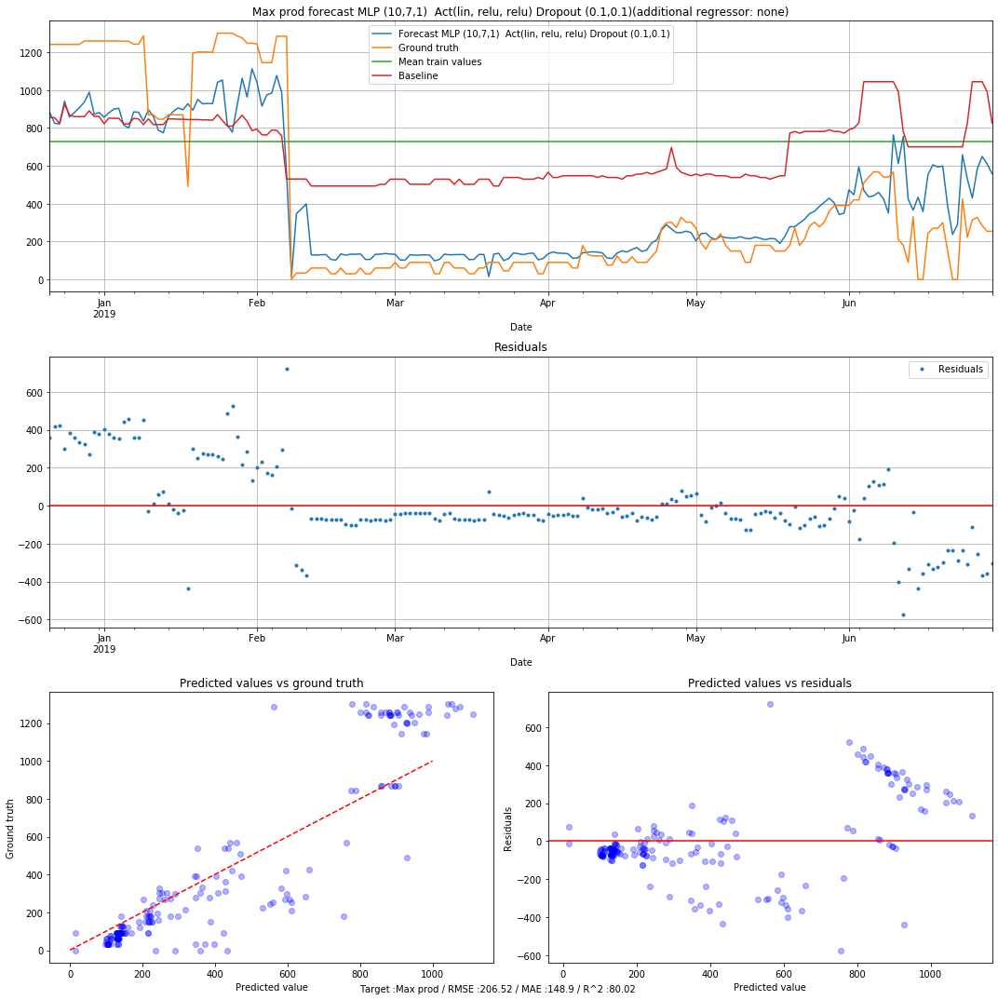

In [36]:
regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]','Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]', 'Weekend','LaggedLakeConstraint55',
            'TotalAvailablePower']

AddRegressors = ['none']

columns = ['Algorithm','Target','Features','RMSE','MAE','R^2', 'Parameters']
df_resultsMLPMaxNRJ = pd.DataFrame(columns = columns)
line_nb = 0

models = ["MLP (11,5,1) Act(lin, lin, relu) Dropout (0.1,0.1)",
          "MLP (11,6,1) Act(lin, lin, relu) Dropout (0.1,0.1)",
          "MLP (11,8,1) Act(lin, lin, relu) Dropout (0.5,0.5)",
          "MLP (10,7,1) Act(lin, lin, relu) Dropout (0.1,0.1)",
          "MLP (9,7,1)  Act(lin, lin, relu) Dropout (0.1,0.1)",
          "MLP (10,7,1)  Act(lin, relu, relu) Dropout (0.1,0.1)" ] 

mlpTopologies = [
                [{"size":11, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":5, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                [{"size":11, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":6, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                [{"size":11, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":8, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                [{"size":10, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":7, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                [{"size":9, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":7, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                [{"size":10, "activation":"linear", "dropOutAfter" : 0.1},
                       {"size":7, "activation":"relu", "dropOutAfter" : 0.1},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                ]

for target_feature in ["Max prod"]:
    for addRegressor in AddRegressors:
        fullRegressors = regressors + [addRegressor]
        xTrain, xTest, yTrain, yTest, yBaseLine = GetDataSplit(df, fullRegressors,target_feature, "Baseline_"+target_feature, 0.9)
        #Scale the data
        stScaler = StandardScaler()  
        stScaler.fit(xTrain)  
        xTrainScaled = stScaler.transform(xTrain)  
        xTestScaled = stScaler.transform(xTest)

        for m,mlpTopology in zip(models, mlpTopologies):
            res = TrainEvalMLP(xTrainScaled, xTestScaled, yTrain, yTest, target_feature, yBaseLine, xTest.index, 
                                addRegressor, mlpTopology, m)
                
            df_resultsMLPMaxNRJ.loc[line_nb,:] = [m,target_feature, xTest.columns, res[0], res[1], res[2], mlpTopology]
            line_nb = line_nb+1

In [37]:
df_resultsMLPMaxNRJ.sort_values(by='RMSE')

,Algorithm,Target,Features,RMSE,MAE,R^2,Parameters
5,"MLP (10,7,1) Act(lin, relu, relu) Dropout (0....",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",206.522,148.901,80.0184,"[{'size': 10, 'activation': 'linear', 'dropOut..."
1,"MLP (11,6,1) Act(lin, lin, relu) Dropout (0.1,...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",226.186,158.866,76.0322,"[{'size': 11, 'activation': 'linear', 'dropOut..."
3,"MLP (10,7,1) Act(lin, lin, relu) Dropout (0.1,...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",227.464,160.064,75.7605,"[{'size': 10, 'activation': 'linear', 'dropOut..."
4,"MLP (9,7,1) Act(lin, lin, relu) Dropout (0.1,...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",227.5,159.733,75.7529,"[{'size': 9, 'activation': 'linear', 'dropOutA..."
2,"MLP (11,8,1) Act(lin, lin, relu) Dropout (0.5,...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",227.548,159.119,75.7427,"[{'size': 11, 'activation': 'linear', 'dropOut..."
0,"MLP (11,5,1) Act(lin, lin, relu) Dropout (0.1,...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",227.861,160.421,75.676,"[{'size': 11, 'activation': 'linear', 'dropOut..."


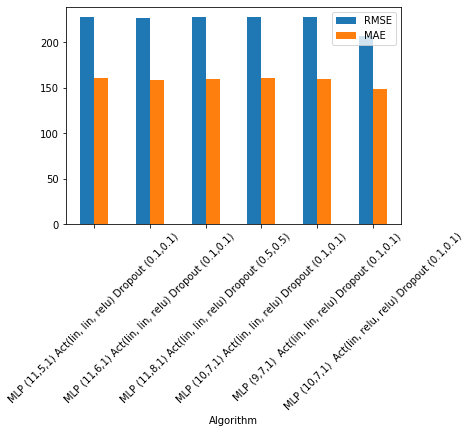

In [38]:
fig_size = plt.rcParams["figure.figsize"]  
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size  

df_resultsMLPMaxNRJ.plot.bar(x='Algorithm', y=['RMSE','MAE'], rot=45)

In [39]:
# Best topology up to here:
df_resultsMLPMaxNRJ["Parameters"].iloc[5,]

[{'size': 10, 'activation': 'linear', 'dropOutAfter': 0.1},
 {'size': 7, 'activation': 'relu', 'dropOutAfter': 0.1},
 {'size': 1, 'activation': 'relu', 'dropOutAfter': 0}]

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_66 (Dense)             (None, 10)                120       
_________________________________________________________________
dense_67 (Dense)             (None, 7)                 77        
_________________________________________________________________
dense_68 (Dense)             (None, 1)                 8         
Total params: 205
Trainable params: 205
Non-trainable params: 0
_________________________________________________________________
Train on 1725 samples, validate on 192 samples
Epoch 1/200
1725/1725 [==============================] - 1s 799us/step - loss: 662559.6256 - mean_squared_error: 662559.6256 - mean_absolute_error: 725.9841 - val_loss: 384408.9842 - val_mean_squared_error: 384408.9842 - val_mean_absolute_error: 414.7146
Epoch 2/200
1725/1725 [==============================] - 0s 112us/step - loss: 629376.1576 - mean_squared_

1725/1725 [==============================] - 0s 107us/step - loss: 118911.2137 - mean_squared_error: 118911.2137 - mean_absolute_error: 269.1005 - val_loss: 189450.4160 - val_mean_squared_error: 189450.4160 - val_mean_absolute_error: 385.5729
Epoch 31/200
1725/1725 [==============================] - 0s 105us/step - loss: 118470.1370 - mean_squared_error: 118470.1370 - mean_absolute_error: 268.5994 - val_loss: 186948.7077 - val_mean_squared_error: 186948.7077 - val_mean_absolute_error: 383.5209
Epoch 32/200
1725/1725 [==============================] - 0s 110us/step - loss: 118100.7548 - mean_squared_error: 118100.7548 - mean_absolute_error: 268.0527 - val_loss: 180886.1895 - val_mean_squared_error: 180886.1895 - val_mean_absolute_error: 377.1116
Epoch 33/200
1725/1725 [==============================] - 0s 114us/step - loss: 117597.0389 - mean_squared_error: 117597.0389 - mean_absolute_error: 267.6696 - val_loss: 173827.7972 - val_mean_squared_error: 173827.7972 - val_mean_absolute_error

1725/1725 [==============================] - 0s 113us/step - loss: 94792.5710 - mean_squared_error: 94792.5710 - mean_absolute_error: 237.2765 - val_loss: 77222.7586 - val_mean_squared_error: 77222.7586 - val_mean_absolute_error: 225.6031
Epoch 63/200
1725/1725 [==============================] - 0s 101us/step - loss: 92202.8808 - mean_squared_error: 92202.8808 - mean_absolute_error: 234.0661 - val_loss: 75583.2859 - val_mean_squared_error: 75583.2859 - val_mean_absolute_error: 220.9985
Epoch 64/200
1725/1725 [==============================] - 0s 120us/step - loss: 89310.5177 - mean_squared_error: 89310.5177 - mean_absolute_error: 230.2606 - val_loss: 72915.5187 - val_mean_squared_error: 72915.5187 - val_mean_absolute_error: 214.1987
Epoch 65/200
1725/1725 [==============================] - 0s 140us/step - loss: 86600.7438 - mean_squared_error: 86600.7438 - mean_absolute_error: 226.7744 - val_loss: 70715.3598 - val_mean_squared_error: 70715.3598 - val_mean_absolute_error: 207.2096
Epoch

1725/1725 [==============================] - 0s 104us/step - loss: 69165.9205 - mean_squared_error: 69165.9205 - mean_absolute_error: 203.5091 - val_loss: 44885.8639 - val_mean_squared_error: 44885.8639 - val_mean_absolute_error: 171.0634
Epoch 95/200
1725/1725 [==============================] - 0s 108us/step - loss: 68997.9504 - mean_squared_error: 68997.9504 - mean_absolute_error: 203.4264 - val_loss: 42971.6550 - val_mean_squared_error: 42971.6550 - val_mean_absolute_error: 166.9301
Epoch 96/200
1725/1725 [==============================] - 0s 110us/step - loss: 68908.2186 - mean_squared_error: 68908.2186 - mean_absolute_error: 203.0350 - val_loss: 41452.8606 - val_mean_squared_error: 41452.8606 - val_mean_absolute_error: 162.3205
Epoch 97/200
1725/1725 [==============================] - 0s 108us/step - loss: 68810.3970 - mean_squared_error: 68810.3970 - mean_absolute_error: 203.0132 - val_loss: 41385.1131 - val_mean_squared_error: 41385.1131 - val_mean_absolute_error: 162.3605
Epoch

1725/1725 [==============================] - 0s 105us/step - loss: 66995.4707 - mean_squared_error: 66995.4707 - mean_absolute_error: 201.4045 - val_loss: 36160.2377 - val_mean_squared_error: 36160.2377 - val_mean_absolute_error: 137.9959
Epoch 127/200
1725/1725 [==============================] - 0s 102us/step - loss: 66972.8870 - mean_squared_error: 66972.8870 - mean_absolute_error: 201.2814 - val_loss: 35976.7570 - val_mean_squared_error: 35976.7570 - val_mean_absolute_error: 137.4498
Epoch 128/200
1725/1725 [==============================] - 0s 102us/step - loss: 66923.9552 - mean_squared_error: 66923.9552 - mean_absolute_error: 201.1836 - val_loss: 35542.8986 - val_mean_squared_error: 35542.8986 - val_mean_absolute_error: 135.8425
Epoch 129/200
1725/1725 [==============================] - 0s 101us/step - loss: 66938.8424 - mean_squared_error: 66938.8424 - mean_absolute_error: 201.1149 - val_loss: 36950.8428 - val_mean_squared_error: 36950.8428 - val_mean_absolute_error: 140.0347
Ep

1725/1725 [==============================] - 0s 103us/step - loss: 66703.4046 - mean_squared_error: 66703.4046 - mean_absolute_error: 201.2304 - val_loss: 32667.6481 - val_mean_squared_error: 32667.6481 - val_mean_absolute_error: 121.4995
Epoch 159/200
1725/1725 [==============================] - 0s 102us/step - loss: 66678.9338 - mean_squared_error: 66678.9338 - mean_absolute_error: 201.1917 - val_loss: 32830.6709 - val_mean_squared_error: 32830.6709 - val_mean_absolute_error: 121.6460
Epoch 160/200
1725/1725 [==============================] - 0s 101us/step - loss: 66669.7984 - mean_squared_error: 66669.7984 - mean_absolute_error: 201.3294 - val_loss: 32842.2458 - val_mean_squared_error: 32842.2458 - val_mean_absolute_error: 121.4468
Epoch 161/200
1725/1725 [==============================] - 0s 101us/step - loss: 66687.2904 - mean_squared_error: 66687.2904 - mean_absolute_error: 201.2114 - val_loss: 32370.9551 - val_mean_squared_error: 32370.9551 - val_mean_absolute_error: 120.4554
Ep

1725/1725 [==============================] - 0s 108us/step - loss: 66577.3898 - mean_squared_error: 66577.3898 - mean_absolute_error: 201.0493 - val_loss: 32273.3951 - val_mean_squared_error: 32273.3951 - val_mean_absolute_error: 120.5216
Epoch 191/200
1725/1725 [==============================] - 0s 108us/step - loss: 66570.4214 - mean_squared_error: 66570.4214 - mean_absolute_error: 201.0488 - val_loss: 31582.4605 - val_mean_squared_error: 31582.4605 - val_mean_absolute_error: 119.4738
Epoch 192/200
1725/1725 [==============================] - 0s 112us/step - loss: 66602.5535 - mean_squared_error: 66602.5535 - mean_absolute_error: 201.1611 - val_loss: 31813.3687 - val_mean_squared_error: 31813.3687 - val_mean_absolute_error: 120.4598
Epoch 193/200
1725/1725 [==============================] - 0s 110us/step - loss: 66540.7691 - mean_squared_error: 66540.7691 - mean_absolute_error: 200.8700 - val_loss: 32534.8529 - val_mean_squared_error: 32534.8529 - val_mean_absolute_error: 121.2118
Ep

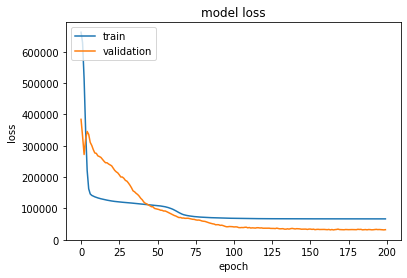

Model name MLP (10,7,1) Act(lin, relu, relu) Dropout (0.0,0.0)
Target : Max prod
Root Mean Square Error: 178.9093
Mean Absolute Error: 120.9331
R2 score : 85.0045



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_69 (Dense)             (None, 10)                120       
_________________________________________________________________
dropout_45 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_70 (Dense)             (None, 7)                 77        
_________________________________________________________________
dropout_46 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_71 (Dense)             (None, 1)                 8         
Total params: 205
Trainable params: 205
Non-trainable params: 0
____________________________________________

1725/1725 [==============================] - 0s 174us/step - loss: 164788.4360 - mean_squared_error: 164788.4360 - mean_absolute_error: 325.5837 - val_loss: 125481.7176 - val_mean_squared_error: 125481.7176 - val_mean_absolute_error: 309.0937
Epoch 29/200
1725/1725 [==============================] - 0s 141us/step - loss: 154540.5090 - mean_squared_error: 154540.5090 - mean_absolute_error: 313.5957 - val_loss: 123874.6857 - val_mean_squared_error: 123874.6857 - val_mean_absolute_error: 306.7806
Epoch 30/200
1725/1725 [==============================] - 0s 136us/step - loss: 162093.0643 - mean_squared_error: 162093.0643 - mean_absolute_error: 322.3421 - val_loss: 122392.5236 - val_mean_squared_error: 122392.5236 - val_mean_absolute_error: 304.0805
Epoch 31/200
1725/1725 [==============================] - 0s 140us/step - loss: 154806.0895 - mean_squared_error: 154806.0895 - mean_absolute_error: 316.3532 - val_loss: 119829.1071 - val_mean_squared_error: 119829.1071 - val_mean_absolute_error

1725/1725 [==============================] - 0s 124us/step - loss: 149322.3066 - mean_squared_error: 149322.3066 - mean_absolute_error: 307.3600 - val_loss: 77069.5531 - val_mean_squared_error: 77069.5531 - val_mean_absolute_error: 224.3392
Epoch 61/200
1725/1725 [==============================] - 0s 132us/step - loss: 147432.2274 - mean_squared_error: 147432.2274 - mean_absolute_error: 304.3682 - val_loss: 76451.5673 - val_mean_squared_error: 76451.5673 - val_mean_absolute_error: 225.1025
Epoch 62/200
1725/1725 [==============================] - 0s 147us/step - loss: 144619.8553 - mean_squared_error: 144619.8553 - mean_absolute_error: 304.5423 - val_loss: 74919.9088 - val_mean_squared_error: 74919.9088 - val_mean_absolute_error: 220.6697
Epoch 63/200
1725/1725 [==============================] - 0s 142us/step - loss: 140592.1369 - mean_squared_error: 140592.1369 - mean_absolute_error: 297.6723 - val_loss: 71808.3762 - val_mean_squared_error: 71808.3762 - val_mean_absolute_error: 216.26

1725/1725 [==============================] - 0s 114us/step - loss: 119712.9410 - mean_squared_error: 119712.9410 - mean_absolute_error: 274.0115 - val_loss: 59287.6990 - val_mean_squared_error: 59287.6990 - val_mean_absolute_error: 183.0364
Epoch 93/200
1725/1725 [==============================] - 0s 116us/step - loss: 119253.8164 - mean_squared_error: 119253.8164 - mean_absolute_error: 273.6178 - val_loss: 58191.7500 - val_mean_squared_error: 58191.7500 - val_mean_absolute_error: 182.3687
Epoch 94/200
1725/1725 [==============================] - 0s 112us/step - loss: 115402.5624 - mean_squared_error: 115402.5624 - mean_absolute_error: 270.6513 - val_loss: 57665.2132 - val_mean_squared_error: 57665.2132 - val_mean_absolute_error: 180.6537
Epoch 95/200
1725/1725 [==============================] - 0s 119us/step - loss: 116265.3870 - mean_squared_error: 116265.3870 - mean_absolute_error: 267.9845 - val_loss: 57574.0114 - val_mean_squared_error: 57574.0114 - val_mean_absolute_error: 181.53

1725/1725 [==============================] - 0s 122us/step - loss: 115215.9441 - mean_squared_error: 115215.9441 - mean_absolute_error: 270.3636 - val_loss: 61613.4839 - val_mean_squared_error: 61613.4839 - val_mean_absolute_error: 196.4721
Epoch 125/200
1725/1725 [==============================] - 0s 129us/step - loss: 112088.5754 - mean_squared_error: 112088.5754 - mean_absolute_error: 263.5183 - val_loss: 60569.9417 - val_mean_squared_error: 60569.9417 - val_mean_absolute_error: 195.8526
Epoch 126/200
1725/1725 [==============================] - 0s 118us/step - loss: 112433.7393 - mean_squared_error: 112433.7393 - mean_absolute_error: 267.1623 - val_loss: 60642.2846 - val_mean_squared_error: 60642.2846 - val_mean_absolute_error: 195.1262
Epoch 127/200
1725/1725 [==============================] - 0s 123us/step - loss: 112718.7331 - mean_squared_error: 112718.7331 - mean_absolute_error: 263.4735 - val_loss: 63200.9950 - val_mean_squared_error: 63200.9950 - val_mean_absolute_error: 199

1725/1725 [==============================] - 0s 185us/step - loss: 108072.7204 - mean_squared_error: 108072.7204 - mean_absolute_error: 259.4294 - val_loss: 61958.0058 - val_mean_squared_error: 61958.0058 - val_mean_absolute_error: 200.6042
Epoch 157/200
1725/1725 [==============================] - 0s 189us/step - loss: 108200.6392 - mean_squared_error: 108200.6392 - mean_absolute_error: 260.7334 - val_loss: 60208.9996 - val_mean_squared_error: 60208.9996 - val_mean_absolute_error: 196.0422
Epoch 158/200
1725/1725 [==============================] - 0s 169us/step - loss: 110495.1499 - mean_squared_error: 110495.1499 - mean_absolute_error: 260.5255 - val_loss: 60652.4818 - val_mean_squared_error: 60652.4818 - val_mean_absolute_error: 196.0024
Epoch 159/200
1725/1725 [==============================] - 0s 165us/step - loss: 115219.6357 - mean_squared_error: 115219.6357 - mean_absolute_error: 268.8916 - val_loss: 60853.1881 - val_mean_squared_error: 60853.1881 - val_mean_absolute_error: 196

1725/1725 [==============================] - 0s 114us/step - loss: 107072.1194 - mean_squared_error: 107072.1194 - mean_absolute_error: 259.4502 - val_loss: 56510.5320 - val_mean_squared_error: 56510.5320 - val_mean_absolute_error: 183.1936
Epoch 189/200
1725/1725 [==============================] - 0s 115us/step - loss: 103819.7533 - mean_squared_error: 103819.7533 - mean_absolute_error: 254.0252 - val_loss: 55919.0257 - val_mean_squared_error: 55919.0257 - val_mean_absolute_error: 181.7119
Epoch 190/200
1725/1725 [==============================] - 0s 112us/step - loss: 106181.6174 - mean_squared_error: 106181.6174 - mean_absolute_error: 255.2349 - val_loss: 56836.3433 - val_mean_squared_error: 56836.3433 - val_mean_absolute_error: 183.1008
Epoch 191/200
1725/1725 [==============================] - 0s 123us/step - loss: 109438.1204 - mean_squared_error: 109438.1204 - mean_absolute_error: 261.4716 - val_loss: 56554.3945 - val_mean_squared_error: 56554.3945 - val_mean_absolute_error: 182

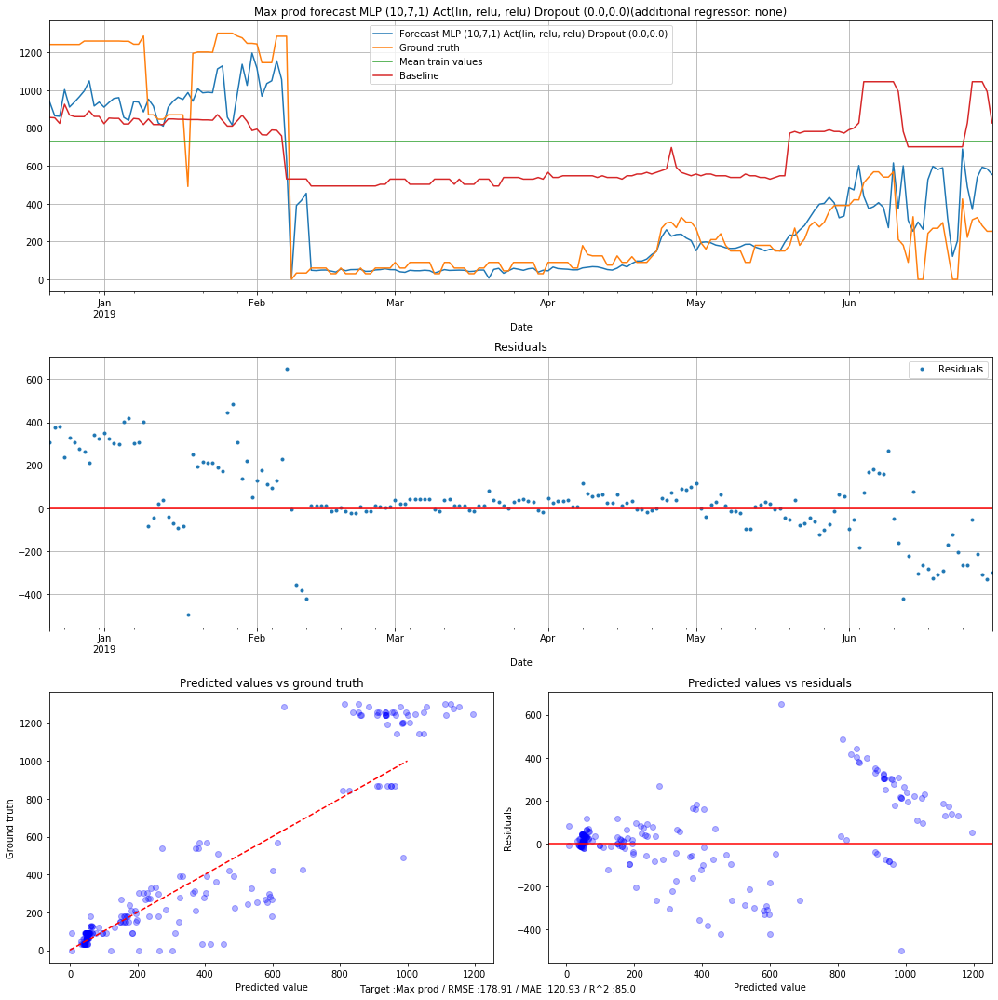

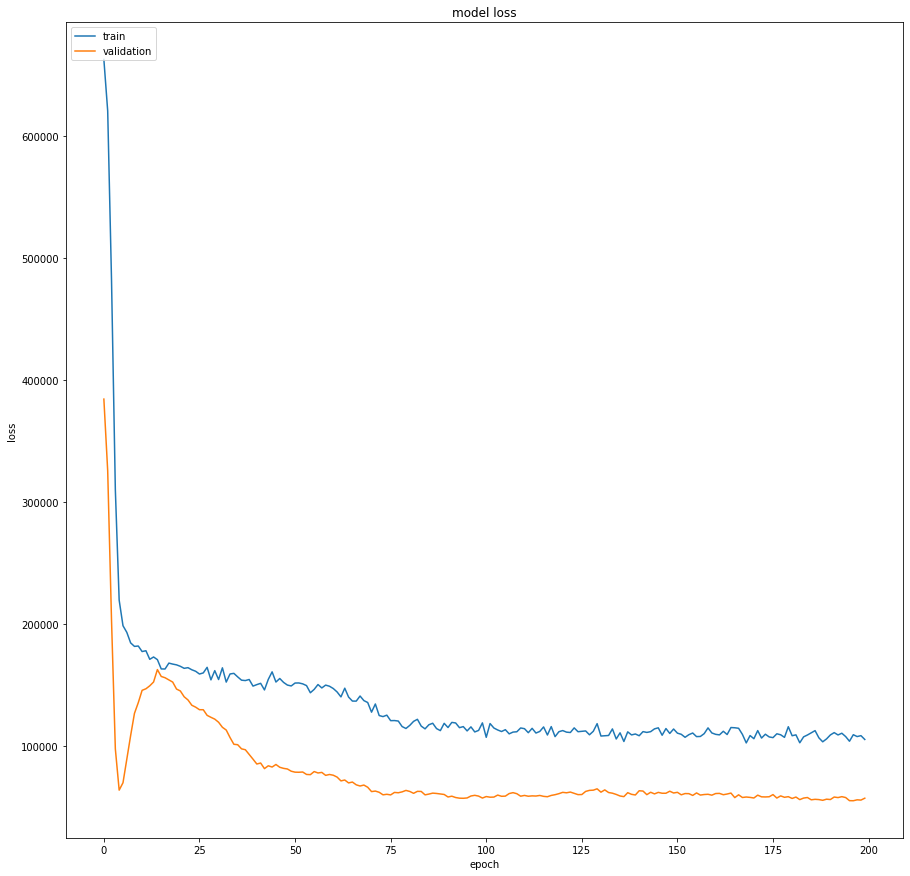

Model name MLP (10,7,1) Act(lin, relu, relu) Dropout (0.2,0.2)
Target : Max prod
Root Mean Square Error: 240.0726
Mean Absolute Error: 185.3571
R2 score : 72.9989



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_72 (Dense)             (None, 10)                120       
_________________________________________________________________
dropout_47 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_73 (Dense)             (None, 7)                 77        
_________________________________________________________________
dropout_48 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_74 (Dense)             (None, 1)                 8         
Total params: 205
Trainable params: 205
Non-trainable params: 0
____________________________________________

1725/1725 [==============================] - 0s 136us/step - loss: 182398.4883 - mean_squared_error: 182398.4883 - mean_absolute_error: 342.6434 - val_loss: 102979.1740 - val_mean_squared_error: 102979.1740 - val_mean_absolute_error: 269.9907
Epoch 29/200
1725/1725 [==============================] - 0s 168us/step - loss: 184824.6790 - mean_squared_error: 184824.6790 - mean_absolute_error: 347.6462 - val_loss: 103205.2937 - val_mean_squared_error: 103205.2937 - val_mean_absolute_error: 268.4061
Epoch 30/200
1725/1725 [==============================] - 0s 122us/step - loss: 189640.5080 - mean_squared_error: 189640.5080 - mean_absolute_error: 351.5273 - val_loss: 101326.3455 - val_mean_squared_error: 101326.3455 - val_mean_absolute_error: 264.3202
Epoch 31/200
1725/1725 [==============================] - 0s 123us/step - loss: 178026.2648 - mean_squared_error: 178026.2648 - mean_absolute_error: 343.2626 - val_loss: 97078.1360 - val_mean_squared_error: 97078.1360 - val_mean_absolute_error: 

1725/1725 [==============================] - 0s 128us/step - loss: 169431.8374 - mean_squared_error: 169431.8374 - mean_absolute_error: 330.8100 - val_loss: 73819.2866 - val_mean_squared_error: 73819.2866 - val_mean_absolute_error: 212.4480
Epoch 61/200
1725/1725 [==============================] - 0s 121us/step - loss: 167996.2195 - mean_squared_error: 167996.2195 - mean_absolute_error: 330.4270 - val_loss: 70338.7148 - val_mean_squared_error: 70338.7148 - val_mean_absolute_error: 209.1610
Epoch 62/200
1725/1725 [==============================] - 0s 117us/step - loss: 164329.7258 - mean_squared_error: 164329.7258 - mean_absolute_error: 326.3925 - val_loss: 70095.9690 - val_mean_squared_error: 70095.9690 - val_mean_absolute_error: 209.3207
Epoch 63/200
1725/1725 [==============================] - 0s 116us/step - loss: 164417.4705 - mean_squared_error: 164417.4705 - mean_absolute_error: 324.9727 - val_loss: 68078.9294 - val_mean_squared_error: 68078.9294 - val_mean_absolute_error: 206.64

1725/1725 [==============================] - 0s 163us/step - loss: 136268.7376 - mean_squared_error: 136268.7376 - mean_absolute_error: 290.2144 - val_loss: 58023.7980 - val_mean_squared_error: 58023.7980 - val_mean_absolute_error: 171.8349
Epoch 93/200
1725/1725 [==============================] - 0s 149us/step - loss: 133745.8684 - mean_squared_error: 133745.8684 - mean_absolute_error: 288.3162 - val_loss: 57060.0787 - val_mean_squared_error: 57060.0787 - val_mean_absolute_error: 170.9587
Epoch 94/200
1725/1725 [==============================] - 0s 152us/step - loss: 135983.4880 - mean_squared_error: 135983.4880 - mean_absolute_error: 295.2823 - val_loss: 57041.5851 - val_mean_squared_error: 57041.5851 - val_mean_absolute_error: 171.1257
Epoch 95/200
1725/1725 [==============================] - 0s 147us/step - loss: 133871.6338 - mean_squared_error: 133871.6338 - mean_absolute_error: 289.7543 - val_loss: 55524.4298 - val_mean_squared_error: 55524.4298 - val_mean_absolute_error: 170.51

1725/1725 [==============================] - 0s 136us/step - loss: 135047.5268 - mean_squared_error: 135047.5268 - mean_absolute_error: 294.9063 - val_loss: 59803.7204 - val_mean_squared_error: 59803.7204 - val_mean_absolute_error: 184.1711
Epoch 125/200
1725/1725 [==============================] - 0s 122us/step - loss: 127543.5572 - mean_squared_error: 127543.5572 - mean_absolute_error: 286.6281 - val_loss: 58960.8245 - val_mean_squared_error: 58960.8245 - val_mean_absolute_error: 183.7514
Epoch 126/200
1725/1725 [==============================] - 0s 119us/step - loss: 134070.6612 - mean_squared_error: 134070.6612 - mean_absolute_error: 289.8864 - val_loss: 60117.2707 - val_mean_squared_error: 60117.2707 - val_mean_absolute_error: 184.3097
Epoch 127/200
1725/1725 [==============================] - 0s 113us/step - loss: 136814.4130 - mean_squared_error: 136814.4130 - mean_absolute_error: 292.6033 - val_loss: 62910.0251 - val_mean_squared_error: 62910.0251 - val_mean_absolute_error: 190

Epoch 156/200
1725/1725 [==============================] - 0s 115us/step - loss: 126958.4378 - mean_squared_error: 126958.4378 - mean_absolute_error: 284.4005 - val_loss: 60862.2831 - val_mean_squared_error: 60862.2831 - val_mean_absolute_error: 189.3669
Epoch 157/200
1725/1725 [==============================] - 0s 115us/step - loss: 130146.6465 - mean_squared_error: 130146.6465 - mean_absolute_error: 289.1623 - val_loss: 60614.2935 - val_mean_squared_error: 60614.2935 - val_mean_absolute_error: 188.2337
Epoch 158/200
1725/1725 [==============================] - 0s 120us/step - loss: 133836.5466 - mean_squared_error: 133836.5466 - mean_absolute_error: 289.4178 - val_loss: 61477.5429 - val_mean_squared_error: 61477.5429 - val_mean_absolute_error: 189.0136
Epoch 159/200
1725/1725 [==============================] - 0s 118us/step - loss: 137947.7148 - mean_squared_error: 137947.7148 - mean_absolute_error: 295.6405 - val_loss: 61408.7412 - val_mean_squared_error: 61408.7412 - val_mean_absol

1725/1725 [==============================] - 0s 122us/step - loss: 128108.5229 - mean_squared_error: 128108.5229 - mean_absolute_error: 284.2438 - val_loss: 57187.2018 - val_mean_squared_error: 57187.2018 - val_mean_absolute_error: 176.6585
Epoch 189/200
1725/1725 [==============================] - 0s 117us/step - loss: 122666.1813 - mean_squared_error: 122666.1813 - mean_absolute_error: 278.5084 - val_loss: 58121.4187 - val_mean_squared_error: 58121.4187 - val_mean_absolute_error: 179.8706
Epoch 190/200
1725/1725 [==============================] - 0s 124us/step - loss: 138803.5301 - mean_squared_error: 138803.5301 - mean_absolute_error: 294.9408 - val_loss: 58172.4275 - val_mean_squared_error: 58172.4275 - val_mean_absolute_error: 178.3396
Epoch 191/200
1725/1725 [==============================] - 0s 144us/step - loss: 133065.6034 - mean_squared_error: 133065.6034 - mean_absolute_error: 292.1655 - val_loss: 59280.2628 - val_mean_squared_error: 59280.2628 - val_mean_absolute_error: 180

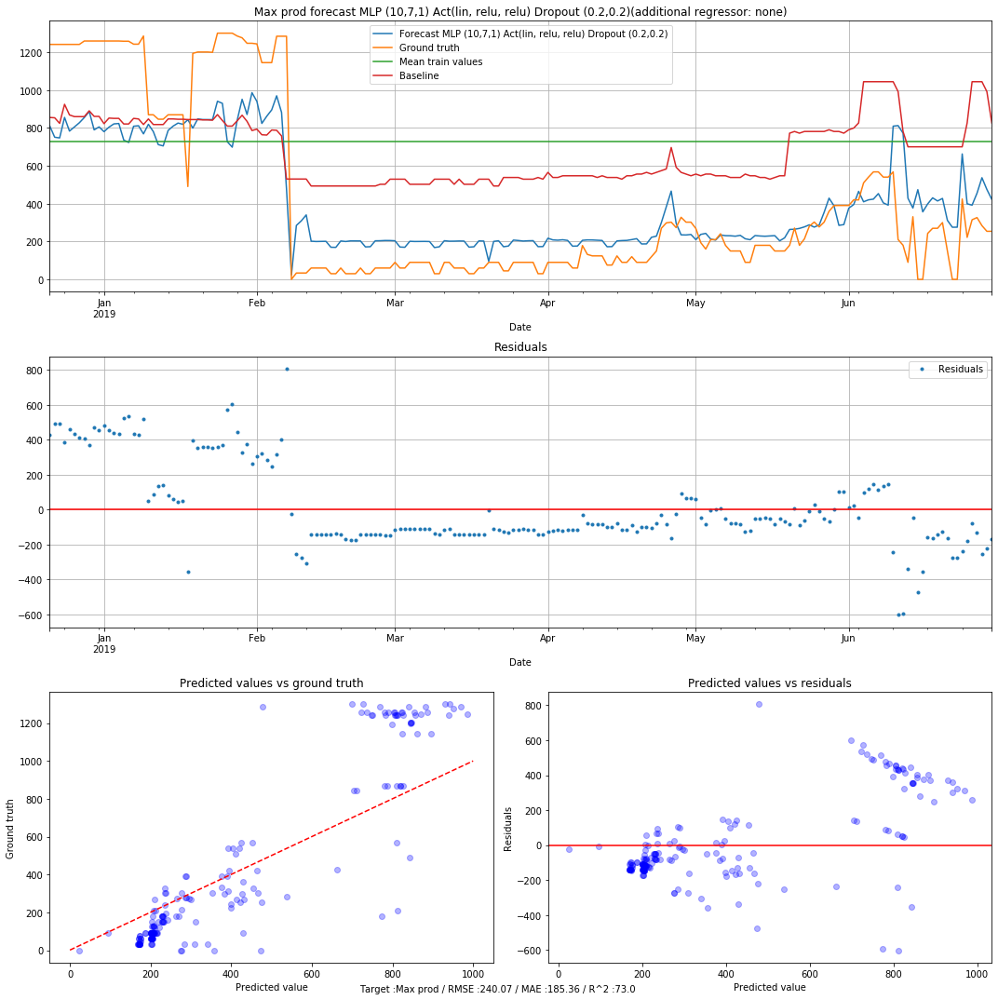

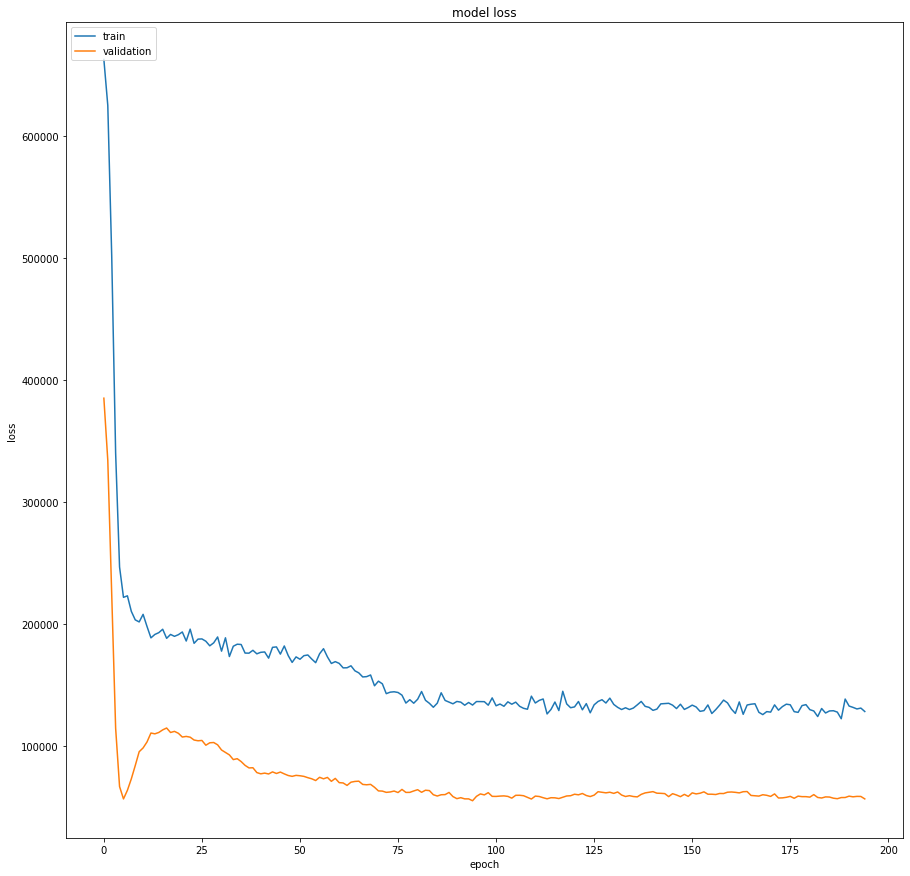

Model name MLP (10,7,1) Act(lin, relu, relu) Dropout (0.3,0.3)
Target : Max prod
Root Mean Square Error: 238.7961
Mean Absolute Error: 175.5507
R2 score : 73.2852



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_75 (Dense)             (None, 10)                120       
_________________________________________________________________
dropout_49 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_76 (Dense)             (None, 7)                 77        
_________________________________________________________________
dropout_50 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_77 (Dense)             (None, 1)                 8         
Total params: 205
Trainable params: 205
Non-trainable params: 0
____________________________________________

1725/1725 [==============================] - 0s 136us/step - loss: 114506.2399 - mean_squared_error: 114506.2399 - mean_absolute_error: 269.8089 - val_loss: 61085.7253 - val_mean_squared_error: 61085.7253 - val_mean_absolute_error: 191.0409
Epoch 29/200
1725/1725 [==============================] - 0s 128us/step - loss: 111726.0483 - mean_squared_error: 111726.0483 - mean_absolute_error: 266.5653 - val_loss: 56373.4663 - val_mean_squared_error: 56373.4663 - val_mean_absolute_error: 180.2342
Epoch 30/200
1725/1725 [==============================] - 0s 126us/step - loss: 115191.9918 - mean_squared_error: 115191.9918 - mean_absolute_error: 269.0719 - val_loss: 55548.0225 - val_mean_squared_error: 55548.0225 - val_mean_absolute_error: 175.7539
Epoch 31/200
1725/1725 [==============================] - 0s 125us/step - loss: 111193.7690 - mean_squared_error: 111193.7690 - mean_absolute_error: 265.2972 - val_loss: 54509.9778 - val_mean_squared_error: 54509.9778 - val_mean_absolute_error: 172.05

1725/1725 [==============================] - 0s 117us/step - loss: 111089.3931 - mean_squared_error: 111089.3931 - mean_absolute_error: 265.1647 - val_loss: 54506.6188 - val_mean_squared_error: 54506.6188 - val_mean_absolute_error: 162.3092
Epoch 61/200
1725/1725 [==============================] - 0s 115us/step - loss: 109549.6429 - mean_squared_error: 109549.6429 - mean_absolute_error: 264.2793 - val_loss: 53291.1015 - val_mean_squared_error: 53291.1015 - val_mean_absolute_error: 161.6538
Epoch 62/200
1725/1725 [==============================] - 0s 114us/step - loss: 104902.0842 - mean_squared_error: 104902.0842 - mean_absolute_error: 258.7530 - val_loss: 53731.0737 - val_mean_squared_error: 53731.0737 - val_mean_absolute_error: 161.8673
Epoch 63/200
1725/1725 [==============================] - 0s 229us/step - loss: 104977.5301 - mean_squared_error: 104977.5301 - mean_absolute_error: 259.7098 - val_loss: 50833.6486 - val_mean_squared_error: 50833.6486 - val_mean_absolute_error: 158.00

1725/1725 [==============================] - 0s 185us/step - loss: 107734.6168 - mean_squared_error: 107734.6168 - mean_absolute_error: 259.1339 - val_loss: 52106.9985 - val_mean_squared_error: 52106.9985 - val_mean_absolute_error: 158.2700
Epoch 93/200
1725/1725 [==============================] - 0s 145us/step - loss: 106355.3792 - mean_squared_error: 106355.3792 - mean_absolute_error: 259.7109 - val_loss: 51801.0886 - val_mean_squared_error: 51801.0886 - val_mean_absolute_error: 157.7676
Epoch 94/200
1725/1725 [==============================] - 0s 206us/step - loss: 106332.1027 - mean_squared_error: 106332.1027 - mean_absolute_error: 259.8975 - val_loss: 51902.5386 - val_mean_squared_error: 51902.5386 - val_mean_absolute_error: 157.9219
Epoch 95/200
1725/1725 [==============================] - 0s 115us/step - loss: 107146.6778 - mean_squared_error: 107146.6778 - mean_absolute_error: 262.2837 - val_loss: 50912.0120 - val_mean_squared_error: 50912.0120 - val_mean_absolute_error: 156.51

1725/1725 [==============================] - 0s 124us/step - loss: 107262.9407 - mean_squared_error: 107262.9407 - mean_absolute_error: 262.6043 - val_loss: 51866.1242 - val_mean_squared_error: 51866.1242 - val_mean_absolute_error: 157.1192
Epoch 125/200
1725/1725 [==============================] - 0s 115us/step - loss: 105269.0990 - mean_squared_error: 105269.0990 - mean_absolute_error: 257.2908 - val_loss: 51238.4867 - val_mean_squared_error: 51238.4867 - val_mean_absolute_error: 156.2390
Epoch 126/200
1725/1725 [==============================] - 0s 114us/step - loss: 102579.9112 - mean_squared_error: 102579.9112 - mean_absolute_error: 253.9744 - val_loss: 52202.6665 - val_mean_squared_error: 52202.6665 - val_mean_absolute_error: 157.6768
Epoch 127/200
1725/1725 [==============================] - 0s 115us/step - loss: 105438.1257 - mean_squared_error: 105438.1257 - mean_absolute_error: 256.4027 - val_loss: 53315.2378 - val_mean_squared_error: 53315.2378 - val_mean_absolute_error: 158

1725/1725 [==============================] - 0s 123us/step - loss: 104648.0352 - mean_squared_error: 104648.0352 - mean_absolute_error: 256.0015 - val_loss: 52209.2709 - val_mean_squared_error: 52209.2709 - val_mean_absolute_error: 158.2240
Epoch 157/200
1725/1725 [==============================] - 0s 122us/step - loss: 102294.5684 - mean_squared_error: 102294.5684 - mean_absolute_error: 256.8422 - val_loss: 50693.9171 - val_mean_squared_error: 50693.9171 - val_mean_absolute_error: 155.1739
Epoch 158/200
1725/1725 [==============================] - 0s 161us/step - loss: 105667.1827 - mean_squared_error: 105667.1827 - mean_absolute_error: 257.7136 - val_loss: 50924.5331 - val_mean_squared_error: 50924.5331 - val_mean_absolute_error: 155.4872
Epoch 159/200
1725/1725 [==============================] - 0s 119us/step - loss: 109624.5475 - mean_squared_error: 109624.5475 - mean_absolute_error: 262.6210 - val_loss: 52532.8948 - val_mean_squared_error: 52532.8948 - val_mean_absolute_error: 157

1725/1725 [==============================] - 0s 133us/step - loss: 104097.7833 - mean_squared_error: 104097.7833 - mean_absolute_error: 256.3396 - val_loss: 52095.7733 - val_mean_squared_error: 52095.7733 - val_mean_absolute_error: 156.0437
Epoch 189/200
1725/1725 [==============================] - 0s 119us/step - loss: 101555.7656 - mean_squared_error: 101555.7656 - mean_absolute_error: 251.4219 - val_loss: 52671.7029 - val_mean_squared_error: 52671.7029 - val_mean_absolute_error: 156.8611
Epoch 190/200
1725/1725 [==============================] - 0s 138us/step - loss: 103467.1600 - mean_squared_error: 103467.1600 - mean_absolute_error: 254.1438 - val_loss: 53340.0711 - val_mean_squared_error: 53340.0711 - val_mean_absolute_error: 157.6432
Epoch 191/200
1725/1725 [==============================] - 0s 121us/step - loss: 105711.4874 - mean_squared_error: 105711.4874 - mean_absolute_error: 257.7398 - val_loss: 52763.7581 - val_mean_squared_error: 52763.7581 - val_mean_absolute_error: 157

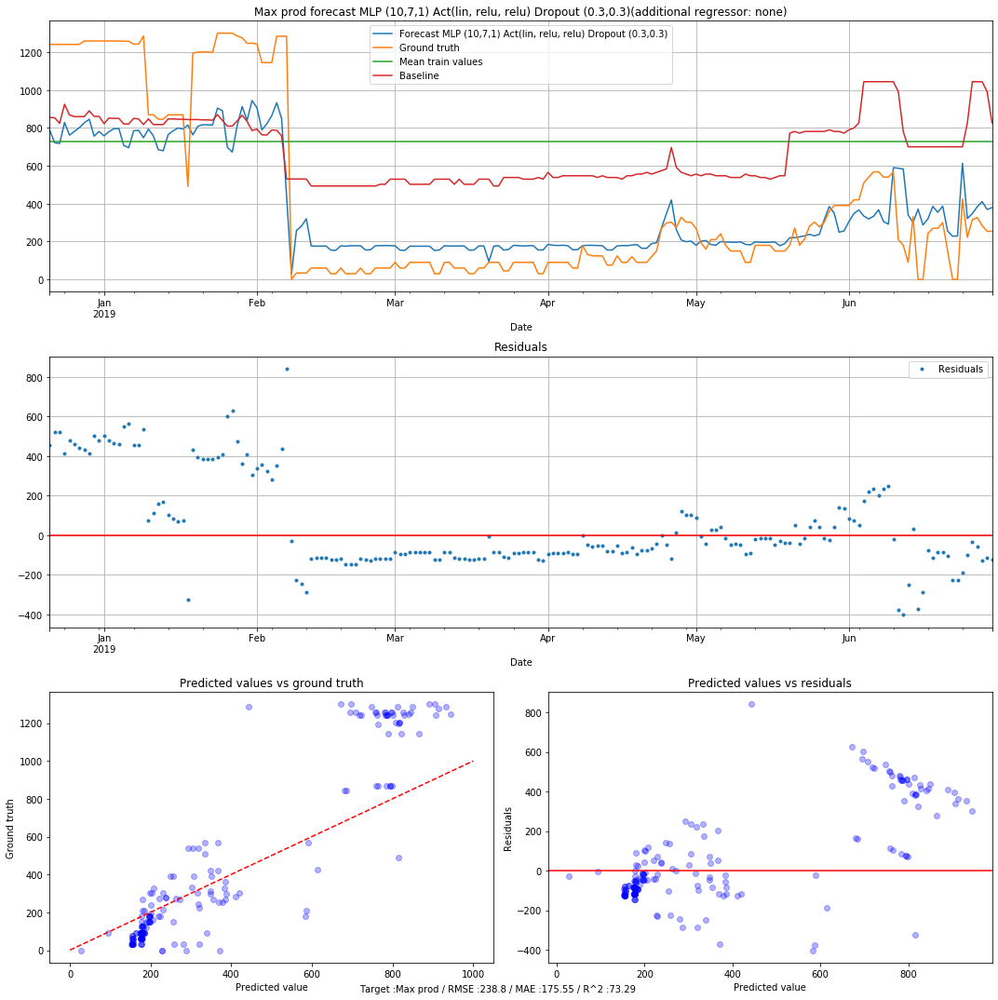

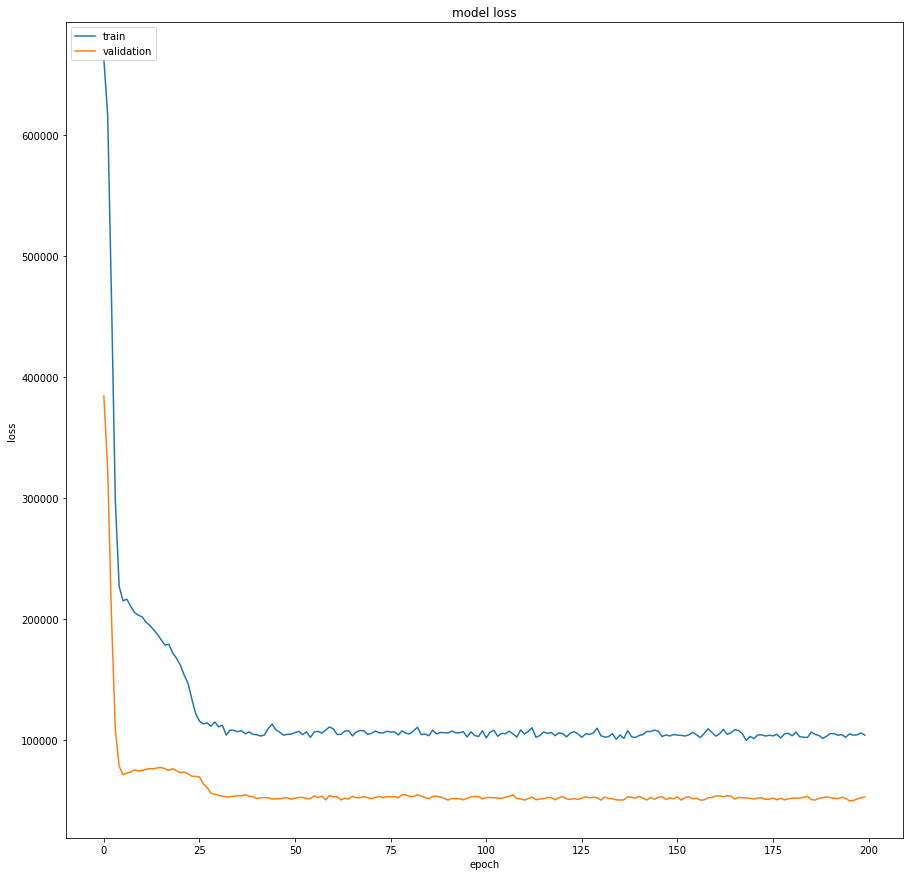

Model name MLP (10,7,1) Act(lin, relu, relu) Dropout (0.2,0.1)
Target : Max prod
Root Mean Square Error: 230.6947
Mean Absolute Error: 157.7298
R2 score : 75.0671



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_78 (Dense)             (None, 10)                120       
_________________________________________________________________
dropout_51 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_79 (Dense)             (None, 7)                 77        
_________________________________________________________________
dropout_52 (Dropout)         (None, 7)                 0         
_________________________________________________________________
dense_80 (Dense)             (None, 1)                 8         
Total params: 205
Trainable params: 205
Non-trainable params: 0
____________________________________________

1725/1725 [==============================] - 0s 196us/step - loss: 149472.5221 - mean_squared_error: 149472.5221 - mean_absolute_error: 309.4063 - val_loss: 171491.9935 - val_mean_squared_error: 171491.9935 - val_mean_absolute_error: 368.7763
Epoch 29/200
1725/1725 [==============================] - 0s 171us/step - loss: 149932.4748 - mean_squared_error: 149932.4748 - mean_absolute_error: 311.8530 - val_loss: 167912.7090 - val_mean_squared_error: 167912.7090 - val_mean_absolute_error: 364.4785
Epoch 30/200
1725/1725 [==============================] - 0s 171us/step - loss: 151652.6812 - mean_squared_error: 151652.6812 - mean_absolute_error: 312.4762 - val_loss: 159570.6732 - val_mean_squared_error: 159570.6732 - val_mean_absolute_error: 355.2525
Epoch 31/200
1725/1725 [==============================] - 0s 157us/step - loss: 148302.8763 - mean_squared_error: 148302.8763 - mean_absolute_error: 308.7699 - val_loss: 149334.0908 - val_mean_squared_error: 149334.0908 - val_mean_absolute_error

1725/1725 [==============================] - 0s 121us/step - loss: 144156.8731 - mean_squared_error: 144156.8731 - mean_absolute_error: 301.9982 - val_loss: 88305.8819 - val_mean_squared_error: 88305.8819 - val_mean_absolute_error: 247.5141
Epoch 61/200
1725/1725 [==============================] - 0s 121us/step - loss: 146120.4522 - mean_squared_error: 146120.4522 - mean_absolute_error: 305.8135 - val_loss: 87749.4469 - val_mean_squared_error: 87749.4469 - val_mean_absolute_error: 247.1955
Epoch 62/200
1725/1725 [==============================] - 0s 121us/step - loss: 136885.0935 - mean_squared_error: 136885.0935 - mean_absolute_error: 295.0466 - val_loss: 85021.1614 - val_mean_squared_error: 85021.1614 - val_mean_absolute_error: 240.5671
Epoch 63/200
1725/1725 [==============================] - 0s 123us/step - loss: 142646.1713 - mean_squared_error: 142646.1713 - mean_absolute_error: 299.5204 - val_loss: 82682.4333 - val_mean_squared_error: 82682.4333 - val_mean_absolute_error: 236.92

1725/1725 [==============================] - 0s 130us/step - loss: 112576.6950 - mean_squared_error: 112576.6950 - mean_absolute_error: 265.5606 - val_loss: 64082.6158 - val_mean_squared_error: 64082.6158 - val_mean_absolute_error: 201.0981
Epoch 93/200
1725/1725 [==============================] - 0s 134us/step - loss: 108788.6590 - mean_squared_error: 108788.6590 - mean_absolute_error: 260.0937 - val_loss: 65582.0659 - val_mean_squared_error: 65582.0659 - val_mean_absolute_error: 205.6179
Epoch 94/200
1725/1725 [==============================] - 0s 122us/step - loss: 110841.4740 - mean_squared_error: 110841.4740 - mean_absolute_error: 267.9268 - val_loss: 62736.4860 - val_mean_squared_error: 62736.4860 - val_mean_absolute_error: 200.5116
Epoch 95/200
1725/1725 [==============================] - 0s 128us/step - loss: 112244.4759 - mean_squared_error: 112244.4759 - mean_absolute_error: 263.6283 - val_loss: 62404.4583 - val_mean_squared_error: 62404.4583 - val_mean_absolute_error: 200.13

1725/1725 [==============================] - 0s 129us/step - loss: 107273.1997 - mean_squared_error: 107273.1997 - mean_absolute_error: 259.6041 - val_loss: 57941.3866 - val_mean_squared_error: 57941.3866 - val_mean_absolute_error: 192.7829
Epoch 125/200
1725/1725 [==============================] - 0s 123us/step - loss: 104398.7486 - mean_squared_error: 104398.7486 - mean_absolute_error: 255.7501 - val_loss: 56828.8932 - val_mean_squared_error: 56828.8932 - val_mean_absolute_error: 192.3850
Epoch 126/200
1725/1725 [==============================] - 0s 130us/step - loss: 101298.9907 - mean_squared_error: 101298.9907 - mean_absolute_error: 253.1610 - val_loss: 57358.7281 - val_mean_squared_error: 57358.7281 - val_mean_absolute_error: 192.9384
Epoch 127/200
1725/1725 [==============================] - 0s 125us/step - loss: 106479.1064 - mean_squared_error: 106479.1064 - mean_absolute_error: 257.9087 - val_loss: 59499.1643 - val_mean_squared_error: 59499.1643 - val_mean_absolute_error: 196

Epoch 156/200
1725/1725 [==============================] - 0s 132us/step - loss: 102268.7801 - mean_squared_error: 102268.7801 - mean_absolute_error: 251.6287 - val_loss: 52775.0504 - val_mean_squared_error: 52775.0504 - val_mean_absolute_error: 178.0988
Epoch 157/200
1725/1725 [==============================] - 0s 123us/step - loss: 101188.8561 - mean_squared_error: 101188.8561 - mean_absolute_error: 252.0265 - val_loss: 50021.6716 - val_mean_squared_error: 50021.6716 - val_mean_absolute_error: 172.4401
Epoch 158/200
1725/1725 [==============================] - 0s 123us/step - loss: 100999.2536 - mean_squared_error: 100999.2536 - mean_absolute_error: 249.2984 - val_loss: 48946.1377 - val_mean_squared_error: 48946.1377 - val_mean_absolute_error: 170.1021
Epoch 159/200
1725/1725 [==============================] - 0s 125us/step - loss: 108824.8069 - mean_squared_error: 108824.8069 - mean_absolute_error: 258.5672 - val_loss: 49567.8271 - val_mean_squared_error: 49567.8271 - val_mean_absol

1725/1725 [==============================] - 0s 127us/step - loss: 102232.9965 - mean_squared_error: 102232.9965 - mean_absolute_error: 252.1737 - val_loss: 43040.9008 - val_mean_squared_error: 43040.9008 - val_mean_absolute_error: 149.2333
Epoch 189/200
1725/1725 [==============================] - 0s 184us/step - loss: 97028.4604 - mean_squared_error: 97028.4604 - mean_absolute_error: 244.5318 - val_loss: 43167.3854 - val_mean_squared_error: 43167.3854 - val_mean_absolute_error: 146.9711
Epoch 190/200
1725/1725 [==============================] - 0s 135us/step - loss: 101814.2250 - mean_squared_error: 101814.2250 - mean_absolute_error: 250.7154 - val_loss: 42763.6373 - val_mean_squared_error: 42763.6373 - val_mean_absolute_error: 144.3666
Epoch 191/200
1725/1725 [==============================] - 0s 131us/step - loss: 105638.8755 - mean_squared_error: 105638.8755 - mean_absolute_error: 258.9860 - val_loss: 43020.2565 - val_mean_squared_error: 43020.2565 - val_mean_absolute_error: 144.7

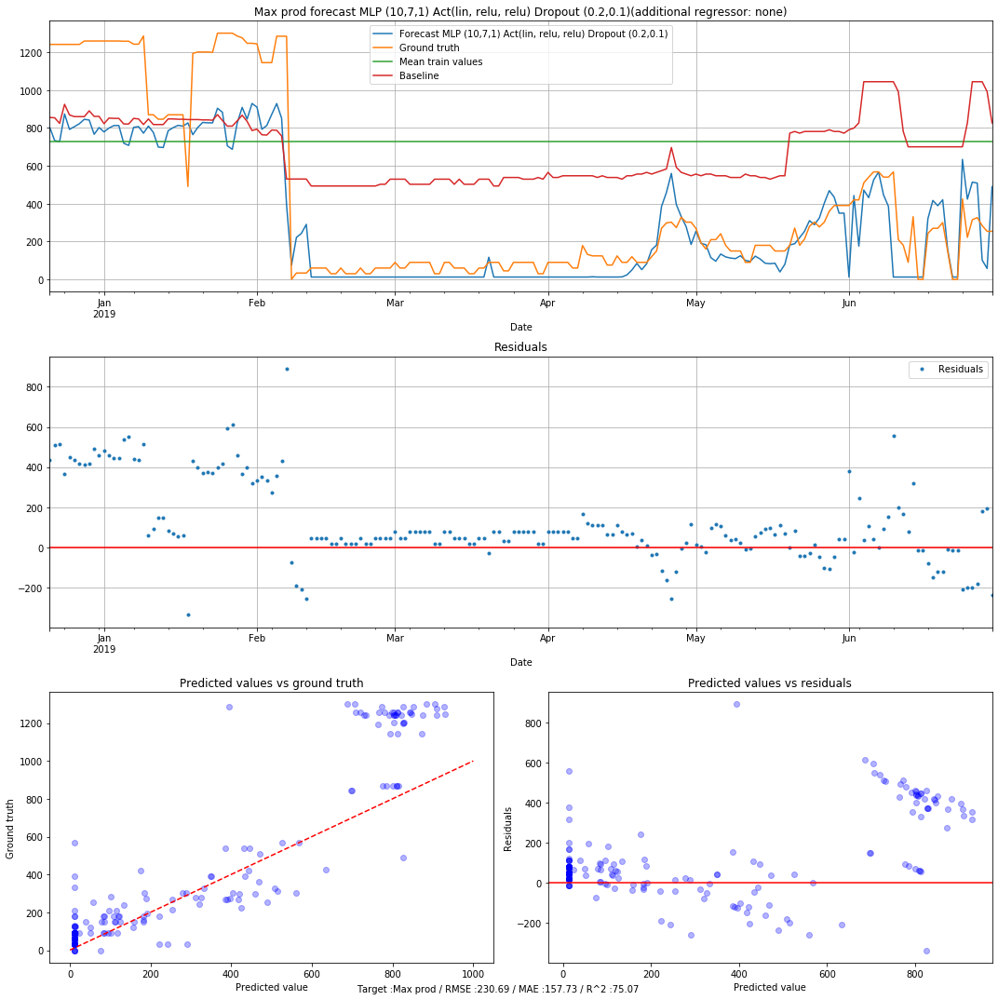

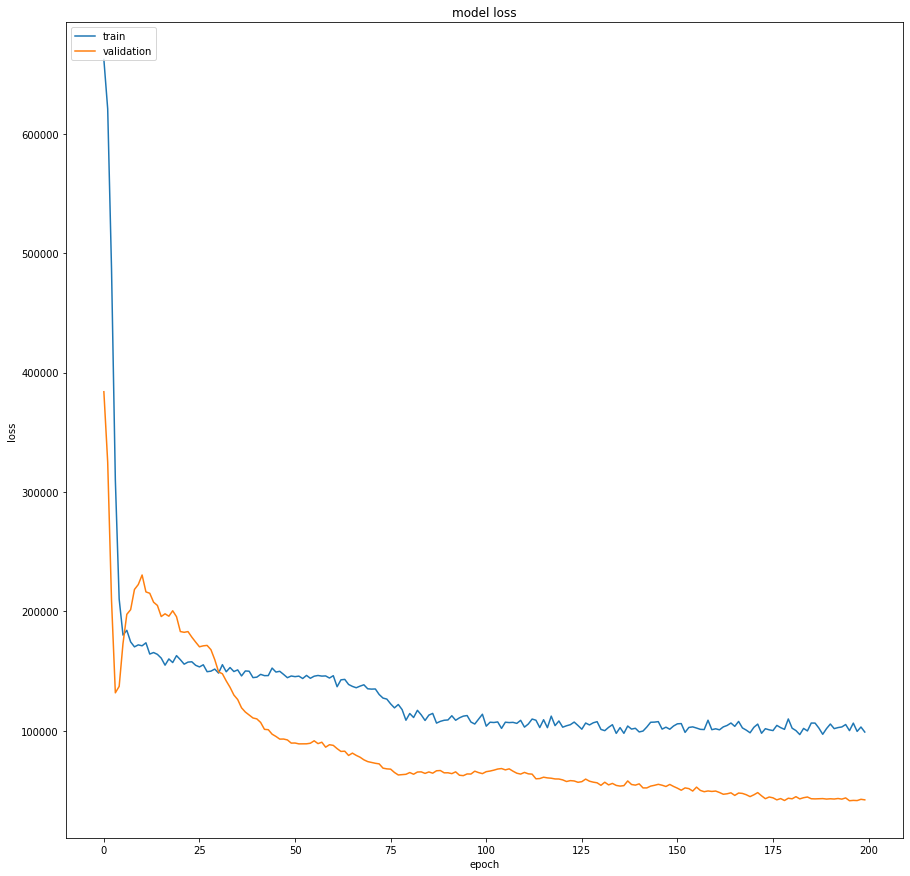

Model name MLP (10,7,1) Act(lin, relu, relu) Dropout (0.1,0.2)
Target : Max prod
Root Mean Square Error: 205.2324
Mean Absolute Error: 139.2152
R2 score : 80.2672





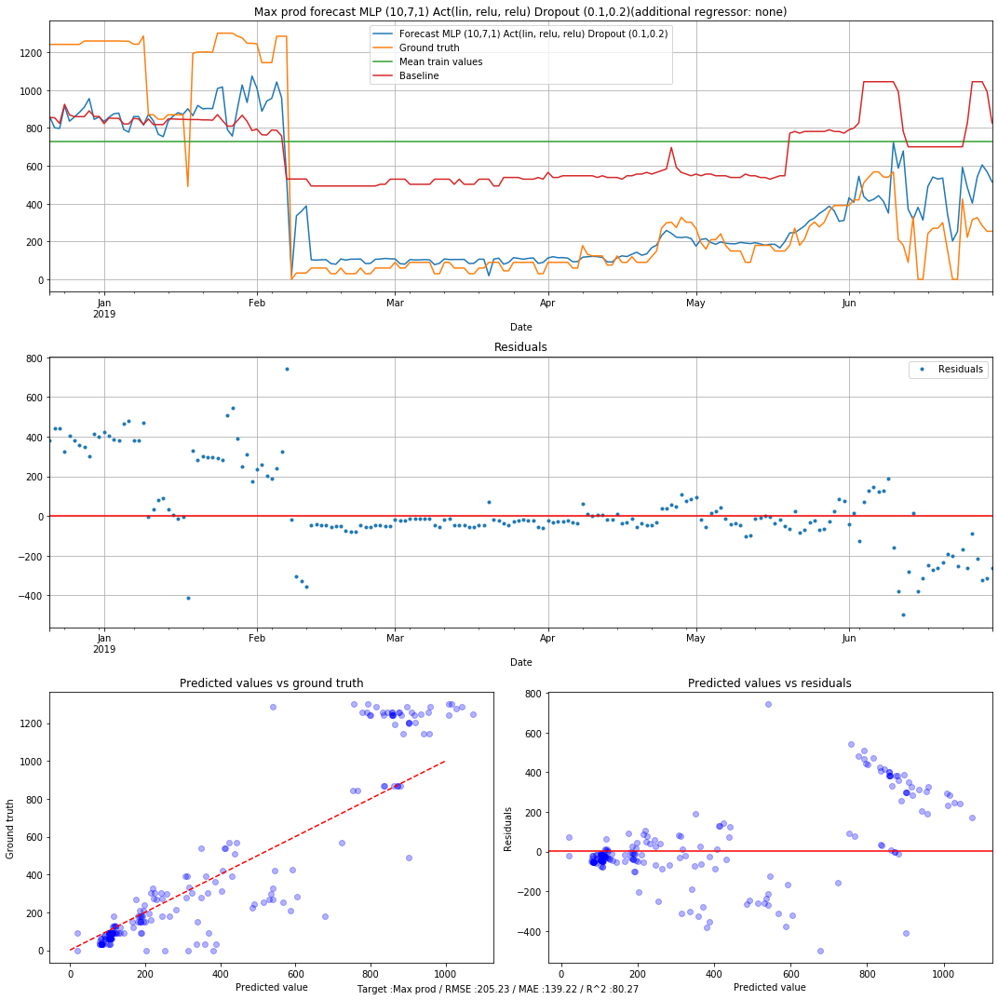

In [40]:
# Finally, play with drop out values
regressors = ['Inflow lake 1 [m3]', \
           'Inflow lake 2 [m3]', 'Inflow lake 3 [m3]', 'Inflow lake 4 [m3]', \
           'Vol lake 1 [%]','Availability plant 1 [%]', \
           'Availability plant 2 [%]', 'Availability plant 3 [%]', \
           'Availability plant 4 [%]', 'Weekend','LaggedLakeConstraint55',
            'TotalAvailablePower']

AddRegressors = ['none']

columns = ['Algorithm','Target','Features','RMSE','MAE','R^2', 'Parameters']
df_resultsMLPMaxNRJDropOut = pd.DataFrame(columns = columns)
line_nb = 0

models = ["MLP (10,7,1) Act(lin, relu, relu) Dropout (0.0,0.0)",
          "MLP (10,7,1) Act(lin, relu, relu) Dropout (0.2,0.2)",
          "MLP (10,7,1) Act(lin, relu, relu) Dropout (0.3,0.3)",
          "MLP (10,7,1) Act(lin, relu, relu) Dropout (0.2,0.1)",
          "MLP (10,7,1) Act(lin, relu, relu) Dropout (0.1,0.2)" ] 

mlpTopologies = [
                [{"size":10, "activation":"linear", "dropOutAfter" : 0},
                       {"size":7, "activation":"relu", "dropOutAfter" : 0},
                       {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":10, "activation":"linear", "dropOutAfter" : 0.2},
                                   {"size":7, "activation":"relu", "dropOutAfter" : 0.2},
                                   {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":10, "activation":"linear", "dropOutAfter" : 0.3},
                                   {"size":7, "activation":"relu", "dropOutAfter" : 0.3},
                                   {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":10, "activation":"linear", "dropOutAfter" : 0.2},
                                   {"size":7, "activation":"relu", "dropOutAfter" : 0.1},
                                   {"size":1, "activation":"relu", "dropOutAfter" : 0}],
                 [{"size":10, "activation":"linear", "dropOutAfter" : 0.1},
                                   {"size":7, "activation":"relu", "dropOutAfter" : 0.2},
                                   {"size":1, "activation":"relu", "dropOutAfter" : 0}]
               
                ]

for target_feature in ["Max prod"]:
    for addRegressor in AddRegressors:
        fullRegressors = regressors + [addRegressor]
        xTrain, xTest, yTrain, yTest, yBaseLine = GetDataSplit(df, fullRegressors,target_feature, "Baseline_"+target_feature, 0.9)
        #Scale the data
        stScaler = StandardScaler()  
        stScaler.fit(xTrain)  
        xTrainScaled = stScaler.transform(xTrain)  
        xTestScaled = stScaler.transform(xTest)

        for m,mlpTopology in zip(models, mlpTopologies):
            res = TrainEvalMLP(xTrainScaled, xTestScaled, yTrain, yTest, target_feature, yBaseLine, xTest.index, 
                                addRegressor, mlpTopology, m, True)
                
            df_resultsMLPMaxNRJDropOut.loc[line_nb,:] = [m,target_feature, xTest.columns, res[0], res[1], res[2], mlpTopology]
            line_nb = line_nb+1

In [41]:
df_resultsMLPMaxNRJDropOut.sort_values(by='RMSE')

,Algorithm,Target,Features,RMSE,MAE,R^2,Parameters
0,"MLP (10,7,1) Act(lin, relu, relu) Dropout (0.0...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",178.909,120.933,85.0045,"[{'size': 10, 'activation': 'linear', 'dropOut..."
4,"MLP (10,7,1) Act(lin, relu, relu) Dropout (0.1...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",205.232,139.215,80.2672,"[{'size': 10, 'activation': 'linear', 'dropOut..."
3,"MLP (10,7,1) Act(lin, relu, relu) Dropout (0.2...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",230.695,157.73,75.0671,"[{'size': 10, 'activation': 'linear', 'dropOut..."
2,"MLP (10,7,1) Act(lin, relu, relu) Dropout (0.3...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",238.796,175.551,73.2852,"[{'size': 10, 'activation': 'linear', 'dropOut..."
1,"MLP (10,7,1) Act(lin, relu, relu) Dropout (0.2...",Max prod,"Index(['Inflow lake 1 [m3]', 'Inflow lake 2 [m...",240.073,185.357,72.9989,"[{'size': 10, 'activation': 'linear', 'dropOut..."


In [42]:
# at this stage, best configuration seems to be the one on line 0 above (RMSE = 192.842, R2 = 82.5779):
df_resultsMLPMaxNRJDropOut.iloc[0,0]

'MLP (10,7,1) Act(lin, relu, relu) Dropout (0.0,0.0)'

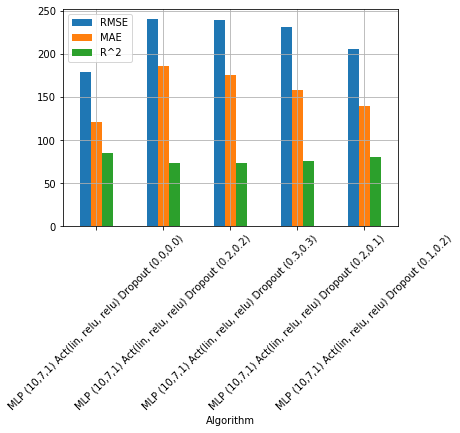

In [43]:
fig_size = plt.rcParams["figure.figsize"]  
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size  

df_resultsMLPMaxNRJDropOut.plot.bar(x='Algorithm', y=['RMSE','MAE','R^2'], rot=45, grid=True)

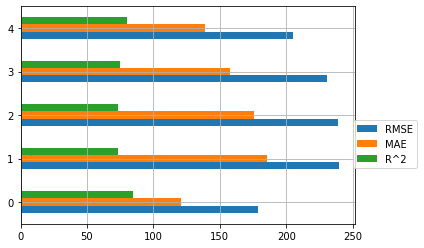

In [44]:
df_resultsMLPMaxNRJDropOut[['RMSE','MAE','R^2']].plot(kind="barh", grid=True).legend(bbox_to_anchor=(1.2, 0.5))

In [45]:
# At this stage we have identified our best predicting model
